In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import joblib, json, sys, os
from IPython.display import Image, display_png

sys.path.append("../script/")
#from MergeBrain import WholeBrainCells
import matplotlib.pyplot as plt
import pandas as pd

import sys, os, os.path, re, csv, math
import linecache
import numpy as  np
import pandas as pd
from matplotlib import pyplot as plt
from statistics import mean,stdev
import seaborn as sns

import csv
import pprint
#import ants
import tifffile
from multiprocessing import Pool
import datetime
from itertools import product

import numpy as np
import tifffile
import os
import pickle
import joblib
import pandas as pd
from matplotlib import pyplot as plt
import concurrent.futures
import gc
import json

import matplotlib
matplotlib.rcParams['pdf.use14corefonts'] = True
plt.rcParams['font.size'] = 20

In [2]:
# まずは、regionごとのデータを集計し、保存
# とりあえず、すべてのpathを網羅しておく。
# region集計が可能であったものは、csvを保存のうえ、done.txtを保存する。

conditions = {
    "WT_0.2m": ["#3_1w_B6JWT_atlas_1_2022_1103_2305","1w_B6JWT_atlas_2_2022_1219_1829", "1w_B6JWT_atlas_3_2022_1223_1719", "1w_B6JWT_atlas_4_2023_0105_1708"],
   "WT_0.75m": ["3w_B6JWT_atlas_1_2022_0925_1526", "3w_B6JWT_atlas_2_2022_1004_928", "3w_B6JWT_atlas_3_2022_1017_2126", "3w_B6JWT_atlas_4_2022_1130_1051"],
    
    "WT_1m": ["#4_APPmodel_Ctr1m_1_2022_1104_1550","#4_APPmodel_Ctr1m_2_2022_1108_959","#4_APPmodel_Ctr1m_3_2022_1209_1751"],
    "WT_2m": ["8w_B6JWT_atlas_1_2022_0924_1847","8w_B6JWT_atlas_2_2022_0926_1326", "8w_B6JWT_atlas_3_2022_1005_1110", "8w_B6JWT_atlas_4_2022_1010_2030","8w_B6JWT_atlas_5_2023_0423_1604",],
    "WT_3m": ["#5_APPmodel_Ctr3m_1_2023_0113_1230", "#5_APPmodel_Ctr3m_2_2023_0210_1142", "#5_APPmodel_Ctr3m_3_2023_0227_1605", "#4_APPmodel_Ctr3m_4_2023_0427_1444",],
    "WT_5m": ["#4_APPmodel_Ctr5m_1_2022_1026_252", "#4_APPmodel_Ctr5m_2_2022_1028_2336", "#4_APPmodel_Ctr5m_3_2022_1101_140", "#4_APPmodel_Ctr5m_4_2023_0512_2057"],
    "WT_7m": [ "#5_APPmodel_Ctr7m_1_2023_0206_1534","#5_APPmodel_Ctr7m_2_2023_0313_1111","#5_APPmodel_Ctr7m_3_2023_0331_2139","#4_APPmodel_Ctr7m_4_2023_0516_1559","#5_APPmodel_Ctr7m_5_2023_0522_2218"],
    "WT_9m": [ "#5_APPmodel_Ctr9m_1_2023_0130_1607", "#5_APPmodel_Ctr9m_2_2023_0216_2052" ,"#5_APPmodel_Ctr9m_3_2023_0322_2014","#5_APPmodel_Ctr9m_4_2023_0518_1449"],
    "WT_12m": ["56w_B6JWT_atlas_1_2022_1128_1548", "56w_B6JWT_atlas_2_2022_1221_1537", "56w_B6JWT_atlas_3_2022_1224_1718"],
    "APP_1m": ["#4_APPmodel_APP1m_1_2022_1102_1304", "#4_APPmodel_APP1m_2_2022_1106_1708","#4_APPmodel_APP1m_3_2022_1213_2151","#4_APPmodel_APP1m_4_2023_0417_2052", ],
    "APP_3m": [ "#5_APPmodel_APP3m_2_2023_0123_1645", "#5_APPmodel_APP3m_3_2023_0212_2217","#5_APPmodel_APP3m_4_2023_0214_2027","#4_APPmodel_APP3m_5_2023_0502_1423",],
   "APP_5m": ["#4_APPmodel_APP5m_1_2022_1024_1336", "#4_APPmodel_APP5m_2_2022_1027_1333","#4_APPmodel_APP5m_3_2022_1030_1257", "#4_APPmodel_APP5m_4_2023_0509_1021"],
    "APP_7m": ["#5_APPmodel_APP7m_2_2023_0315_1540","#5_APPmodel_APP7m_3_2023_0310_1401","#5_APPmodel_APP7m_4_2023_0317_1630", "#5_APPmodel_APP7m_5_2023_0520_1723"],
    "APP_9m": ["#5_APPmodel_APP9m_1_2023_0117_1352","#5_APPmodel_APP9m_2_2023_0327_1425", "#5_APPmodel_APP9m_3_2023_0329_1611", "#5_APPmodel_APP9m_4_2023_0403_1443" ],
    
    "VCP_mut_2m": ["VCPmodel_E524A_0.5x_1_2022_0624_1303", "VCPmodel_E524A_0.5x_2_2022_0626_1338", "VCPmodel_E524A_0.5x_4_2022_0922_1217", "VCPmodel_E524A_0.5x_6_2022_0628_1157"], 
   "VCP_WT_2m": ["VCPmodel_WT_0.5x_1_2022_0625_1104","VCPmodel_WT_0.5x_2_2022_0917_1808", "VCPmodel_WT_0.5x_3_2022_0627_1257", "VCPmodel_WT_0.5x_4_2022_0921_950","VCPmodel_WT_0.5x_5_2022_0923_1454","VCPmodel_WT_0.5x_6_2022_0929_953"],
    "newVCP_mut_2m": ["#5_VCPmodel_E524A_0.5x_1_2023_0120_1929","#5_VCPmodel_E524A_0.5x_2_2023_0407_1031", "#5_VCPmodel_E524A_0.5x_3_2023_0413_2036"], 
   "newVCP_WT_2m": ["#5_VCPmodel_WT_0.5x_1_2023_0405_1108","#5_VCPmodel_WT_0.5x_2_2023_0115_1852","#5_VCPmodel_WT_0.5x_3_2023_0410_1246"], 
    
    "TMT_2m": ["#3_TMTmodel_TMT3.0_8w_1_2022_1014_1410", "#3_TMTmodel_TMT3.0_8w_2_2022_1020_938", "#3_TMTmodel_TMT3.0_8w_3_2022_1023_501", "#3_TMTmodel_TMT_8w_5_2022_1205_1147",],
  "Saline_2m": ["#3_TMTmodel_Saline_8w_1_2022_1016_1318", "#3_TMTmodel_Saline_8w_2_2022_1018_2103","#3_TMTmodel_Saline_8w_3_2022_1021_1910", "#3_TMTmodel_Saline_8w_4_2022_1202_1349", "#3_TMTmodel_Saline_8w_5_2022_1217_1723", "#3_TMTmodel_Saline_8w_6_2022_1216_001"],
    
}

In [3]:
data_Atlas = pd.read_csv(filepath_or_buffer="/export3/Imaging/atlas_for_fig/count_all_rgb.csv", encoding="ms932", sep=",")
# インプットの項目数（行数 * カラム数）を返却します。
data_atlas=np.array(data_Atlas.values.tolist())
#print(data_Atlas.size)
# 指定したカラムだけ抽出したDataFrameオブジェクトを返却します。
data_GO = pd.read_csv(filepath_or_buffer="/export3/Imaging/atlas_for_fig/GOvsID_6region_removed.csv", encoding="ms932", sep=",")
# 指定したカラムだけ抽出したDataFrameオブジェクトを返却します。
data_GO

,id,graph_order,R,G,B
0,997,0,255,255,255
1,68,7,38,143,69
2,667,8,38,143,69
3,52192,9,38,143,69
4,52196,10,38,143,69
...,...,...,...,...,...
666,129,1299,170,170,170
667,140,1300,170,170,170
668,145,1301,170,170,170
669,153,1302,170,170,170


In [4]:
colorlist=[]

total = 0
for i in range (671):
    atlas_id_num = data_GO["id"].values[i]
    colorlist.append((data_GO["R"].values[i]/255,data_GO["G"].values[i]/255,data_GO["B"].values[i]/255))
colorlist_671=colorlist

In [5]:
# 下記は一部のidだけが対象
dir= "/export3/Imaging/cubic-atlas_v1-1/cubic-atlas/"
dir_ana=dir+"summary_CUBIC-Atlas-1-1.csv"


data_id = pd.read_csv(filepath_or_buffer=dir_ana, encoding="ms932", sep=",")
data_id

,id,acronym,node_name,graph_order,rgb_triplet,cell_count,volume(mm3),density(cells/mm3)
0,997,root,root,0,"[255, 255, 255]",78620375,506.05289,155359.99590
1,8,grey,Basic cell groups and regions,1,"[191, 218, 227]",70525778,449.60086,156863.08540
2,567,CH,Cerebrum,2,"[176, 240, 255]",39291452,275.87673,142423.94190
3,688,CTX,Cerebral cortex,3,"[176, 255, 184]",31750427,221.54964,143310.66800
4,695,CTXpl,Cortical plate,4,"[112, 255, 112]",30687805,212.64380,144315.54300
...,...,...,...,...,...,...,...,...
834,129,V3,third ventricle,1299,"[170, 170, 170]",144614,0.90005,160673.85380
835,140,AQ,cerebral aqueduct,1300,"[170, 170, 170]",26972,0.40620,66400.27696
836,145,V4,fourth ventricle,1301,"[170, 170, 170]",118275,0.96495,122570.72070
837,153,V4r,lateral recess,1302,"[170, 170, 170]",71934,0.46333,155254.98260


In [6]:
    # 下記は一部のidだけが対象
    dir= "/export3/Imaging/Axial/Neurorology/8w_B6JWT_atlas_1_2022_0924_1847/"
    dir_ana=dir+"Allen_graph.json"

    with open(dir_ana) as f:
        param_ana = json.load(f)

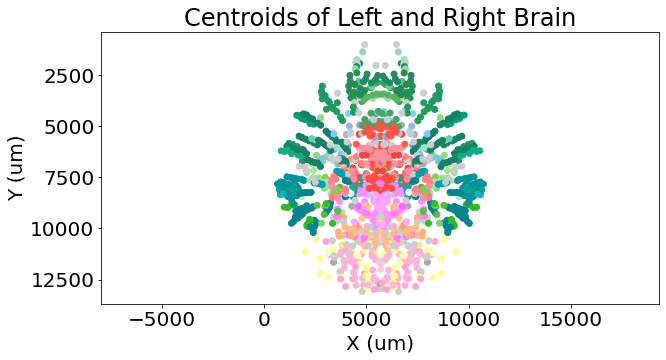

In [7]:
# whole brain plotをする
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# バイナリファイルを読み込む
dt_type = np.dtype([
  ('X(um)', 'f4'), ('Y(um)', 'f4'), ('Z(um)', 'f4'), ('atlasID', 'u2')
])
grid_points = np.fromfile("/export3/Imaging/ds4_Data4/atlas/annotation_50_non_zero_coordinates.bin", dt_type)
grid_points = pd.DataFrame(grid_points)

# 左脳と右脳のデータを分割
left_points = grid_points[grid_points['X(um)'] < 5700]
right_points = grid_points[grid_points['X(um)'] >= 5700]

# atlasIDごとに重心を計算する関数
def calculate_centroids(df):
    centroids = df.groupby('atlasID').agg({'X(um)': 'mean', 'Y(um)': 'mean', 'Z(um)': 'mean'}).reset_index()
    return centroids

# 左脳と右脳の重心を計算
left_centroids = calculate_centroids(left_points)
right_centroids = calculate_centroids(right_points)

# 重心データを結合
all_centroids = pd.concat([left_centroids, right_centroids])



# 色情報の辞書を生成
color_dict = {row['id']: (row['R']/255, row['G']/255, row['B']/255) for index, row in data_GO.iterrows()}

# atlasIDに基づいて各点の色を決定
all_centroids['color'] = all_centroids['atlasID'].map(color_dict).apply(lambda x: x if isinstance(x, tuple) else (0.5, 0.5, 0.5))  # 色が見つからない場合は灰色

# xy座標をプロット（すべての重心を1つのプロットに表示）
plt.figure(figsize=(10, 5))
plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], color=all_centroids['color'].tolist())
plt.title('Centroids of Left and Right Brain')
plt.xlabel('X (um)')
plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.show()


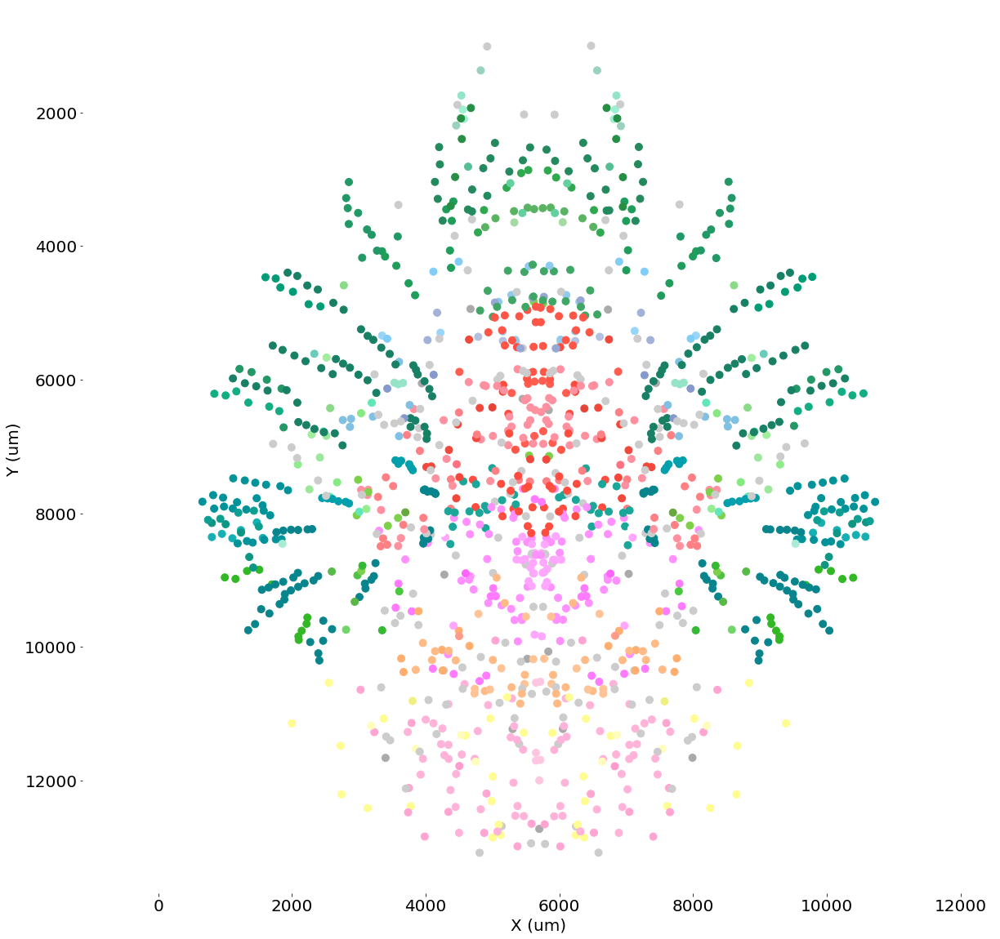

In [8]:
plt.figure(figsize=(20, 20))
plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=80, color=all_centroids['color'].tolist())
#plt.title('Centroids of Left and Right Brain')
plt.xlabel('X (um)')
plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.xticks([])  # X軸の目盛りを非表示
#plt.yticks([])  # Y軸の目盛りを非表示
plt.show()


In [9]:
# cellome_onset DataFrameの作成
ids = data_GO["id"].astype(int).unique()
cellome_onset = pd.DataFrame(index=ids)

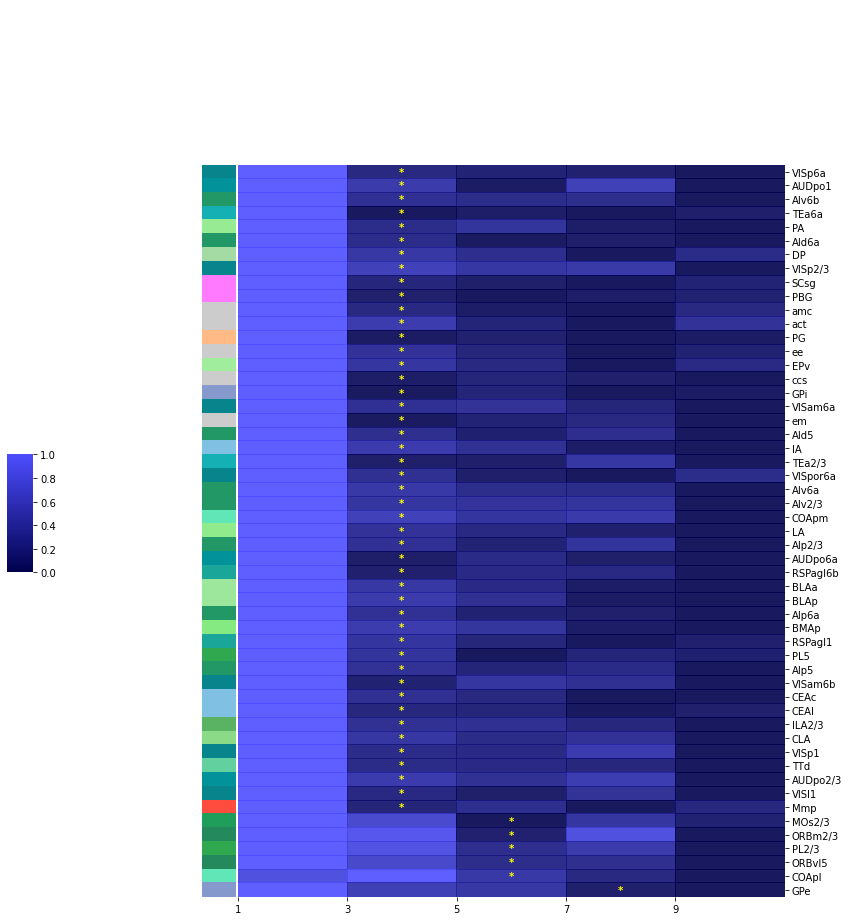

In [10]:
# Abeta increase
# APP only

import pandas as pd

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_decrease.csv', index_col='atlasID')
X_all = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_all.csv', index_col='atlasID')
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_lire_ver_Abeta_increase_random_slice_1.csv', index_col='atlasID')

X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_decrease.csv', index_col='atlasID')

X = X[~X.index.isin(X2.index)] # WTのatlasIDとのoverlapを消して、APP specificにする

category = "APP_specific_Iba1_decrease_onset(m)"

import ruptures as rpt
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pandas as pd
import numpy as np
from matplotlib import rcParams

#data_GO = pd.read_csv(filepath_or_buffer="/data4/ds1_Imaging3/atlas_for_fig/GOvsID_6region_removed.csv", encoding="ms932", sep=",")

ids = data_GO["id"].astype(int).unique()

# フォントをDejaVu Sansに設定
rcParams['font.family'] = 'DejaVu Sans'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

months = np.array([1, 3, 5, 7, 9])  # 月数をインデックスとして使用

# Function to detect change points in each row using ruptures
def detect_change_points(data):
    change_points = []
    for index, row in data.iterrows():
        # Extract the values and convert to numpy array
        values = row.values.astype(float)
        # Create a change point detection model instance
        model = "l2"  # Using L2 norm (least squares)
        algo = rpt.Binseg(model=model, min_size=1, jump=1).fit(values)
        # Detect change point
        result = algo.predict(n_bkps=1)
        change_points.append(months[result[:-1]][0])
    return change_points

# Run the change point detection function
data = X.copy()
# Detect change points
change_points = detect_change_points(data)

# データフレームに変化点を追加
data['Change Points'] = change_points


cellome_onset[category] = np.nan  # 初期値としてNaNを設定

# 存在する変化点をcellome_onsetに追加
for atlas_id, change_point in zip(data.index, change_points):
    if atlas_id in cellome_onset.index:
        cellome_onset.at[atlas_id, category] = change_point

for atlas_id in ids:
    if atlas_id in X_all.index:
        cellome_onset.at[atlas_id, "1m_" + category] = X_all.loc[atlas_id, "APP_1m"]
        cellome_onset.at[atlas_id, "3m_" + category] = X_all.loc[atlas_id, "APP_3m"]
        cellome_onset.at[atlas_id, "5m_" + category] = X_all.loc[atlas_id, "APP_5m"]
        cellome_onset.at[atlas_id, "7m_" + category] = X_all.loc[atlas_id, "APP_7m"]
        cellome_onset.at[atlas_id, "9m_" + category] = X_all.loc[atlas_id, "APP_9m"]  

# カスタムカラーマップの作成
def create_custom_cmap():
    #colors = [(0.1, 0.0, 0.0, 0.9),  (1, 0.3, 0.3, 0.90)] # increase
    colors = [(0, 0, 0.3, 0.9),  (0.3, 0.3, 1, 0.9)] # decrease
    cmap_name = "custom_cmap"
    # Create a colormap with interpolation between specified colors
    cmap = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)
    return cmap

# Using the new custom colormap
cmap = create_custom_cmap()

# 行ごとに正規化
normalized_data = data.iloc[:, :-1].apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1)

# 行ごとに変化点月齢を強調するためのデータフレームを作成
stars = data.iloc[:, :-1].copy().astype(str)
stars[:] = ''  # 全てのセルを空文字列に設定
for i, cp in enumerate(change_points):
    month_col_cp = f'APP_{cp}m'
    if month_col_cp in stars.columns:
        stars.at[data.index[i], month_col_cp] = '*'

# 変化点でソート
sorted_indices = np.argsort(change_points)
sorted_normalized_data = normalized_data.iloc[sorted_indices]
sorted_stars = stars.iloc[sorted_indices]

# acronymのインデックスを追加
acronyms = data_id.set_index('id').loc[sorted_normalized_data.index, 'acronym']

colorlist = []
colorlist_671 = []

for atlas_id in sorted_normalized_data.index:
    for i in range(671):
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# プロット
height = (17/55) * len(X)
g = sns.clustermap(sorted_normalized_data, cmap=cmap, row_colors=colorlist_671, vmin=0, vmax=1, row_cluster=False, col_cluster=False, annot=sorted_stars, fmt='', annot_kws={"size": 10, "weight": "bold", "color": "yellow"}, figsize=(12, height))
# 行ラベルをacronymに置き換え
g.ax_heatmap.set_yticklabels(acronyms)
g.ax_heatmap.yaxis.set_tick_params(rotation=0)
# x軸ラベルを変更
new_labels = ['1', '3', '5', '7', '9']
g.ax_heatmap.set_xticks(np.arange(len(new_labels)))  # Ensure there are correct number of ticks
g.ax_heatmap.set_xticklabels(new_labels)

# 不要な右端の縦軸ラベルを削除
g.ax_heatmap.set_ylabel('')

g.cax.set_position([.0, .4, .03, .1])  # [left, bottom, width, height]

plt.show()


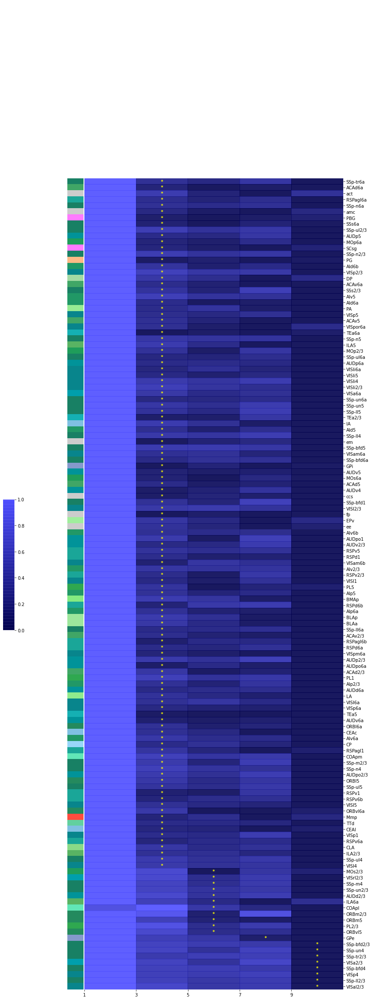

In [11]:
# Abeta increase
# APP only

import pandas as pd

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_decrease.csv', index_col='atlasID')
X_all = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_all.csv', index_col='atlasID')
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_lire_ver_Abeta_increase_random_slice_1.csv', index_col='atlasID')

#X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_decrease.csv', index_col='atlasID')

#X = X[~X.index.isin(X2.index)] # WTのatlasIDとのoverlapを消して、APP specificにする

category = "APP_Iba1_decrease_onset(m)"

import ruptures as rpt
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pandas as pd
import numpy as np
from matplotlib import rcParams

#data_GO = pd.read_csv(filepath_or_buffer="/data4/ds1_Imaging3/atlas_for_fig/GOvsID_6region_removed.csv", encoding="ms932", sep=",")

ids = data_GO["id"].astype(int).unique()

# フォントをDejaVu Sansに設定
rcParams['font.family'] = 'DejaVu Sans'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

months = np.array([1, 3, 5, 7, 9])  # 月数をインデックスとして使用

# Function to detect change points in each row using ruptures
def detect_change_points(data):
    change_points = []
    for index, row in data.iterrows():
        # Extract the values and convert to numpy array
        values = row.values.astype(float)
        # Create a change point detection model instance
        model = "l2"  # Using L2 norm (least squares)
        algo = rpt.Binseg(model=model, min_size=1, jump=1).fit(values)
        # Detect change point
        result = algo.predict(n_bkps=1)
        change_points.append(months[result[:-1]][0])
    return change_points

# Run the change point detection function
data = X.copy()
# Detect change points
change_points = detect_change_points(data)

# データフレームに変化点を追加
data['Change Points'] = change_points


cellome_onset[category] = np.nan  # 初期値としてNaNを設定

# 存在する変化点をcellome_onsetに追加
for atlas_id, change_point in zip(data.index, change_points):
    if atlas_id in cellome_onset.index:
        cellome_onset.at[atlas_id, category] = change_point

for atlas_id in ids:
    if atlas_id in X_all.index:
        cellome_onset.at[atlas_id, "1m_" + category] = X_all.loc[atlas_id, "APP_1m"]
        cellome_onset.at[atlas_id, "3m_" + category] = X_all.loc[atlas_id, "APP_3m"]
        cellome_onset.at[atlas_id, "5m_" + category] = X_all.loc[atlas_id, "APP_5m"]
        cellome_onset.at[atlas_id, "7m_" + category] = X_all.loc[atlas_id, "APP_7m"]
        cellome_onset.at[atlas_id, "9m_" + category] = X_all.loc[atlas_id, "APP_9m"]  

# カスタムカラーマップの作成
def create_custom_cmap():
    #colors = [(0.1, 0.0, 0.0, 0.9),  (1, 0.3, 0.3, 0.90)] # increase
    colors = [(0, 0, 0.3, 0.9),  (0.3, 0.3, 1, 0.9)] # decrease
    cmap_name = "custom_cmap"
    # Create a colormap with interpolation between specified colors
    cmap = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)
    return cmap

# Using the new custom colormap
cmap = create_custom_cmap()

# 行ごとに正規化
normalized_data = data.iloc[:, :-1].apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1)

# 行ごとに変化点月齢を強調するためのデータフレームを作成
stars = data.iloc[:, :-1].copy().astype(str)
stars[:] = ''  # 全てのセルを空文字列に設定
for i, cp in enumerate(change_points):
    month_col_cp = f'APP_{cp}m'
    if month_col_cp in stars.columns:
        stars.at[data.index[i], month_col_cp] = '*'

# 変化点でソート
sorted_indices = np.argsort(change_points)
sorted_normalized_data = normalized_data.iloc[sorted_indices]
sorted_stars = stars.iloc[sorted_indices]

# acronymのインデックスを追加
acronyms = data_id.set_index('id').loc[sorted_normalized_data.index, 'acronym']

colorlist = []
colorlist_671 = []

for atlas_id in sorted_normalized_data.index:
    for i in range(671):
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# プロット
height = (17/55) * len(X)
g = sns.clustermap(sorted_normalized_data, cmap=cmap, row_colors=colorlist_671, vmin=0, vmax=1, row_cluster=False, col_cluster=False, annot=sorted_stars, fmt='', annot_kws={"size": 10, "weight": "bold", "color": "yellow"}, figsize=(12, height))
# 行ラベルをacronymに置き換え
g.ax_heatmap.set_yticklabels(acronyms)
g.ax_heatmap.yaxis.set_tick_params(rotation=0)
# x軸ラベルを変更
new_labels = ['1', '3', '5', '7', '9']
g.ax_heatmap.set_xticks(np.arange(len(new_labels)))  # Ensure there are correct number of ticks
g.ax_heatmap.set_xticklabels(new_labels)

# 不要な右端の縦軸ラベルを削除
g.ax_heatmap.set_ylabel('')

g.cax.set_position([.0, .4, .03, .1])  # [left, bottom, width, height]

plt.show()


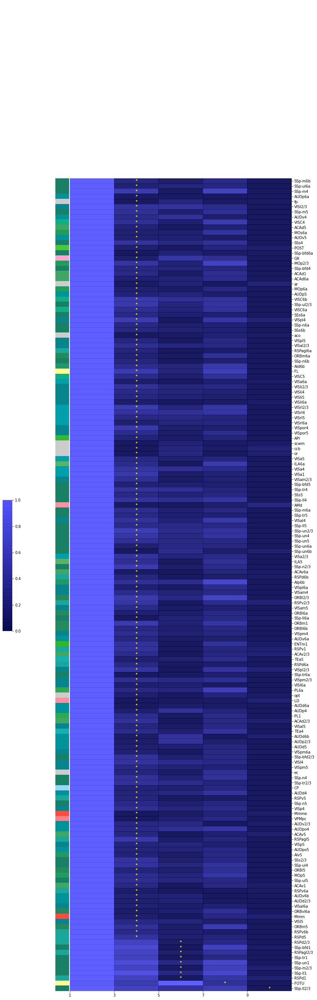

In [12]:
# Abeta increase
# APP only

import pandas as pd

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_decrease.csv', index_col='atlasID')
X_all = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_all.csv', index_col='atlasID')
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_lire_ver_Abeta_increase_random_slice_1.csv', index_col='atlasID')

#X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_decrease.csv', index_col='atlasID')

#X = X[~X.index.isin(X2.index)] # WTのatlasIDとのoverlapを消して、APP specificにする

category = "WT_Iba1_decrease_onset(m)"
X.columns = X.columns.str.replace("WT", "APP")
X_all.columns = X_all.columns.str.replace("WT", "APP")

import ruptures as rpt
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pandas as pd
import numpy as np
from matplotlib import rcParams

#data_GO = pd.read_csv(filepath_or_buffer="/data4/ds1_Imaging3/atlas_for_fig/GOvsID_6region_removed.csv", encoding="ms932", sep=",")

ids = data_GO["id"].astype(int).unique()

# フォントをDejaVu Sansに設定
rcParams['font.family'] = 'DejaVu Sans'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

months = np.array([1, 3, 5, 7, 9])  # 月数をインデックスとして使用

# Function to detect change points in each row using ruptures
def detect_change_points(data):
    change_points = []
    for index, row in data.iterrows():
        # Extract the values and convert to numpy array
        values = row.values.astype(float)
        # Create a change point detection model instance
        model = "l2"  # Using L2 norm (least squares)
        algo = rpt.Binseg(model=model, min_size=1, jump=1).fit(values)
        # Detect change point
        result = algo.predict(n_bkps=1)
        change_points.append(months[result[:-1]][0])
    return change_points

# Run the change point detection function
data = X.copy()
# Detect change points
change_points = detect_change_points(data)

# データフレームに変化点を追加
data['Change Points'] = change_points


cellome_onset[category] = np.nan  # 初期値としてNaNを設定

# 存在する変化点をcellome_onsetに追加
for atlas_id, change_point in zip(data.index, change_points):
    if atlas_id in cellome_onset.index:
        cellome_onset.at[atlas_id, category] = change_point

for atlas_id in ids:
    if atlas_id in X_all.index:
        cellome_onset.at[atlas_id, "1m_" + category] = X_all.loc[atlas_id, "APP_1m"]
        cellome_onset.at[atlas_id, "3m_" + category] = X_all.loc[atlas_id, "APP_3m"]
        cellome_onset.at[atlas_id, "5m_" + category] = X_all.loc[atlas_id, "APP_5m"]
        cellome_onset.at[atlas_id, "7m_" + category] = X_all.loc[atlas_id, "APP_7m"]
        cellome_onset.at[atlas_id, "9m_" + category] = X_all.loc[atlas_id, "APP_9m"]  

# カスタムカラーマップの作成
def create_custom_cmap():
    #colors = [(0.1, 0.0, 0.0, 0.9),  (1, 0.3, 0.3, 0.90)] # increase
    colors = [(0, 0, 0.3, 0.9),  (0.3, 0.3, 1, 0.9)] # decrease
    cmap_name = "custom_cmap"
    # Create a colormap with interpolation between specified colors
    cmap = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)
    return cmap

# Using the new custom colormap
cmap = create_custom_cmap()

# 行ごとに正規化
normalized_data = data.iloc[:, :-1].apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1)

# 行ごとに変化点月齢を強調するためのデータフレームを作成
stars = data.iloc[:, :-1].copy().astype(str)
stars[:] = ''  # 全てのセルを空文字列に設定
for i, cp in enumerate(change_points):
    month_col_cp = f'APP_{cp}m'
    if month_col_cp in stars.columns:
        stars.at[data.index[i], month_col_cp] = '*'

# 変化点でソート
sorted_indices = np.argsort(change_points)
sorted_normalized_data = normalized_data.iloc[sorted_indices]
sorted_stars = stars.iloc[sorted_indices]

# acronymのインデックスを追加
acronyms = data_id.set_index('id').loc[sorted_normalized_data.index, 'acronym']

colorlist = []
colorlist_671 = []

for atlas_id in sorted_normalized_data.index:
    for i in range(671):
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# プロット
height = (17/55) * len(X)
g = sns.clustermap(sorted_normalized_data, cmap=cmap, row_colors=colorlist_671, vmin=0, vmax=1, row_cluster=False, col_cluster=False, annot=sorted_stars, fmt='', annot_kws={"size": 10, "weight": "bold", "color": "yellow"}, figsize=(12, height))
# 行ラベルをacronymに置き換え
g.ax_heatmap.set_yticklabels(acronyms)
g.ax_heatmap.yaxis.set_tick_params(rotation=0)
# x軸ラベルを変更
new_labels = ['1', '3', '5', '7', '9']
g.ax_heatmap.set_xticks(np.arange(len(new_labels)))  # Ensure there are correct number of ticks
g.ax_heatmap.set_xticklabels(new_labels)

# 不要な右端の縦軸ラベルを削除
g.ax_heatmap.set_ylabel('')

g.cax.set_position([.0, .4, .03, .1])  # [left, bottom, width, height]

plt.show()


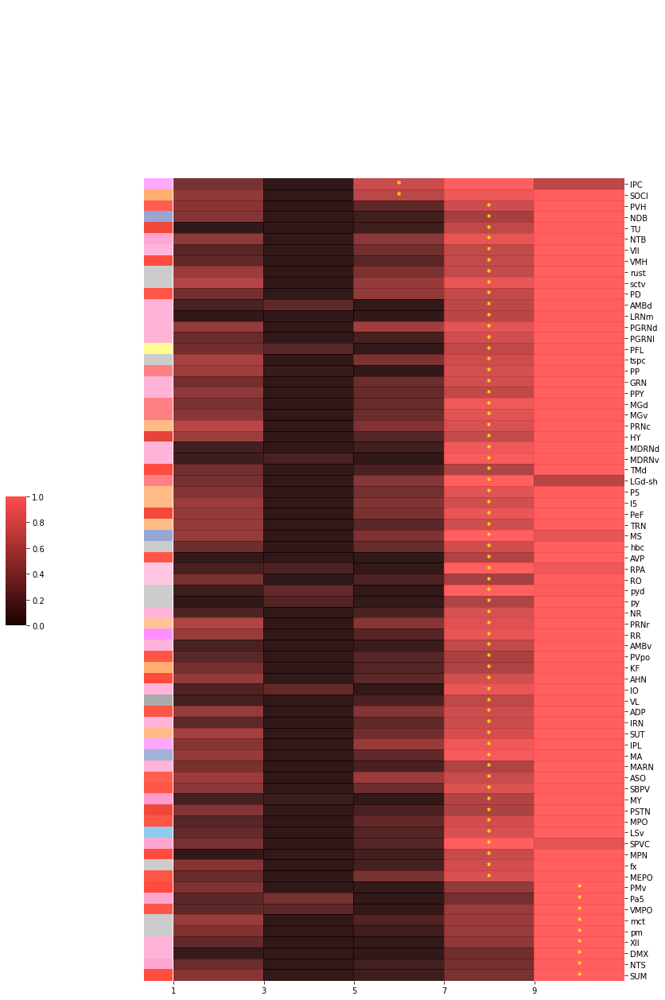

In [13]:
# Abeta increase
# APP only

import pandas as pd

# CSVファイルを読み込む
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Abeta_increase.csv', index_col='atlasID')
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_increase.csv', index_col='atlasID')
X_all = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_all.csv', index_col='atlasID')
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_lire_ver_Abeta_increase_random_slice_1.csv', index_col='atlasID')

X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_increase.csv', index_col='atlasID')

X = X[~X.index.isin(X2.index)] # WTのatlasIDとのoverlapを消して、APP specificにする

category = "APP_specific_Iba1_increase_onset(m)"

import ruptures as rpt
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pandas as pd
import numpy as np
from matplotlib import rcParams

#data_GO = pd.read_csv(filepath_or_buffer="/data4/ds1_Imaging3/atlas_for_fig/GOvsID_6region_removed.csv", encoding="ms932", sep=",")

ids = data_GO["id"].astype(int).unique()

# フォントをDejaVu Sansに設定
rcParams['font.family'] = 'DejaVu Sans'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

months = np.array([1, 3, 5, 7, 9])  # 月数をインデックスとして使用

# Function to detect change points in each row using ruptures
def detect_change_points(data):
    change_points = []
    for index, row in data.iterrows():
        # Extract the values and convert to numpy array
        values = row.values.astype(float)
        # Create a change point detection model instance
        model = "l2"  # Using L2 norm (least squares)
        algo = rpt.Binseg(model=model, min_size=1, jump=1).fit(values)
        # Detect change point
        result = algo.predict(n_bkps=1)
        change_points.append(months[result[:-1]][0])
    return change_points

# Run the change point detection function
data = X.copy()
# Detect change points
change_points = detect_change_points(data)

# データフレームに変化点を追加
data['Change Points'] = change_points


cellome_onset[category] = np.nan  # 初期値としてNaNを設定

# 存在する変化点をcellome_onsetに追加
for atlas_id, change_point in zip(data.index, change_points):
    if atlas_id in cellome_onset.index:
        cellome_onset.at[atlas_id, category] = change_point

for atlas_id in ids:
    if atlas_id in X_all.index:
        cellome_onset.at[atlas_id, "1m_" + category] = X_all.loc[atlas_id, "APP_1m"]
        cellome_onset.at[atlas_id, "3m_" + category] = X_all.loc[atlas_id, "APP_3m"]
        cellome_onset.at[atlas_id, "5m_" + category] = X_all.loc[atlas_id, "APP_5m"]
        cellome_onset.at[atlas_id, "7m_" + category] = X_all.loc[atlas_id, "APP_7m"]
        cellome_onset.at[atlas_id, "9m_" + category] = X_all.loc[atlas_id, "APP_9m"]  

# カスタムカラーマップの作成
def create_custom_cmap():
    colors = [(0.1, 0.0, 0.0, 0.9),  (1, 0.3, 0.3, 0.90)]
    cmap_name = "custom_cmap"
    # Create a colormap with interpolation between specified colors
    cmap = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)
    return cmap

# Using the new custom colormap
cmap = create_custom_cmap()

# 行ごとに正規化
normalized_data = data.iloc[:, :-1].apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1)

# 行ごとに変化点月齢を強調するためのデータフレームを作成
stars = data.iloc[:, :-1].copy().astype(str)
stars[:] = ''  # 全てのセルを空文字列に設定
for i, cp in enumerate(change_points):
    month_col_cp = f'APP_{cp}m'
    if month_col_cp in stars.columns:
        stars.at[data.index[i], month_col_cp] = '*'

# 変化点でソート
sorted_indices = np.argsort(change_points)
sorted_normalized_data = normalized_data.iloc[sorted_indices]
sorted_stars = stars.iloc[sorted_indices]

# acronymのインデックスを追加
acronyms = data_id.set_index('id').loc[sorted_normalized_data.index, 'acronym']

colorlist = []
colorlist_671 = []

for atlas_id in sorted_normalized_data.index:
    for i in range(671):
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# プロット
height = (17/55) * len(X)
g = sns.clustermap(sorted_normalized_data, cmap=cmap, row_colors=colorlist_671, vmin=0, vmax=1, row_cluster=False, col_cluster=False, annot=sorted_stars, fmt='', annot_kws={"size": 10, "weight": "bold", "color": "yellow"}, figsize=(12, height))
# 行ラベルをacronymに置き換え
g.ax_heatmap.set_yticklabels(acronyms)
g.ax_heatmap.yaxis.set_tick_params(rotation=0)
# x軸ラベルを変更
new_labels = ['1', '3', '5', '7', '9']
g.ax_heatmap.set_xticks(np.arange(len(new_labels)))  # Ensure there are correct number of ticks
g.ax_heatmap.set_xticklabels(new_labels)

# 不要な右端の縦軸ラベルを削除
g.ax_heatmap.set_ylabel('')

g.cax.set_position([.0, .4, .03, .1])  # [left, bottom, width, height]

plt.show()


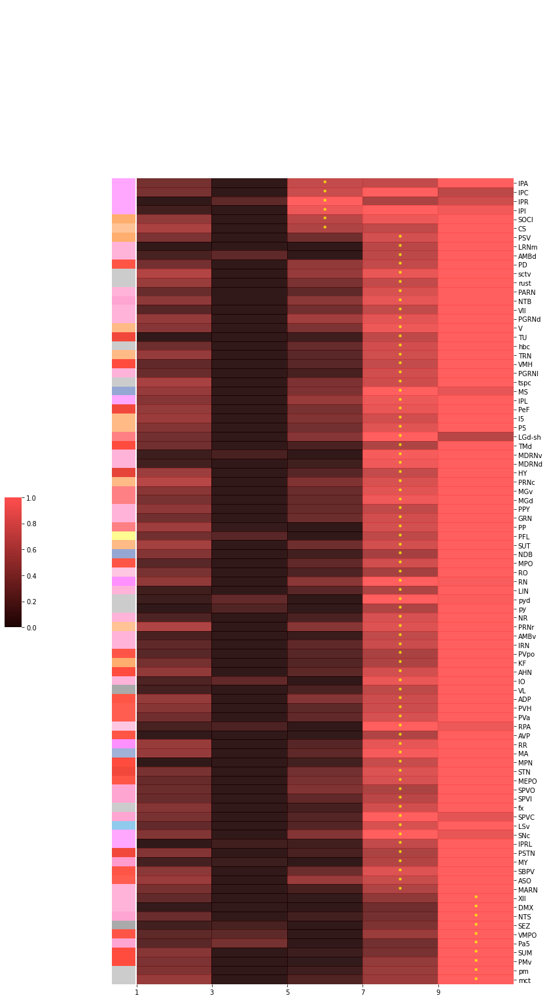

In [14]:
# Abeta increase
# APP only

import pandas as pd

# CSVファイルを読み込む
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Abeta_increase.csv', index_col='atlasID')
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_increase.csv', index_col='atlasID')
X_all = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_all.csv', index_col='atlasID')
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_lire_ver_Abeta_increase_random_slice_1.csv', index_col='atlasID')

#X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_increase.csv', index_col='atlasID')

#X = X[~X.index.isin(X2.index)] # WTのatlasIDとのoverlapを消して、APP specificにする

category = "APP_Iba1_increase_onset(m)"

import ruptures as rpt
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pandas as pd
import numpy as np
from matplotlib import rcParams

#data_GO = pd.read_csv(filepath_or_buffer="/data4/ds1_Imaging3/atlas_for_fig/GOvsID_6region_removed.csv", encoding="ms932", sep=",")

ids = data_GO["id"].astype(int).unique()

# フォントをDejaVu Sansに設定
rcParams['font.family'] = 'DejaVu Sans'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

months = np.array([1, 3, 5, 7, 9])  # 月数をインデックスとして使用

# Function to detect change points in each row using ruptures
def detect_change_points(data):
    change_points = []
    for index, row in data.iterrows():
        # Extract the values and convert to numpy array
        values = row.values.astype(float)
        # Create a change point detection model instance
        model = "l2"  # Using L2 norm (least squares)
        algo = rpt.Binseg(model=model, min_size=1, jump=1).fit(values)
        # Detect change point
        result = algo.predict(n_bkps=1)
        change_points.append(months[result[:-1]][0])
    return change_points

# Run the change point detection function
data = X.copy()
# Detect change points
change_points = detect_change_points(data)

# データフレームに変化点を追加
data['Change Points'] = change_points


cellome_onset[category] = np.nan  # 初期値としてNaNを設定

# 存在する変化点をcellome_onsetに追加
for atlas_id, change_point in zip(data.index, change_points):
    if atlas_id in cellome_onset.index:
        cellome_onset.at[atlas_id, category] = change_point

for atlas_id in ids:
    if atlas_id in X_all.index:
        cellome_onset.at[atlas_id, "1m_" + category] = X_all.loc[atlas_id, "APP_1m"]
        cellome_onset.at[atlas_id, "3m_" + category] = X_all.loc[atlas_id, "APP_3m"]
        cellome_onset.at[atlas_id, "5m_" + category] = X_all.loc[atlas_id, "APP_5m"]
        cellome_onset.at[atlas_id, "7m_" + category] = X_all.loc[atlas_id, "APP_7m"]
        cellome_onset.at[atlas_id, "9m_" + category] = X_all.loc[atlas_id, "APP_9m"]  

# カスタムカラーマップの作成
def create_custom_cmap():
    colors = [(0.1, 0.0, 0.0, 0.9),  (1, 0.3, 0.3, 0.90)]
    cmap_name = "custom_cmap"
    # Create a colormap with interpolation between specified colors
    cmap = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)
    return cmap

# Using the new custom colormap
cmap = create_custom_cmap()

# 行ごとに正規化
normalized_data = data.iloc[:, :-1].apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1)

# 行ごとに変化点月齢を強調するためのデータフレームを作成
stars = data.iloc[:, :-1].copy().astype(str)
stars[:] = ''  # 全てのセルを空文字列に設定
for i, cp in enumerate(change_points):
    month_col_cp = f'APP_{cp}m'
    if month_col_cp in stars.columns:
        stars.at[data.index[i], month_col_cp] = '*'

# 変化点でソート
sorted_indices = np.argsort(change_points)
sorted_normalized_data = normalized_data.iloc[sorted_indices]
sorted_stars = stars.iloc[sorted_indices]

# acronymのインデックスを追加
acronyms = data_id.set_index('id').loc[sorted_normalized_data.index, 'acronym']

colorlist = []
colorlist_671 = []

for atlas_id in sorted_normalized_data.index:
    for i in range(671):
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# プロット
height = (17/55) * len(X)
g = sns.clustermap(sorted_normalized_data, cmap=cmap, row_colors=colorlist_671, vmin=0, vmax=1, row_cluster=False, col_cluster=False, annot=sorted_stars, fmt='', annot_kws={"size": 10, "weight": "bold", "color": "yellow"}, figsize=(12, height))
# 行ラベルをacronymに置き換え
g.ax_heatmap.set_yticklabels(acronyms)
g.ax_heatmap.yaxis.set_tick_params(rotation=0)
# x軸ラベルを変更
new_labels = ['1', '3', '5', '7', '9']
g.ax_heatmap.set_xticks(np.arange(len(new_labels)))  # Ensure there are correct number of ticks
g.ax_heatmap.set_xticklabels(new_labels)

# 不要な右端の縦軸ラベルを削除
g.ax_heatmap.set_ylabel('')

g.cax.set_position([.0, .4, .03, .1])  # [left, bottom, width, height]

plt.show()


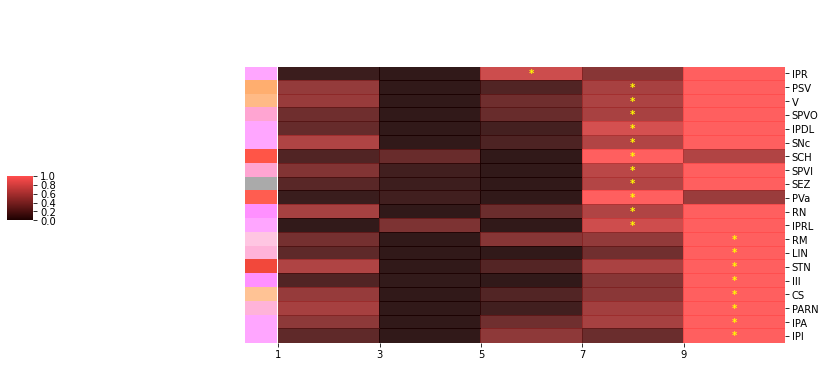

In [15]:
# Abeta increase
# APP only

import pandas as pd

# CSVファイルを読み込む
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Abeta_increase.csv', index_col='atlasID')
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_increase.csv', index_col='atlasID')
X_all = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_all.csv', index_col='atlasID')
#X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_lire_ver_Abeta_increase_random_slice_1.csv', index_col='atlasID')

#X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_increase.csv', index_col='atlasID')

#X = X[~X.index.isin(X2.index)] # WTのatlasIDとのoverlapを消して、APP specificにする

category = "WT_Iba1_increase_onset(m)"
X.columns = X.columns.str.replace("WT", "APP")
X_all.columns = X_all.columns.str.replace("WT", "APP")

import ruptures as rpt
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pandas as pd
import numpy as np
from matplotlib import rcParams

#data_GO = pd.read_csv(filepath_or_buffer="/data4/ds1_Imaging3/atlas_for_fig/GOvsID_6region_removed.csv", encoding="ms932", sep=",")

ids = data_GO["id"].astype(int).unique()

# フォントをDejaVu Sansに設定
rcParams['font.family'] = 'DejaVu Sans'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

months = np.array([1, 3, 5, 7, 9])  # 月数をインデックスとして使用

# Function to detect change points in each row using ruptures
def detect_change_points(data):
    change_points = []
    for index, row in data.iterrows():
        # Extract the values and convert to numpy array
        values = row.values.astype(float)
        # Create a change point detection model instance
        model = "l2"  # Using L2 norm (least squares)
        algo = rpt.Binseg(model=model, min_size=1, jump=1).fit(values)
        # Detect change point
        result = algo.predict(n_bkps=1)
        change_points.append(months[result[:-1]][0])
    return change_points

# Run the change point detection function
data = X.copy()
# Detect change points
change_points = detect_change_points(data)

# データフレームに変化点を追加
data['Change Points'] = change_points


cellome_onset[category] = np.nan  # 初期値としてNaNを設定

# 存在する変化点をcellome_onsetに追加
for atlas_id, change_point in zip(data.index, change_points):
    if atlas_id in cellome_onset.index:
        cellome_onset.at[atlas_id, category] = change_point

for atlas_id in ids:
    if atlas_id in X_all.index:
        cellome_onset.at[atlas_id, "1m_" + category] = X_all.loc[atlas_id, "APP_1m"]
        cellome_onset.at[atlas_id, "3m_" + category] = X_all.loc[atlas_id, "APP_3m"]
        cellome_onset.at[atlas_id, "5m_" + category] = X_all.loc[atlas_id, "APP_5m"]
        cellome_onset.at[atlas_id, "7m_" + category] = X_all.loc[atlas_id, "APP_7m"]
        cellome_onset.at[atlas_id, "9m_" + category] = X_all.loc[atlas_id, "APP_9m"]  

# カスタムカラーマップの作成
def create_custom_cmap():
    colors = [(0.1, 0.0, 0.0, 0.9),  (1, 0.3, 0.3, 0.90)]
    cmap_name = "custom_cmap"
    # Create a colormap with interpolation between specified colors
    cmap = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)
    return cmap

# Using the new custom colormap
cmap = create_custom_cmap()

# 行ごとに正規化
normalized_data = data.iloc[:, :-1].apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1)

# 行ごとに変化点月齢を強調するためのデータフレームを作成
stars = data.iloc[:, :-1].copy().astype(str)
stars[:] = ''  # 全てのセルを空文字列に設定
for i, cp in enumerate(change_points):
    month_col_cp = f'APP_{cp}m'
    if month_col_cp in stars.columns:
        stars.at[data.index[i], month_col_cp] = '*'

# 変化点でソート
sorted_indices = np.argsort(change_points)
sorted_normalized_data = normalized_data.iloc[sorted_indices]
sorted_stars = stars.iloc[sorted_indices]

# acronymのインデックスを追加
acronyms = data_id.set_index('id').loc[sorted_normalized_data.index, 'acronym']

colorlist = []
colorlist_671 = []

for atlas_id in sorted_normalized_data.index:
    for i in range(671):
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# プロット
height = (17/55) * len(X)
g = sns.clustermap(sorted_normalized_data, cmap=cmap, row_colors=colorlist_671, vmin=0, vmax=1, row_cluster=False, col_cluster=False, annot=sorted_stars, fmt='', annot_kws={"size": 10, "weight": "bold", "color": "yellow"}, figsize=(12, height))
# 行ラベルをacronymに置き換え
g.ax_heatmap.set_yticklabels(acronyms)
g.ax_heatmap.yaxis.set_tick_params(rotation=0)
# x軸ラベルを変更
new_labels = ['1', '3', '5', '7', '9']
g.ax_heatmap.set_xticks(np.arange(len(new_labels)))  # Ensure there are correct number of ticks
g.ax_heatmap.set_xticklabels(new_labels)

# 不要な右端の縦軸ラベルを削除
g.ax_heatmap.set_ylabel('')

g.cax.set_position([.0, .4, .03, .1])  # [left, bottom, width, height]

plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:71: UserWarning: FixedFormatter should only be used together with FixedLocator


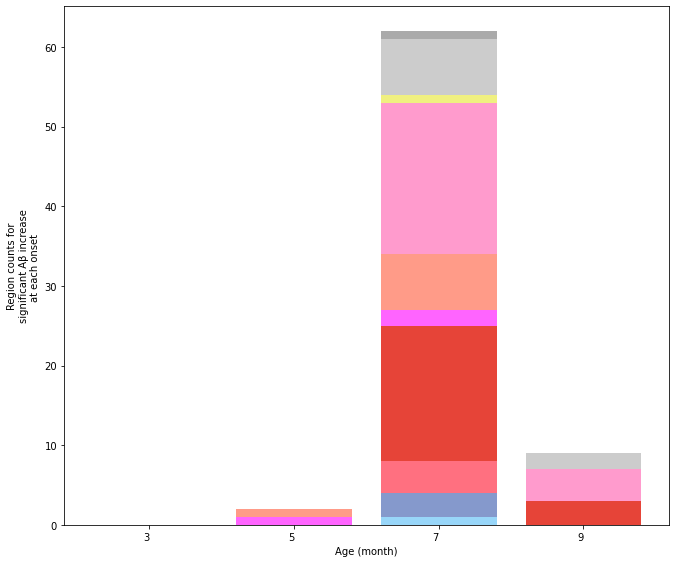

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define region labels and IDs
labels = ["Isocortex", "OLF", "HPF", "CTXsp", "STR", "PAL", "TH", "HY", "MB", "P", "MY", "CB", "fiber tracts", "VS"]
ids = [315, 698, 1089, 703, 477, 803, 549, 1097, 313, 771, 354, 512, 1009, 73]
colorlist = [(112, 255, 113), (154, 210, 189), (126, 208, 75), (138, 218, 135),
             (152, 214, 249), (133, 153, 204), (255, 112, 128), (230, 68, 56),
             (255, 100, 255), (255, 155, 136), (255, 155, 205), (240, 240, 128),
             (204, 204, 204), (170, 170, 170)]

oya_id = {i: [] for i in ids}

# Build the oya_id structure
for el in param_ana:
    temp_id = el['id']
    temp_path_id = el['structure_id_path']
    temp_oya_id = 997
    for ids_i in ids:
        if temp_path_id.count(ids_i) > 0:
            temp_oya_id = ids_i
    if temp_oya_id != 997:
        oya_id[temp_oya_id].append(temp_id)

# Data preparation function
def prepare_data(df, category1, category2):
    months = [3, 5, 7, 9]
    data_frames = [df[df[category1] == month] for month in months]
    histograms = [df[category2].dropna().value_counts().reindex(months, fill_value=0) for df in data_frames]
    combined_df = pd.DataFrame(histograms, index=[f'{m}' for m in months])
    return combined_df, data_frames

# Assign large regions
def assign_large_region(index, oya_id, large_regions):
    for i, region_id in enumerate(ids):
        if index in oya_id[region_id]:
            return large_regions[i]
    return 'Other'

# Group data by large regions
def assign_large_regions(df, oya_id, large_regions):
    df['large_region'] = df.index.map(lambda index: assign_large_region(index, oya_id, large_regions))
    return df

# Group and sum by large region (Fix the issue: ensure summing integer counts correctly)
def group_and_sum_by_large_region(df, large_regions):
    grouped_data = df.groupby('large_region').size()  # Use size to count instances per region, not sum actual values
    return grouped_data.reindex(large_regions, fill_value=0)

# Prepare data for each Abeta onset
histogram_data, data_frames = prepare_data(cellome_onset, "APP_specific_Iba1_increase_onset(m)", "APP_specific_Iba1_increase_onset(m)")

# Aggregate data by large regions for each onset
grouped_histogram_data = {}
for onset, data_frame in zip(histogram_data.index, data_frames):
    data_frame = data_frame.copy()
    data_frame = assign_large_regions(data_frame, oya_id, labels)
    grouped_histogram_data[onset] = group_and_sum_by_large_region(data_frame, labels)

# Stacked bar graph plotting
fig, ax = plt.subplots(figsize=(12, 8))

bottom = np.zeros(len(histogram_data.index))
for region, color in zip(labels, colorlist):
    values = [grouped_histogram_data[onset].loc[region] for onset in histogram_data.index]
    ax.bar(histogram_data.index, values, bottom=bottom, color=np.array(color)/255, label=region)
    bottom += values

# Set x-axis labels to be vertical
ax.set_xticklabels(histogram_data.index, ha='right', )#fontsize=15)

# Add black lines to the x and y axes
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')

ax.set_facecolor('none')
ax.grid(False)

plt.xlabel('Age (month)')
plt.ylabel('Region counts for\nsignificant Aβ increase\nat each onset ')

plt.tight_layout()
plt.subplots_adjust(left=0.25, right=0.95, top=0.95, bottom=0.05)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Onset_histogram_of_significantly_changed_Abeta_regions.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:71: UserWarning: FixedFormatter should only be used together with FixedLocator


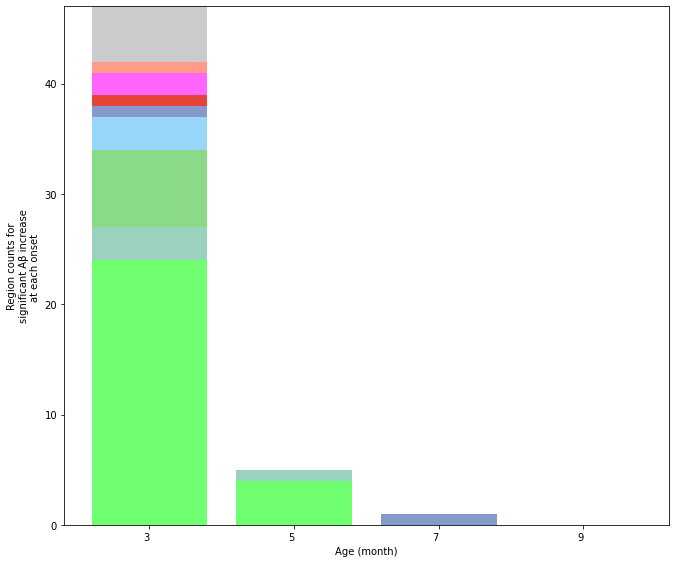

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Define region labels and IDs
labels = ["Isocortex", "OLF", "HPF", "CTXsp", "STR", "PAL", "TH", "HY", "MB", "P", "MY", "CB", "fiber tracts", "VS"]
ids = [315, 698, 1089, 703, 477, 803, 549, 1097, 313, 771, 354, 512, 1009, 73]
colorlist = [(112, 255, 113), (154, 210, 189), (126, 208, 75), (138, 218, 135),
             (152, 214, 249), (133, 153, 204), (255, 112, 128), (230, 68, 56),
             (255, 100, 255), (255, 155, 136), (255, 155, 205), (240, 240, 128),
             (204, 204, 204), (170, 170, 170)]

oya_id = {i: [] for i in ids}

# Build the oya_id structure
for el in param_ana:
    temp_id = el['id']
    temp_path_id = el['structure_id_path']
    temp_oya_id = 997
    for ids_i in ids:
        if temp_path_id.count(ids_i) > 0:
            temp_oya_id = ids_i
    if temp_oya_id != 997:
        oya_id[temp_oya_id].append(temp_id)

# Data preparation function
def prepare_data(df, category1, category2):
    months = [3, 5, 7, 9]
    data_frames = [df[df[category1] == month] for month in months]
    histograms = [df[category2].dropna().value_counts().reindex(months, fill_value=0) for df in data_frames]
    combined_df = pd.DataFrame(histograms, index=[f'{m}' for m in months])
    return combined_df, data_frames

# Assign large regions
def assign_large_region(index, oya_id, large_regions):
    for i, region_id in enumerate(ids):
        if index in oya_id[region_id]:
            return large_regions[i]
    return 'Other'

# Group data by large regions
def assign_large_regions(df, oya_id, large_regions):
    df['large_region'] = df.index.map(lambda index: assign_large_region(index, oya_id, large_regions))
    return df

# Group and sum by large region (Fix the issue: ensure summing integer counts correctly)
def group_and_sum_by_large_region(df, large_regions):
    grouped_data = df.groupby('large_region').size()  # Use size to count instances per region, not sum actual values
    return grouped_data.reindex(large_regions, fill_value=0)

# Prepare data for each Abeta onset
histogram_data, data_frames = prepare_data(cellome_onset, "APP_specific_Iba1_decrease_onset(m)", "APP_specific_Iba1_decrease_onset(m)")

# Aggregate data by large regions for each onset
grouped_histogram_data = {}
for onset, data_frame in zip(histogram_data.index, data_frames):
    data_frame = data_frame.copy()
    data_frame = assign_large_regions(data_frame, oya_id, labels)
    grouped_histogram_data[onset] = group_and_sum_by_large_region(data_frame, labels)

# Stacked bar graph plotting
fig, ax = plt.subplots(figsize=(12, 8))

bottom = np.zeros(len(histogram_data.index))
for region, color in zip(labels, colorlist):
    values = [grouped_histogram_data[onset].loc[region] for onset in histogram_data.index]
    ax.bar(histogram_data.index, values, bottom=bottom, color=np.array(color)/255, label=region)
    bottom += values

# Set x-axis labels to be vertical
ax.set_xticklabels(histogram_data.index, ha='right', )#fontsize=15)

# Add black lines to the x and y axes
ax.spines['bottom'].set_color('black')
ax.spines['left'].set_color('black')

ax.set_facecolor('none')
ax.grid(False)

plt.xlabel('Age (month)')
plt.ylabel('Region counts for\nsignificant Aβ increase\nat each onset ')

plt.tight_layout()
plt.subplots_adjust(left=0.25, right=0.95, top=0.95, bottom=0.05)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Onset_histogram_of_significantly_changed_Abeta_regions.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:103: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 


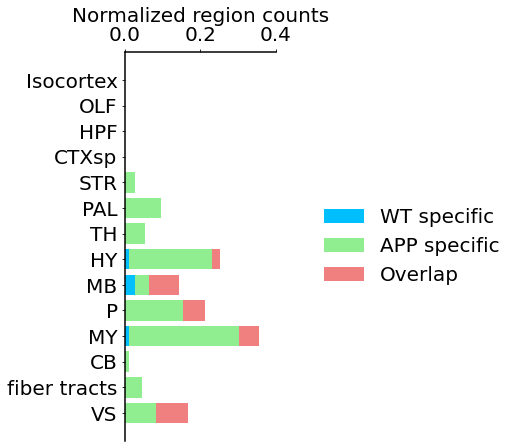

In [45]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# 領域ラベルとIDを定義
labels = ["Isocortex", "OLF", "HPF", "CTXsp", "STR", "PAL", "TH", "HY", "MB", "P", "MY", "CB", "fiber tracts", "VS"]
ids = [315, 698, 1089, 703, 477, 803, 549, 1097, 313, 771, 354, 512, 1009, 73]

# データを読み込み (increase 側のみ)
app_iba1_increase = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_increase.csv', index_col='atlasID')
wt_iba1_increase = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_increase.csv', index_col='atlasID')

# 各領域のWT-specific, APP-specific, Overlap, Not detectedのカテゴリに分類し正規化する関数
def classify_and_normalize_regions(app_data, wt_data, oya_id, parent_totals):
    wt_counts = []
    app_counts = []
    overlap_counts = []
    not_detected_counts = []

    for region_id in ids:
        app_regions = set(app_data.index.intersection(oya_id[region_id]))  # APP-specific領域
        wt_regions = set(wt_data.index.intersection(oya_id[region_id]))  # WT-specific領域

        app_only = app_regions - wt_regions
        wt_only = wt_regions - app_regions
        overlap = app_regions & wt_regions
        not_detected = set(oya_id[region_id]) - (app_regions | wt_regions)

        # 親領域に属する総領域数で正規化
        total_in_parent = parent_totals.get(region_id, 1)  # 親領域の総領域数を取得

        wt_counts.append(len(wt_only) / total_in_parent)
        app_counts.append(len(app_only) / total_in_parent)
        overlap_counts.append(len(overlap) / total_in_parent)
        not_detected_counts.append(len(not_detected) / total_in_parent)

    return wt_counts, app_counts, overlap_counts, not_detected_counts

# oya_id 構造を用いて領域ごとにデータを分類
oya_id = {i: [] for i in ids}

# 構造IDをoya_idに分類 (param_anaなどのデータから)
for el in param_ana:
    temp_id = el['id']
    temp_path_id = el['structure_id_path']
    temp_oya_id = 997
    for ids_i in ids:
        if temp_path_id.count(ids_i) > 0:
            temp_oya_id = ids_i
    if temp_oya_id != 997:
        oya_id[temp_oya_id].append(temp_id)

# 親領域に属する総領域数を計算
parent_region_totals = {region_id: len(oya_id[region_id]) for region_id in ids}

# 各領域ごとのWT specific, APP specific, Overlap, Not detectedを分類し正規化
wt_counts, app_counts, overlap_counts, not_detected_counts = classify_and_normalize_regions(app_iba1_increase, wt_iba1_increase, oya_id, parent_region_totals)

# 領域ラベルと対応するデータの順序を逆順にする
labels = labels[::-1]
wt_counts = wt_counts[::-1]
app_counts = app_counts[::-1]
overlap_counts = overlap_counts[::-1]
not_detected_counts = not_detected_counts[::-1]

# 棒グラフのプロット (y軸は各大領域)
fig, ax = plt.subplots(figsize=(3, 6))

# バーの幅
bar_width = 0.8
index = np.arange(len(labels))

# スタックされた棒グラフ
p1 = ax.barh(index, wt_counts, bar_width, label='WT specific', color='deepskyblue')
p2 = ax.barh(index, app_counts, bar_width, left=wt_counts, label='APP specific', color='lightgreen')
p3 = ax.barh(index, overlap_counts, bar_width, left=np.array(wt_counts) + np.array(app_counts), label='Overlap', color='lightcoral')
#p4 = ax.barh(index, not_detected_counts, bar_width, left=np.array(wt_counts) + np.array(app_counts) + np.array(overlap_counts), label='Not detected', color='lightgray')

# 軸ラベルとタイトル
ax.set_xlabel('Normalized region counts')
ax.set_xticks([0.0, 0.20, 0.40])
ax.set_yticks(index)
ax.set_yticklabels(labels)

# グラフのデザイン調整
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(True)

# スパインを太く設定
ax.spines['top'].set_linewidth(1.5)
ax.spines['left'].set_linewidth(1.5)

# x軸のティックを上部に配置
ax.xaxis.set_ticks_position('top')
ax.xaxis.set_label_position('top')

# 凡例をグラフから離して表示
ax.legend(loc='center left', bbox_to_anchor=(1.2, 0.5), frameon=False, fancybox=False, facecolor='none')

# レイアウト調整
plt.tight_layout()
plt.subplots_adjust(left=0.25, right=0.95, top=0.95, bottom=0.05)

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Large_region_wide_histogram_of_Normalized_Significantly_changed_Microglia_increase_regions.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:103: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 


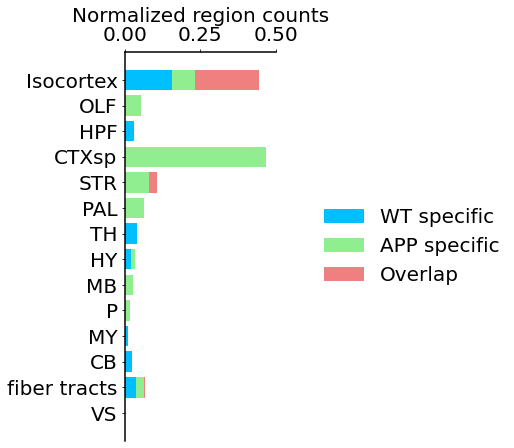

In [44]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# 領域ラベルとIDを定義
labels = ["Isocortex", "OLF", "HPF", "CTXsp", "STR", "PAL", "TH", "HY", "MB", "P", "MY", "CB", "fiber tracts", "VS"]
ids = [315, 698, 1089, 703, 477, 803, 549, 1097, 313, 771, 354, 512, 1009, 73]

# データを読み込み (increase 側のみ)
app_iba1_increase = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_raw_value_regions_Iba1_decrease.csv', index_col='atlasID')
wt_iba1_increase = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_raw_value_regions_Iba1_decrease.csv', index_col='atlasID')

# 各領域のWT-specific, APP-specific, Overlap, Not detectedのカテゴリに分類し正規化する関数
def classify_and_normalize_regions(app_data, wt_data, oya_id, parent_totals):
    wt_counts = []
    app_counts = []
    overlap_counts = []
    not_detected_counts = []

    for region_id in ids:
        app_regions = set(app_data.index.intersection(oya_id[region_id]))  # APP-specific領域
        wt_regions = set(wt_data.index.intersection(oya_id[region_id]))  # WT-specific領域

        app_only = app_regions - wt_regions
        wt_only = wt_regions - app_regions
        overlap = app_regions & wt_regions
        not_detected = set(oya_id[region_id]) - (app_regions | wt_regions)

        # 親領域に属する総領域数で正規化
        total_in_parent = parent_totals.get(region_id, 1)  # 親領域の総領域数を取得

        wt_counts.append(len(wt_only) / total_in_parent)
        app_counts.append(len(app_only) / total_in_parent)
        overlap_counts.append(len(overlap) / total_in_parent)
        not_detected_counts.append(len(not_detected) / total_in_parent)

    return wt_counts, app_counts, overlap_counts, not_detected_counts

# oya_id 構造を用いて領域ごとにデータを分類
oya_id = {i: [] for i in ids}

# 構造IDをoya_idに分類 (param_anaなどのデータから)
for el in param_ana:
    temp_id = el['id']
    temp_path_id = el['structure_id_path']
    temp_oya_id = 997
    for ids_i in ids:
        if temp_path_id.count(ids_i) > 0:
            temp_oya_id = ids_i
    if temp_oya_id != 997:
        oya_id[temp_oya_id].append(temp_id)

# 親領域に属する総領域数を計算
parent_region_totals = {region_id: len(oya_id[region_id]) for region_id in ids}

# 各領域ごとのWT specific, APP specific, Overlap, Not detectedを分類し正規化
wt_counts, app_counts, overlap_counts, not_detected_counts = classify_and_normalize_regions(app_iba1_increase, wt_iba1_increase, oya_id, parent_region_totals)

# 領域ラベルと対応するデータの順序を逆順にする
labels = labels[::-1]
wt_counts = wt_counts[::-1]
app_counts = app_counts[::-1]
overlap_counts = overlap_counts[::-1]
not_detected_counts = not_detected_counts[::-1]

# 棒グラフのプロット (y軸は各大領域)
fig, ax = plt.subplots(figsize=(3, 6))

# バーの幅
bar_width = 0.8
index = np.arange(len(labels))

# スタックされた棒グラフ
p1 = ax.barh(index, wt_counts, bar_width, label='WT specific', color='deepskyblue')
p2 = ax.barh(index, app_counts, bar_width, left=wt_counts, label='APP specific', color='lightgreen')
p3 = ax.barh(index, overlap_counts, bar_width, left=np.array(wt_counts) + np.array(app_counts), label='Overlap', color='lightcoral')
#p4 = ax.barh(index, not_detected_counts, bar_width, left=np.array(wt_counts) + np.array(app_counts) + np.array(overlap_counts), label='Not detected', color='lightgray')

# 軸ラベルとタイトル
ax.set_xlabel('Normalized region counts')
ax.set_xticks([0.0, 0.25, 0.50])
ax.set_yticks(index)
ax.set_yticklabels(labels)

# グラフのデザイン調整
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(True)

# スパインを太く設定
ax.spines['top'].set_linewidth(1.5)
ax.spines['left'].set_linewidth(1.5)

# x軸のティックを上部に配置
ax.xaxis.set_ticks_position('top')
ax.xaxis.set_label_position('top')

# 凡例をグラフから離して表示
ax.legend(loc='center left', bbox_to_anchor=(1.2, 0.5), frameon=False, fancybox=False, facecolor='none')

# レイアウト調整
plt.tight_layout()
plt.subplots_adjust(left=0.25, right=0.95, top=0.95, bottom=0.05)

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Large_region_wide_histogram_of_Normalized_Significantly_changed_Microglia_decrease_regions.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


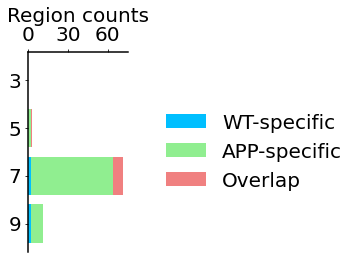

In [282]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# onsetごとのデータを集計する関数
def count_onsets(data, app_col, wt_col):
    months = [3, 5, 7, 9]  # 集計対象の月
    app_counts = {}
    wt_counts = {}
    overlap_counts = {}

    for month in months:
        # APP-specific: APP のみが該当
        app_only = data[(data[app_col] == month) & (pd.isna(data[wt_col]))].shape[0]
        # WT-specific: WT のみが該当
        wt_only = data[(data[wt_col] == month) & (pd.isna(data[app_col]))].shape[0]
        # Overlap: 両方が該当
        overlap = data[(data[app_col] == month) & (data[wt_col] == month)].shape[0]

        app_counts[month] = app_only
        wt_counts[month] = wt_only
        overlap_counts[month] = overlap

    return app_counts, wt_counts, overlap_counts

# APP-specific, WT-specific, Overlap のonsetごとのカウント
app_onset_counts, wt_onset_counts, overlap_onset_counts = count_onsets(cellome_onset, 'APP_Iba1_increase_onset(m)', 'WT_Iba1_increase_onset(m)')

# DataFrameにまとめる
onset_df = pd.DataFrame({
    'Month': [3, 5, 7, 9],
    'APP-specific': list(app_onset_counts.values()),
    'WT-specific': list(wt_onset_counts.values()),
    'Overlap': list(overlap_onset_counts.values())
})

# 逆順にするためにデータを反転
onset_df = onset_df.iloc[::-1]

# プロット (y軸はonset)
fig, ax = plt.subplots(figsize=(6, 4))

# バーの幅
bar_width = 0.8
index = np.arange(len(onset_df))

# APP-specific のバー
# WT-specific のバー
p1 = ax.barh(index, onset_df['WT-specific'], bar_width, label='WT-specific', color='deepskyblue')

# APP-specific のバー（WT-specific の上に積み上げる）
p2 = ax.barh(index, onset_df['APP-specific'], bar_width, left=onset_df['WT-specific'], label='APP-specific', color='lightgreen')

# Overlap のバー（APP-specific と WT-specific の上に積み上げる）
p3 = ax.barh(index, onset_df['Overlap'], bar_width, left=onset_df['APP-specific'] + onset_df['WT-specific'], label='Overlap', color='lightcoral')

# 軸ラベルとタイトル
ax.set_xlabel('Region counts')
ax.set_yticks(index)
ax.set_yticklabels(onset_df['Month'])
ax.set_xticks([0,  30, 60])

# グラフのデザイン調整
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(True)

# スパインを太く設定
ax.spines['top'].set_linewidth(1.5)
ax.spines['left'].set_linewidth(1.5)

# x軸のティックを上部に配置
ax.xaxis.set_ticks_position('top')
ax.xaxis.set_label_position('top')

# 凡例を表示
ax.legend(loc='center left', bbox_to_anchor=(1.2, 0.5), frameon=False, fancybox=False, facecolor='none')

# レイアウト調整
plt.tight_layout()

# PDFとして保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Onset_Histogram_Significantly_Changed_Microglia_increase_Regions.pdf', transparent=True, dpi=300)

plt.show()


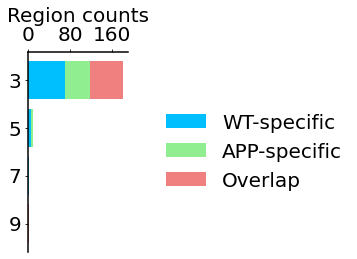

In [281]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# onsetごとのデータを集計する関数
def count_onsets(data, app_col, wt_col):
    months = [3, 5, 7, 9]  # 集計対象の月
    app_counts = {}
    wt_counts = {}
    overlap_counts = {}

    for month in months:
        # APP-specific: APP のみが該当
        app_only = data[(data[app_col] == month) & (pd.isna(data[wt_col]))].shape[0]
        # WT-specific: WT のみが該当
        wt_only = data[(data[wt_col] == month) & (pd.isna(data[app_col]))].shape[0]
        # Overlap: 両方が該当
        overlap = data[(data[app_col] == month) & (data[wt_col] == month)].shape[0]

        app_counts[month] = app_only
        wt_counts[month] = wt_only
        overlap_counts[month] = overlap

    return app_counts, wt_counts, overlap_counts

# APP-specific, WT-specific, Overlap のonsetごとのカウント
app_onset_counts, wt_onset_counts, overlap_onset_counts = count_onsets(cellome_onset, 'APP_Iba1_decrease_onset(m)', 'WT_Iba1_decrease_onset(m)')

# DataFrameにまとめる
onset_df = pd.DataFrame({
    'Month': [3, 5, 7, 9],
    'APP-specific': list(app_onset_counts.values()),
    'WT-specific': list(wt_onset_counts.values()),
    'Overlap': list(overlap_onset_counts.values())
})

# 逆順にするためにデータを反転
onset_df = onset_df.iloc[::-1]

# プロット (y軸はonset)
fig, ax = plt.subplots(figsize=(6, 4))

# バーの幅
bar_width = 0.8
index = np.arange(len(onset_df))

# WT-specific のバー
p1 = ax.barh(index, onset_df['WT-specific'], bar_width, label='WT-specific', color='deepskyblue')

# APP-specific のバー（WT-specific の上に積み上げる）
p2 = ax.barh(index, onset_df['APP-specific'], bar_width, left=onset_df['WT-specific'], label='APP-specific', color='lightgreen')

# Overlap のバー（WT-specific と APP-specific の上に積み上げる）
p3 = ax.barh(index, onset_df['Overlap'], bar_width, left=onset_df['WT-specific'] + onset_df['APP-specific'], label='Overlap', color='lightcoral')

# 軸ラベルとタイトル
ax.set_xlabel('Region counts')
ax.set_yticks(index)
ax.set_yticklabels(onset_df['Month'])
ax.set_xticks([0, 80, 160])

# グラフのデザイン調整
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(True)

# スパインを太く設定
ax.spines['top'].set_linewidth(1.5)
ax.spines['left'].set_linewidth(1.5)

# x軸のティックを上部に配置
ax.xaxis.set_ticks_position('top')
ax.xaxis.set_label_position('top')

# 凡例を表示
ax.legend(loc='center left', bbox_to_anchor=(1.2, 0.5), frameon=False, fancybox=False, facecolor='none')

# レイアウト調整
plt.tight_layout()

# PDFとして保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Onset_Histogram_Significantly_Changed_Microglia_decrease_Regions.pdf', transparent=True, dpi=300)

plt.show()


In [16]:
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius.tif")

In [93]:
output_path = "/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_400.tif"
tifffile.imwrite(output_path, image[400].astype(np.float32))

In [134]:
output_path = "/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_400.tif"
coronal_slice = image[:, 400 ,: ]
tifffile.imwrite(output_path, coronal_slice.astype(np.float32))

In [135]:
coronal_slice.shape

(800, 1140)

In [17]:
import tifffile
import numpy as np

# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[400].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_3D.tif"
tifffile.imwrite(output_path, coronal_3d.astype(np.float32))


(800, 1140)


In [18]:
import tifffile
import numpy as np

slice_num = 668
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


In [15]:
import tifffile
import numpy as np

slice_num = 670
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


In [67]:
import tifffile
import numpy as np

slice_num = 435
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


In [68]:
import tifffile
import numpy as np

slice_num = 935
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


In [69]:
import tifffile
import numpy as np

slice_num = 1200
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


findfont: Font family ['DejaVu Sans'] not found. Falling back to Helvetica.


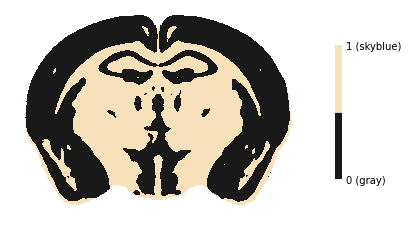

In [14]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

slice_num = 670

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# カスタムカラーマップ作成
cmap = ListedColormap(['black', 'wheat'])

# 画像を表示するための設定
fig, ax = plt.subplots(figsize=(6, 6))

# カスタムカラーマップを使用して画像を表示
im = ax.imshow(masked_image, cmap=cmap, vmin=0, vmax=1, alpha = 0.9)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定（0=gray, 1=skyblue）
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示
cbar.set_ticks([0, 1])  # カラーバーの目盛り位置
cbar.set_ticklabels(['0 (gray)', '1 (skyblue)'])  # カラーバーのラベル

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_Mask_670.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


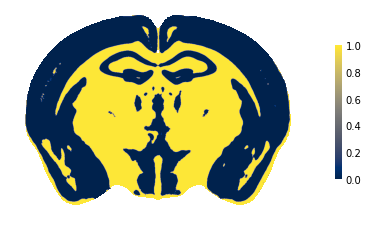

In [114]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np

slice_num = 668
# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap='cividis', vmin=0, vmax=1)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_Mask_668.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


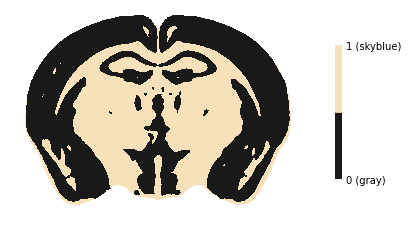

In [156]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

slice_num = 668

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# カスタムカラーマップ作成
cmap = ListedColormap(['black', 'wheat'])

# 画像を表示するための設定
fig, ax = plt.subplots(figsize=(6, 6))

# カスタムカラーマップを使用して画像を表示
im = ax.imshow(masked_image, cmap=cmap, vmin=0, vmax=1, alpha = 0.9)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定（0=gray, 1=skyblue）
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示
cbar.set_ticks([0, 1])  # カラーバーの目盛り位置
cbar.set_ticklabels(['0 (gray)', '1 (skyblue)'])  # カラーバーのラベル

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_Mask_668.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


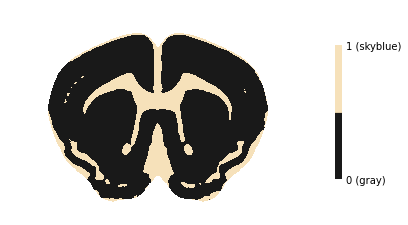

In [155]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

slice_num = 435

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# カスタムカラーマップ作成
cmap = ListedColormap(['black', 'wheat'])

# 画像を表示するための設定
fig, ax = plt.subplots(figsize=(6, 6))

# カスタムカラーマップを使用して画像を表示
im = ax.imshow(masked_image, cmap=cmap, vmin=0, vmax=1, alpha = 0.9)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定（0=gray, 1=skyblue）
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示
cbar.set_ticks([0, 1])  # カラーバーの目盛り位置
cbar.set_ticklabels(['0 (gray)', '1 (skyblue)'])  # カラーバーのラベル

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_Mask_435.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


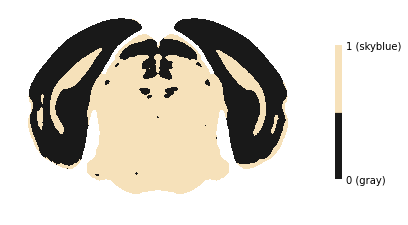

In [153]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

slice_num = 935

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# カスタムカラーマップ作成
cmap = ListedColormap(['black', 'wheat'])

# 画像を表示するための設定
fig, ax = plt.subplots(figsize=(6, 6))

# カスタムカラーマップを使用して画像を表示
im = ax.imshow(masked_image, cmap=cmap, vmin=0, vmax=1, alpha = 0.9)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定（0=gray, 1=skyblue）
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示
cbar.set_ticks([0, 1])  # カラーバーの目盛り位置
cbar.set_ticklabels(['0 (gray)', '1 (skyblue)'])  # カラーバーのラベル

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_Mask_935.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


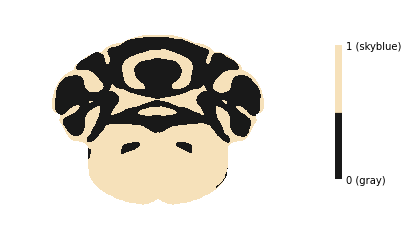

In [154]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap

slice_num = 1200

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/0.43812782_Threshed_Mask_WM_ver_Averaged_Neuron_ratio_10um_within100um_radius_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# カスタムカラーマップ作成
cmap = ListedColormap(['black', 'wheat'])

# 画像を表示するための設定
fig, ax = plt.subplots(figsize=(6, 6))

# カスタムカラーマップを使用して画像を表示
im = ax.imshow(masked_image, cmap=cmap, vmin=0, vmax=1, alpha = 0.9)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定（0=gray, 1=skyblue）
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示
cbar.set_ticks([0, 1])  # カラーバーの目盛り位置
cbar.set_ticklabels(['0 (gray)', '1 (skyblue)'])  # カラーバーのラベル

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_Mask_1200.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [62]:
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/distance_map_using_0.43812782_Threshed_Mask_WM.tif")

In [142]:
import tifffile
import numpy as np
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[400].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/distance_map_using_0.43812782_Threshed_Mask_WM_coronal_3D.tif"
tifffile.imwrite(output_path, coronal_3d.astype(np.float32))


(800, 1140)


In [34]:
import tifffile
import numpy as np

slice_num = 670
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/distance_map_using_0.43812782_Threshed_Mask_WM_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


In [65]:
import tifffile
import numpy as np

slice_num = 1200
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/distance_map_using_0.43812782_Threshed_Mask_WM_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


In [63]:
import tifffile
import numpy as np

slice_num = 485
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/distance_map_using_0.43812782_Threshed_Mask_WM_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


In [64]:
import tifffile
import numpy as np

slice_num = 935
# coronal方向の全スライスを取得する (正しい形状 [800, 1140, 1320] -> [800, 1140, 1320])
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/distance_map_using_0.43812782_Threshed_Mask_WM_coronal_" +str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))


(800, 1140)


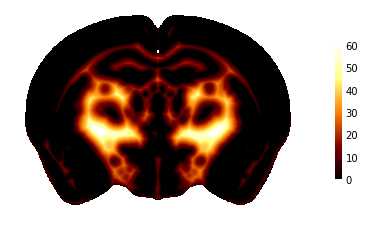

In [61]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np

slice_num = 670
# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/distance_map_using_0.43812782_Threshed_Mask_WM_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap='afmhot', vmin=0, vmax=60)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_WM_Distance_map_670.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [85]:
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM.tif")

In [239]:
import tifffile
import numpy as np
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[400].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_3D.tif"
tifffile.imwrite(output_path, coronal_3d.astype(np.float32))


(800, 1140)


In [86]:
import tifffile
import numpy as np

slice_num = 668
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [18]:
import tifffile
import numpy as np

slice_num = 670
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [73]:
import tifffile
import numpy as np

slice_num = 435
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [74]:
import tifffile
import numpy as np

slice_num = 935
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [75]:
import tifffile
import numpy as np

slice_num = 1200
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [22]:
import tifffile
import numpy as np

image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_label_WT_1m_2.tif")

slice_num = 670
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice"+str(slice_num) +"_WT_1m_2.tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [26]:
import tifffile
import numpy as np

image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_label_WT_3m_2.tif")

slice_num = 670
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice"+str(slice_num) +"_WT_3m_2.tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [28]:
import tifffile
import numpy as np

image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_label_WT_5m_2.tif")

slice_num = 670
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice"+str(slice_num) +"_WT_5m_2.tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [29]:
import tifffile
import numpy as np

image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_label_WT_7m_2.tif")

slice_num = 670
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice"+str(slice_num) +"_WT_7m_2.tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


In [30]:
import tifffile
import numpy as np

image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_label_WT_9m_2.tif")

slice_num = 670
coronal_3d = np.transpose(image, (1, 0, 2))  # 軸の順序を (1320, 1140, 800) -> (800, 1140, 1320) に変更
print(coronal_3d[slice_num].shape)  # これで (800, 1140) が出力される

# 3Dイメージを.tif形式で保存
output_path = "/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice"+str(slice_num) +"_WT_9m_2.tif"
tifffile.imwrite(output_path, coronal_3d[slice_num].astype(np.float32))

(800, 1140)


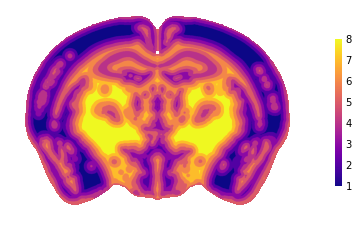

In [60]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np

slice_num = 670
# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap='plasma', vmin=1, vmax=8)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.022, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_8_mask_670.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


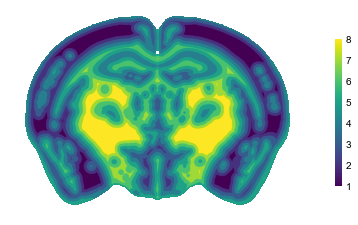

In [29]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np

slice_num = 670
# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_" +str(slice_num) +".tif")

# 0.0の部分を透明にするためにマスクを作成
image2 = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM_coronal_"+str(slice_num) +".tif")

masked_image = np.ma.masked_where(image2 == 0.0, image)

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap='viridis', vmin=1, vmax=8)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.022, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Coronal_8_mask_670.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [96]:
image.shape

(800, 1320, 1140)

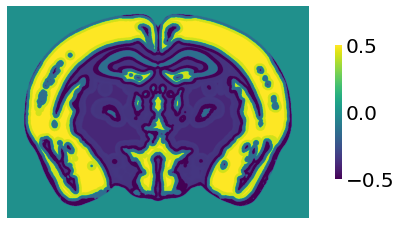

In [119]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice670_APP_1m_2_min_max.tif")

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示
im = ax.imshow(image, cmap='viridis', vmin=-0.5, vmax=0.5)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_1m_coronal_Microglia_gradient.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


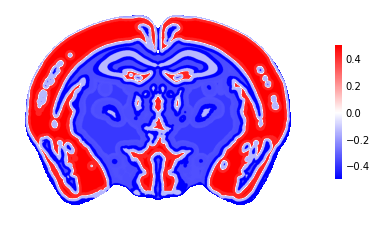

In [158]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice670_APP_1m_2_min_max.tif")

# 0.0の部分を透明にするためにマスクを作成
masked_image = np.ma.masked_where(image == 0.0, image)

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap='bwr', vmin=-0.5, vmax=0.5)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_1m_coronal_Microglia_gradient_transparent.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


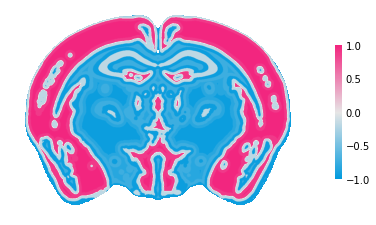

In [39]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice670_APP_1m_2.tif")

# 0.0の部分を透明にするためにマスクを作成
masked_image = np.ma.masked_where(image == 0.0, image)

# Apply the custom colormap
custom_cmap = create_custom_cmap()

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap=custom_cmap, vmin=-1, vmax=1)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_1m_coronal_Microglia_gradient_custom_transparent.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


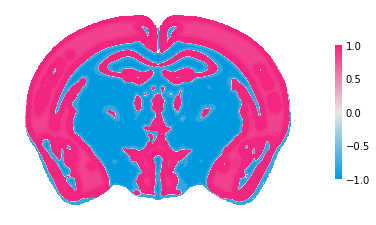

In [40]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice670_APP_3m_2.tif")

# 0.0の部分を透明にするためにマスクを作成
masked_image = np.ma.masked_where(image == 0.0, image)

# Apply the custom colormap
custom_cmap = create_custom_cmap()

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap=custom_cmap, vmin=-1, vmax=1)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_3m_coronal_Microglia_gradient_custom_transparent.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


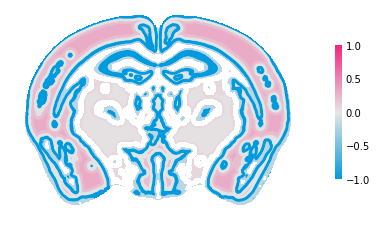

In [41]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice670_APP_5m_2.tif")

# 0.0の部分を透明にするためにマスクを作成
masked_image = np.ma.masked_where(image == 0.0, image)

# Apply the custom colormap
custom_cmap = create_custom_cmap()

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap=custom_cmap, vmin=-1, vmax=1)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_5m_coronal_Microglia_gradient_custom_transparent.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


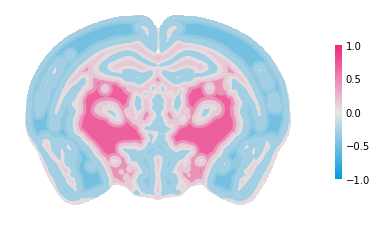

In [42]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice670_APP_7m_2.tif")

# 0.0の部分を透明にするためにマスクを作成
masked_image = np.ma.masked_where(image == 0.0, image)

# Apply the custom colormap
custom_cmap = create_custom_cmap()

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap=custom_cmap, vmin=-1, vmax=1)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_7m_coronal_Microglia_gradient_custom_transparent.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


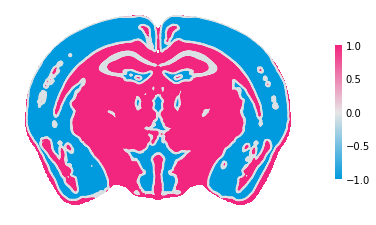

In [43]:
import tifffile
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors as mcolors

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

# 32bitのTIFFイメージを読み込む
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/WM_and_GM_value_by_mask_labelslice670_APP_9m_2.tif")

# 0.0の部分を透明にするためにマスクを作成
masked_image = np.ma.masked_where(image == 0.0, image)

# Apply the custom colormap
custom_cmap = create_custom_cmap()

# viridis カラーマップを適用して可視化
fig, ax = plt.subplots(figsize=(6, 6))

# 画像を表示、masked_arrayを使用し透明化を実現
im = ax.imshow(masked_image, cmap=custom_cmap, vmin=-1, vmax=1)

# 軸の表示をオフにする
ax.axis('off')

# カラーバーの設定
cbar = plt.colorbar(im, ax=ax, fraction=0.02, pad=0.08)  # fractionでcolor barの幅を調整
cbar.outline.set_visible(False)  # カラーバーの枠線を消す

# 不要な枠やラベルを削除する
cbar.ax.tick_params(size=0)  # カラーバーの目盛り線を削除
cbar.ax.yaxis.set_ticks_position('none')  # カラーバーの目盛りを非表示

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_9m_coronal_Microglia_gradient_custom_transparent.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [ ]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
import rpy2.robjects as ro
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    #try:
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # pdfClusterを実行
    r_code = '''
    library(MASS)
    model <- glm.nb('log_All_cell_count ~ Age', data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
    c(coef, p_value)
    '''
    #results_ <- summary(model)
    #results_ <- summary(model)
    #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
    #coef <- summary(model)$Coefficients["Genetic", "coef"]
    ro.r(r_code)

    results = ro.r(r_code)

    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    #except:
    #    coef, p_value = 0.0, 1.0
    #    print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4_WM_mask_ver1_volume_revised.csv"
            cellome_file2 = fw_dir_nu + "/Regional_cellome4_GM_mask_ver1_volume_revised.csv"
            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df["atlasID"] = df["atlasID"] + 4 #4
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
            if os.path.exists(cellome_file2):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file2)
                df["atlasID"] = 5 - df["atlasID"] #5 - df["atlasID"]
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = healthy_data['Iba1_cell_count'] / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1


def normalize_and_calculate_difference(data):
    # atlasIDごとにループ
    for atlas_id in data['atlasID'].unique():
        # 各年齢、各ジェネティックタイプに対して正規化を実行
        for age in data['Age'].unique():
            avg_ctr = data[(data['atlasID'] == atlas_id) & (data['Genetic'] == 0) & (data['Age'] == age)]['NeuN+ density (/mm3)'].mean()
            
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0)]['NeuN+ density (/mm3)'] - avg_ctr 
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1)]['NeuN+ density (/mm3)'] - avg_ctr
        #mini = data.loc[(data['atlasID'] == atlas_id), 'Normalized'].min()
        #data.loc[(data['atlasID'] == atlas_id),'Normalized'] = data.loc[(data['atlasID'] == atlas_id),'Normalized'].copy() - mini
    return data

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    #data['log_All_cell_count'] = np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000 #np.round(data['Iba1_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


0
0


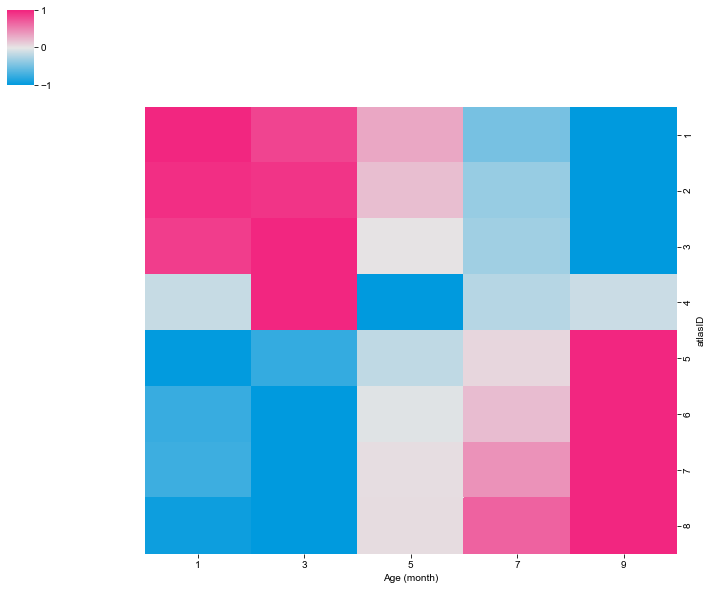

In [24]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m" ] for s in conditions[c]]
column_order = ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m" ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("APP_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_Microglia_gradient_heatmap.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [234]:
import os
import pandas as pd
import numpy as np
import json
from rpy2.robjects import pandas2ri, r
import rpy2.robjects as robjects

# Activate pandas to R conversion
pandas2ri.activate()

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
column_order = ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)]  # load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Convert to numeric values
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score, keeping the original column names intact
data_normalized = pd.DataFrame(zscore(data_pivot, axis=1, nan_policy='omit'), index=data_pivot.index, columns=data_pivot.columns)

# Check for unique 'atlasID' values to avoid reindexing issues
data_normalized = data_normalized.reset_index(drop=False)

# Verify columns exist in the DataFrame
assert all(col in data_normalized.columns for col in column_order), "One or more columns are missing in data_normalized."

# Add 'Age' column based on Condition
age_mapping = {'APP_1m': 1, 'APP_3m': 3, 'APP_5m': 5, 'APP_7m': 7, 'APP_9m': 9}
data_long = pd.melt(data_normalized, id_vars=['atlasID'], value_vars=column_order, var_name='Condition', value_name='log_All_cell_count')
data_long['Age'] = data_long['Condition'].map(age_mapping)

# Use atlasID as the mask value (representing distance from white matter)
data_long['Mask'] = data_long['atlasID']

# Drop any rows with missing data
data_long = data_long.dropna(subset=['log_All_cell_count'])

# Convert the pandas DataFrame to an R DataFrame
r_dataframe = pandas2ri.py2rpy(data_long)

# Assign R code to run linear regression using lm and extract Age:Mask interaction
r_code = """
    model <- lm(log_All_cell_count ~ Age * Mask, data = df)
    coef <- summary(model)$coefficients["Age:Mask", "Estimate"]
    p_value <- summary(model)$coefficients["Age:Mask", "Pr(>|t|)"]
    c(coef, p_value)
"""

# Push the dataframe to R
robjects.globalenv['df'] = r_dataframe

# Run the R linear model and extract coefficient and p-value for Age:Mask
results = r(r_code)

# Extract the coefficient and p-value from R results
interaction_coef = results[0]
interaction_pvalue = results[1]

print(f"Interaction term (Age:Mask) coefficient: {interaction_coef}")
print(f"Interaction term (Age:Mask) p-value: {interaction_pvalue}")


Interaction term (Age:Mask) coefficient: 0.12323772211181501
Interaction term (Age:Mask) p-value: 1.5899751232346357e-09


In [ ]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
import rpy2.robjects as ro
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    #try:
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # pdfClusterを実行
    r_code = '''
    library(MASS)
    model <- glm.nb('log_All_cell_count ~ Age', data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
    c(coef, p_value)
    '''
    #results_ <- summary(model)
    #results_ <- summary(model)
    #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
    #coef <- summary(model)$Coefficients["Genetic", "coef"]
    ro.r(r_code)

    results = ro.r(r_code)

    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    #except:
    #    coef, p_value = 0.0, 1.0
    #    print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4_WM_mask_ver1_volume_revised.csv"
            cellome_file2 = fw_dir_nu + "/Regional_cellome4_GM_mask_ver1_volume_revised.csv"
            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df["atlasID"] = df["atlasID"] + 4 #4
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
            if os.path.exists(cellome_file2):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file2)
                df["atlasID"] = 5 - df["atlasID"] #5 - df["atlasID"]
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = healthy_data['Iba1_cell_count'] / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1


def normalize_and_calculate_difference(data):
    # atlasIDごとにループ
    for atlas_id in data['atlasID'].unique():
        # 各年齢、各ジェネティックタイプに対して正規化を実行
        for age in data['Age'].unique():
            avg_ctr = data[(data['atlasID'] == atlas_id) & (data['Genetic'] == 0) & (data['Age'] == age)]['NeuN+ density (/mm3)'].mean()
            
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0)]['NeuN+ density (/mm3)'] - avg_ctr 
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1)]['NeuN+ density (/mm3)'] - avg_ctr
        #mini = data.loc[(data['atlasID'] == atlas_id), 'Normalized'].min()
        #data.loc[(data['atlasID'] == atlas_id),'Normalized'] = data.loc[(data['atlasID'] == atlas_id),'Normalized'].copy() - mini
    return data

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000
    #data['log_All_cell_count'] = np.round(data['NeuN_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


0
0


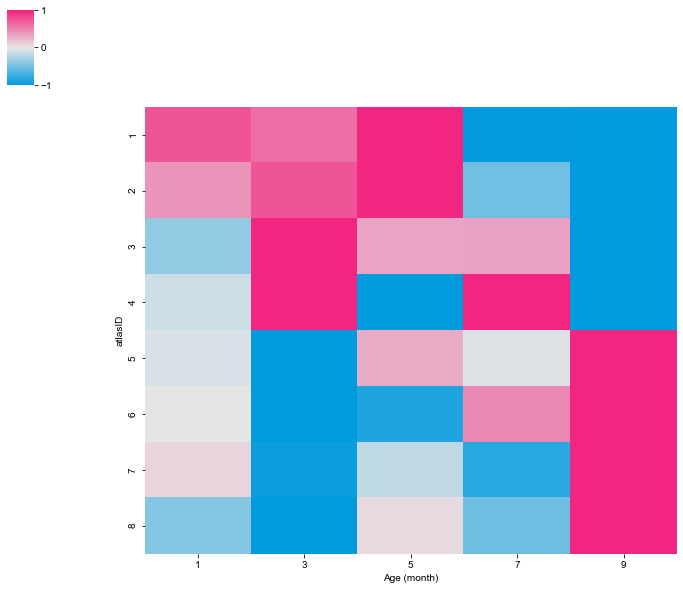

In [28]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
column_order = ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("WT_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# Move atlasID to the left side
clustergrid.ax_heatmap.yaxis.tick_left()  # Move y-axis labels to the left
clustergrid.ax_heatmap.yaxis.set_label_position("left")  # Set the y-axis label position to left

# PDFとして図を保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_Microglia_gradient_heatmap.pdf', 
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [226]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
from scipy.stats import zscore
import json

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m"] for s in conditions[c]]
column_order = ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m"]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)]  # load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Convert to numeric values
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score, keeping the original column names intact
data_normalized = pd.DataFrame(zscore(data_pivot, axis=1, nan_policy='omit'), index=data_pivot.index, columns=data_pivot.columns)

# Check for unique 'atlasID' values to avoid reindexing issues
data_normalized = data_normalized.reset_index(drop=False)

# Verify columns exist in the DataFrame
assert all(col in data_normalized.columns for col in column_order), "One or more columns are missing in data_normalized."

# Add 'Age' column based on Condition
age_mapping = {'WT_1m': 1, 'WT_3m': 3, 'WT_5m': 5, 'WT_7m': 7, 'WT_9m': 9}
data_long = pd.melt(data_normalized, id_vars=['atlasID'], value_vars=column_order, var_name='Condition', value_name='log_All_cell_count')
data_long['Age'] = data_long['Condition'].map(age_mapping)

# Use atlasID as the mask value (representing distance from white matter)
data_long['Mask'] = data_long['atlasID']

# Drop any rows with missing data
data_long = data_long.dropna(subset=['log_All_cell_count'])

# Linear regression model with Age * Mask interaction term
X = sm.add_constant(data_long[['Age', 'Mask']])
X['Age*Mask'] = data_long['Age'] * data_long['Mask']
y = data_long['log_All_cell_count']

# Fit the model
model = sm.OLS(y, X).fit()

# Print the summary of the model
print(model.summary())

# Get the coefficient and p-value for the interaction term Age:Mask
interaction_coef = model.params['Age*Mask']
interaction_pvalue = model.pvalues['Age*Mask']

print(f"Interaction term (Age*Mask) coefficient: {interaction_coef}")
print(f"Interaction term (Age*Mask) p-value: {interaction_pvalue}")


                            OLS Regression Results                            
Dep. Variable:     log_All_cell_count   R-squared:                       0.359
Model:                            OLS   Adj. R-squared:                  0.306
Method:                 Least Squares   F-statistic:                     6.722
Date:                Wed, 11 Sep 2024   Prob (F-statistic):            0.00102
Time:                        17:48:07   Log-Likelihood:                -47.861
No. Observations:                  40   AIC:                             103.7
Df Residuals:                      36   BIC:                             110.5
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.0328      0.597      3.403      0.0

In [229]:
import os
import pandas as pd
import numpy as np
import json
from rpy2.robjects import pandas2ri, r
import rpy2.robjects as robjects

# Activate pandas to R conversion
pandas2ri.activate()

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["WT_1m", "WT_3m", "WT_5m", "WT_7m", "WT_9m"] for s in conditions[c]]
column_order = ["WT_1m", "WT_3m", "WT_5m", "WT_7m", "WT_9m"]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)]  # load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Convert to numeric values
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score, keeping the original column names intact
data_normalized = pd.DataFrame(zscore(data_pivot, axis=1, nan_policy='omit'), index=data_pivot.index, columns=data_pivot.columns)

# Check for unique 'atlasID' values to avoid reindexing issues
data_normalized = data_normalized.reset_index(drop=False)

# Verify columns exist in the DataFrame
assert all(col in data_normalized.columns for col in column_order), "One or more columns are missing in data_normalized."

# Add 'Age' column based on Condition
age_mapping = {'WT_1m': 1, 'WT_3m': 3, 'WT_5m': 5, 'WT_7m': 7, 'WT_9m': 9}
data_long = pd.melt(data_normalized, id_vars=['atlasID'], value_vars=column_order, var_name='Condition', value_name='log_All_cell_count')
data_long['Age'] = data_long['Condition'].map(age_mapping)

# Use atlasID as the mask value (representing distance from white matter)
data_long['Mask'] = data_long['atlasID']

# Drop any rows with missing data
data_long = data_long.dropna(subset=['log_All_cell_count'])

# Convert the pandas DataFrame to an R DataFrame
r_dataframe = pandas2ri.py2rpy(data_long)

# Assign R code to run linear regression using lm
r_code = """
    lm_result <- lm(log_All_cell_count ~ Age * Mask, data = df)
    summary(lm_result)
"""

# Push the dataframe to R
robjects.globalenv['df'] = r_dataframe

# Run the R linear model and print the results
lm_result = r(r_code)
print(lm_result)



Call:
lm(formula = log_All_cell_count ~ Age * Mask, data = df)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.55306 -0.57894 -0.03324  0.68320  1.31051 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.03277    0.59726   3.403 0.001646 ** 
Age         -0.40655    0.10397  -3.910 0.000391 ***
Mask        -0.46187    0.11828  -3.905 0.000397 ***
Age:Mask     0.09237    0.02059   4.487 7.13e-05 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.8439 on 36 degrees of freedom
Multiple R-squared:  0.359,	Adjusted R-squared:  0.3056 
F-statistic: 6.722 on 3 and 36 DF,  p-value: 0.00102




In [230]:
import os
import pandas as pd
import numpy as np
import json
from rpy2.robjects import pandas2ri, r
import rpy2.robjects as robjects

# Activate pandas to R conversion
pandas2ri.activate()

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["WT_1m", "WT_3m", "WT_5m", "WT_7m", "WT_9m"] for s in conditions[c]]
column_order = ["WT_1m", "WT_3m", "WT_5m", "WT_7m", "WT_9m"]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)]  # load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Convert to numeric values
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score, keeping the original column names intact
data_normalized = pd.DataFrame(zscore(data_pivot, axis=1, nan_policy='omit'), index=data_pivot.index, columns=data_pivot.columns)

# Check for unique 'atlasID' values to avoid reindexing issues
data_normalized = data_normalized.reset_index(drop=False)

# Verify columns exist in the DataFrame
assert all(col in data_normalized.columns for col in column_order), "One or more columns are missing in data_normalized."

# Add 'Age' column based on Condition
age_mapping = {'WT_1m': 1, 'WT_3m': 3, 'WT_5m': 5, 'WT_7m': 7, 'WT_9m': 9}
data_long = pd.melt(data_normalized, id_vars=['atlasID'], value_vars=column_order, var_name='Condition', value_name='log_All_cell_count')
data_long['Age'] = data_long['Condition'].map(age_mapping)

# Use atlasID as the mask value (representing distance from white matter)
data_long['Mask'] = data_long['atlasID']

# Drop any rows with missing data
data_long = data_long.dropna(subset=['log_All_cell_count'])

# Convert the pandas DataFrame to an R DataFrame
r_dataframe = pandas2ri.py2rpy(data_long)

# Assign R code to run linear regression using lm and extract Age:Mask interaction
r_code = """
    model <- lm(log_All_cell_count ~ Age * Mask, data = df)
    coef <- summary(model)$coefficients["Age:Mask", "Estimate"]
    p_value <- summary(model)$coefficients["Age:Mask", "Pr(>|t|)"]
    c(coef, p_value)
"""

# Push the dataframe to R
robjects.globalenv['df'] = r_dataframe

# Run the R linear model and extract coefficient and p-value for Age:Mask
results = r(r_code)

# Extract the coefficient and p-value from R results
interaction_coef = results[0]
interaction_pvalue = results[1]

print(f"Interaction term (Age:Mask) coefficient: {interaction_coef}")
print(f"Interaction term (Age:Mask) p-value: {interaction_pvalue}")


Interaction term (Age:Mask) coefficient: 0.09237379174600477
Interaction term (Age:Mask) p-value: 7.127950170468192e-05


Start time: 2024-10-02 18:46:09.199912


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd


0      0.873018
1      0.720804
2      0.616981
3      0.956640
4      0.350241
         ...   
666    0.811174
667    0.876828
668    0.838198
669    0.925824
670    0.795738
Name: dpt_pseudotime, Length: 671, dtype: float32


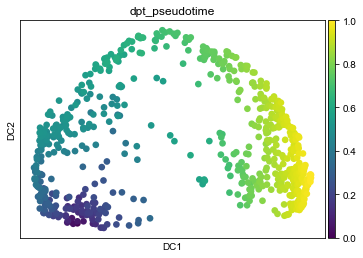

End time after X: 2024-10-02 18:46:09.670851
Duration for UMAP: 0:00:00.470939


In [507]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv', index_col='atlasID')

# 欠損値を各列の平均値で埋める
data_pivot = X#.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = data_pivot.apply(zscore, axis=1).fillna(0)

# 各行がリストになっているので、それを展開して2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定
adata.uns['iroot'] = 240#597 #532 #634

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()


# 実行時間の計測
end_time1 = datetime.datetime.now()
print("End time after X:", end_time1)
print("Duration for UMAP:", end_time1 - start_time)


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


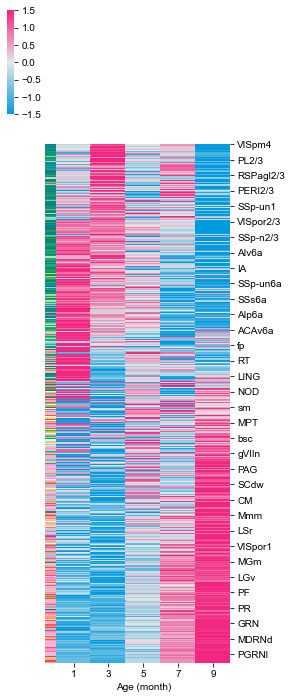

In [508]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


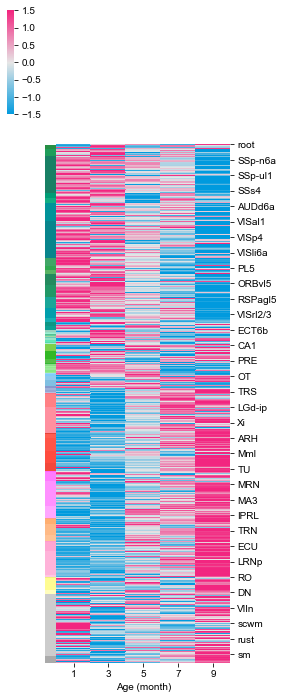

In [509]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df, cmap=cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


<Figure size 432x288 with 0 Axes>

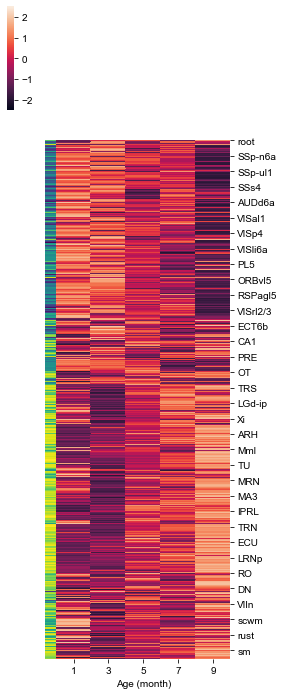

In [510]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# sorted_data_df.indexに対応するdpt_pseudotimeを取得するためにマッピング
sorted_pseudotime_full = pd.DataFrame(merged_data[['atlasID', 'dpt_pseudotime']])

# sorted_data_df のインデックス（atlasID）に基づいて pseudotime を並べ替える
sorted_pseudotime_full = sorted_pseudotime_full.set_index('atlasID').reindex(sorted_data_df.index)

# Viridisカラーマップを使って pseudotime_colors を設定
viridis = plt.cm.get_cmap('viridis', 256)
norm = plt.Normalize(vmin=0, vmax=1)
pseudotime_colors = viridis(norm(sorted_pseudotime_full['dpt_pseudotime']))

# プロットをクリアするために挿入
plt.clf()

# clustermapプロット
g = sns.clustermap(sorted_data_df, row_colors=pseudotime_colors, vmin=-2.5, vmax=2.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)

# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

if 1==0:
    # カラーバーの小さな軸を作成
    cbar_ax = g.fig.add_axes([1, 0.4, 0.025, 0.125])  # 左からの位置, 下からの位置, 横幅, 縦幅

    # カラーバーを設定
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=viridis), cax=cbar_ax, label='Pseudotime')

    # 枠線を消す
    cbar.outline.set_visible(False)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered_with_pseudotime_annotation.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


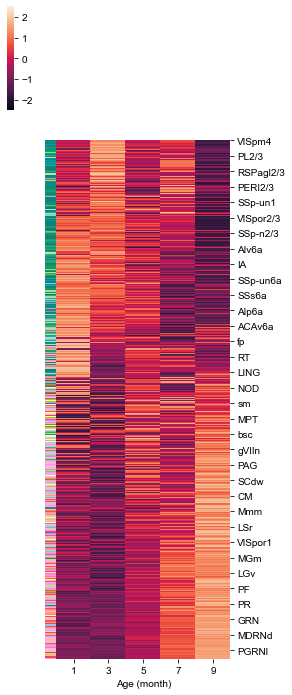

In [511]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    # Colors: cyan, black, yellow
    colors = ["#00ffff", "#000000", "#ffff00"]
    cmap_name = "custom_cmap"
    cmap = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)
    return cmap

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  row_colors=colorlist_671, vmin=-2.5, vmax=2.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:89: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


<Figure size 432x288 with 0 Axes>

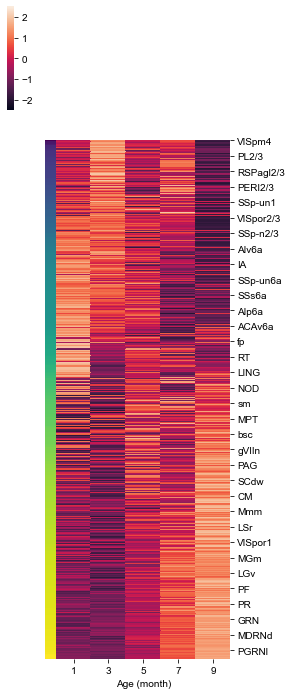

In [512]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# Viridisカラーマップを使ってpseudotimeの色を設定
viridis = plt.cm.get_cmap('viridis', 256)
norm = plt.Normalize(vmin=0, vmax=1)
pseudotime_colors = viridis(norm(sorted_pseudotime_full))

# プロットをクリアするために挿入
plt.clf()

# clustermapプロット
g = sns.clustermap(sorted_data_df, row_colors=pseudotime_colors, vmin=-2.5, vmax=2.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)

# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

if 1==0:
    # カラーバーの小さな軸を作成
    cbar_ax = g.fig.add_axes([1, 0.4, 0.025, 0.125])  # 左からの位置, 下からの位置, 横幅, 縦幅

    # カラーバーを設定
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=viridis), cax=cbar_ax, label='Pseudotime')

    # 枠線を消す
    cbar.outline.set_visible(False)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered_with_pseudotime_annotation.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


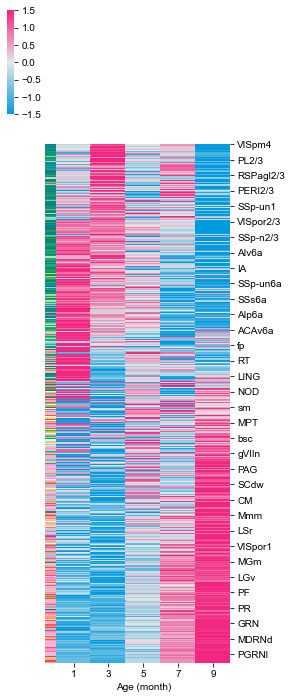

In [513]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


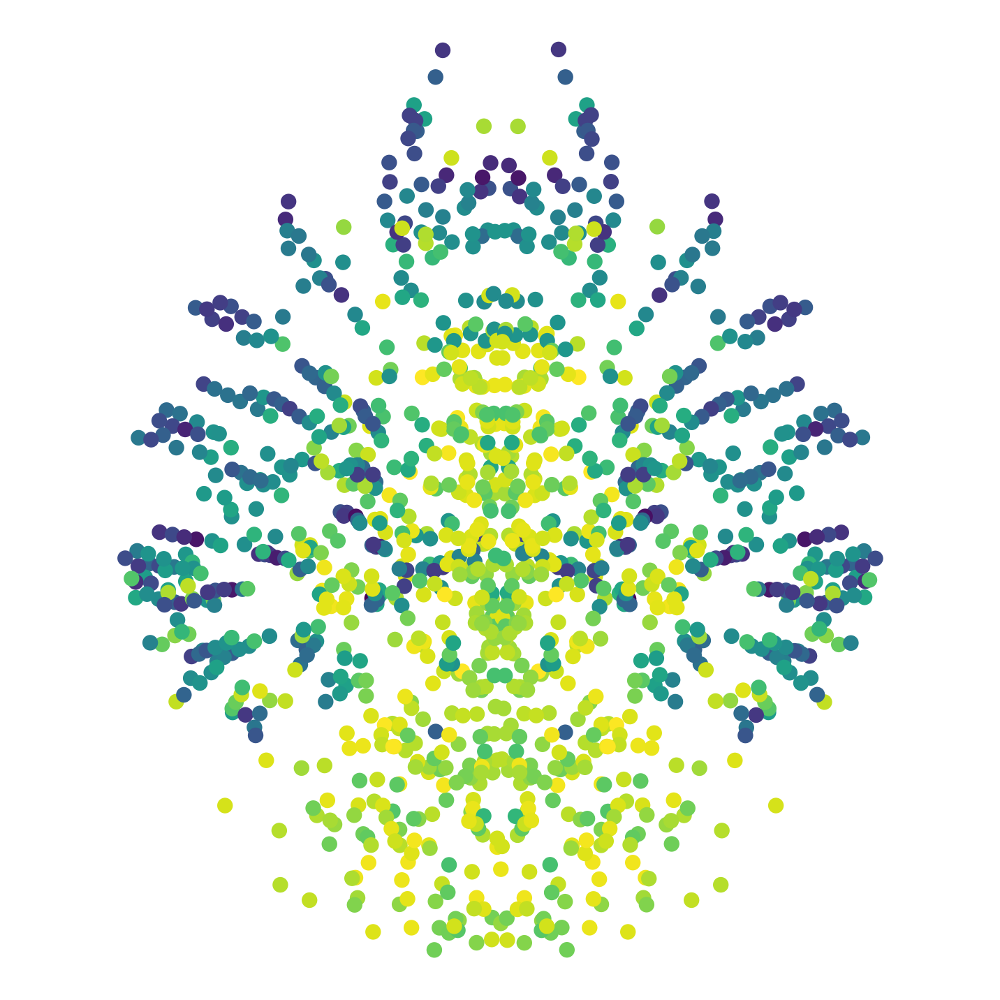

In [514]:
# atlasID が適切に設定されていることを確認する
# adata.obs に atlasID が含まれていることを前提にします
if 'atlasID' not in adata.obs.columns:
    adata.obs['atlasID'] = data_normalized.index

# pseudotime_df を adata.obs から作成し、インデックスを atlasID にする
pseudotime_df = pd.DataFrame(adata.obs[['atlasID', 'dpt_pseudotime']])

# pseudotime_df のインデックスを data_normalized のインデックス（atlasID）に基づいて設定
pseudotime_df = pseudotime_df.set_index('atlasID')

# data_normalized のインデックスに対応して pseudotime の値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['dpt_pseudotime'])

# pseudotime が NaN の場合は 0 で補完（必要に応じて）
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridis_rカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
#plt.title('Centroids of Left and Right Brain with Pseudotime Coloration')
#plt.xlabel('X (um)')
#plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.colorbar(sc, label='Pseudotime from Abeta PCA')  # カラーバーを追加
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Whole_brain_plot_of_Regional_Abeta_psedotime.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


In [ ]:
# WT

#4_APPmodel_Ctr1m_1_2022_1104_1550
#4_APPmodel_Ctr1m_2_2022_1108_959
#4_APPmodel_Ctr1m_3_2022_1209_1751
#5_APPmodel_Ctr3m_1_2023_0113_1230
#5_APPmodel_Ctr3m_2_2023_0210_1142
#5_APPmodel_Ctr3m_3_2023_0227_1605
#4_APPmodel_Ctr3m_4_2023_0427_1444
#4_APPmodel_Ctr5m_1_2022_1026_252
#4_APPmodel_Ctr5m_2_2022_1028_2336
#4_APPmodel_Ctr5m_3_2022_1101_140
#4_APPmodel_Ctr5m_4_2023_0512_2057
#5_APPmodel_Ctr7m_1_2023_0206_1534
#5_APPmodel_Ctr7m_2_2023_0313_1111
#5_APPmodel_Ctr7m_3_2023_0331_2139
#4_APPmodel_Ctr7m_4_2023_0516_1559
#5_APPmodel_Ctr7m_5_2023_0522_2218
#5_APPmodel_Ctr9m_1_2023_0130_1607
#5_APPmodel_Ctr9m_2_2023_0216_2052
#5_APPmodel_Ctr9m_3_2023_0322_2014
#5_APPmodel_Ctr9m_4_2023_0518_1449
997


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0005390147274577686, p-value: 0.9845922190182682
68
Coefficient: 0.0014870231283563816, p-value: 0.9900012372712923
667
Coefficient: 0.002393463809368362, p-value: 0.9812445165214689
52192
Coefficient: -0.0033883486009031664, p-value: 0.970248296441353
52196
Coefficient: -0.02521117727955063, p-value: 0.8766872483854156
52264
Coefficient: 0.0461841231879756, p-value: 0.979273530288158
320
Coefficient: -0.012191467330880904, p-value: 0.7909225839859749
943
Coefficient: -0.016281785752265337, p-value: 0.5415856741282047
648


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0176143043107044, p-value: 0.5371593111624403
844
Coefficient: -0.011630367648646806, p-value: 0.7112238172626644
882
Coefficient: -0.004793762059729173, p-value: 0.9713849159264648
656
Coefficient: -0.007294158847413882, p-value: 0.8313200946391663
962
Coefficient: -0.0037730367940847103, p-value: 0.8841398492621518
767
Coefficient: -0.007431023648086623, p-value: 0.7588632375245192
1021
Coefficient: -0.01212576193644882, p-value: 0.7219205463025838
1085
Coefficient: 0.0014230206108795523, p-value: 0.9945134072012584
558


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011071562218026904, p-value: 0.8874776393640564
838
Coefficient: -0.023417432186568547, p-value: 0.724880047057194
654
Coefficient: -0.01768222065498796, p-value: 0.8208946598488268
702
Coefficient: -0.025530073326160585, p-value: 0.7339237748166341
889
Coefficient: -0.018592254932576022, p-value: 0.7714806304751121
929
Coefficient: -0.020666229580901408, p-value: 0.9419129205687348
981
Coefficient: -0.020415243610897204, p-value: 0.694791710760462
201
Coefficient: -0.020603960263155956, p-value: 0.6235527475829317
1047


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013740135607401545, p-value: 0.7813013239490664
1070
Coefficient: -0.015987517877241585, p-value: 0.74943482138214
1038
Coefficient: -0.009463686248036968, p-value: 0.8490471938936724
1062
Coefficient: -0.016764831227334034, p-value: 0.9245860998776968
1030
Coefficient: -0.016393239047851824, p-value: 0.8739765827398749
113
Coefficient: -0.01941818211993788, p-value: 0.7742371903961113
1094
Coefficient: -0.013636639906752256, p-value: 0.8968994082263622
1128
Coefficient: -0.019560222575959466, p-value: 0.7807494478941878
478


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006662683572883788, p-value: 0.9349113497396795
510
Coefficient: -0.013232069053999146, p-value: 0.9658319537377862
878
Coefficient: -0.007025260055626769, p-value: 0.8941283295268996
657
Coefficient: -0.015393188196592559, p-value: 0.7102343024989931
950
Coefficient: -0.013787761659995373, p-value: 0.8084332061626667
974
Coefficient: -0.023984859311660514, p-value: 0.6115450083107866
1102
Coefficient: -0.02388248666763288, p-value: 0.571329264140795
2
Coefficient: -0.02174534805293831, p-value: 0.8990205427814635
450


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.015586415077278535, p-value: 0.8405867569097736
854
Coefficient: -0.02156493818038443, p-value: 0.6985474442552518
577
Coefficient: -0.014334759532866245, p-value: 0.8573801148238106
625
Coefficient: -0.022002844844352658, p-value: 0.7247239526297377
945
Coefficient: -0.012621958077195145, p-value: 0.8335622852648333
1026
Coefficient: -0.008102283059003224, p-value: 0.972313085546169
1006
Coefficient: -0.01959052246060549, p-value: 0.8671028350999163
670
Coefficient: -0.01860959661624567, p-value: 0.8234650173577358
1086


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.022853315842073698, p-value: 0.8727812971154829
1111
Coefficient: -0.017907513152697386, p-value: 0.8481017744487848
9
Coefficient: -0.008752490650600592, p-value: 0.9452823051771471
461
Coefficient: -0.012875708243282968, p-value: 0.97153570086657
18693
Coefficient: -0.026317103489932367, p-value: 0.8360247971249578
18697
Coefficient: -0.02271865084957996, p-value: 0.8133029485804038
18701
Coefficient: -0.012752328527375645, p-value: 0.9237354812268409
18705
Coefficient: -0.018555265378758724, p-value: 0.8707202122080986
18709


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01148017664691339, p-value: 0.9148720595411651
18713
Coefficient: -0.019748143308929652, p-value: 0.9626000697920243
873
Coefficient: -0.011430880174058715, p-value: 0.7950207566425035
806
Coefficient: -0.021869222359248448, p-value: 0.5394924908747467
1035
Coefficient: -0.014347987353046387, p-value: 0.7843009421647638
1090
Coefficient: -0.025357479975328997, p-value: 0.5082168684930917
862
Coefficient: -0.02688615407087758, p-value: 0.5158997089213957
893
Coefficient: -0.03124894335071458, p-value: 0.8258366928632921
36


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0016910129003327049, p-value: 0.9886730166576004
180
Coefficient: 0.023572622387759583, p-value: 0.7686617424649042
148
Coefficient: 0.020381259324082072, p-value: 0.8809007771373761
187
Coefficient: 3.041946192599204e-05, p-value: 0.9996633423562695
638
Coefficient: -0.01119046970129685, p-value: 0.8844272720748148
662
Coefficient: -0.015475486567030454, p-value: 0.9496052186718713
897
Coefficient: 7.144399852666988e-05, p-value: 0.9993618631117611
1106
Coefficient: -0.017674268369384648, p-value: 0.8086164109018944
1010


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01793993319756237, p-value: 0.8913129914713271
1058
Coefficient: -0.028746437527058407, p-value: 0.6665226350073737
857
Coefficient: -0.03611956344985302, p-value: 0.6545726887923098
849
Coefficient: -0.05168732730659537, p-value: 0.8394063480879606
527
Coefficient: -0.0029777066247784353, p-value: 0.9782152601345062
600
Coefficient: -0.016260858831296337, p-value: 0.8558285966566397
678
Coefficient: -0.0071458407499045435, p-value: 0.9595189081226453
252
Coefficient: -0.012595979459824254, p-value: 0.885191121992675
156


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01177190033545441, p-value: 0.9310605105121309
243
Coefficient: -0.030276025532775794, p-value: 0.9355067837622307
735
Coefficient: -0.011695832793517491, p-value: 0.8817318900711546
251
Coefficient: -0.018815776931913063, p-value: 0.8118987302079468
816
Coefficient: -0.012091244925247826, p-value: 0.9161900302563153
847
Coefficient: -0.018289838132573413, p-value: 0.7785337715810393
954
Coefficient: -0.013454862016294977, p-value: 0.9049675301666009
1005
Coefficient: -0.016584874975810716, p-value: 0.953813082109096
696


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011174593707290329, p-value: 0.9431524461375558
643
Coefficient: -0.008012448747794882, p-value: 0.9563059458038524
759
Coefficient: -0.009075464635988423, p-value: 0.9651500970029542
791
Coefficient: -0.01784360726752058, p-value: 0.8887010196169659
249
Coefficient: -0.007842924102526775, p-value: 0.9698246429190055
456
Coefficient: -0.005532041842973753, p-value: 0.9908238840298905
959
Coefficient: -0.007962543290705724, p-value: 0.9325522952522852
755
Coefficient: -0.021415207842446576, p-value: 0.8092443192895393
990


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02804788615662234, p-value: 0.8227871394321211
1023
Coefficient: -0.028319356845001455, p-value: 0.6998265271700825
520
Coefficient: -0.021661118061212715, p-value: 0.8570856260859823
598
Coefficient: -0.024477451461193532, p-value: 0.9387874957990348
1074
Coefficient: -0.00890361371166167, p-value: 0.9526180616687986
905
Coefficient: -0.018717008962246495, p-value: 0.8783728400728951
1114
Coefficient: -0.009574503380151969, p-value: 0.9545587688031051
233
Coefficient: -0.014580735631188778, p-value: 0.9023173288242393
601


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010946049313957018, p-value: 0.9499008115587338
649
Coefficient: 0.0006174509363513703, p-value: 0.9988458770084617
281
Coefficient: 0.005955982941967603, p-value: 0.9656203737863822
1066
Coefficient: -0.022462088784975492, p-value: 0.8384955973351368
401
Coefficient: -0.019154279825994984, p-value: 0.929473566318618
433
Coefficient: -0.02325052630693953, p-value: 0.8249329629132521
1046
Coefficient: -0.012333680520714627, p-value: 0.9344183628261894
441
Coefficient: -0.013559096501271344, p-value: 0.9733683287308577
421


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.008186832757237823, p-value: 0.9478213481153646
973
Coefficient: -0.024080771187966463, p-value: 0.8133192194494243
573
Coefficient: -0.01740579483377079, p-value: 0.8955897140129716
613
Coefficient: -0.028238179631336367, p-value: 0.7673098405539557
74
Coefficient: -0.018421373436967665, p-value: 0.8863946193398164
121
Coefficient: -0.004725863173665792, p-value: 0.9884955862096532
593
Coefficient: -0.006007781395622324, p-value: 0.8962981315527471
821
Coefficient: -0.013207690720168603, p-value: 0.7388849677342152
721


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01452719722006786, p-value: 0.7976517763620792
778
Coefficient: -0.01636153172411714, p-value: 0.710781585610894
33
Coefficient: -0.006949922609814082, p-value: 0.9045829168523569
305
Coefficient: 0.0020116716547556143, p-value: 0.9900960996662157
750
Coefficient: -0.004012930718056262, p-value: 0.9718009332107648
269
Coefficient: -0.019645379244853257, p-value: 0.8785420076663957
869
Coefficient: -0.014978351866424698, p-value: 0.9621602778584768
902
Coefficient: -0.02121593964622176, p-value: 0.8652082396473457
377


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.019423365067123173, p-value: 0.9216999118597247
393
Coefficient: -0.015788794379515022, p-value: 0.9816593760561608
805
Coefficient: -0.005075399614683105, p-value: 0.9672108729098734
41
Coefficient: -0.020863799077984434, p-value: 0.8305491487349391
501
Coefficient: -0.019741022302312197, p-value: 0.9118922471362501
565
Coefficient: -0.022800233598493938, p-value: 0.8217673854303118
257
Coefficient: -0.011338298719113415, p-value: 0.9410450294650216
469
Coefficient: 0.004776660245189423, p-value: 0.99025210871597
31578


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.034134663547530676, p-value: 0.865185193656538
31582
Coefficient: -0.02757604605183441, p-value: 0.8670239856230841
31586
Coefficient: -0.02140952764670516, p-value: 0.9285409602143382
31590
Coefficient: -0.02645970181638168, p-value: 0.8508825552888732
31594
Coefficient: -0.017702253228798773, p-value: 0.9321214368249057
31598
Coefficient: 0.0002966391097457105, p-value: 0.9995245044841425
31632
Coefficient: -0.0032747223300834917, p-value: 0.9741966118825901
31636
Coefficient: -0.009502550139060154, p-value: 0.919212540594543
31640


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02975851631124382, p-value: 0.8990048176629087
31644
Coefficient: -0.023201391767861332, p-value: 0.8133901862182843
31648
Coefficient: -0.01875750507134518, p-value: 0.9007260789019488
31652
Coefficient: -0.005287767101269293, p-value: 0.9879280867858276
935
Coefficient: -0.03168633517501134, p-value: 0.6322389353258326
211
Coefficient: -0.026354732616236096, p-value: 0.6909016374335456
1015
Coefficient: -0.017696259971983513, p-value: 0.7044514997927345
919
Coefficient: -0.011142691304916854, p-value: 0.86110448703383
927


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0021964227503965027, p-value: 0.9953425119626942
588
Coefficient: -0.034485619702231095, p-value: 0.6844108139494118
296
Coefficient: -0.027028789264607528, p-value: 0.7458186040874029
772
Coefficient: -0.014937885430119811, p-value: 0.7834235092181054
810
Coefficient: -0.00828640120722117, p-value: 0.93262303827672
819
Coefficient: 0.022044186072610456, p-value: 0.9335402241350369
171
Coefficient: -0.05169693976799689, p-value: 0.5005999168503728
304
Coefficient: -0.01773568644605581, p-value: 0.8277040729303524
363


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.015560724213986717, p-value: 0.7834223010756235
84
Coefficient: -0.014033876787483334, p-value: 0.8642528050270055
132
Coefficient: 0.0008509392402324884, p-value: 0.9980545813108214
707
Coefficient: 0.0018404986629664299, p-value: 0.9901453173574368
556
Coefficient: -0.00306057354683236, p-value: 0.9846868358662346
827
Coefficient: -0.013264357360931643, p-value: 0.8823692286008284
1054
Coefficient: -0.013618493627036758, p-value: 0.9066249667994423
1081
Coefficient: -0.00795545460661094, p-value: 0.9875621695353874
448


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0005701179450073678, p-value: 0.9953620199258674
412
Coefficient: -0.012229863153238157, p-value: 0.8624244212901999
630
Coefficient: -0.01924633105414282, p-value: 0.7102945379251118
440
Coefficient: -0.01599037235448705, p-value: 0.8422698752441107
488
Coefficient: -0.01240193761201849, p-value: 0.9629618927968531
484
Coefficient: -0.0330786363352295, p-value: 0.7494479207489966
582
Coefficient: -0.01132445666900411, p-value: 0.9047160922709684
620
Coefficient: -0.020007133411273376, p-value: 0.7936954082378209
910


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01331449492220992, p-value: 0.9177627683922391
52977
Coefficient: 0.006900431470432706, p-value: 0.9936376247841523
969
Coefficient: -0.0006909384540528398, p-value: 0.9945031272864641
288
Coefficient: 0.0011935587816237223, p-value: 0.9865452297348385
1125
Coefficient: -0.010403074808781543, p-value: 0.8754944363019449
608
Coefficient: -0.012306447041721675, p-value: 0.9135042476397729
680
Coefficient: 0.003740230741822035, p-value: 0.9944272399920063
996
Coefficient: -0.014724971023174662, p-value: 0.8738164465860518
328


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014851291823248097, p-value: 0.7945898423931724
1101
Coefficient: -0.03234595383913705, p-value: 0.4732789610025208
783
Coefficient: -0.02365899159332918, p-value: 0.6962932968600737
831
Coefficient: -0.022876680419949377, p-value: 0.9249563602045655
120
Coefficient: -0.003288120117250032, p-value: 0.9711972438730936
163
Coefficient: 0.005434684772525559, p-value: 0.9313664594139006
344
Coefficient: 0.005309281460103711, p-value: 0.931615709669041
314
Coefficient: 0.0019539552924347217, p-value: 0.9793007660679253
355


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.017858866965552743, p-value: 0.9591928320972948
704
Coefficient: -0.019739996896843724, p-value: 0.8818442904849835
694
Coefficient: -0.014167097292479782, p-value: 0.847808984006549
800
Coefficient: -0.039828976338992066, p-value: 0.5449516502606634
675
Coefficient: -0.019751402174607986, p-value: 0.8676738882172379
699
Coefficient: -0.012226103731040688, p-value: 0.9897590886608738
671
Coefficient: -0.014695736627266158, p-value: 0.8462724681769566
965
Coefficient: -0.01889024608223528, p-value: 0.7754342642711423
774


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.019787578043510827, p-value: 0.7510169294197215
906
Coefficient: -0.013547765935863824, p-value: 0.88252534936787
279
Coefficient: -0.0016260213558717156, p-value: 0.9964612301899554
442
Coefficient: -0.019475696854999648, p-value: 0.7274654029744889
434
Coefficient: -0.024420431316284026, p-value: 0.6687639680578135
610
Coefficient: -0.021091167957502058, p-value: 0.6838796097194761
274
Coefficient: -0.019348810444456466, p-value: 0.7763953788182023
330
Coefficient: -0.022184132801759716, p-value: 0.9562267369139287
542


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.045423159464632726, p-value: 0.409644147543918
430
Coefficient: -0.025303605091236026, p-value: 0.67928076593703
687
Coefficient: -0.020765512942708408, p-value: 0.647542184369508
590
Coefficient: -0.016078411243307767, p-value: 0.8426077221258725
622
Coefficient: -0.022507200486348508, p-value: 0.9481341437127699
31550
Coefficient: -0.029825653124258143, p-value: 0.7786780636083825
31554
Coefficient: -0.02352232922583141, p-value: 0.7730264280305985
31558
Coefficient: -0.01942401352423288, p-value: 0.8844733185648586
31562


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02024755749859008, p-value: 0.8170958615425085
31566
Coefficient: -0.011535574177524682, p-value: 0.9248491824010091
31570
Coefficient: -0.0021748030397365542, p-value: 0.9945176338140899
31604
Coefficient: -0.01948118076842034, p-value: 0.8659603141214582
31608
Coefficient: -0.018826824676498332, p-value: 0.8458311589118929
31612
Coefficient: -0.012633274410292427, p-value: 0.9255232628104894
31616
Coefficient: -0.015375790396616856, p-value: 0.8844448417967901
31620
Coefficient: -0.009548755188469722, p-value: 0.9466781478520881
31624


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00777390015395506, p-value: 0.9825102051854268
97
Coefficient: -0.016992610643611832, p-value: 0.825815206753465
1127
Coefficient: -0.014397025052152172, p-value: 0.8276517856461101
234
Coefficient: -0.021403189295351458, p-value: 0.8352686974933454
289
Coefficient: -0.024860246717240984, p-value: 0.6716864138235383
729
Coefficient: -0.014117100047102288, p-value: 0.8674678524112049
786
Coefficient: -0.011809842980977946, p-value: 0.9574318608978029
540
Coefficient: 0.012197733125557013, p-value: 0.9152752110152294
888


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.017059335927975965, p-value: 0.8497838476684338
692
Coefficient: 0.007161134360730957, p-value: 0.9567159868076442
335
Coefficient: 0.02869578056596133, p-value: 0.8996160418499478
368
Coefficient: 0.017076501216189487, p-value: 0.973097018501655
836
Coefficient: -0.0271138928609875, p-value: 0.8096696354558922
427
Coefficient: -0.002664879467936078, p-value: 0.9732657721617669
988
Coefficient: -0.005488754750527567, p-value: 0.9431451659624481
977
Coefficient: 0.017737997256177897, p-value: 0.8416900585031798
1045


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.015428074414169591, p-value: 0.9492516358054625
698
Coefficient: 0.013795836391180184, p-value: 0.5671453227313161
507
Coefficient: 0.03982113723785729, p-value: 0.03418218327854501
188
Coefficient: 0.006335677006897271, p-value: 0.958439240095895
196
Coefficient: -0.015413054574521213, p-value: 0.8944688956682254
204
Coefficient: 0.017625165072516637, p-value: 0.8338330150494189
159
Coefficient: -0.022004570953594493, p-value: 0.35437682458014647
597
Coefficient: -0.007012727615116386, p-value: 0.9138859963826598
605


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00936009029317608, p-value: 0.8786375178058627
814
Coefficient: -0.00943109359046925, p-value: 0.9009059613698308
961
Coefficient: -0.0007718138415145052, p-value: 0.9631918985930048
260
Coefficient: 0.026001161831126208, p-value: 0.8952037777666959
268
Coefficient: 0.01726826143557865, p-value: 0.9033089383075539
1139
Coefficient: 0.009208389774001366, p-value: 0.9679770074742301
639
Coefficient: 0.005829029558129213, p-value: 0.9275212211802941
655
Coefficient: 0.0239711599975292, p-value: 0.614938399794476
663


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01648287108839409, p-value: 0.6950244703551033
788
Coefficient: 0.007236890308946343, p-value: 0.9017322686234809
566
Coefficient: -0.001204098417653961, p-value: 0.9782648399879372
1089
Coefficient: -0.00035781152692455264, p-value: 0.996997143659297
382
Coefficient: 0.008450851112990394, p-value: 0.6263954812155039
423
Coefficient: 0.006567095775235643, p-value: 0.9406078423068074
463
Coefficient: 0.015621408019278686, p-value: 0.5160914316337666
10703


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010708130369165172, p-value: 0.6776479567090838
10704
Coefficient: 0.014645289624526561, p-value: 0.8200196720625413
632
Coefficient: 0.021126015070870318, p-value: 0.6404882492880366
982
Coefficient: -0.004366163505930175, p-value: 0.9861640170975083
19
Coefficient: -0.019908219598573605, p-value: 0.9100717649763979
1121
Coefficient: 0.007376841355384989, p-value: 0.8971716780542817
20
Coefficient: 0.022287013460937706, p-value: 0.5715927452924159
52
Coefficient: 0.013296772045475025, p-value: 0.7680486002494373
139


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.015146419335078726, p-value: 0.7324804491862494
28
Coefficient: 0.021643132125979812, p-value: 0.683700773323703
526
Coefficient: -0.028436146102863807, p-value: 0.5838708928825531
543
Coefficient: -0.020731786348055704, p-value: 0.6761005159015745
664
Coefficient: -0.023414231484979068, p-value: 0.688398892743326
727
Coefficient: -0.013630046005738009, p-value: 0.8279351811661966
743
Coefficient: -0.002720763173087335, p-value: 0.9720823456698503
843
Coefficient: -0.012461928010757146, p-value: 0.8314252335170438
1037


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014236059398796184, p-value: 0.810767910015863
1084
Coefficient: -0.0050619242124954975, p-value: 0.9388018752176166
502
Coefficient: -0.00474701176593293, p-value: 0.9031563713228759
48470
Coefficient: 0.0013306839621606904, p-value: 0.9769192018259113
58447
Coefficient: -0.018864706348465723, p-value: 0.8012821933085141
48508
Coefficient: -0.02743323637602245, p-value: 0.7902547378553768
703
Coefficient: 0.005926176177992446, p-value: 0.9441096338156534
583
Coefficient: -0.018058207657807773, p-value: 0.7885607762020335
952


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0002145676445077107, p-value: 0.9952625960324574
966
Coefficient: 0.012063633201701852, p-value: 0.8190528019308245
131
Coefficient: 0.008301026810385592, p-value: 0.8824216528116865
303
Coefficient: -0.00521546159946164, p-value: 0.9322534103036014
311
Coefficient: 0.010394145176290451, p-value: 0.8619653019985889
451
Coefficient: 0.012854463924773516, p-value: 0.8838521258688097
327
Coefficient: 0.021193918349989654, p-value: 0.7250578756039805
334
Coefficient: 0.013722010547715139, p-value: 0.8280291486772273
780


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.008453244037787732, p-value: 0.8718689700298209
477
Coefficient: 0.005529080984329563, p-value: 0.87471629049562
672
Coefficient: -0.014415996438865816, p-value: 0.16892400239345834
56
Coefficient: 0.0033184153437159827, p-value: 0.8933437811068845
998
Coefficient: -0.00444416548761669, p-value: 0.9534073422351463
754
Coefficient: 0.0016820565597830126, p-value: 0.9527796903724884
250
Coefficient: 0.025294768794204094, p-value: 0.7584449590382163
258
Coefficient: 0.010269234383406753, p-value: 0.811314456294321
266


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.024173178189766692, p-value: 0.7685902372287922
310
Coefficient: 0.016557848139809147, p-value: 0.8667401374638041
333
Coefficient: -0.0027401539036141045, p-value: 0.9931026773376279
23
Coefficient: 0.010810396933137482, p-value: 0.8937267093937669
292
Coefficient: -0.011053399710849192, p-value: 0.9737657563124391
544
Coefficient: 0.006132930114786841, p-value: 0.9479766778842366
551
Coefficient: 0.022888219951556262, p-value: 0.8327843004418181
559
Coefficient: 0.024286040626927716, p-value: 0.7006020385988299
1105


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.008289289458414418, p-value: 0.9467562907504536
403
Coefficient: 0.025119156558923262, p-value: 0.5276161629670699
803
Coefficient: -0.004207452717963177, p-value: 0.9392716215498301
1022
Coefficient: 0.0050240073030519755, p-value: 0.899697934807119
1031
Coefficient: 0.00454593417073242, p-value: 0.9550181860106607
342
Coefficient: 0.006109450204456806, p-value: 0.832352726345258
298
Coefficient: 0.027303584287102823, p-value: 0.7809398304001632
564
Coefficient: 0.013038117580046676, p-value: 0.9113960348656968
596


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.013424977017252655, p-value: 0.868751499557133
581
Coefficient: 0.018970733003820548, p-value: 0.8717919423860052
351
Coefficient: 0.024549629159505114, p-value: 0.6341752063189308
287
Coefficient: 0.021496089659264316, p-value: 0.9794077465531331
549
Coefficient: 0.006057423054510893, p-value: 0.9303353407137414
629
Coefficient: 0.006308915719709738, p-value: 0.9251557163524692
685
Coefficient: 0.006120569092027527, p-value: 0.9276532147161795
718
Coefficient: 0.013549026643736143, p-value: 0.8482754467383626
725


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.007022539689653512, p-value: 0.9743442221417916
733
Coefficient: 0.024793288082017046, p-value: 0.6398272227804183
741
Coefficient: -0.009248877620610396, p-value: 0.9465135722233344
56435
Coefficient: 0.002952840941510668, p-value: 0.9809628905323549
414
Coefficient: -0.0016061210929822396, p-value: 0.9946431605486317
422
Coefficient: 0.011507113603001601, p-value: 0.9493474352239497
609
Coefficient: 0.014343453479585083, p-value: 0.9390361601865519
1044
Coefficient: 0.007184675967492259, p-value: 0.9779284644000144
1072


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.006220595598539983, p-value: 0.9650696060150751
1079
Coefficient: 0.013058571056531593, p-value: 0.912375276340291
1088
Coefficient: 0.004107459844512564, p-value: 0.9763177258073102
49664
Coefficient: 0.01792000310336476, p-value: 0.9076646434815947
49668
Coefficient: 0.020466582005282914, p-value: 0.8529934750833231
49672
Coefficient: 0.019572520321983235, p-value: 0.9322338282982342
218
Coefficient: 0.001087570546102746, p-value: 0.9853241450639202
1020
Coefficient: -0.004935137185449078, p-value: 0.9297459703425868
1029


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.009699654070809204, p-value: 0.9449909458971166
325
Coefficient: -0.004981727191764503, p-value: 0.9731038479411034
56551
Coefficient: 0.0110609808250126, p-value: 0.9367244673960492
255
Coefficient: -0.003176855723117811, p-value: 0.9726411628297068
1096
Coefficient: -0.006134736900302527, p-value: 0.9591387337576507
1104
Coefficient: -0.004480892733435615, p-value: 0.9745873747955087
64
Coefficient: 0.010927041307545566, p-value: 0.9517717813207508
1120
Coefficient: -0.017024121963644914, p-value: 0.9527013259719882
1113


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004334506404902309, p-value: 0.9808725365547387
155
Coefficient: -0.010140036575304674, p-value: 0.8679001558862722
59
Coefficient: -0.001496005393684877, p-value: 0.9913341765273084
362
Coefficient: 0.001933150117866083, p-value: 0.9698636653716913
366
Coefficient: -0.004578682783193893, p-value: 0.9650761452972282
1077
Coefficient: -0.005425365693921405, p-value: 0.9724658525252168
149
Coefficient: 0.008420489243284425, p-value: 0.9292191031147623
15
Coefficient: 0.005873535888922348, p-value: 0.9653246895207241
181


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.002221050991807063, p-value: 0.9799300322509044
56559
Coefficient: 0.01126087560992066, p-value: 0.957866347263858
189
Coefficient: -0.0036137301255298486, p-value: 0.9854822298129264
599
Coefficient: -0.0014438105365965318, p-value: 0.9905018359424455
907
Coefficient: 0.002674409930145161, p-value: 0.9830947484457745
575
Coefficient: -0.0015430866866550266, p-value: 0.9878104517051686
930
Coefficient: 0.0062717635642599275, p-value: 0.9476975463507568
56563


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.012452512995314552, p-value: 0.934678079343539
262
Coefficient: 0.00352244813742552, p-value: 0.9466513239998017
27
Coefficient: 0.013375457445138609, p-value: 0.9584978844638379
56439
Coefficient: 0.02407676061837062, p-value: 0.9586530160109851
178
Coefficient: 0.0153387838160217, p-value: 0.8846251762466353
321
Coefficient: 0.032092562092888126, p-value: 0.9333415225737771
483
Coefficient: 0.021455633295456588, p-value: 0.8461116278702644
186
Coefficient: 0.02220239409012364, p-value: 0.843305957287874
1097


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01978102728167033, p-value: 0.608368359127349
390
Coefficient: -0.013264909497067826, p-value: 0.9629429060679346
332
Coefficient: 0.015117183113098311, p-value: 0.9860854137579148
38
Coefficient: 0.04102942252393331, p-value: 0.763723161979225
30
Coefficient: 0.055465244608000334, p-value: 0.8335848938143687
118
Coefficient: 0.029174080471277973, p-value: 0.8542651774310532
223
Coefficient: 0.042050810314908885, p-value: 0.6943621644441564
72
Coefficient: 0.023983634933759795, p-value: 0.9095540016517296
263


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.021855648905327003, p-value: 0.9184392262567176
272
Coefficient: 0.013436847467856262, p-value: 0.9263897449395069
830
Coefficient: 0.025254697207708, p-value: 0.8219984030960542
452
Coefficient: 0.02359310611364784, p-value: 0.9512289297714281
523
Coefficient: 0.02490174524546763, p-value: 0.760723367362419
763
Coefficient: -0.0017837574414052155, p-value: 0.9972933695102358
914
Coefficient: 0.03437839108714872, p-value: 0.9473804240365618
1109
Coefficient: 0.015254920582093252, p-value: 0.9331486288509059
126


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.058275267747820186, p-value: 0.7546648482460057
133
Coefficient: 0.053307264731813124, p-value: 0.7640443803581273
347
Coefficient: 0.03139875365570284, p-value: 0.8743944716184232
286
Coefficient: 0.05314912994380257, p-value: 0.8305015294714093
338
Coefficient: -0.0007369287497341335, p-value: 0.9986627632434119
57699
Coefficient: 0.008473788292869537, p-value: 0.9752777746177308
689
Coefficient: -0.0285027358666374, p-value: 0.8992547918601471
88
Coefficient: 0.014029978355243874, p-value: 0.8523790025355567
210


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03057067686497512, p-value: 0.8755339052123531
732
Coefficient: -0.04232100818742631, p-value: 0.8562744475892954
60647
Coefficient: -0.007807166185681945, p-value: 0.9487128210031995
60651
Coefficient: -0.03869252641443197, p-value: 0.8152091305174702
60655
Coefficient: -0.02234890002696709, p-value: 0.9219941016190283
60659
Coefficient: 0.01171631386216016, p-value: 0.9442121324532485
525
Coefficient: 0.002100673187684797, p-value: 0.9862803118832418
1126
Coefficient: 0.037312591291191965, p-value: 0.9161382058621766
1


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.009078655582384677, p-value: 0.9505717039855542
515
Coefficient: 0.03756375627197933, p-value: 0.7041755831040671
980
Coefficient: 0.015427886594003851, p-value: 0.9362746057350556
1004
Coefficient: 0.050463893965219, p-value: 0.7065249789893473
63
Coefficient: 0.005306844496834353, p-value: 0.9774649618865048
693
Coefficient: 0.03558073554267948, p-value: 0.6893178705394389
946
Coefficient: 0.011383939893675483, p-value: 0.8909641087275049
194
Coefficient: 0.013646758759781198, p-value: 0.7587339950499237
226


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.016445852066403154, p-value: 0.8411024490381166
356
Coefficient: 0.005379576877589247, p-value: 0.9920580396464053
364
Coefficient: 0.013590171221069113, p-value: 0.9316068543624092
57704
Coefficient: 0.01731093727947294, p-value: 0.9031378413099621
173
Coefficient: -0.022476067696440248, p-value: 0.8931110948475658
470
Coefficient: 0.037750568408689816, p-value: 0.7881793528609912
614
Coefficient: 0.012828140941869114, p-value: 0.8747292415521387
797
Coefficient: 0.014206650920089839, p-value: 0.7925148613734101
804


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.02425873004945673, p-value: 0.8695045782095515
10671
Coefficient: 0.11599180759370128, p-value: 0.5241156738163661
313
Coefficient: 0.0076317070873569955, p-value: 0.7609058723509454
851
Coefficient: -0.00912837164074976, p-value: 0.9112259789601319
842
Coefficient: -0.010326211327828683, p-value: 0.8522456887213374
834
Coefficient: 0.00594252802502626, p-value: 0.9466174101841082
811
Coefficient: 0.020101489591447096, p-value: 0.7396065804518299
820
Coefficient: 0.013160901105866344, p-value: 0.8156025877386279
828


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007984304673911806, p-value: 0.8529865384384507
580
Coefficient: -0.004214243163275484, p-value: 0.9864148197578464
271
Coefficient: 0.0019143147817936106, p-value: 0.9937156380707853
874
Coefficient: -0.0635007961563148, p-value: 0.8413711438193275
460
Coefficient: 0.024879814900419638, p-value: 0.9690434457900937
59923
Coefficient: -0.008445046207659816, p-value: 0.9859625440264422
381
Coefficient: 0.018800703840266754, p-value: 0.6042788420064673
749
Coefficient: 0.027275167416896638, p-value: 0.7928515941110954
60830


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01791790677359371, p-value: 0.9673912866181835
246
Coefficient: 0.02500528574677912, p-value: 0.887144324216089
128
Coefficient: 0.021132213999152646, p-value: 0.4944090152068916
26
Coefficient: 0.01757131201907994, p-value: 0.7566347389812729
42
Coefficient: 0.020840445380682995, p-value: 0.8468992889275901
17
Coefficient: 0.011326575869402744, p-value: 0.7901826107221989
10
Coefficient: -0.002386378247959924, p-value: 0.9567984862089339
795
Coefficient: 0.016323231845361084, p-value: 0.6161712869122562
50


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.016475767557061535, p-value: 0.9226652596383013
67
Coefficient: 0.024743206900205827, p-value: 0.9207038125744468
587
Coefficient: 0.02396851105936563, p-value: 0.9187044223347912
61277
Coefficient: 0.023328154956503075, p-value: 0.9450293057282119
215
Coefficient: 0.01704204587218356, p-value: 0.7731121703488196
531
Coefficient: 0.014933971964135297, p-value: 0.9583339531732661
628
Coefficient: -0.0007326358719343665, p-value: 0.9959882045415255
634
Coefficient: 0.011769526846957722, p-value: 0.9270187036017846
706


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.025066412146798337, p-value: 0.9308451856954773
1061
Coefficient: 0.012412338766877513, p-value: 0.9410502527756002
54203
Coefficient: 0.03011254629773667, p-value: 0.9160788553152615
616
Coefficient: 0.013204782331759254, p-value: 0.8729621418377009
214
Coefficient: 0.04431395384538578, p-value: 0.5875103142293348
35
Coefficient: 0.040140920239191344, p-value: 0.9241110279132019
54211
Coefficient: 0.018503461261543817, p-value: 0.9690979213772499
975
Coefficient: 0.0321394997912939, p-value: 0.9412163081605258
115


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01837400005221929, p-value: 0.9827695153982509
60663
Coefficient: 0.02071849230841173, p-value: 0.9707440890387218
757
Coefficient: 0.04077945588414628, p-value: 0.8932716575455594
231
Coefficient: 0.0471233184284516, p-value: 0.8741360090545286
66
Coefficient: 0.019859193735660356, p-value: 0.9693698516784897
75
Coefficient: -0.019893019726788235, p-value: 0.9757898784797047
58
Coefficient: 0.019580297871056754, p-value: 0.9457892584498272
374
Coefficient: 0.029233411643277276, p-value: 0.8224079384823625
1052


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.026776856497058986, p-value: 0.7192989513506007
12
Coefficient: 0.019584023103736265, p-value: 0.9268396579349292
100
Coefficient: 0.03311314344818796, p-value: 0.96167223250916
60834
Coefficient: 0.03982397284845037, p-value: 0.8358611867071641
60838
Coefficient: 0.03252131256736475, p-value: 0.9011023711434643
60842
Coefficient: 0.041838209101467, p-value: 0.9174017717848724
60846
Coefficient: 0.029393075692749463, p-value: 0.8998482827138758
60850
Coefficient: 0.037670896703521195, p-value: 0.9143786001181909
60854


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.018726942488188847, p-value: 0.9667411569590256
60858
Coefficient: 0.03700809105352947, p-value: 0.9033697547491075
60862
Coefficient: 0.04083724236897145, p-value: 0.9261776374652964
197
Coefficient: 0.011194478141904088, p-value: 0.9681649678600018
591
Coefficient: 0.02209657226137572, p-value: 0.9207433379235592
872
Coefficient: 0.011865359762148222, p-value: 0.9493095177041896
771
Coefficient: 0.021253012060514942, p-value: 0.554737155621718
612
Coefficient: 0.026978468999276625, p-value: 0.7505504706810191
7


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.03771099635917194, p-value: 0.5608315631839005
867
Coefficient: 0.031027337828438084, p-value: 0.6385258715695502
123
Coefficient: 0.0363593524432147, p-value: 0.8227648819627356
122
Coefficient: 0.01128801789286836, p-value: 0.9243292088256057
105
Coefficient: 0.0344638601589207, p-value: 0.8445505634851228
114
Coefficient: 0.011050111563047969, p-value: 0.9330907227155476
280
Coefficient: 0.012598795238632561, p-value: 0.9834563643649803
880
Coefficient: 0.02892567967129736, p-value: 0.8996104286292742
59927


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.02745046550306547, p-value: 0.9442000758679915
898
Coefficient: 0.003961199095869294, p-value: 0.9688924329220187
931
Coefficient: -0.011011344032626045, p-value: 0.8628481827546606
1093
Coefficient: 0.03063380839379688, p-value: 0.5319361281569863
318
Coefficient: -0.025994947101220304, p-value: 0.9681326116786529
534
Coefficient: 0.028356237440827624, p-value: 0.8482291893832491
574
Coefficient: 0.04894924835670697, p-value: 0.5449081671918241
621
Coefficient: 0.05484851101202906, p-value: 0.6787155293805616
54215


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.03656950044621053, p-value: 0.802698312240126
54219
Coefficient: 0.03448094513680871, p-value: 0.9588322173781778
54223
Coefficient: 0.05142024170829293, p-value: 0.8422664814664949
54227
Coefficient: 0.034408504329958026, p-value: 0.9202419596526387
679
Coefficient: 0.050353365117064196, p-value: 0.5456687895947088
147
Coefficient: 0.009980181728354215, p-value: 0.9840095592231283
162
Coefficient: 0.025220625267181444, p-value: 0.8704244258616454
604
Coefficient: 0.014335265014818192, p-value: 0.9502821848484349
146


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.033833403305667184, p-value: 0.46089532554070795
238
Coefficient: 0.03052612686734089, p-value: 0.8855889272962479
350
Coefficient: 0.018828934361072597, p-value: 0.9620203436524067
358
Coefficient: 0.013969113814036902, p-value: 0.9693075169374501
354
Coefficient: 0.009953278597509238, p-value: 0.7184070983700866
207
Coefficient: -0.032862055712939396, p-value: 0.8728340777968566
96
Coefficient: -0.003980839037622668, p-value: 0.9619735970803576
101
Coefficient: -0.011786550799398124, p-value: 0.8566646574057997
711


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.020467051813923293, p-value: 0.8262487155244127
1039
Coefficient: -0.07935534916986668, p-value: 0.7143765151962491
903
Coefficient: -0.046050190100749296, p-value: 0.6967947616582304
642
Coefficient: 0.03758367844832145, p-value: 0.8347239161874387
651
Coefficient: 0.005142442958147, p-value: 0.9340903395931404
429
Coefficient: 0.015219859910045286, p-value: 0.7545524188497982
437
Coefficient: 0.035359565117482596, p-value: 0.45177679254839126
445
Coefficient: 0.04750628142960869, p-value: 0.4700140250259894
58451


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.012331145026413333, p-value: 0.9475524014311204
653
Coefficient: 0.0027462840651784706, p-value: 0.9945457555432146
661
Coefficient: 0.016108966560787422, p-value: 0.8424106068043679
576
Coefficient: 0.05264789900398916, p-value: 0.9603439009359682
939
Coefficient: 0.009085541859535706, p-value: 0.9838451360958449
143
Coefficient: 0.019572971479479735, p-value: 0.9629893159594928
839
Coefficient: -0.03711053745350366, p-value: 0.7713677849072478
1048
Coefficient: 0.04041387991083541, p-value: 0.357813503510101
372


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.03884574757223046, p-value: 0.8917328439089764
83
Coefficient: 0.036364787550598084, p-value: 0.6527746114839402
136
Coefficient: 0.03644632103837335, p-value: 0.3882951762682918
106
Coefficient: 0.026824029493210666, p-value: 0.9723148116666018
203
Coefficient: 0.08672292577948705, p-value: 0.7355370627196096
955
Coefficient: 0.038617603944540536, p-value: 0.6254155736158487
963
Coefficient: -0.017694723213306784, p-value: 0.9422840566422922
307
Coefficient: 0.037816370578724286, p-value: 0.702630823141837
1098


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.02328796048260362, p-value: 0.7140088346664344
1107
Coefficient: 0.003047788596072144, p-value: 0.9639733057133754
852
Coefficient: 0.03842468290897081, p-value: 0.4010472237679824
859
Coefficient: -0.02189351932718524, p-value: 0.9486412827044266
970
Coefficient: 0.0332123445401863, p-value: 0.812965919179722
978
Coefficient: 0.03525739111406039, p-value: 0.6717742811081231
177
Coefficient: 0.009983373242766292, p-value: 0.9791310613396433
169
Coefficient: -0.06827716757844338, p-value: 0.5909173146463234
1069


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.023609459122928656, p-value: 0.923276144599364
209
Coefficient: 0.03689586264777348, p-value: 0.7855511410417643
202
Coefficient: -0.015329981217154018, p-value: 0.764189632632819
225
Coefficient: -0.0074857823220754105, p-value: 0.9255132449425275
217
Coefficient: 0.037197829480709245, p-value: 0.7438300314074608
765
Coefficient: -0.02976972766723056, p-value: 0.9172943166652207
773
Coefficient: -0.020896941579918313, p-value: 0.8516804932208688
781
Coefficient: -0.01641948784571526, p-value: 0.9691702597653324
206


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.04541563029642558, p-value: 0.8167280204474686
230
Coefficient: 0.04095327821055252, p-value: 0.8524641766979475
222
Coefficient: 0.05993253363151784, p-value: 0.8400091553262238
512
Coefficient: 0.008647326488278083, p-value: 0.9018955276049818
912
Coefficient: -0.0002555986464479483, p-value: 0.9989347642185644
976
Coefficient: -0.020444345356792445, p-value: 0.7731701962480716
984
Coefficient: 0.012528068807469275, p-value: 0.8070497844728808
1091
Coefficient: 0.006377106391947674, p-value: 0.8378455073534019
936


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02778847792818394, p-value: 0.48038622164408035
944
Coefficient: -0.03616219728891667, p-value: 0.6122006280437826
951
Coefficient: -0.023447270982332912, p-value: 0.7183327474342418
957
Coefficient: -0.02259757341535573, p-value: 0.6428979083316518
968
Coefficient: -0.01415893947564069, p-value: 0.8003752435087528
1007
Coefficient: 0.002444120910714725, p-value: 0.939589470714428
1056
Coefficient: -0.002420459273661341, p-value: 0.940540422996629
1064
Coefficient: -0.019815316369962987, p-value: 0.5498418590554124
1025


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.034158627182362546, p-value: 0.3229538782170965
1033
Coefficient: 0.00044213589837063994, p-value: 0.9927756923983349
1041
Coefficient: -0.019781191512348563, p-value: 0.5448660528601729
1049
Coefficient: -0.037492382679820344, p-value: 0.5781267331119417
989
Coefficient: 0.03616597501899971, p-value: 0.672216402494082
91
Coefficient: 0.013891601091292274, p-value: 0.8363160721978515
846
Coefficient: 0.011606508840477326, p-value: 0.9097023827352164
58455
Coefficient: 0.03348897025416798, p-value: 0.8823750058119829
1009


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004890487752900508, p-value: 0.9138788147383012
949
Coefficient: -0.11535580239275332, p-value: 0.88664513393924
1016
Coefficient: 0.03376964984991839, p-value: 0.34982613184798245
665
Coefficient: -0.0052179727031638964, p-value: 0.9271773724453557
538
Coefficient: 0.0032866191406190418, p-value: 0.9788381635829547
900
Coefficient: -0.016080209911763038, p-value: 0.810411722939064
848
Coefficient: 0.02797134122785319, p-value: 0.9263433912046254
916
Coefficient: -0.017830033220121912, p-value: 0.8890967315964476
336


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014105645941109453, p-value: 0.9700548890118242
117
Coefficient: -0.001947526914098443, p-value: 0.983599864886026
125
Coefficient: -0.04031804155778198, p-value: 0.5586267741778455
832
Coefficient: 0.023575848459620644, p-value: 0.9653087899734131
62
Coefficient: 0.027050573923215786, p-value: 0.8794340607992545
158
Coefficient: 0.013663369989509446, p-value: 0.9633422813846616
911
Coefficient: 0.0071036560375472724, p-value: 0.9928725380534448
93
Coefficient: -0.025294017622821862, p-value: 0.926693682383773
229


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.020587215258625148, p-value: 0.8447348739916078
794
Coefficient: 0.0038106783888362562, p-value: 0.9403994007786359
798
Coefficient: 0.015389541047159064, p-value: 0.9551960527977621
1116
Coefficient: 0.005831871364382485, p-value: 0.9883386473993506
413
Coefficient: 0.02212924117120947, p-value: 0.8683958228261359
841
Coefficient: 0.02370327056265652, p-value: 0.8555288728654903
506
Coefficient: 0.01500682611281098, p-value: 0.9821053107158267
658
Coefficient: 0.0042417432267994, p-value: 0.9508272695116411
633


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.028318868610585666, p-value: 0.9503666947074794
482
Coefficient: 0.025155359499070145, p-value: 0.8271685790143521
237
Coefficient: -0.011711566300512115, p-value: 0.9844425325113875
380
Coefficient: -0.0032824305547638636, p-value: 0.9946239076524077
697
Coefficient: 0.029420084740413986, p-value: 0.7273338717377993
744
Coefficient: 0.0014674575160130308, p-value: 0.9954851161230549
326
Coefficient: 0.03420260959233342, p-value: 0.7383718003903501
812
Coefficient: 0.03384628546282208, p-value: 0.9183866931944745
850


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.023152368878384025, p-value: 0.9195666525025149
866
Coefficient: 0.013985493952965703, p-value: 0.9097649841611823
78
Coefficient: -0.010135668925466596, p-value: 0.8555586819374006
1123
Coefficient: 0.020023633797716624, p-value: 0.7929510630939607
553
Coefficient: 0.0019543790181801106, p-value: 0.9897742266885267
728
Coefficient: 0.008780374373514192, p-value: 0.7312479991920507
48512
Coefficient: -0.02610592584785729, p-value: 0.6799240690202522
956
Coefficient: -0.00308655300629395, p-value: 0.9618366431753591
579


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.015607839105354938, p-value: 0.7895525353454482
964
Coefficient: 0.00677507455952666, p-value: 0.9656165528150166
1108
Coefficient: -0.013025602297047184, p-value: 0.8562536798955621
971
Coefficient: -0.018395769795620392, p-value: 0.7340669264649793
48516
Coefficient: -0.021187196281165763, p-value: 0.5950247058873642
986
Coefficient: -0.009925389967549525, p-value: 0.8933116726765515
784
Coefficient: 0.010993368927231031, p-value: 0.9659607134407688
6
Coefficient: -0.013741596516399212, p-value: 0.7596326778136555
924


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0015801719398095295, p-value: 0.97638744891785
190
Coefficient: 0.0252599592717522, p-value: 0.7528179000355508
198
Coefficient: -0.018779793219060963, p-value: 0.9359139541294795
1092
Coefficient: -0.00046653947258044, p-value: 0.997951032349624
48520
Coefficient: -0.02653443366632589, p-value: 0.5867994119885904
48524
Coefficient: -0.025878508005694727, p-value: 0.8083032053318145
102
Coefficient: 0.012062757977096578, p-value: 0.9494578869694282
1051
No non-zero data available for atlas ID 1051. Skipping...
1060
Coefficient: 0.027187605987307337, p-value: 0.9720157098424067
1043


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.034426291102308326, p-value: 0.7290365935967676
863
Coefficient: 0.02347810363195747, p-value: 0.7965996756613881
397
Coefficient: 0.015335371042590959, p-value: 0.9624501699135443
884
Coefficient: 0.00770346765504925, p-value: 0.9514850134562953
908
Coefficient: -0.0014388490736140355, p-value: 0.9905619707688246
940
Coefficient: -0.0033484989034454292, p-value: 0.9556120854176976
466
Coefficient: 0.012067614111840508, p-value: 0.8133673965512964
530
Coefficient: -0.015116831892808515, p-value: 0.9673341073600481
603


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00901010546164485, p-value: 0.8444325206076325
428
Coefficient: 0.02284489160387801, p-value: 0.979189904113739
436
Coefficient: 0.008576846414054791, p-value: 0.9509347216647376
443
Coefficient: -0.008495549614281091, p-value: 0.9053403450028339
449
Coefficient: 0.0037636039839100553, p-value: 0.9872092466343154
301
Coefficient: 8.722395220414934e-05, p-value: 0.9993624931211771
48528
Coefficient: 0.020822509569167976, p-value: 0.945442082094394
54
Coefficient: 0.006326034014529503, p-value: 0.9834998995376854
349


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005338376729398358, p-value: 0.9874567792253285
753
Coefficient: 0.005274458187168109, p-value: 0.9890754440028312
690
Coefficient: -0.003981101012580342, p-value: 0.9826895666082478
681
Coefficient: 0.019175475904709367, p-value: 0.9446195160480734
673
Coefficient: 0.01332093625051189, p-value: 0.9744568750943591
802
Coefficient: -0.013407007402969786, p-value: 0.9153805849446811
595
Coefficient: 0.02531369271055438, p-value: 0.8804640695336154
611
Coefficient: 0.009187971288599947, p-value: 0.9761825436798538
81


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01301564821353274, p-value: 0.7850145953731597
98
Coefficient: 0.040044086351462636, p-value: 0.8284532847048782
108
Coefficient: -0.006971245299900343, p-value: 0.8837318219047725
129
Coefficient: 0.010349335031152828, p-value: 0.8782436135930507
140
Coefficient: 0.006201759942476469, p-value: 0.9583918666601117
145
Coefficient: -0.022703712505146058, p-value: 0.7910875940245823
153
Coefficient: -0.012016196645836549, p-value: 0.8931411152927314
164
Coefficient: 0.026482127831203555, p-value: 0.9934908029531041


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

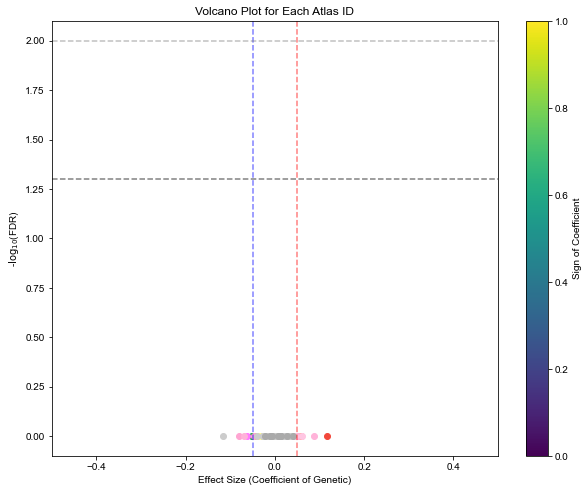

In [515]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    #try:
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # pdfClusterを実行
    r_code = '''
    library(MASS)
    model <- glm.nb('log_All_cell_count ~ Age', data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
    c(coef, p_value)
    '''
    #results_ <- summary(model)
    #results_ <- summary(model)
    #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
    #coef <- summary(model)$Coefficients["Genetic", "coef"]
    ro.r(r_code)

    results = ro.r(r_code)

    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    #except:
    #    coef, p_value = 0.0, 1.0
    #    print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4.csv" #"/Regional_cellome4_WM_mask_ver1_volume_revised.csv"

            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = healthy_data['Iba1_cell_count'] / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1


def normalize_and_calculate_difference(data):
    # atlasIDごとにループ
    for atlas_id in data['atlasID'].unique():
        # 各年齢、各ジェネティックタイプに対して正規化を実行
        for age in data['Age'].unique():
            avg_ctr = data[(data['atlasID'] == atlas_id) & (data['Genetic'] == 0) & (data['Age'] == age)]['NeuN+ density (/mm3)'].mean()
            
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0)]['NeuN+ density (/mm3)'] - avg_ctr 
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1)]['NeuN+ density (/mm3)'] - avg_ctr
        #mini = data.loc[(data['atlasID'] == atlas_id), 'Normalized'].min()
        #data.loc[(data['atlasID'] == atlas_id),'Normalized'] = data.loc[(data['atlasID'] == atlas_id),'Normalized'].copy() - mini
    return data

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000
    #data['log_All_cell_count'] = np.round(data['NeuN_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd


0
0


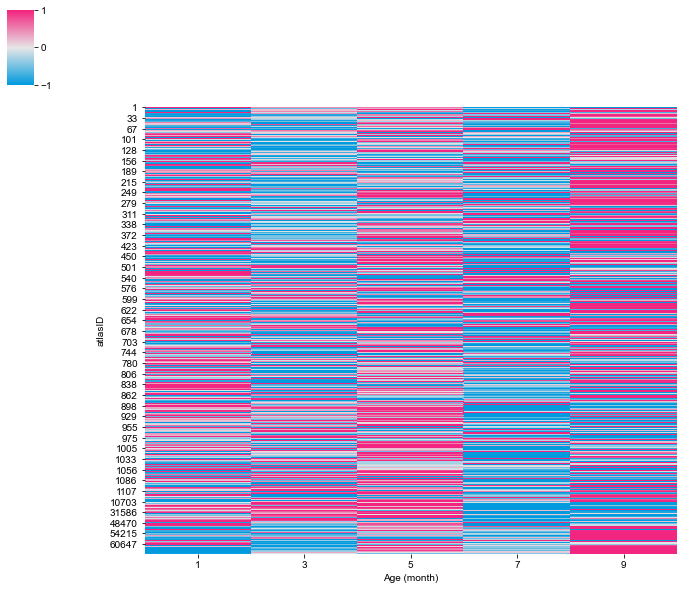

In [516]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
column_order = ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("WT_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# Move atlasID to the left side
clustergrid.ax_heatmap.yaxis.tick_left()  # Move y-axis labels to the left
clustergrid.ax_heatmap.yaxis.set_label_position("left")  # Set the y-axis label position to left

# PDFとして図を保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_Microglia_gradient_heatmap.pdf', 
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [517]:
# CSVファイルとして保存
data_pivot.to_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv', index=True)

Start time: 2024-10-07 23:31:15.330188
0      0.771774
1      0.230644
2      0.597034
3      0.969710
4      0.372371
5      0.723150
6      0.898537
7      0.844915
8      0.943840
9      0.520580
10     0.839562
11     0.879918
12     0.958682
13     0.953819
14     0.813224
15     0.879079
16     0.410647
17     0.940592
18     0.776866
19     0.886687
20     0.034456
21     0.984106
22     0.958678
23     0.801220
24     0.783348
25     0.722958
26     0.898285
27     0.669131
28     0.976034
29     0.826843
         ...   
641    0.979249
642    0.970278
643    0.950419
644    0.760901
645    0.910488
646    0.848096
647    0.866815
648    0.882663
649    0.810080
650    0.874516
651    0.687710
652    0.741188
653    0.962893
654    0.489248
655    0.858369
656    0.690782
657    0.625772
658    0.595530
659    0.835175
660    0.882824
661    0.920876
662    0.847218
663    0.925376
664    0.961000
665    0.969460
666    0.883675
667    0.891744
668    0.938316
669    0.921262
6

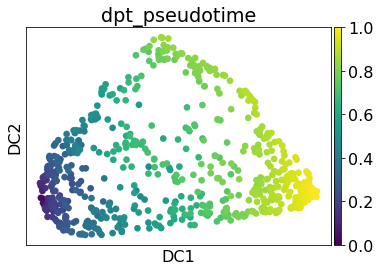

End time after X: 2024-10-07 23:31:15.853363
Duration for UMAP: 0:00:00.523175


In [16]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv', index_col='atlasID')

# 欠損値を各列の平均値で埋める
data_pivot = X#.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = data_pivot.apply(zscore, axis=1).fillna(0)

# 各行がリストになっているので、それを展開して2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
#X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)
# X_matrix_cleanedに数値データのみを抽出
X_matrix_numeric = data_normalized.values  # 数値データを取得

# NaNを0に置換
X_matrix_cleaned = np.nan_to_num(X_matrix_numeric)

# 正の無限大と負の無限大を0に置換
X_matrix_cleaned[X_matrix_cleaned == np.inf] = 0
X_matrix_cleaned[X_matrix_cleaned == -np.inf] = 0
# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定
adata.uns['iroot'] = 240 #597 #532 #634

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()


# 実行時間の計測
end_time1 = datetime.datetime.now()
print("End time after X:", end_time1)
print("Duration for UMAP:", end_time1 - start_time)


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:106: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


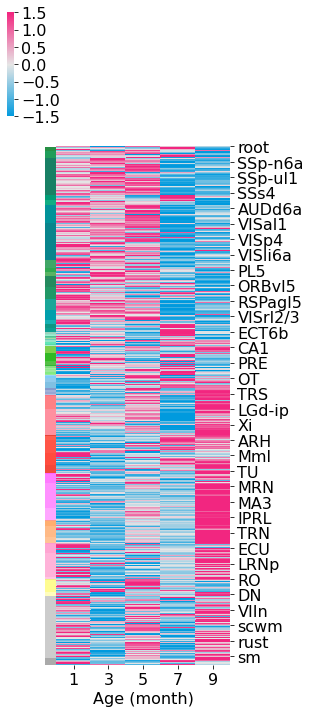

In [19]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
#data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)
# DataFrameとして処理を続けるため、data_normalizedをそのまま使用
data_normalized_df = data_normalized.copy()




# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df, cmap=cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


In [927]:
sorted_data_df

,0,1,2,3,4
id,,,,,
997,0.550688,0.452870,1.213378,-1.638545,-0.578390
68,0.913344,0.644004,0.518426,-0.223062,-1.852711
667,-0.896924,1.612001,-1.143134,-0.101098,0.529156
52192,1.296170,1.095181,-1.022523,-0.421616,-0.947212
52196,1.763521,-0.105806,-0.081372,-1.349308,-0.227035
...,...,...,...,...,...
129,0.814537,-0.580388,1.550847,-0.865571,-0.919424
140,0.801213,-0.904140,-0.283962,1.494427,-1.107538
145,-1.212436,-0.628349,-0.291183,1.689580,0.442388


In [926]:
sorted_pseudotime_full 

240    0.000000
243    0.029443
549    0.039066
20     0.056253
528    0.056526
         ...   
462    0.993716
114    0.998190
96     0.998758
561    0.998869
633    1.000000
Name: dpt_pseudotime, Length: 671, dtype: float32

In [925]:
sorted_data_df

,0,1,2,3,4
id,,,,,
997,0.550688,0.452870,1.213378,-1.638545,-0.578390
68,0.913344,0.644004,0.518426,-0.223062,-1.852711
667,-0.896924,1.612001,-1.143134,-0.101098,0.529156
52192,1.296170,1.095181,-1.022523,-0.421616,-0.947212
52196,1.763521,-0.105806,-0.081372,-1.349308,-0.227035
...,...,...,...,...,...
129,0.814537,-0.580388,1.550847,-0.865571,-0.919424
140,0.801213,-0.904140,-0.283962,1.494427,-1.107538
145,-1.212436,-0.628349,-0.291183,1.689580,0.442388


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


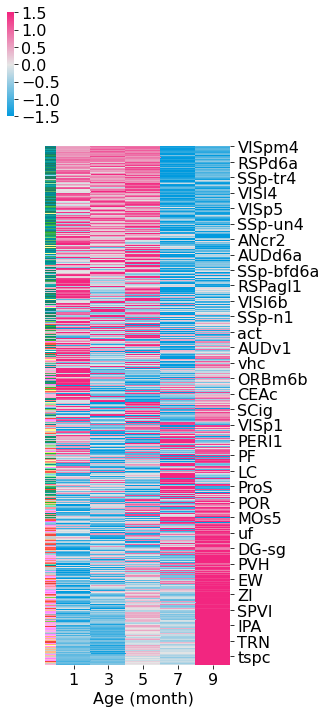

In [20]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
#data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)
# DataFrameとして処理を続けるため、data_normalizedをそのまま使用
data_normalized_df = data_normalized.copy()



# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:89: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


<Figure size 432x288 with 0 Axes>

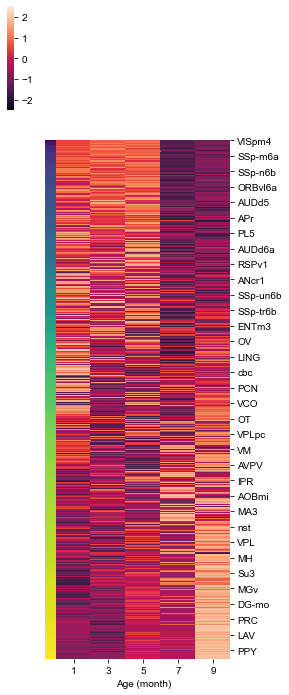

In [521]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# Viridisカラーマップを使ってpseudotimeの色を設定
viridis = plt.cm.get_cmap('viridis', 256)
norm = plt.Normalize(vmin=0, vmax=1)
pseudotime_colors = viridis(norm(sorted_pseudotime_full))

# プロットをクリアするために挿入
plt.clf()

# clustermapプロット
g = sns.clustermap(sorted_data_df, row_colors=pseudotime_colors, vmin=-2.5, vmax=2.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)

# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

if 1==0:
    # カラーバーの小さな軸を作成
    cbar_ax = g.fig.add_axes([1, 0.4, 0.025, 0.125])  # 左からの位置, 下からの位置, 横幅, 縦幅

    # カラーバーを設定
    cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=viridis), cax=cbar_ax, label='Pseudotime')

    # 枠線を消す
    cbar.outline.set_visible(False)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered_with_pseudotime_annotation.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


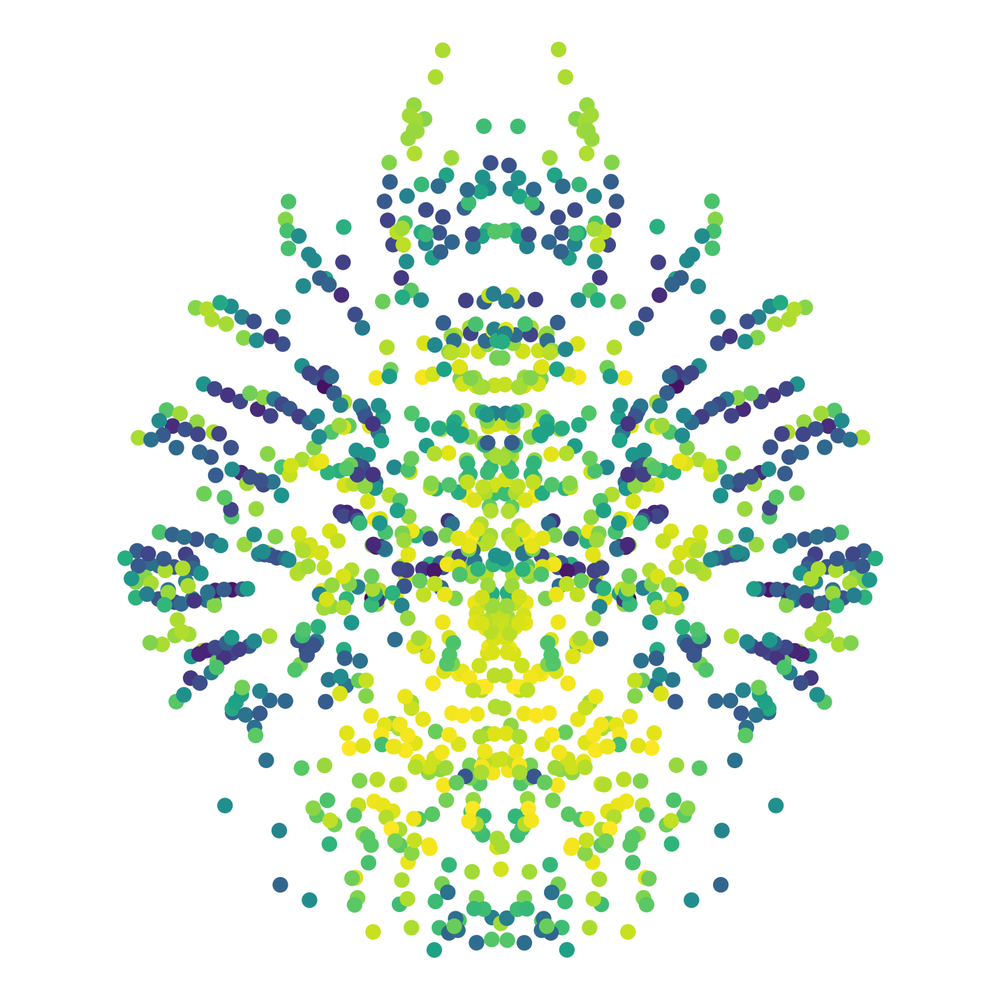

In [522]:
# atlasID が適切に設定されていることを確認する
# adata.obs に atlasID が含まれていることを前提にします
if 'atlasID' not in adata.obs.columns:
    adata.obs['atlasID'] = data_normalized.index

# pseudotime_df を adata.obs から作成し、インデックスを atlasID にする
pseudotime_df = pd.DataFrame(adata.obs[['atlasID', 'dpt_pseudotime']])

# pseudotime_df のインデックスを data_normalized のインデックス（atlasID）に基づいて設定
pseudotime_df = pseudotime_df.set_index('atlasID')

# data_normalized のインデックスに対応して pseudotime の値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['dpt_pseudotime'])

# pseudotime が NaN の場合は 0 で補完（必要に応じて）
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridis_rカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
#plt.title('Centroids of Left and Right Brain with Pseudotime Coloration')
#plt.xlabel('X (um)')
#plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.colorbar(sc, label='Pseudotime from Abeta PCA')  # カラーバーを追加
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Whole_brain_plot_of_Regional_Abeta_psedotime.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


In [ ]:
# APPとWTを混ぜる

In [70]:
X

,WT_1m,WT_3m,WT_5m,WT_7m,WT_9m
atlasID,,,,,
1,0.334254,0.329788,0.295640,0.260320,0.399469
2,0.252594,0.240378,0.241484,0.216313,0.215053
6,4.050885,3.074929,3.497537,2.954205,3.569933
7,1.397329,1.537128,1.712001,1.614757,1.998232
9,0.427032,0.425948,0.452041,0.385472,0.415948
...,...,...,...,...,...
60850,0.044972,0.053075,0.064681,0.051521,0.068828
60854,0.031531,0.032019,0.036902,0.032362,0.038096
60858,0.060096,0.071703,0.077634,0.075587,0.087062


In [71]:
X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv', index_col='atlasID')
X2

,APP_1m,APP_3m,APP_5m,APP_7m,APP_9m
atlasID,,,,,
1,0.306735,0.302780,0.271416,0.302619,0.365449
2,0.258192,0.231034,0.241718,0.247510,0.246880
6,4.350139,3.363413,3.424026,3.198017,3.583761
7,1.599226,1.687623,1.886909,2.030245,2.194317
9,0.474487,0.460962,0.439742,0.435457,0.370031
...,...,...,...,...,...
60850,0.047962,0.056609,0.071379,0.068454,0.066434
60854,0.032954,0.033644,0.039753,0.037995,0.040734
60858,0.067520,0.076060,0.086456,0.083196,0.084354


In [99]:
combined_data

WT_1m     WT_3m     WT_5m     WT_7m     WT_9m    APP_1m  \
    atlasID                                                               
WT  1        0.334254  0.329788  0.295640  0.260320  0.399469       NaN   
    2        0.252594  0.240378  0.241484  0.216313  0.215053       NaN   
    6        4.050885  3.074929  3.497537  2.954205  3.569933       NaN   
    7        1.397329  1.537128  1.712001  1.614757  1.998232       NaN   
    9        0.427032  0.425948  0.452041  0.385472  0.415948       NaN   
...               ...       ...       ...       ...       ...       ...   
APP 60850         NaN       NaN       NaN       NaN       NaN  0.047962   
    60854         NaN       NaN       NaN       NaN       NaN  0.032954   
    60858         NaN       NaN       NaN       NaN       NaN  0.067520   
    60862         NaN       NaN       NaN       NaN       NaN  0.030947   
    61277         NaN       NaN       NaN       NaN       NaN  0.064312   

               APP_3m    APP_5m    APP_7m    APP_9m    pseudotime  \
    atlasID                                                         
WT  1             NaN       NaN       NaN       NaN  3.167670e-19   
    2             NaN       NaN       NaN       NaN  3.007205e-19   
    6             NaN       NaN       NaN       NaN  8.501130e-19   
    7             NaN       NaN       NaN       NaN  1.780777e-19   
    9             NaN       NaN       NaN       NaN  1.264397e-19   
...               ...       ...       ...       ...           ...   
APP 60850    0.056609  0.071379  0.068454  0.066434  1.284702e-19   
    60854    0.033644  0.039753  0.037995  0.040734  3.250101e-19   
    60858    0.076060  0.086456  0.083196  0.084354  3.489255e-19   
    60862    0.038290  0.038170  0.041544  0.044919  1.849448e-19   
    61277    0.062031  0.071862  0.058429  0.072853  2.884509e-19   

             WT_pseudotime  APP_pseudotime  
    atlasID                                 
WT  1         3.167670e-19             NaN  
    2         3.007205e-19             NaN  
    6         8.501130e-19             NaN  
    7         1.780777e-19             NaN  
    9         1.264397e-19             NaN  
...                    ...             ...  
APP 60850              NaN    1.284702e-19  
    60854              NaN    3.250101e-19  
    60858              NaN    3.489255e-19  
    60862              NaN    1.849448e-19  
    61277              NaN    2.884509e-19  

[1342 rows x 13 columns]

Start time: 2024-10-07 23:33:23.379574
0       0.656531
1       0.218138
2       0.562800
3       0.925169
4       0.266953
5       0.592993
6       0.820699
7       0.746163
8       0.890455
9       0.498276
10      0.690832
11      0.851810
12      0.891752
13      0.888686
14      0.682617
15      0.836628
16      0.303630
17      0.872849
18      0.645020
19      0.850544
20      0.118412
21      0.931611
22      0.888312
23      0.670025
24      0.747422
25      0.693916
26      0.840130
27      0.481111
28      0.915483
29      0.770911
          ...   
1312    0.785006
1313    0.908217
1314    0.975464
1315    0.909430
1316    0.978023
1317    0.897158
1318    0.922719
1319    0.887317
1320    0.893418
1321    0.956968
1322    0.492067
1323    0.814122
1324    0.664989
1325    0.593820
1326    0.833307
1327    0.891006
1328    0.859233
1329    0.334736
1330    0.779853
1331    0.859547
1332    0.842282
1333    0.694855
1334    0.773363
1335    0.811047
1336    0.882126
1337    0

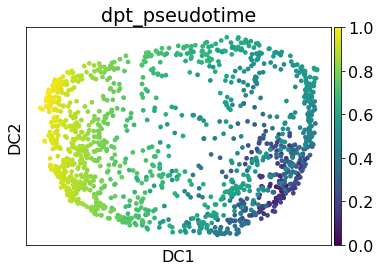

T-test p-value for pseudotime comparison: 3.772484284708584e-22
WT mean pseudotime: 0.5820282813766763
APP mean pseudotime: 0.6666563266080466


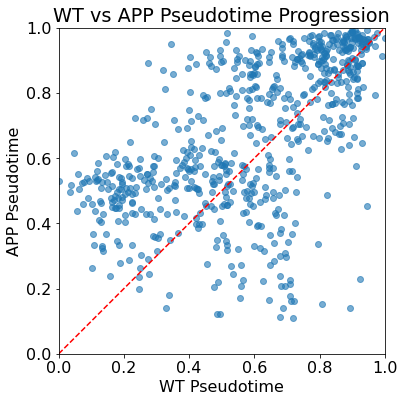

End time: 2024-10-07 23:33:24.518263
Total duration: 0:00:01.138689


In [21]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc
import matplotlib.pyplot as plt
from scipy.stats import ttest_rel

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv', index_col='atlasID')
X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv', index_col='atlasID')

# 列名を修正して、WTとAPPの違いをなくし、時間ベースで統一する
X.columns = ['1m', '3m', '5m', '7m', '9m']
X2.columns = ['1m', '3m', '5m', '7m', '9m']

# WTとAPPのデータを結合（行方向に）
combined_data = pd.concat([X, X2], axis=0, keys=['WT', 'APP'])

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = combined_data.apply(zscore, axis=1).fillna(0)

# 各行を2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
#X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)
# X_matrix_cleanedに数値データのみを抽出
X_matrix_numeric = data_normalized.values  # 数値データを取得

# NaNを0に置換
X_matrix_cleaned = np.nan_to_num(X_matrix_numeric)

# 正の無限大と負の無限大を0に置換
X_matrix_cleaned[X_matrix_cleaned == np.inf] = 0
X_matrix_cleaned[X_matrix_cleaned == -np.inf] = 0
# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定（適切なセルインデックスを設定）
adata.uns['iroot'] = 240#597+671  # 適切なセルをルートとして設定

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# pseudotimeを取得
pseudotime = adata.obs['dpt_pseudotime'].values
# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Microglia_pseudotime_diffusion_map.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()
# pseudotimeをcombined_dataに追加
combined_data['pseudotime'] = pseudotime

# WTとAPPの行インデックスを取得
wt_indices = combined_data.index.get_level_values(0) == 'WT'
app_indices = combined_data.index.get_level_values(0) == 'APP'

# WTとAPPに分割してpseudotimeを割り当てる
combined_data['WT_pseudotime'] = np.nan
combined_data['APP_pseudotime'] = np.nan
combined_data.loc[wt_indices, 'WT_pseudotime'] = combined_data.loc[wt_indices, 'pseudotime']
combined_data.loc[app_indices, 'APP_pseudotime'] = combined_data.loc[app_indices, 'pseudotime']

# WTとAPPの領域ごとのpseudotimeを比較する
# NaNを除外して比較
wt_pseudotime_clean = combined_data['WT_pseudotime'].dropna()
app_pseudotime_clean = combined_data['APP_pseudotime'].dropna()

# Wilcoxon signed-rank test to compare pseudotime progression
stat, p_val = ttest_rel(wt_pseudotime_clean, app_pseudotime_clean)
print(f'T-test p-value for pseudotime comparison: {p_val}')

# APPとWTのpseudotimeの平均値を計算
wt_mean = wt_pseudotime_clean.mean()
app_mean = app_pseudotime_clean.mean()
print(f'WT mean pseudotime: {wt_mean}')
print(f'APP mean pseudotime: {app_mean}')

# Scatter plot to visualize pseudotime progression
plt.figure(figsize=(8,6))
plt.scatter(wt_pseudotime_clean, app_pseudotime_clean, alpha=0.6)
plt.plot([0, 1], [0, 1], 'r--')  # 0-1の範囲でプロット
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('WT Pseudotime')
plt.ylabel('APP Pseudotime')
plt.title('WT vs APP Pseudotime Progression')
plt.gca().set_aspect('equal', adjustable='box')  # 等方的にプロット
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_comparison_scatter.pdf', dpi=300, bbox_inches='tight')
plt.show()

# 実行時間の計測
end_time = datetime.datetime.now()
print("End time:", end_time)
print("Total duration:", end_time - start_time)

In [216]:
np.where(X.index == 18705)

(array([597]),)

In [217]:
np.where(X.index == 501)

(array([240]),)

/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd


               1m        3m        5m        7m        9m
atlasID                                                  
1        0.224022  0.127449 -0.610952 -1.374693  1.634175
2        1.303586  0.483974  0.558194 -1.130613 -1.215141
6        1.591632 -0.908199  0.174276 -1.217422  0.359713
7       -1.263622 -0.569667  0.298392 -0.184325  1.719222
9        0.267121  0.216695  1.430213 -1.665685 -0.248344


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:80: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


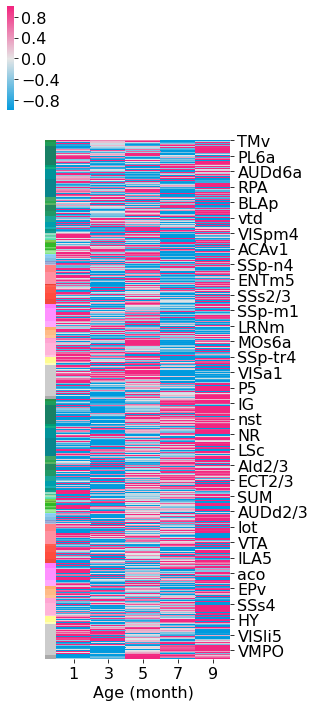

In [22]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import matplotlib
matplotlib.rcParams['pdf.use14corefonts'] = True
plt.rcParams['font.size'] = 16

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0 (or handle them as needed)
combined_normalized = combined_normalized.fillna(0)

# Verify that combined_normalized is now a proper DataFrame with numeric values
print(combined_normalized.head())


sorted_index = data_GO['id'].drop_duplicates()

# Generate color list from data_GO
colorlist = [(row['R'] / 255, row['G'] / 255, row['B'] / 255) for idx, row in data_GO.iterrows()]

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap
g = sns.clustermap(
    combined_normalized,
    cmap=create_custom_cmap(),
    row_colors=colorlist * 2,  # Assuming you need to apply the same color list for both WT and APP
    col_cluster=False,
    row_cluster=False,
    vmin=-1, vmax=1,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 40  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# Adjust layout to ensure proper display
# グラフの調整
plt.tight_layout()
#plt.subplots_adjust(hspace=0.3)

# PDFとして保存（透過背景）
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_and_APP_Microglia_heatmap_with_allen_annotation_before_pseudotime_reorder.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the heatmap
plt.show()

/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:80: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


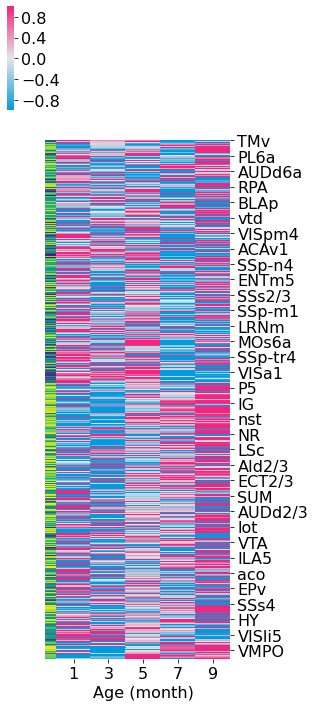

In [23]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import matplotlib
matplotlib.rcParams['pdf.use14corefonts'] = True
plt.rcParams['font.size'] = 16

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region)
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0
combined_normalized = combined_normalized.fillna(0)

# Assuming pseudotime is calculated and exists in the dataset
pseudotime = adata.obs['dpt_pseudotime'].values  # Replace with your actual pseudotime data
combined_normalized['pseudotime'] = pseudotime

# ここで順序を変更せずに、pseudotime カラーマップを作成
viridis = plt.cm.get_cmap('viridis', 256)
norm = plt.Normalize(vmin=combined_normalized['pseudotime'].min(), vmax=combined_normalized['pseudotime'].max())
pseudotime_colors = viridis(norm(combined_normalized['pseudotime']))

# Custom colormap for heatmap values
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap with pseudotime annotation
g = sns.clustermap(
    combined_normalized.drop(columns=['pseudotime']),  # Exclude pseudotime from heatmap
    cmap=create_custom_cmap(),
    row_colors=pseudotime_colors,  # Apply pseudotime-based colors
    col_cluster=False,
    row_cluster=False,
    vmin=-1, vmax=1,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 40  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)

# Adjust layout to ensure proper display
plt.tight_layout()
# PDFとして保存（透過背景）
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_and_APP_Microglia_heatmap_with_pseudotime_annotation_before_pseudotime_reorder.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the heatmap
plt.show()


               1m        3m        5m        7m        9m
atlasID                                                  
1        0.224022  0.127449 -0.610952 -1.374693  1.634175
2        1.303586  0.483974  0.558194 -1.130613 -1.215141
6        1.591632 -0.908199  0.174276 -1.217422  0.359713
7       -1.263622 -0.569667  0.298392 -0.184325  1.719222
9        0.267121  0.216695  1.430213 -1.665685 -0.248344


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:74: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


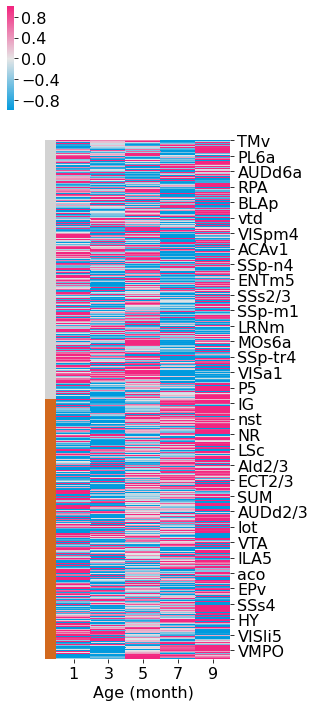

In [24]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0 (or handle them as needed)
combined_normalized = combined_normalized.fillna(0)

# Verify that combined_normalized is now a proper DataFrame with numeric values
print(combined_normalized.head())

# Create a color mapping for WT (gray) and APP (brown)
#row_colors = ['gray'] * len(X_wt_normalized) + ['brown'] * len(X_app_normalized)
row_colors = ['lightgrey'] * len(X_wt_normalized) + ['chocolate'] * len(X_app_normalized)
# Custom colormap for heatmap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap
g = sns.clustermap(
    combined_normalized,
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply WT (gray) and APP (brown) colors
    col_cluster=False,
    row_cluster=False,
    vmin=-1, vmax=1,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 40  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)

# Adjust layout to ensure proper display
plt.tight_layout()
# PDFとして保存（透過背景）
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_and_APP_Microglia_heatmap_with_condition_annotation_before_pseudotime_reorder.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the heatmap
plt.show()


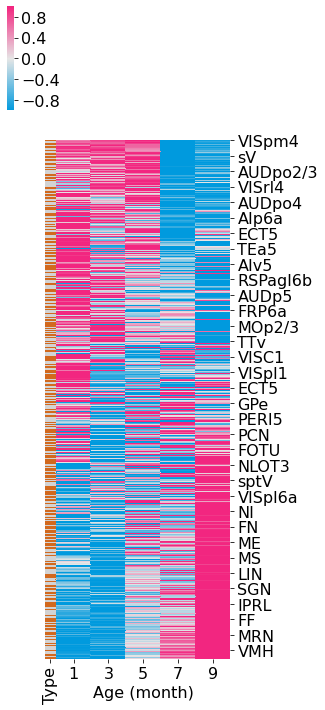

In [27]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)

# Generate WT/APP annotation colors based on the 'Type' column after sorting
row_colors = combined_normalized_sorted['Type'].map({'WT': 'lightgrey', 'APP': 'chocolate'})
#row_colors = ['lightgrey'] * len(X_wt_normalized) + ['sandybrown'] * len(X_app_normalized)
# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply WT/APP color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1, vmax=1,
    figsize=(4, 12),
    alpha = 1
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 40  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')
# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# Adjust layout and display the plot
#plt.tight_layout()
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_and_APP_Microglia_heatmap_with_condition_annotation_after_pseudotime_reorder2.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()

/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:82: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


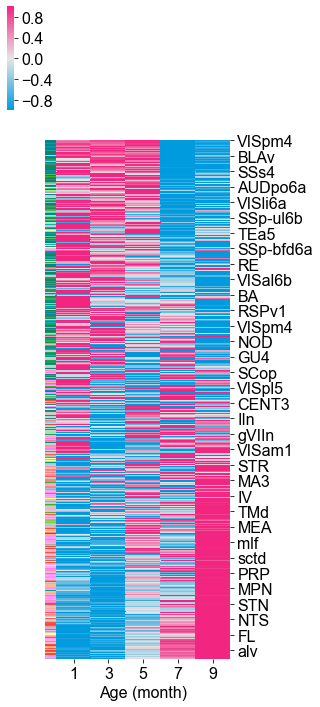

In [942]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data (assuming pseudotime calculation is already done)
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)



# Create a dictionary mapping atlasID (from combined_normalized_sorted) to colors from data_GO
id_to_color = {
    row['id']: (row['R'] / 255, row['G'] / 255, row['B'] / 255) 
    for idx, row in data_GO.iterrows()
}

# Generate the row_colors based on the region ID in the sorted data
row_colors = combined_normalized_sorted.index.map(lambda idx: id_to_color.get(idx, (0.5, 0.5, 0.5)))  # Default to gray if not found

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply region-based color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1, vmax=1,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 40  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')
# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# Adjust layout and display the plot
plt.tight_layout()
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_and_APP_Microglia_heatmap_with_allen_annotation_after_pseudotime_reorder.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:73: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


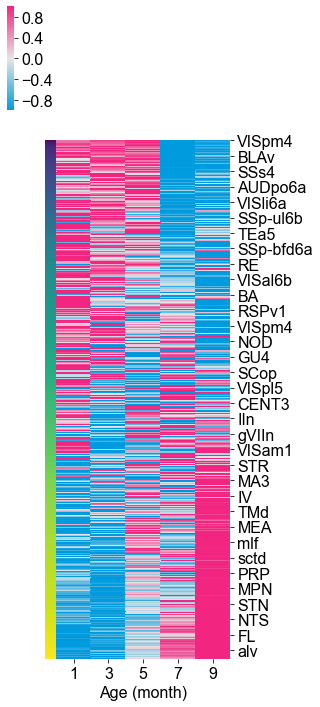

In [943]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region)
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)

#############
# Viridisカラーマップを使って pseudotime_colors を設定
viridis = plt.cm.get_cmap('viridis', 256)
norm = plt.Normalize(vmin=combined_normalized_sorted['pseudotime'].min(), vmax=combined_normalized_sorted['pseudotime'].max())
pseudotime_colors = viridis(norm(combined_normalized_sorted['pseudotime']))

##################
# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=pseudotime_colors,  # Apply pseudotime-based color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1, vmax=1,
    figsize=(4, 12)
)

# Adjust y-axis labels based on acronyms
# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 40  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')
# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)


# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")
g.ax_heatmap.set_ylabel("", fontsize=12)

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_and_APP_Microglia_heatmap_with_pseudotime_annotation_after_pseudotime_reorder.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:83: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


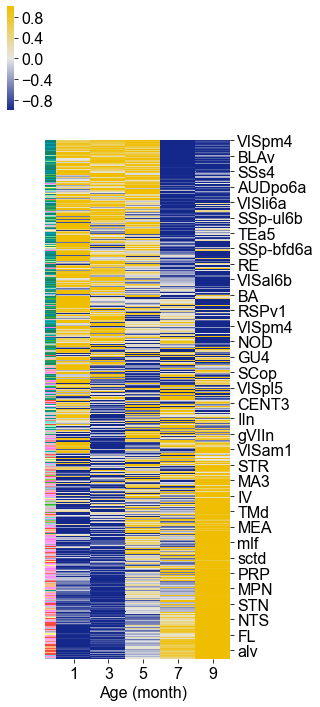

In [970]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Microglia_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Microglia_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data (assuming pseudotime calculation is already done)
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)



# Create a dictionary mapping atlasID (from combined_normalized_sorted) to colors from data_GO
id_to_color = {
    row['id']: (row['R'] / 255, row['G'] / 255, row['B'] / 255) 
    for idx, row in data_GO.iterrows()
}

# Generate the row_colors based on the region ID in the sorted data
row_colors = combined_normalized_sorted.index.map(lambda idx: id_to_color.get(idx, (0.5, 0.5, 0.5)))  # Default to gray if not found

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (20/255, 40/255, 140/255),
        (0.9, 0.9, 0.9), 
        (240/255, 190/255, 0/255)

    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply region-based color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1, vmax=1,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 40  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')
# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# Adjust layout and display the plot
plt.tight_layout()
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/color_bar_blue_to_orange.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [930]:
combined_normalized_sorted

,1m,3m,5m,7m,9m,Type,pseudotime
atlasID,,,,,,,
501,0.513571,0.976603,0.903026,-1.423903,-0.969296,WT,0.000000
233,0.554027,0.849782,0.985893,-1.462808,-0.926894,WT,0.036679
625,0.587051,0.790889,1.041156,-1.309165,-1.109931,WT,0.039981
401,0.605848,0.736000,1.068351,-1.355677,-1.054522,WT,0.046143
889,0.677752,0.806648,0.883397,-1.575274,-0.792523,WT,0.059360
...,...,...,...,...,...,...,...
749,-0.791228,-1.177539,-0.267436,0.662287,1.573917,APP,0.988826
661,-1.286580,-0.840778,0.041428,0.563101,1.522828,APP,0.989818
66,-0.978092,-1.098991,0.024798,0.422403,1.629882,WT,0.990503


In [954]:
top_5

,atlasID,X(um),Y(um),Z(um),color,pseudotime,colors,pseudotime_diff
52,108,4279.519043,8918.181641,3979.092773,"(0.6666666666666666, 0.6666666666666666, 0.666...",0.880137,"[0.6666666666666666, 0.6666666666666666, 0.666...",0.606166
52,108,7036.911133,8906.855469,3958.849365,"(0.6666666666666666, 0.6666666666666666, 0.666...",0.880137,"[0.6666666666666666, 0.6666666666666666, 0.666...",0.606166
200,401,4027.142822,7675.714355,686.734680,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.642877,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.596734
201,401,7370.325195,7678.251953,689.430908,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.642877,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.596734
198,393,2468.571533,9608.571289,2402.857178,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.950460,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.589335
199,393,8950.000000,9598.484375,2422.727295,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.950460,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.589335
547,1064,2741.012939,12208.050781,3142.353027,"(1.0, 0.9882352941176471, 0.5686274509803921)",0.887333,"[1.0, 0.9882352941176471, 0.5686274509803921, ...",0.558036
548,1064,8650.393555,12207.854492,3143.015381,"(1.0, 0.9882352941176471, 0.5686274509803921)",0.887333,"[1.0, 0.9882352941176471, 0.5686274509803921, ...",0.558036
239,501,3972.321533,8363.520508,697.959167,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.549513,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.549513
240,501,7413.393066,8372.832031,696.173462,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.549513,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.549513


chpl
VISpl6b
VISam4
VISpm4
ANcr2
chpl
VISpl6b
VISam4
VISpm4
ANcr2


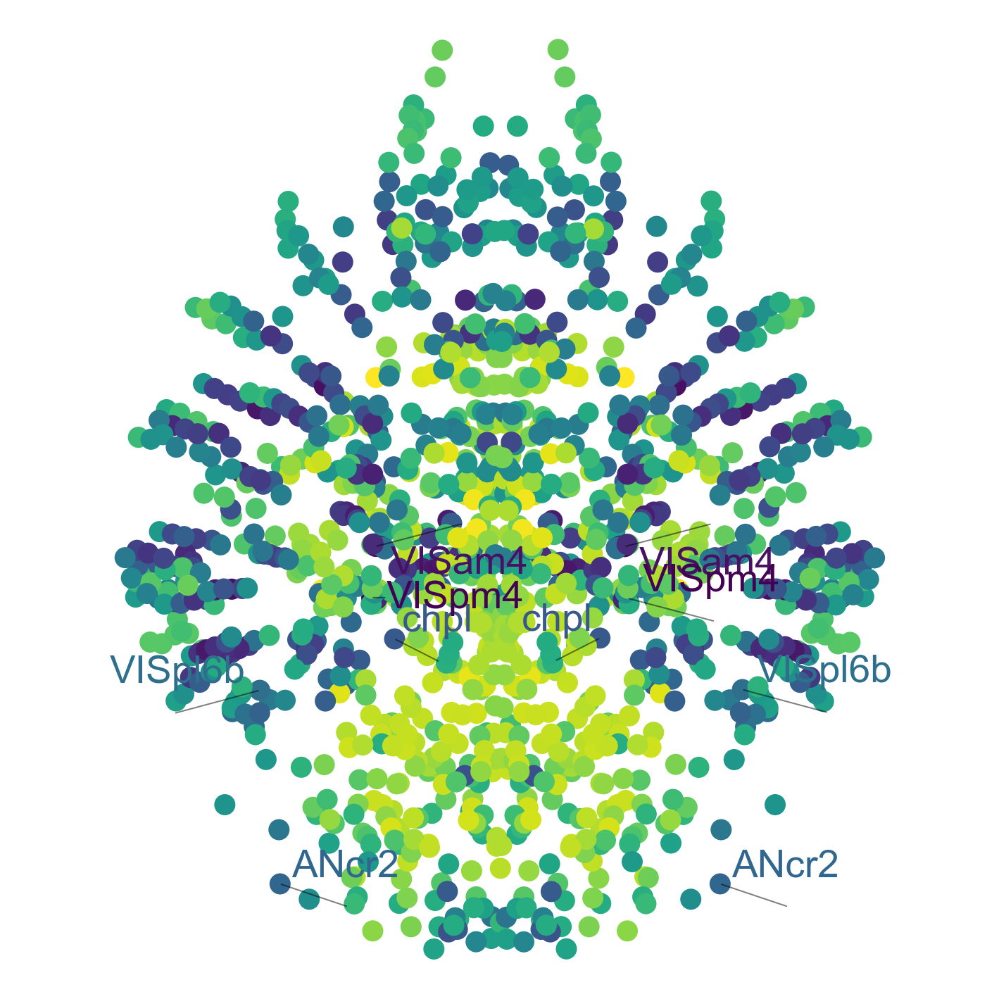

In [972]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from adjustText import adjust_text

# combined_normalizedからTypeがWTの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT']

# WTのpseudotimeを含むDataFrameを作成
pseudotime_df = pd.DataFrame(wt_data['pseudotime'])  # 'pseudotime'を使う
pseudotime_df['atlasID'] = wt_data.index.get_level_values('atlasID')  # 'atlasID'を取得
pseudotime_df.set_index('atlasID', inplace=True)  # インデックスをatlasIDに設定

# all_centroidsにおけるatlasIDに対応してpseudotimeの値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['pseudotime'])

# pseudotimeがNaNの場合は0で補完
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridisカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 指定したregionに対応するatlasIDを取得する関数
def get_region_id(region_name, param_ana):
    """ 
    param_ana内で指定されたregion_nameに対応するatlasIDを取得
    """
    for el in param_ana:
        if el['acronym'] == region_name:
            return el['id']
    return None  # 見つからなかった場合

# param_anaから対応するacronym名を取得する関数
def get_acronym_by_id(atlas_id, param_ana):
    for el in param_ana:
        if el['id'] == atlas_id:
            return el['acronym']
    return None  # 見つからなかった場合

# 指定したregionに対応するatlasIDを取得
regions_to_label = [
    get_region_id('chpl', param_ana),
    get_region_id('VISam4', param_ana),
    get_region_id('VISpl6b', param_ana),
    get_region_id('ANcr2', param_ana),
    get_region_id('VISpm4', param_ana)
]


# 特定のacronymをラベルとして描画したいregionsに対応するacronym名を取得
label_acronyms = [
    get_acronym_by_id(get_region_id('chpl', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISam4', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISpl6b', param_ana), param_ana),
    get_acronym_by_id(get_region_id('ANcr2', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISpm4', param_ana), param_ana)
]


# regions_to_labelをacronymに変換（atlasIDではなくregion名でフィルタ）
label_rows = all_centroids[all_centroids['atlasID'].isin(regions_to_label)]


# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=900, c=all_centroids['colors'], edgecolor='none')

# 特定のregionのテキストをacronymで追加
texts = []
for i, row in label_rows.iterrows():
    acronym = get_acronym_by_id(row['atlasID'], param_ana)  # atlasIDからacronymを取得
    print(acronym)
    if acronym is not None:
        texts.append(plt.text(row['X(um)'], row['Y(um)'], acronym,  # acronymを描画
                              ha='center', va='center', fontsize=55, color=row['colors'], fontweight='regular'))

# adjust_textでテキストの重なりを調整
adjust_text(texts, 
            arrowprops=dict(arrowstyle='-', color=(0, 0, 0), alpha=0.5, linewidth=2),
            expand_points=(1.2, 1.2),  # ポイントからの距離を微調整
            expand_text=(1., 1.),    # テキスト間の距離を微調整
            force_text=(1., 1.),     # テキストを動かす力を減らす
            force_points=(1., 0.)    # ポイントを動かす力を減らす
           )

plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Whole_brain_plot_of_WT_Regional_Microglia_psedotime.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


chpl
VISpl6b
VISam4
VISpm4
ANcr2
chpl
VISpl6b
VISam4
VISpm4
ANcr2


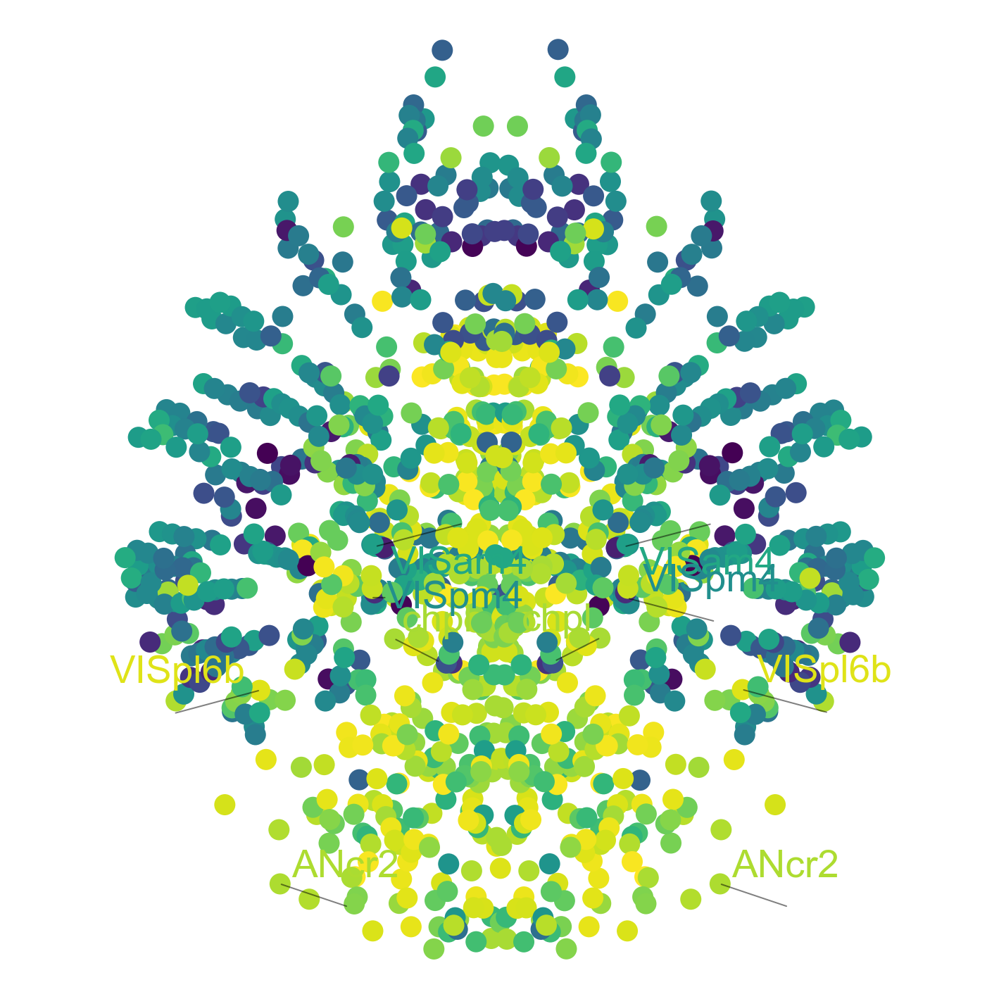

In [973]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from adjustText import adjust_text

# combined_normalizedからTypeがWTの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'APP']

# WTのpseudotimeを含むDataFrameを作成
pseudotime_df = pd.DataFrame(wt_data['pseudotime'])  # 'pseudotime'を使う
pseudotime_df['atlasID'] = wt_data.index.get_level_values('atlasID')  # 'atlasID'を取得
pseudotime_df.set_index('atlasID', inplace=True)  # インデックスをatlasIDに設定

# all_centroidsにおけるatlasIDに対応してpseudotimeの値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['pseudotime'])

# pseudotimeがNaNの場合は0で補完
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridisカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 指定したregionに対応するatlasIDを取得する関数
def get_region_id(region_name, param_ana):
    """ 
    param_ana内で指定されたregion_nameに対応するatlasIDを取得
    """
    for el in param_ana:
        if el['acronym'] == region_name:
            return el['id']
    return None  # 見つからなかった場合

# param_anaから対応するacronym名を取得する関数
def get_acronym_by_id(atlas_id, param_ana):
    for el in param_ana:
        if el['id'] == atlas_id:
            return el['acronym']
    return None  # 見つからなかった場合

# 指定したregionに対応するatlasIDを取得
# 指定したregionに対応するatlasIDを取得
regions_to_label = [
    get_region_id('chpl', param_ana),
    get_region_id('VISam4', param_ana),
    get_region_id('VISpl6b', param_ana),
    get_region_id('ANcr2', param_ana),
    get_region_id('VISpm4', param_ana)
]


# 特定のacronymをラベルとして描画したいregionsに対応するacronym名を取得
label_acronyms = [
    get_acronym_by_id(get_region_id('chpl', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISam4', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISpl6b', param_ana), param_ana),
    get_acronym_by_id(get_region_id('ANcr2', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISpm4', param_ana), param_ana)
]



# regions_to_labelをacronymに変換（atlasIDではなくregion名でフィルタ）
label_rows = all_centroids[all_centroids['atlasID'].isin(regions_to_label)]


# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=900, c=all_centroids['colors'], edgecolor='none')

# 特定のregionのテキストをacronymで追加
texts = []
for i, row in label_rows.iterrows():
    acronym = get_acronym_by_id(row['atlasID'], param_ana)  # atlasIDからacronymを取得
    print(acronym)
    if acronym is not None:
        texts.append(plt.text(row['X(um)'], row['Y(um)'], acronym,  # acronymを描画
                              ha='center', va='center', fontsize=55, color=row['colors'], fontweight='regular'))

# adjust_textでテキストの重なりを調整
adjust_text(texts, 
            arrowprops=dict(arrowstyle='-', color=(0, 0, 0), alpha=0.5, linewidth=2),
            expand_points=(1.2, 1.2),  # ポイントからの距離を微調整
            expand_text=(1., 1.),    # テキスト間の距離を微調整
            force_text=(1., 1.),     # テキストを動かす力を減らす
            force_points=(1., 0.)    # ポイントを動かす力を減らす
           )

plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Whole_brain_plot_of_APP_Regional_Microglia_psedotime.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


chpl
VISpl6b
VISam4
VISpm4
ANcr2
chpl
VISpl6b
VISam4
VISpm4
ANcr2


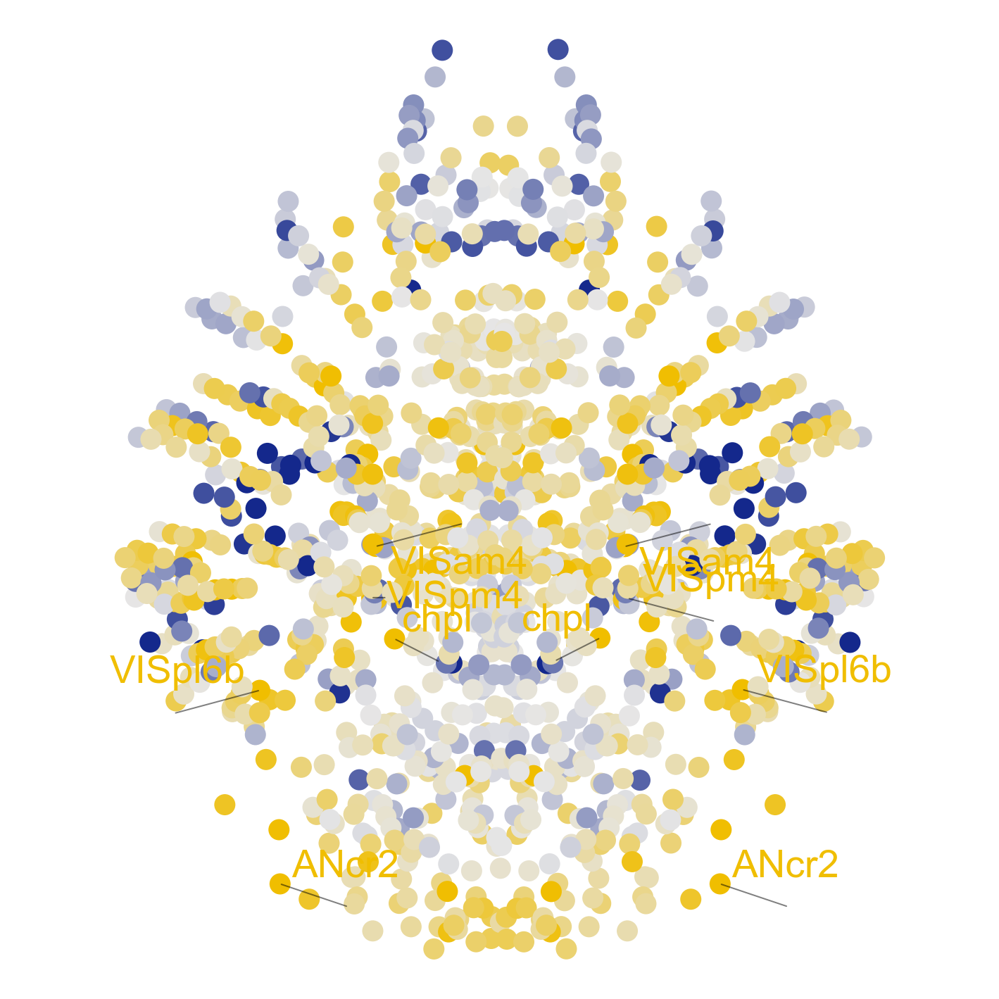

In [974]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

# combined_normalizedからTypeがWTとAPPの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT'] 
app_data = combined_normalized[combined_normalized['Type'] == 'APP'] 

# WTとAPPのpseudotimeを含むDataFrameを作成
pseudotime_wt = pd.DataFrame(wt_data['pseudotime'])
pseudotime_wt['atlasID'] = wt_data.index.get_level_values('atlasID')
pseudotime_wt.set_index('atlasID', inplace=True)

pseudotime_app = pd.DataFrame(app_data['pseudotime'])
pseudotime_app['atlasID'] = app_data.index.get_level_values('atlasID')
pseudotime_app.set_index('atlasID', inplace=True)

# 差分を計算してall_centroidsにマッピング
all_centroids['pseudotime_diff'] = all_centroids['atlasID'].map(pseudotime_app['pseudotime']) - all_centroids['atlasID'].map(pseudotime_wt['pseudotime'])

# 差分がNaNの場合は0で補完
all_centroids['pseudotime_diff'] = all_centroids['pseudotime_diff'].fillna(0)



# カスタムカラーマップを作成
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (20/255, 40/255, 140/255),
        (0.9, 0.9, 0.9), 
        (240/255, 190/255, 0/255)

    ])

# カラーマップの生成
custom_cmap = create_custom_cmap()

# 色の範囲を設定
vmin = -0.5#all_centroids['pseudotime_diff'].min()  # 最小値を設定
vmax = 0.5 #all_centroids['pseudotime_diff'].max()  # 最大値を設定

# 差分に基づいて色を生成
norm = plt.Normalize(vmin=vmin, vmax=vmax)
all_centroids['colors'] = all_centroids['pseudotime_diff'].apply(lambda x: custom_cmap(norm(x)))


# 指定したregionに対応するatlasIDを取得する関数
def get_region_id(region_name, param_ana):
    """ 
    param_ana内で指定されたregion_nameに対応するatlasIDを取得
    """
    for el in param_ana:
        if el['acronym'] == region_name:
            return el['id']
    return None  # 見つからなかった場合

# param_anaから対応するacronym名を取得する関数
def get_acronym_by_id(atlas_id, param_ana):
    for el in param_ana:
        if el['id'] == atlas_id:
            return el['acronym']
    return None  # 見つからなかった場合

# 指定したregionに対応するatlasIDを取得
# 指定したregionに対応するatlasIDを取得
regions_to_label = [
    get_region_id('chpl', param_ana),
    get_region_id('VISam4', param_ana),
    get_region_id('VISpl6b', param_ana),
    get_region_id('ANcr2', param_ana),
    get_region_id('VISpm4', param_ana)
]


# 特定のacronymをラベルとして描画したいregionsに対応するacronym名を取得
label_acronyms = [
    get_acronym_by_id(get_region_id('chpl', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISam4', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISpl6b', param_ana), param_ana),
    get_acronym_by_id(get_region_id('ANcr2', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISpm4', param_ana), param_ana)
]



# regions_to_labelをacronymに変換（atlasIDではなくregion名でフィルタ）
label_rows = all_centroids[all_centroids['atlasID'].isin(regions_to_label)]



# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=900, c=all_centroids['colors'], edgecolor='none')

# 特定のregionのテキストをacronymで追加
texts = []
for i, row in label_rows.iterrows():
    acronym = get_acronym_by_id(row['atlasID'], param_ana)  # atlasIDからacronymを取得
    print(acronym)
    if acronym is not None:
        texts.append(plt.text(row['X(um)'], row['Y(um)'], acronym,  # acronymを描画
                              ha='center', va='center', fontsize=55, color=row['colors'], fontweight='regular'))

# adjust_textでテキストの重なりを調整
adjust_text(texts, 
            arrowprops=dict(arrowstyle='-', color=(0, 0, 0), alpha=0.5, linewidth=2),
            expand_points=(1.2, 1.2),  # ポイントからの距離を微調整
            expand_text=(1., 1.),    # テキスト間の距離を微調整
            force_text=(1., 1.),     # テキストを動かす力を減らす
            force_points=(1., 0.)    # ポイントを動かす力を減らす
           )

plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

# カラーバーを追加
#cbar = plt.colorbar(sc, cmap=custom_cmap)  # カスタムカラーマップを使用
cbar.set_label('Pseudotime Difference (APP - WT)')  # カラーバーのラベルを設定
cbar.set_ticks([vmin, 0, vmax])  # カラーバーの目盛りを設定
cbar.ax.invert_yaxis()  # カラーバーのY軸を反転

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)
# Save the figure as a PDF with transparent background
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Whole_brain_plot_of_APP_WT_diff_Regional_Microglia_psedotime.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


100
chpl
VISpl6b
VISam4
VISpm4
ANcr2
chpl
VISpl6b
VISam4
VISpm4
ANcr2


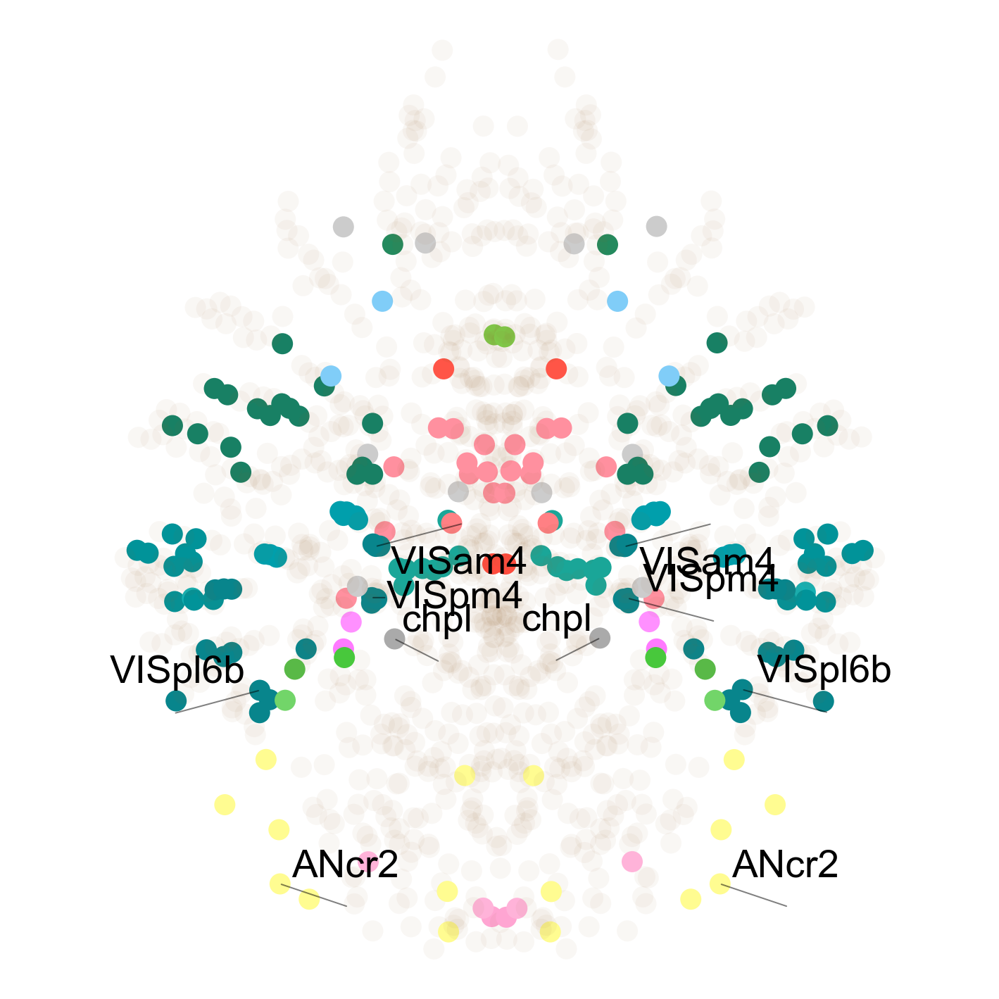

In [975]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

# combined_normalizedからTypeがWTとAPPの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT'] 
app_data = combined_normalized[combined_normalized['Type'] == 'APP'] 

# WTとAPPのpseudotimeを含むDataFrameを作成
pseudotime_wt = pd.DataFrame(wt_data['pseudotime'])
pseudotime_wt['atlasID'] = wt_data.index.get_level_values('atlasID')
pseudotime_wt.set_index('atlasID', inplace=True)

pseudotime_app = pd.DataFrame(app_data['pseudotime'])
pseudotime_app['atlasID'] = app_data.index.get_level_values('atlasID')
pseudotime_app.set_index('atlasID', inplace=True)

# 差分を計算してall_centroidsにマッピング
all_centroids['pseudotime_diff'] = all_centroids['atlasID'].map(pseudotime_app['pseudotime']) - all_centroids['atlasID'].map(pseudotime_wt['pseudotime'])

# 差分がNaNの場合は0で補完
all_centroids['pseudotime_diff'] = all_centroids['pseudotime_diff'].fillna(0)

# 上位100のregionを選択
top_100 = all_centroids.nlargest(200, 'pseudotime_diff')
print(len(np.unique(top_100["atlasID"])))

def get_color(row, data_GO, top_100_ids):
    atlas_id = row['atlasID']
    if atlas_id in top_100_ids:
        color_row = data_GO[data_GO['id'] == atlas_id]
        if not color_row.empty:
            return [
                color_row['R'].values[0] / 255,
                color_row['G'].values[0] / 255,
                color_row['B'].values[0] / 255,
                1.0  # 完全不透明
            ]
    return [0.6, 0.4, 0.2, 0.05]  # default color with low alpha if no match found or not in top_100

# top_100のatlasIDをセットとして取得
top_100_ids = set(top_100['atlasID'])

# Apply colors to all rows based on atlasID, only modifying those in top_100
all_centroids['colors'] = all_centroids.apply(lambda row: get_color(row, data_GO, top_100_ids), axis=1)

# 指定したregionに対応するatlasIDを取得する関数
def get_region_id(region_name, param_ana):
    """ 
    param_ana内で指定されたregion_nameに対応するatlasIDを取得
    """
    for el in param_ana:
        if el['acronym'] == region_name:
            return el['id']
    return None  # 見つからなかった場合

# param_anaから対応するacronym名を取得する関数
def get_acronym_by_id(atlas_id, param_ana):
    for el in param_ana:
        if el['id'] == atlas_id:
            return el['acronym']
    return None  # 見つからなかった場合

# 指定したregionに対応するatlasIDを取得
# 指定したregionに対応するatlasIDを取得
regions_to_label = [
    get_region_id('chpl', param_ana),
    get_region_id('VISam4', param_ana),
    get_region_id('VISpl6b', param_ana),
    get_region_id('ANcr2', param_ana),
    get_region_id('VISpm4', param_ana)
]


# 特定のacronymをラベルとして描画したいregionsに対応するacronym名を取得
label_acronyms = [
    get_acronym_by_id(get_region_id('chpl', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISam4', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISpl6b', param_ana), param_ana),
    get_acronym_by_id(get_region_id('ANcr2', param_ana), param_ana),
    get_acronym_by_id(get_region_id('VISpm4', param_ana), param_ana)
]



# regions_to_labelをacronymに変換（atlasIDではなくregion名でフィルタ）
label_rows = all_centroids[all_centroids['atlasID'].isin(regions_to_label)]


# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=900, c=np.vstack(all_centroids['colors']), edgecolor='none')

# 特定のregionのテキストをacronymで追加
texts = []
for i, row in label_rows.iterrows():
    acronym = get_acronym_by_id(row['atlasID'], param_ana)  # atlasIDからacronymを取得
    print(acronym)
    if acronym is not None:
        texts.append(plt.text(row['X(um)'], row['Y(um)'], acronym,  # acronymを描画
                              ha='center', va='center', fontsize=55, color="black", fontweight='regular'))

# adjust_textでテキストの重なりを調整
adjust_text(texts, 
            arrowprops=dict(arrowstyle='-', color=(0, 0, 0), alpha=0.5, linewidth=2),
            expand_points=(1.2, 1.2),  # ポイントからの距離を微調整
            expand_text=(1., 1.),    # テキスト間の距離を微調整
            force_text=(1., 1.),     # テキストを動かす力を減らす
            force_points=(1., 0.)    # ポイントを動かす力を減らす
           )

plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/Whole_brain_plot_of_APP_WT_diff_Top_100_regions_Regional_Microglia_psedotime.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)
# Show the plot
plt.show()


In [953]:
top_5 = all_centroids.nlargest(10, 'pseudotime_diff')
top_5

,atlasID,X(um),Y(um),Z(um),color,pseudotime,colors,pseudotime_diff
52,108,4279.519043,8918.181641,3979.092773,"(0.6666666666666666, 0.6666666666666666, 0.666...",0.880137,"[0.6666666666666666, 0.6666666666666666, 0.666...",0.606166
52,108,7036.911133,8906.855469,3958.849365,"(0.6666666666666666, 0.6666666666666666, 0.666...",0.880137,"[0.6666666666666666, 0.6666666666666666, 0.666...",0.606166
200,401,4027.142822,7675.714355,686.734680,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.642877,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.596734
201,401,7370.325195,7678.251953,689.430908,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.642877,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.596734
198,393,2468.571533,9608.571289,2402.857178,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.950460,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.589335
199,393,8950.000000,9598.484375,2422.727295,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.950460,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.589335
547,1064,2741.012939,12208.050781,3142.353027,"(1.0, 0.9882352941176471, 0.5686274509803921)",0.887333,"[1.0, 0.9882352941176471, 0.5686274509803921, ...",0.558036
548,1064,8650.393555,12207.854492,3143.015381,"(1.0, 0.9882352941176471, 0.5686274509803921)",0.887333,"[1.0, 0.9882352941176471, 0.5686274509803921, ...",0.558036
239,501,3972.321533,8363.520508,697.959167,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.549513,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.549513
240,501,7413.393066,8372.832031,696.173462,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.549513,"[0.03137254901960784, 0.5215686274509804, 0.54...",0.549513


In [951]:
top_100

,atlasID,X(um),Y(um),Z(um),color,pseudotime,colors,pseudotime_diff
52,108,4279.519043,8918.181641,3979.092773,"(0.6666666666666666, 0.6666666666666666, 0.666...",0.880137,"(0.95, 0.15, 0.5, 1.0)",0.606166
52,108,7036.911133,8906.855469,3958.849365,"(0.6666666666666666, 0.6666666666666666, 0.666...",0.880137,"(0.95, 0.15, 0.5, 1.0)",0.606166
200,401,4027.142822,7675.714355,686.734680,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.642877,"(0.95, 0.15, 0.5, 1.0)",0.596734
201,401,7370.325195,7678.251953,689.430908,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.642877,"(0.95, 0.15, 0.5, 1.0)",0.596734
198,393,2468.571533,9608.571289,2402.857178,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.950460,"(0.95, 0.15, 0.5, 1.0)",0.589335
...,...,...,...,...,...,...,...,...
557,1084,8450.563477,9325.041016,3601.636475,"(0.34901960784313724, 0.7254901960784313, 0.27...",0.919452,"(0.9319607843137254, 0.4205882352941177, 0.644...",0.318575
274,580,3592.936279,9053.185547,3310.526367,"(1.0, 0.47843137254901963, 1.0)",0.761118,"(0.9319607843137254, 0.4205882352941177, 0.644...",0.318426
275,580,7797.214355,9053.481445,3307.799561,"(1.0, 0.47843137254901963, 1.0)",0.761118,"(0.9319607843137254, 0.4205882352941177, 0.644...",0.318426
493,973,1983.818604,9154.742188,1696.547363,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.443941,"(0.9319607843137254, 0.4205882352941177, 0.644...",0.317002


In [390]:
color_row['R'].values[0]

170

#4_APPmodel_APP1m_1_2022_1102_1304
#4_APPmodel_APP1m_2_2022_1106_1708
#4_APPmodel_APP1m_3_2022_1213_2151
#4_APPmodel_APP1m_4_2023_0417_2052
#5_APPmodel_APP3m_2_2023_0123_1645
#5_APPmodel_APP3m_3_2023_0212_2217
#5_APPmodel_APP3m_4_2023_0214_2027
#4_APPmodel_APP3m_5_2023_0502_1423
#4_APPmodel_APP5m_1_2022_1024_1336
#4_APPmodel_APP5m_2_2022_1027_1333
#4_APPmodel_APP5m_3_2022_1030_1257
#4_APPmodel_APP5m_4_2023_0509_1021
#5_APPmodel_APP7m_2_2023_0315_1540
#5_APPmodel_APP7m_3_2023_0310_1401
#5_APPmodel_APP7m_4_2023_0317_1630
#5_APPmodel_APP7m_5_2023_0520_1723
#5_APPmodel_APP9m_1_2023_0117_1352
#5_APPmodel_APP9m_2_2023_0327_1425
#5_APPmodel_APP9m_3_2023_0329_1611
#5_APPmodel_APP9m_4_2023_0403_1443
997
Coefficient: -0.011938316022983618, p-value: 0.6336574685263883
68
Coefficient: -0.01296238283582466, p-value: 0.949334532581752
667
Coefficient: -0.0038396703742914827, p-value: 0.9836844640102315
52192


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014546061563257537, p-value: 0.9219885521953167
52196
Coefficient: 0.013211672594623674, p-value: 0.9502115563610455
52264
Coefficient: 0.02942241811405345, p-value: 0.9876267817023955
320
Coefficient: -0.003905340641669256, p-value: 0.9561759049645504
943
Coefficient: 0.005975942419120458, p-value: 0.8771310222488861
648
Coefficient: 0.02235307822080353, p-value: 0.5455128925268202
844


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0193632611038655, p-value: 0.5924705389487619
882
Coefficient: 0.021044057067936123, p-value: 0.8542303422549375
656
Coefficient: -0.014000789596445582, p-value: 0.8066107657749396
962
Coefficient: -0.007945468988296343, p-value: 0.8505505874727436
767
Coefficient: 0.01625914864800516, p-value: 0.6340753533384066
1021
Coefficient: 0.018523582040704867, p-value: 0.6398371972084265
1085


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.02522940163875037, p-value: 0.8894715443877366
558
Coefficient: 0.019242235890366055, p-value: 0.8747426933686551
838
Coefficient: 0.018259553685644664, p-value: 0.8374130931048778
654
Coefficient: 0.01976235756169728, p-value: 0.8217205407309519
702
Coefficient: 0.02507159395797223, p-value: 0.7691686538658297
889


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.023659140853674442, p-value: 0.7492343402941939
929
Coefficient: 0.01648863137009808, p-value: 0.9524525513135921
981
Coefficient: 0.01355610871253712, p-value: 0.8661087232624209
201
Coefficient: 0.019778387529999823, p-value: 0.7219235314049044
1047
Coefficient: 0.025532776362028914, p-value: 0.6550442186528759
1070
Coefficient: 0.02596685942372095, p-value: 0.6462120604889003
1038
Coefficient: 0.0241846075350129, p-value: 0.6610362047300391
1062


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.017532010883331412, p-value: 0.8895910435706906
1030
Coefficient: 0.01238430808797403, p-value: 0.9338229664579506
113
Coefficient: 0.006727226148473681, p-value: 0.9432859759916297
1094
Coefficient: 0.016754357753431995, p-value: 0.8962080237636558
1128
Coefficient: 0.015813699589666386, p-value: 0.8493557012110959
478
Coefficient: 0.021616348602937346, p-value: 0.8094386988466449
510
Coefficient: 0.010792050858367253, p-value: 0.9596789612107116
878
Coefficient: 0.009600065569502008, p-value: 0.9107801024451929
657


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01318275932586067, p-value: 0.8239075465803407
950
Coefficient: 0.019765485531286348, p-value: 0.7620116581422987
974
Coefficient: 0.020518403380942504, p-value: 0.7129014804856553
1102
Coefficient: 0.023021893142238764, p-value: 0.6468300841480954
2
Coefficient: 0.025924808967260737, p-value: 0.883567845794978
450
Coefficient: 0.006116527979264917, p-value: 0.9582892953409379
854
Coefficient: 0.011013091860645884, p-value: 0.8831005651293775
577
Coefficient: 0.015927914534804223, p-value: 0.8619594915790497
625


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0159670632644275, p-value: 0.8221620378118376
945
Coefficient: 0.019226556733459275, p-value: 0.7736763740693412
1026
Coefficient: 0.01829338104544038, p-value: 0.9196916663593565
1006
Coefficient: 0.015749871351572867, p-value: 0.9270699285396173
670
Coefficient: 0.0130291553381423, p-value: 0.9070364039812763
1086
Coefficient: 0.017029071826222097, p-value: 0.9256839366635203
1111
Coefficient: 0.01937736105360148, p-value: 0.8620606432641902
9
Coefficient: 0.024495268367478343, p-value: 0.8592737428790002
461


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.024000039631899322, p-value: 0.9308161671017672
18693
Coefficient: 0.007078775826244844, p-value: 0.9710071227678584
18697
Coefficient: 0.019306084342641465, p-value: 0.8790943321458502
18701
Coefficient: 0.027139016400191396, p-value: 0.861013925267347
18705
Coefficient: 0.024350523213592854, p-value: 0.852154156809591
18709
Coefficient: 0.024047079477690643, p-value: 0.8406610648935656
18713
Coefficient: 0.01632680733967103, p-value: 0.9596101847645657
873
Coefficient: 0.008539303353447948, p-value: 0.9032859429964373
806


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.008170114840888702, p-value: 0.8695647667879352
1035
Coefficient: 0.01978957279550707, p-value: 0.7512545696971803
1090
Coefficient: 0.015289979878254497, p-value: 0.7427614886295695
862
Coefficient: 0.011362638334243629, p-value: 0.8241765371999025
893
Coefficient: 0.00723832753470271, p-value: 0.9608946423450407
36
Coefficient: -0.0066716160263781635, p-value: 0.9736423071931739
180
Coefficient: 0.0002938625672417656, p-value: 0.9983546570256261
148
Coefficient: 0.01607916029736528, p-value: 0.9401988066279736
187


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010424915026124955, p-value: 0.9261778634202631
638
Coefficient: 0.002867181354982741, p-value: 0.9801002223777605
662
Coefficient: 0.016886505532157654, p-value: 0.9601139694230151
897
Coefficient: -0.013837762200206213, p-value: 0.9287847035859829
1106
Coefficient: -0.002593464134873341, p-value: 0.982784901570006
1010
Coefficient: 0.00817560349164598, p-value: 0.9651976619345318
1058
Coefficient: 2.9050168064926174e-05, p-value: 0.9997658886696252
857
Coefficient: -0.00015539367483484998, p-value: 0.998926162356035
849


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004407831186082861, p-value: 0.9887938756657427
527
Coefficient: 0.010234893190745359, p-value: 0.9487515914664432
600
Coefficient: 0.015778159621835635, p-value: 0.8955552647596449
678
Coefficient: 0.03433659368113927, p-value: 0.8354728646166991
252
Coefficient: 0.02885053724545228, p-value: 0.7808816135310797
156
Coefficient: 0.01626259579929956, p-value: 0.9175636024652852
243
Coefficient: 0.013316829585871546, p-value: 0.9661085517367559
735
Coefficient: 0.016419980362838378, p-value: 0.8878465885381721
251


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0015851351557645522, p-value: 0.9871196737312288
816
Coefficient: 0.01049997158589619, p-value: 0.9332258198637722
847
Coefficient: 0.011041963254360887, p-value: 0.884308035524666
954
Coefficient: 0.0072002424005190736, p-value: 0.9549764801345392
1005
Coefficient: 0.004496850000198538, p-value: 0.9849120495522133
696
Coefficient: -0.0098582994491486, p-value: 0.9656785620923057
643
Coefficient: -0.014881849624657596, p-value: 0.938791273705655
759
Coefficient: 0.004981629585859651, p-value: 0.98387381083782
791


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.011134612293159242, p-value: 0.9448108323593817
249
Coefficient: 0.011396017971179674, p-value: 0.9637597758016695
456
Coefficient: 0.009501381968772999, p-value: 0.9830128940395785
959
Coefficient: -0.01092762114409341, p-value: 0.9421602548902493
755
Coefficient: -0.020328409282911495, p-value: 0.8767679735830538
990
Coefficient: -0.013199999163828661, p-value: 0.9327279801447883
1023
Coefficient: -0.011006684345509735, p-value: 0.9066446713865215
520
Coefficient: 0.00024715096961858206, p-value: 0.9985845631836223
598


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0016187847420809215, p-value: 0.9956188565334385
1074
Coefficient: 0.014467162709465055, p-value: 0.9512988146281066
905
Coefficient: 0.015160286416299336, p-value: 0.9316212440698918
1114
Coefficient: 0.03051790906774065, p-value: 0.8870957602453643
233
Coefficient: 0.030301938138961412, p-value: 0.8394327542989792
601
Coefficient: 0.02935444448474366, p-value: 0.8878929447669075
649
Coefficient: 0.0242379251865057, p-value: 0.95129121235268
281
Coefficient: 0.03887907746801546, p-value: 0.8166211461627693
1066


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.05252123844485426, p-value: 0.7280362569458089
401
Coefficient: 0.02873794860602134, p-value: 0.9172786499176172
433
Coefficient: 0.017919095192896518, p-value: 0.8934403334644322
1046
Coefficient: 0.018695178119735874, p-value: 0.913061277896122
441
Coefficient: 0.009752108541404948, p-value: 0.9794741446219037
421
Coefficient: 0.004036555208721618, p-value: 0.9836308040924092
973
Coefficient: 0.0009273699659540473, p-value: 0.9950628266629125
573
Coefficient: 0.019504462560866142, p-value: 0.9076002360417756
613


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.015057550647402421, p-value: 0.9013499854634196
74
Coefficient: 0.01865913974174762, p-value: 0.9044663298811457
121
Coefficient: 0.010641098075426647, p-value: 0.972596761257319
593
Coefficient: 0.005571892507698951, p-value: 0.9351801987228566
821
Coefficient: 0.008483699374449467, p-value: 0.8766124746461375
721
Coefficient: 0.023885967495962376, p-value: 0.716968681267707
778
Coefficient: 0.019571969289855735, p-value: 0.716033196893272
33
Coefficient: 0.01881016764016257, p-value: 0.7778395617738898
305


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010361294865381307, p-value: 0.9423019758077142
750
Coefficient: -0.012467300579301573, p-value: 0.9317298476782746
269
Coefficient: -0.006148132508737113, p-value: 0.9647605191605089
869
Coefficient: -0.001980194837356895, p-value: 0.9957831281430217
902
Coefficient: 0.004778071125539157, p-value: 0.9712786657694129
377
Coefficient: 0.009271129935497455, p-value: 0.9622712971536195
393
Coefficient: 0.005802227290581627, p-value: 0.9930239548259897
805
Coefficient: 0.04197013083508888, p-value: 0.7902759617423631
41


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.023679968693264324, p-value: 0.8593511391786511
501
Coefficient: 0.02008181062778387, p-value: 0.9259786782419897
565
Coefficient: 0.010154933412209554, p-value: 0.9362343892524028
257
Coefficient: 0.012533258909236648, p-value: 0.9433550214709586
469
Coefficient: 0.002896489891955852, p-value: 0.9934239302476119
31578
Coefficient: 0.017498470338668786, p-value: 0.9564785376774296
31582
Coefficient: -0.004255023752430747, p-value: 0.9861617667460285
31586
Coefficient: 0.010777008053464413, p-value: 0.9717066708900209
31590


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.005317952563702069, p-value: 0.9769791861354091
31594
Coefficient: 0.009029553264073733, p-value: 0.9716462816013013
31598
Coefficient: 0.006633908876724272, p-value: 0.9889853359587847
31632
Coefficient: -0.0034954612793793834, p-value: 0.9814671262250595
31636
Coefficient: -0.007111177292911778, p-value: 0.9564691050454351
31640
Coefficient: -0.013238464609480012, p-value: 0.9669489316582869
31644
Coefficient: -0.0030481336539296537, p-value: 0.9811279847290281
31648
Coefficient: -0.0011064181496857103, p-value: 0.9953201647034541
31652


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0005946419453040636, p-value: 0.9986057379057873
935
Coefficient: -0.009109991245695951, p-value: 0.9143860568587068
211
Coefficient: -0.01343715791611905, p-value: 0.8940019604253263
1015
Coefficient: 0.00716464778302583, p-value: 0.9057334466925985
919
Coefficient: 0.015867244466499113, p-value: 0.8243745304337038
927
Coefficient: 0.029260613790538795, p-value: 0.9254047180123914
588
Coefficient: -0.02586072998558567, p-value: 0.7927492646158009
296
Coefficient: -0.006191365005885972, p-value: 0.955367415864242
772


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01289863733584109, p-value: 0.8425469641237173
810
Coefficient: 0.014935932577738991, p-value: 0.8814341131068515
819
Coefficient: 0.02866199550537784, p-value: 0.8921396360752214
171
Coefficient: -0.03328053105427645, p-value: 0.7566644138965664
304
Coefficient: -0.012904029799226885, p-value: 0.9238953009967104
363
Coefficient: 0.002138998141325465, p-value: 0.9795610364103408
84
Coefficient: 0.018014299021888197, p-value: 0.8525727158253364
132
Coefficient: 0.033480979350346024, p-value: 0.9193792533645033
707


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013392013000451643, p-value: 0.9438453770682494
556
Coefficient: -0.019550447635715906, p-value: 0.9333460006725931
827
Coefficient: -0.0008573277221201879, p-value: 0.9948323468458408
1054
Coefficient: 0.01701125925369251, p-value: 0.896936643900414
1081
Coefficient: 0.02679308049382329, p-value: 0.9544113268996908
448
Coefficient: 0.0061130347365230655, p-value: 0.9619065139781553
412
Coefficient: 0.02473271089427363, p-value: 0.8134208195962418
630
Coefficient: 0.020060157946532108, p-value: 0.7678576397303236
440


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014693634791429188, p-value: 0.877291733770164
488
Coefficient: 0.012817970420223656, p-value: 0.9604862374369538
484
Coefficient: -0.020216895254609298, p-value: 0.887306970619615
582
Coefficient: 0.000810640898620737, p-value: 0.9958724792438772
620
Coefficient: 0.015042705149257481, p-value: 0.8924606877688055
910
Coefficient: 0.017208729295206872, p-value: 0.9072974761883952
52977
Coefficient: 0.032156884101309464, p-value: 0.9679079318756132
969
Coefficient: 0.013071691992749048, p-value: 0.9212209679354171
288


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.021533406871664537, p-value: 0.848171184612422
1125
Coefficient: 0.01594718279317038, p-value: 0.8626252908569391
608
Coefficient: 0.01699994421249178, p-value: 0.8992784269265636
680
Coefficient: 0.01662209519069517, p-value: 0.9749912982316397
996
Coefficient: -0.010454208956265504, p-value: 0.9439725008184031
328
Coefficient: -0.001161113579109375, p-value: 0.9910765625074998
1101
Coefficient: 0.009810053597067173, p-value: 0.8924138257686794
783
Coefficient: 0.00651799204898019, p-value: 0.9377077907897867
831


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014408721969330221, p-value: 0.9618507219410037
120
Coefficient: 0.009306148446764525, p-value: 0.9486055949990101
163
Coefficient: 0.004063502851496637, p-value: 0.9680125768936094
344
Coefficient: 0.031514369984323415, p-value: 0.7354635054025858
314
Coefficient: 0.028430492268035876, p-value: 0.7993658104216124
355
Coefficient: 0.010353078938018335, p-value: 0.9789188446238052
704
Coefficient: -0.029203100315209417, p-value: 0.8687190440370169
694
Coefficient: 0.002061492036299565, p-value: 0.9863048303926175
800


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.022368492801766417, p-value: 0.819690590190224
675
Coefficient: 0.029759254863436717, p-value: 0.8566870846392252
699
Coefficient: 0.02892661708741429, p-value: 0.980260054163377
671
Coefficient: 0.03893181295925919, p-value: 0.6626536159690686
965
Coefficient: 0.06152010045820018, p-value: 0.4548590767879718
774
Coefficient: 0.014810476656242202, p-value: 0.8490793502104965
906
Coefficient: 0.012658725803398234, p-value: 0.9022926950439554
279
Coefficient: 0.008304825520971578, p-value: 0.9804192663973148
442


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.10902933529995315, p-value: 0.17033104176198188
434
Coefficient: 0.05880908282783782, p-value: 0.36181967426232914
610
Coefficient: 0.011251227827018342, p-value: 0.836731476381194
274
Coefficient: 0.007570905720768468, p-value: 0.91378067834406
330
Coefficient: 0.010828353975155981, p-value: 0.9741410997946855
542
Coefficient: -0.014980551694870134, p-value: 0.7738863933691218
430
Coefficient: 0.0021523864021144746, p-value: 0.9694080780135436
687
Coefficient: 0.007303547693037364, p-value: 0.8621231306535793
590


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00860160812324068, p-value: 0.9006028383154727
622
Coefficient: 0.018168546272824646, p-value: 0.9382323602572803
31550
Coefficient: 0.006837902024326518, p-value: 0.965297982750995
31554
Coefficient: 0.014080342944608288, p-value: 0.9032291231037388
31558
Coefficient: 0.02522230271303533, p-value: 0.8863824169997675
31562
Coefficient: 0.02121967245565512, p-value: 0.8465699272130032
31566
Coefficient: 0.025723586408341607, p-value: 0.8536370621788915
31570
Coefficient: 0.018148493292759544, p-value: 0.9494397162052248
31604


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.011636134440147472, p-value: 0.9489281590054924
31608
Coefficient: 0.026330193847465294, p-value: 0.846079874355388
31612
Coefficient: 0.03685670987119722, p-value: 0.8332464957892834
31616
Coefficient: 0.035530164981250965, p-value: 0.7840904753594582
31620
Coefficient: 0.03524337439698248, p-value: 0.8306316306727684
31624
Coefficient: 0.021428623065979084, p-value: 0.9431867252997798
97
Coefficient: -0.06641954461804345, p-value: 0.5833704656843373
1127
Coefficient: -0.05276929469691061, p-value: 0.6082588544421432
234


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02942474152692424, p-value: 0.8349453671799685
289
Coefficient: -0.018105050062584307, p-value: 0.8275491456127686
729
Coefficient: 0.0009918537085584775, p-value: 0.9928073687373086
786
Coefficient: 0.005604946897649377, p-value: 0.979753982842268
540
Coefficient: -0.024070028699772452, p-value: 0.8973739622901088
888
Coefficient: -0.006691344268693388, p-value: 0.9613323722542074
692
Coefficient: -0.00012111980687888332, p-value: 0.9995208755473797
335
Coefficient: -0.0007167734397938386, p-value: 0.998513051672904
368


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0022378118748737634, p-value: 0.9970805138490637
836
Coefficient: -0.02336884329238708, p-value: 0.900076378859269
427
Coefficient: -0.011503014107324239, p-value: 0.9283326960873701
988
Coefficient: -0.005293893590638069, p-value: 0.9640230792824485
977
Coefficient: 0.009817080783917161, p-value: 0.9390487763065013
1045
Coefficient: 0.0070538396347624415, p-value: 0.977229267349807
698
Coefficient: -0.04220367068210046, p-value: 0.09444870793044487
507
Coefficient: -0.022837390398004566, p-value: 0.029666455604030056
188


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.027046627430369327, p-value: 0.7783488783530019
196
Coefficient: -0.005239594835214386, p-value: 0.9521470732718862
204
Coefficient: -0.016116559838887125, p-value: 0.8343507993035145
159
Coefficient: 0.007089472948864423, p-value: 0.8157974822901389
597
Coefficient: -0.0029401949108413443, p-value: 0.9722369258187344
605
Coefficient: 0.00229959703533698, p-value: 0.9767716664844313
814
Coefficient: 0.01484480707741675, p-value: 0.8690662685932561
961
Coefficient: 0.006877723188997545, p-value: 0.7716790705755838
260


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.005459167076525807, p-value: 0.9797684386667781
268
Coefficient: -0.01347380527837239, p-value: 0.940100305186176
1139
Coefficient: 0.009472790400411234, p-value: 0.9713147195645425
639
Coefficient: 0.0035049320155509612, p-value: 0.963992401089969
655
Coefficient: 0.013822509096776235, p-value: 0.8486740486924038
663
Coefficient: 0.007629052034178517, p-value: 0.901199008671128
788
Coefficient: 0.00799871281155184, p-value: 0.9241813826545067
566
Coefficient: 0.009001558431021723, p-value: 0.8987207153915165
1089


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006251622774073547, p-value: 0.940155275945989
382
Coefficient: 0.004956437084216265, p-value: 0.8349642587299635
423
Coefficient: 0.011141027964885105, p-value: 0.9208982735493029
463
Coefficient: 0.008094657020412585, p-value: 0.7732252069960429
10703
Coefficient: -0.018945578092880742, p-value: 0.5574454250893606
10704
Coefficient: -0.06273913376073337, p-value: 0.3289134831639303
632
Coefficient: 0.02441196276797865, p-value: 0.602184333091635
982
Coefficient: -0.019278046988903494, p-value: 0.9317694723145468
19


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0008038627695193685, p-value: 0.9957548458580431
1121
Coefficient: -0.02043718620388151, p-value: 0.8266498991917253
20
Coefficient: -0.006922169688568952, p-value: 0.9146641279537492
52
Coefficient: 0.0031816829276146864, p-value: 0.9633594477324308
139
Coefficient: 0.010419957329664735, p-value: 0.878320430345138
28
Coefficient: 0.010626284422285782, p-value: 0.8913200202627131
526
Coefficient: -0.04186498883514729, p-value: 0.5233309685869529
543
Coefficient: -0.03095587150703014, p-value: 0.6247376329716561
664


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.019719101025026057, p-value: 0.7845269392329477
727
Coefficient: -0.004236161533459853, p-value: 0.95495771474046
743
Coefficient: 0.002368430273315442, p-value: 0.9795900754989186
843
Coefficient: -0.00877312139519851, p-value: 0.8883924111655552
1037
Coefficient: -0.0018069882539029475, p-value: 0.9717585187749765
1084
Coefficient: 0.008999890255966054, p-value: 0.8839131544973252
502


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.011234801527274432, p-value: 0.7767731330235872
48470
Coefficient: 0.01015264509111104, p-value: 0.8543823604854694
58447
Coefficient: -0.02136910258194726, p-value: 0.8232172439877706
48508
Coefficient: -0.014409658449258208, p-value: 0.8887651885921781
703
Coefficient: 0.015138949230081546, p-value: 0.8798538534951189
583
Coefficient: 0.011408210367817978, p-value: 0.9057722626597412
952
Coefficient: 0.031248168746313695, p-value: 0.528021162877173
966
Coefficient: 0.029589694172953488, p-value: 0.6721847685281975
131


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014779816511748449, p-value: 0.8420328318367742
303
Coefficient: 0.024867433921400735, p-value: 0.7496441319090693
311
Coefficient: 0.019338376794863745, p-value: 0.802486091622504
451
Coefficient: 0.02873553361385138, p-value: 0.819338119891964
327
Coefficient: 0.013289497257584357, p-value: 0.8630108882443631
334
Coefficient: 0.017337061477644588, p-value: 0.8266621985969365
780
Coefficient: -0.006659553856304093, p-value: 0.9087004288017038
477
Coefficient: 0.006741243550472201, p-value: 0.8477214426438284
672


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0008219056720586955, p-value: 0.9486556692128045
56
Coefficient: 0.011069829504880842, p-value: 0.7259607514964679
998
Coefficient: 0.020541156772486475, p-value: 0.8337957974077682
754
Coefficient: 0.0019802996676901168, p-value: 0.9607171713624447
250
Coefficient: 0.000345995324425965, p-value: 0.9968775186761301
258
Coefficient: -0.0014141064324539987, p-value: 0.9725311082780989
266
Coefficient: 0.0017635692022590426, p-value: 0.9797865366707832
310
Coefficient: 0.002142964818852728, p-value: 0.977018015446214
333


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003202597231097795, p-value: 0.9922206220143794
23
Coefficient: 0.0015139803065178487, p-value: 0.9850985988425177
292
Coefficient: 0.04381094951650947, p-value: 0.9164787351331058
544
Coefficient: 0.019822178160126457, p-value: 0.8703747600389894
551
Coefficient: 0.019108196065464243, p-value: 0.8828049829179335
559
Coefficient: 0.018179836291039225, p-value: 0.7962437294682883
1105
Coefficient: 0.02872720510214548, p-value: 0.8553135044243576
403
Coefficient: 0.005698150443297349, p-value: 0.9046029990070112
803


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00782755055896607, p-value: 0.8737828616503377
1022
Coefficient: 0.014550005486208908, p-value: 0.7233398079975513
1031
Coefficient: 0.012412365295372072, p-value: 0.8716167129304633
342
Coefficient: 0.01677418850561812, p-value: 0.6194655596630749
298
Coefficient: 0.0007490023952703026, p-value: 0.9933213680214519
564
Coefficient: 0.0016908508811178356, p-value: 0.9863755925928157
596


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005317385617315589, p-value: 0.9411507355888223
581
Coefficient: -0.000556857398303896, p-value: 0.9939046718306832
351
Coefficient: 0.017648325146019023, p-value: 0.741913024997399
287
Coefficient: 0.0014276082404286177, p-value: 0.9979621819795934
549
Coefficient: -0.0024590979710341697, p-value: 0.9642699904480754
629
Coefficient: -0.005733510905433179, p-value: 0.9234315689722995
685
Coefficient: -0.0018986312454601533, p-value: 0.9735892109043122
718
Coefficient: 0.0011365792364283489, p-value: 0.9835836378621983
725


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0017799513530432024, p-value: 0.992310889716854
733
Coefficient: 0.005311074026275952, p-value: 0.9022869109787703
741
Coefficient: 0.0011212494907881672, p-value: 0.9925393880527271
56435
Coefficient: -0.010387098579932065, p-value: 0.9144971763745667
414
Coefficient: 0.004421953951514703, p-value: 0.9821262486308879
422
Coefficient: -0.006270247615573919, p-value: 0.9653990343982064
609
Coefficient: -0.007887271471040439, p-value: 0.961095528864963
1044
Coefficient: -0.004455222676830334, p-value: 0.9834691560910666
1072


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.022921347957251627, p-value: 0.8560427345154971
1079
Coefficient: 0.031130506460261678, p-value: 0.7480189089752485
1088
Coefficient: -0.005982890677768793, p-value: 0.9561805037781534
49664
Coefficient: 0.020436378913524983, p-value: 0.8615850384799769
49668
Coefficient: 0.013426560782151584, p-value: 0.8793795474349685
49672
Coefficient: 0.020725671118990534, p-value: 0.9109052204709751
218
Coefficient: 0.015870303775859997, p-value: 0.7565744223427302
1020
Coefficient: 0.0053754760388929745, p-value: 0.9205583754354236
1029


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01067152561409209, p-value: 0.9214445270138755
325
Coefficient: -0.0030673250647200857, p-value: 0.9811021646950858
56551
Coefficient: 0.0048544785154562295, p-value: 0.9653055773437949
255
Coefficient: -0.0025098394647271116, p-value: 0.9747925152184902
1096
Coefficient: -0.010246577727539643, p-value: 0.9315664420609076
1104
Coefficient: 0.007565555848099206, p-value: 0.9555811758935998
64
Coefficient: -0.010194930439375555, p-value: 0.9385260186061541
1120
Coefficient: -0.03434537101533721, p-value: 0.9138316001155725
1113


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0062875445892994234, p-value: 0.9687910608001885
155
Coefficient: 0.002321659102217174, p-value: 0.966760719484781
59
Coefficient: -0.007427091166520808, p-value: 0.960548106056147
362
Coefficient: -0.0008316138762122173, p-value: 0.9863900374927204
366
Coefficient: 0.01661310298628887, p-value: 0.8660620185690484
1077
Coefficient: 0.0019221188977654544, p-value: 0.9904894706628051
149
Coefficient: 0.0029795198378946004, p-value: 0.9724872436522576
15
Coefficient: -8.328156823931681e-05, p-value: 0.9994858658504965
181


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0017562160174733332, p-value: 0.9850657030486907
56559
Coefficient: 0.016823247926671725, p-value: 0.9376569187481313
189
Coefficient: -0.015624632753242017, p-value: 0.9331348393527571
599
Coefficient: -0.004200808226387082, p-value: 0.9716632171675741
907
Coefficient: -0.007528438953551185, p-value: 0.9491743545463124
575
Coefficient: -0.0013387233438130147, p-value: 0.9885750101835159
930
Coefficient: -0.002815627921824237, p-value: 0.971462550533382
56563
Coefficient: -0.0034695099201603003, p-value: 0.9778779987588156
262


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.002466604245810622, p-value: 0.948198488428473
27
Coefficient: 0.008326133457177719, p-value: 0.9666152627438116
56439
Coefficient: 0.0073320023400681115, p-value: 0.9829281476960845
178
Coefficient: 0.007058974026696935, p-value: 0.9299468690451128
321
Coefficient: 0.016760141018724847, p-value: 0.9461971984066501
483
Coefficient: -0.006213532580154523, p-value: 0.9145445197813228
186
Coefficient: 0.009975473635237833, p-value: 0.8902202082220166
1097
Coefficient: 0.0015937005678068419, p-value: 0.9630744164546572
390


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.018156645616909276, p-value: 0.94529913198918
332
Coefficient: 0.02398753058577306, p-value: 0.9764452203942751
38
Coefficient: -0.01106482261279082, p-value: 0.9134387205973667
30
Coefficient: 0.0019039408107655088, p-value: 0.9902036881957678
118
Coefficient: -0.007232488591274656, p-value: 0.9527661945783328
223
Coefficient: -0.027397397332273338, p-value: 0.7795955820856107
72
Coefficient: 0.014998499482440152, p-value: 0.9346716547590251
263
Coefficient: 0.008758018517537205, p-value: 0.9611709240345313
272


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02086581634247487, p-value: 0.874517350690575
830
Coefficient: -0.00234337141264669, p-value: 0.9806055563143721
452
Coefficient: 0.003480512417883674, p-value: 0.9898545159409563
523
Coefficient: 0.00895497415874607, p-value: 0.9093860141455695
763
Coefficient: 0.006072478137909813, p-value: 0.9896104691811051
914
Coefficient: -0.004321262297119624, p-value: 0.9945450555486439
1109
Coefficient: 0.006193166363692818, p-value: 0.9715522073012277
126
Coefficient: 0.024366969338066653, p-value: 0.8553578096160982
133


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011489960112014926, p-value: 0.926551107289419
347
Coefficient: 0.0129881840818944, p-value: 0.9388756831963638
286
Coefficient: -0.006687469493734899, p-value: 0.9554565995422001
338
Coefficient: -0.011372161201180744, p-value: 0.967446608725264
57699
Coefficient: 0.001930379416001985, p-value: 0.994600078905111
689
Coefficient: -0.012505358164726029, p-value: 0.9551334807620342
88
Coefficient: 0.009389556502208619, p-value: 0.893505336764628
210
Coefficient: -0.02380763381011253, p-value: 0.8835936203745245
732


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01277097918688267, p-value: 0.9457396210109197
60647
Coefficient: -0.011210390992140605, p-value: 0.9095099771607068
60651
Coefficient: -0.01607981660992993, p-value: 0.9055903213773085
60655
Coefficient: -0.09850892046006458, p-value: 0.6562991501606751
60659
Coefficient: -0.018120138426420827, p-value: 0.9093561916598062
525
Coefficient: -0.006016495106420338, p-value: 0.9533141899260306
1126
Coefficient: -0.02314095463692759, p-value: 0.9253102648823325
1
Coefficient: -0.007913340179134103, p-value: 0.9648919999439447
515


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.013562237061352863, p-value: 0.9043223775920791
980
Coefficient: -0.01255534776953388, p-value: 0.9343465775028786
1004
Coefficient: -0.005060829667651722, p-value: 0.9722589061578681
63
Coefficient: -0.004721914912577422, p-value: 0.9775312513977822
693
Coefficient: 0.005131868566697543, p-value: 0.9563302111742724
946
Coefficient: -0.0016937919495246658, p-value: 0.9808176787845806
194
Coefficient: 0.0037085199946458466, p-value: 0.9204860096073613
226
Coefficient: 0.008079346423049994, p-value: 0.9112504447329854
356


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003412574675498665, p-value: 0.9939706893792042
364
Coefficient: 0.0025894062611493502, p-value: 0.9850705806590663
57704
Coefficient: 0.00635341429632662, p-value: 0.9568289106305339
173
Coefficient: -0.02094154623329278, p-value: 0.8768025667028543
470
Coefficient: 0.0014754847742445853, p-value: 0.9891258104255513
614
Coefficient: 0.003149225191973982, p-value: 0.9701563585663869
797
Coefficient: -0.002262980851951046, p-value: 0.9549292773026481
804
Coefficient: -0.010678315697211832, p-value: 0.9241850100012287
10671


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0010408518301407823, p-value: 0.9943089024699588
313
Coefficient: -0.009303973603592822, p-value: 0.6377785333557786
851
Coefficient: -0.022930707184868428, p-value: 0.7123783749826127
842
Coefficient: -0.029309049377211644, p-value: 0.5097776498739273
834
Coefficient: 0.0034471970555144675, p-value: 0.9633893282116563
811
Coefficient: 0.0025571064752779975, p-value: 0.9533522456711974
820
Coefficient: -0.004924525700347878, p-value: 0.9179231361816131
828
Coefficient: -0.018752627498499142, p-value: 0.6136416533203901
580


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.025885001655885028, p-value: 0.8898534899307055
271
Coefficient: -0.02811843822487741, p-value: 0.8721732049440454
874
Coefficient: -0.060087032653692654, p-value: 0.8139145662931276
460
Coefficient: -0.013091600126439026, p-value: 0.9788017261789836
59923
Coefficient: -0.055307868154298306, p-value: 0.8227149813554758
381
Coefficient: 0.007314036333088324, p-value: 0.8646758100650643
749
Coefficient: 0.002868950044504133, p-value: 0.9725262679487403
60830
Coefficient: -0.006929078069286624, p-value: 0.9837737307370734
246


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.002042904666212051, p-value: 0.9889037429548783
128
Coefficient: -0.007402302116174252, p-value: 0.7518180638593884
26
Coefficient: -0.002699675429967562, p-value: 0.9518837447051591
42
Coefficient: -0.002722072498522382, p-value: 0.974753837856908
17
Coefficient: -0.00601192941885933, p-value: 0.8522011560936961
10
Coefficient: -0.016864007123650073, p-value: 0.6168273084591234
795
Coefficient: -0.0029233628405221554, p-value: 0.9121624983751436
50
Coefficient: -0.012479739151595563, p-value: 0.92606475553653
67


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0020121568491731356, p-value: 0.9905616618488023
587
Coefficient: -0.006337903389254313, p-value: 0.967185396243649
61277
Coefficient: 0.006866120954296375, p-value: 0.9787685406390113
215
Coefficient: -0.0015502281269790875, p-value: 0.9716886702231756
531
Coefficient: -0.01607069604970773, p-value: 0.9421548670298593
628
Coefficient: -0.017884666885527763, p-value: 0.8565051607870799
634
Coefficient: -0.0011406281979662257, p-value: 0.990422034308293
706
Coefficient: -0.008954230786137229, p-value: 0.9660054811290624
1061


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009828621114216951, p-value: 0.939452589418334
54203
Coefficient: -0.011609127325838116, p-value: 0.9563433358873233
616
Coefficient: 0.0008939932354189431, p-value: 0.9888869269860833
214
Coefficient: -0.0017880509988220646, p-value: 0.9763772047262139
35
Coefficient: 0.00029674870921788245, p-value: 0.9991033849371029
54211
Coefficient: 0.0030692154729564255, p-value: 0.9943004937919996
975
Coefficient: -0.003514658363448303, p-value: 0.991555719704476
115
Coefficient: -0.0020305160283272147, p-value: 0.9976570993497568
60663


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.003310947594454802, p-value: 0.9939180524572189
757
Coefficient: 0.0036639308962731713, p-value: 0.9858793918017477
231
Coefficient: -0.004304960229833599, p-value: 0.9839482001496326
66
Coefficient: 0.001715832800101634, p-value: 0.995975376180643
75
Coefficient: -0.021342689389722478, p-value: 0.9660011732898314
58
Coefficient: 0.002928763009809702, p-value: 0.9898669764850025
374
Coefficient: 0.008579808084853377, p-value: 0.9458626223483224
1052
Coefficient: -0.006180897194407724, p-value: 0.9140781296684032
12


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.013668382534871777, p-value: 0.9340617271391704
100
Coefficient: -0.008410698952086926, p-value: 0.9865504943759051
60834
Coefficient: -0.0071147452765162565, p-value: 0.9631976053010898
60838
Coefficient: -0.009460016758098709, p-value: 0.9624387164885484
60842
Coefficient: 0.007457408375535616, p-value: 0.9794985379934957
60846
Coefficient: -0.004224262856257459, p-value: 0.9826555992971161
60850
Coefficient: -0.004319963309673078, p-value: 0.9875891549988889
60854
Coefficient: 0.040756499589151444, p-value: 0.8959086695120131
60858


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0019506371587394702, p-value: 0.9931636639610049
60862
Coefficient: -9.402732161031619e-05, p-value: 0.9997996125485379
197
Coefficient: -0.008061038132720959, p-value: 0.9687697867223048
591
Coefficient: -0.0059216854891467755, p-value: 0.9738745091540395
872
Coefficient: -0.0008721755593476502, p-value: 0.9957456982937324
771
Coefficient: -0.018649205800216954, p-value: 0.4980719888200648
612
Coefficient: -0.02146706455827258, p-value: 0.6975990604074442
7


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0009047702809778569, p-value: 0.9850387131231361
867
Coefficient: -0.0006476899187459345, p-value: 0.9900313490040763
123
Coefficient: -0.0014164235091840122, p-value: 0.990522231161972
122
Coefficient: -0.017760057080223834, p-value: 0.8214781867321752
105
Coefficient: -0.01679444090723229, p-value: 0.8778672208449804
114
Coefficient: -0.0031966142803848676, p-value: 0.9705747176823027
280
Coefficient: 0.009163429107001783, p-value: 0.9863753806593223
880
Coefficient: -0.01329191095433702, p-value: 0.9185046105792958
59927


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00490348016802909, p-value: 0.985761651965153
898
Coefficient: -0.0029714142075729717, p-value: 0.9668748338118046
931
Coefficient: -0.08957146969785504, p-value: 0.061785005025620655
1093
Coefficient: -0.00811280516649681, p-value: 0.8131067530352132
318
Coefficient: 0.0014302819879941425, p-value: 0.9974834923205014
534
Coefficient: -0.0066755104525622, p-value: 0.9503356167865709
574
Coefficient: -0.004620628938955103, p-value: 0.9386347111982623
621
Coefficient: -0.008130047344943025, p-value: 0.9335401676218397
54215


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.008529338229834283, p-value: 0.9340256391474866
54219
Coefficient: -0.010017115461277717, p-value: 0.9833260837646285
54223
Coefficient: -0.009450948933365759, p-value: 0.9605429674791308
54227
Coefficient: -0.005511052327490177, p-value: 0.9830744851406539
679
Coefficient: 2.515216753968377e-05, p-value: 0.9996539102626338
147
Coefficient: -0.004067469957642008, p-value: 0.9904240741299979
162
Coefficient: 0.001305164597039367, p-value: 0.990937679021985
604
Coefficient: 0.009778991500645554, p-value: 0.9528499754815796
146


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00453296979864519, p-value: 0.8923030913164107
238
Coefficient: -0.000262716100094162, p-value: 0.9986430013017384
350
Coefficient: -0.010092110310532485, p-value: 0.9706449134480655
358
Coefficient: 0.0050833341636076865, p-value: 0.9847969655775681
354
Coefficient: 0.023322404513164155, p-value: 0.29838371096506316
207
Coefficient: 0.009628268796270401, p-value: 0.9568847500927549
96
Coefficient: -0.010226070146484474, p-value: 0.8553781017743072
101


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011132073772098102, p-value: 0.8101572898129715
711
Coefficient: -0.004825879530802233, p-value: 0.9464954057609063
1039
Coefficient: 0.01345991444427269, p-value: 0.9440828539895874
903
Coefficient: 0.0215376470704126, p-value: 0.8462216147563991
642
Coefficient: -0.00876433684044824, p-value: 0.9441330387095279
651
Coefficient: -0.006471591281679993, p-value: 0.9001866096204807
429
Coefficient: 0.00424000244851219, p-value: 0.9158707651934183
437
Coefficient: 0.0008595893523624792, p-value: 0.9812338102428391
445


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0008309552964488977, p-value: 0.9869871317877547
58451
Coefficient: 0.018457631581450876, p-value: 0.9139668959348725
653
Coefficient: -0.004675881345078026, p-value: 0.9873715515937352
661
Coefficient: -0.004746838843849342, p-value: 0.9368394306343357
576
Coefficient: -0.016654422751639347, p-value: 0.9816847620171024
939
Coefficient: 0.0029887207509423854, p-value: 0.9934485305142559
143
Coefficient: 0.0042213688444646584, p-value: 0.9895160399266262
839
Coefficient: -0.007511015993784496, p-value: 0.9482192614237523
1048


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.001991131505986495, p-value: 0.9501273691745681
372
Coefficient: -0.0030722406390009324, p-value: 0.9872582866859997
83
Coefficient: 0.042440619403837664, p-value: 0.4871345055764683
136
Coefficient: 0.0063299925631477155, p-value: 0.8391903092733555
106
Coefficient: 0.010824021865080411, p-value: 0.9856336230233174
203
Coefficient: 0.01398847901980847, p-value: 0.9435958146600996
955
Coefficient: 0.0339258920079029, p-value: 0.6116473236624513
963
Coefficient: -0.011762874741932043, p-value: 0.9562239589672898
307


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00250227972297033, p-value: 0.9718624833346245
1098
Coefficient: 0.017991355340435965, p-value: 0.7061664040650538
1107
Coefficient: 0.04465820796430679, p-value: 0.39706038257366155
852
Coefficient: 0.002875119062307917, p-value: 0.933539053430539
859
Coefficient: -0.047609677254107675, p-value: 0.8484050444540195
970
Coefficient: -0.000822894624594596, p-value: 0.9933037564881837
978
Coefficient: 8.214175759325694e-05, p-value: 0.9989310816871187
177
Coefficient: 0.014466714051766043, p-value: 0.9586570072430939
169


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0026469736731029344, p-value: 0.9778639211152421
1069
Coefficient: -0.011224129911906645, p-value: 0.9494200035763098
209
Coefficient: -0.008827118716816858, p-value: 0.9261943355874017
202
Coefficient: -0.008773195976794922, p-value: 0.8020270898179558
225
Coefficient: -0.015485526637131155, p-value: 0.7827336681260046
217
Coefficient: -0.010016788564375326, p-value: 0.8946637111916419
765
Coefficient: -0.017937695019291485, p-value: 0.9377759180013476
773


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.011306248196726406, p-value: 0.9059148019025863
781
Coefficient: 0.00029293373121346293, p-value: 0.9992458954118549
206
Coefficient: -0.008561294676849837, p-value: 0.953292502788544
230
Coefficient: 0.04550709437296867, p-value: 0.7823757262812052
222
Coefficient: 0.024240522658998263, p-value: 0.910838556792013
512
Coefficient: -0.010028409528272561, p-value: 0.8509327701287522
912
Coefficient: 0.026490197530627695, p-value: 0.7948464819257135
976
Coefficient: 0.026883310009040807, p-value: 0.5080258694916582
984


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.016157756328678396, p-value: 0.5674238145767672
1091
Coefficient: 0.003467287334635647, p-value: 0.853076761813079
936
Coefficient: 0.004733263232760347, p-value: 0.864777389919714
944
Coefficient: 0.02035856380368608, p-value: 0.6605878468583412
951
Coefficient: 0.003734673679138942, p-value: 0.9255804031051156
957
Coefficient: 0.00848157708509669, p-value: 0.7720096727190212
968
Coefficient: 0.00396729931149519, p-value: 0.904842237713259
1007
Coefficient: 0.005167836104172425, p-value: 0.8048898644179294
1056


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0009141728752197008, p-value: 0.966435766805034
1064
Coefficient: 0.0024748014467906886, p-value: 0.9219259777259187
1025
Coefficient: 0.0022007902857532078, p-value: 0.9261577039271897
1033
Coefficient: 0.004667870725838999, p-value: 0.8781048042654123
1041
Coefficient: 0.0030095724100172544, p-value: 0.8894462425426637
1049
Coefficient: 0.010081098671691479, p-value: 0.8035466544988348
989
Coefficient: 0.002223251493065959, p-value: 0.9706809876196951
91
Coefficient: 0.0062970418099146394, p-value: 0.894247955304862
846


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.008701357977314602, p-value: 0.9004061005974558
58455
Coefficient: -0.01962387740104502, p-value: 0.8929643200247218
1009
Coefficient: 0.006013338868278801, p-value: 0.8615886908361008
949
Coefficient: 0.06641238300846533, p-value: 0.9534801273674627
1016
Coefficient: -0.0438532818309928, p-value: 0.22330844998234098
665
Coefficient: 0.007826411357052478, p-value: 0.879099031231241
538
Coefficient: 0.002547549961823256, p-value: 0.9815386587514044
900
Coefficient: -0.03222647210614607, p-value: 0.44030977436394986
848


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.21360287160873975, p-value: 0.6517820871816338
916
Coefficient: -0.001651896637660103, p-value: 0.9861691171056947
336
Coefficient: -0.016302195997188733, p-value: 0.9559791817869024
117
Coefficient: 0.011946700934122114, p-value: 0.9006242077925761
125
Coefficient: -0.010618590899955547, p-value: 0.8387626397989238
832
Coefficient: -0.00041858272671761666, p-value: 0.9994567185193719
62
Coefficient: -0.006020400814579867, p-value: 0.9639118431075404
158
Coefficient: -0.017215281427875363, p-value: 0.9363063398356477
911


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009600055398787163, p-value: 0.9879044568232314
93
Coefficient: -0.06546535159509788, p-value: 0.8076711695048567
229
Coefficient: -0.07208664010068076, p-value: 0.5563997664595415
794
Coefficient: -0.016831564484000597, p-value: 0.7039270386265782
798
Coefficient: -0.008676192644172357, p-value: 0.9686163198139172
1116
Coefficient: -0.012649274819050057, p-value: 0.9669322423456279
413
Coefficient: -0.020380610922535864, p-value: 0.8533075708727549
841
Coefficient: -0.016494784070769007, p-value: 0.8674094690549008
506


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.008154452736038556, p-value: 0.9865489500989311
658
Coefficient: -0.018412640302662257, p-value: 0.7389758957215882
633
Coefficient: -0.014173126834422633, p-value: 0.9721134540214615
482
Coefficient: -0.024996415897681958, p-value: 0.7978059835163962
237
Coefficient: -0.03385325550306219, p-value: 0.9443098292623757
380
Coefficient: 0.0529169992492365, p-value: 0.9075322187177969
697
Coefficient: -0.00427521505146854, p-value: 0.9461737676289803
744
Coefficient: -0.01258395066327635, p-value: 0.9445253704245146
326


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007267607347655145, p-value: 0.927476427156899
812
Coefficient: -0.01406731545049676, p-value: 0.9576002060030009
850
Coefficient: -0.012778054230285269, p-value: 0.938741349391525
866
Coefficient: -0.007820246918629316, p-value: 0.938204711740348
78
Coefficient: -0.02325600395919632, p-value: 0.6422052170676262
1123
Coefficient: -0.006801109457699175, p-value: 0.9222937973436361
553
Coefficient: 0.005478221497653902, p-value: 0.9675893915352051
728
Coefficient: -0.00015834992225132046, p-value: 0.992390192635172
48512


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010528273616071409, p-value: 0.8149415723711635
956
Coefficient: -0.004285023779726748, p-value: 0.9171417166206862
579
Coefficient: -0.011494219074314208, p-value: 0.8381724694037378
964
Coefficient: 0.044606295725839, p-value: 0.8444026318457598
1108
Coefficient: -0.0005900382638239614, p-value: 0.9886023235714386
971
Coefficient: 0.0021729879479728547, p-value: 0.9505251310159497
48516


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.008436786705573986, p-value: 0.7222166370869323
986
Coefficient: 0.008532632268523976, p-value: 0.8529026266302887
784
Coefficient: -0.01624112693902215, p-value: 0.9251429283099343
6
Coefficient: -0.000769823553331199, p-value: 0.9797794337449581
924
Coefficient: -0.01351515892026139, p-value: 0.7652145835346744
190
Coefficient: 0.025687320728467033, p-value: 0.6744093480777875
198
Coefficient: 0.11207386609199203, p-value: 0.5556116834869849
1092
Coefficient: -0.003188716820378947, p-value: 0.9811279788047482
48520


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.002286841164388432, p-value: 0.9411661134497245
48524
Coefficient: -0.006141252830931449, p-value: 0.9352042520157777
102
Coefficient: -0.002107378036615192, p-value: 0.9892225045989471
1051
Coefficient: -0.13288616945341433, p-value: 0.9956564458695546
1060
Coefficient: -0.01082610661446021, p-value: 0.9853675502050512
1043
Coefficient: 0.0016506089898556703, p-value: 0.98186566941932
863
Coefficient: -0.0014486887935449297, p-value: 0.9839869761085456
397
Coefficient: 0.0028199899785370007, p-value: 0.9909903921643479
884


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014810229286814783, p-value: 0.9172665108823286
908
Coefficient: 0.03690974741569389, p-value: 0.7083630865503586
940
Coefficient: 0.01674658500759966, p-value: 0.686991313287548
466
Coefficient: -0.0024978027238340052, p-value: 0.9528087242398537
530
Coefficient: 0.0007489283801841301, p-value: 0.9974154120307226
603
Coefficient: 0.005259368434281573, p-value: 0.8517948314575732
428


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.023941108722648877, p-value: 0.9663632592500432
436
Coefficient: 0.0094263070502962, p-value: 0.9204889394113914
443
Coefficient: 0.0013821287173285386, p-value: 0.9735851916688633
449
Coefficient: -0.002703750855238204, p-value: 0.9866068661119722
301
Coefficient: 0.036343329612392096, p-value: 0.6350616485693128
48528
Coefficient: 0.020165992572839596, p-value: 0.9490471053734312
54
Coefficient: -0.00377671130264141, p-value: 0.9872052044287735
349
Coefficient: -0.02330346747440781, p-value: 0.9372189361925126
753


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00016939546740211173, p-value: 0.9995272556696428
690
Coefficient: -0.006969186806278915, p-value: 0.9608807163362258
681
Coefficient: -0.01297939416832437, p-value: 0.948685662448833
673
Coefficient: -0.01459728755576643, p-value: 0.9624200233384713
802
Coefficient: -0.0060737917457003385, p-value: 0.9351154500513479
595
Coefficient: 0.005717545454247884, p-value: 0.9636702106838402
611
Coefficient: 0.006073290961582364, p-value: 0.9712494956320504
81
Coefficient: -0.023947719558730395, p-value: 0.40437633049722543
98


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.08341729870101465, p-value: 0.4479184552320189
108
Coefficient: -0.017840090106607955, p-value: 0.5524766917918431
129
Coefficient: -0.021836779271317584, p-value: 0.5894030836372119
140
Coefficient: -0.034976975098320366, p-value: 0.6634937040043181
145
Coefficient: -0.011874462707405168, p-value: 0.8307529321956971
153
Coefficient: -0.013748107517483829, p-value: 0.82134462086422
164
Coefficient: -0.005984511919249018, p-value: 0.9978008648984319


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

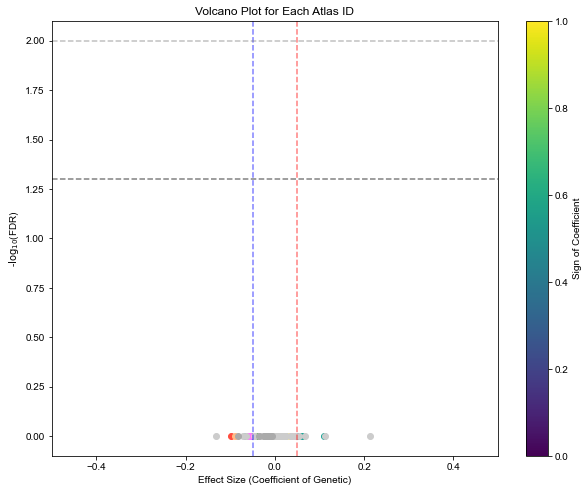

In [619]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
import rpy2.robjects as ro
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    #try:
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # pdfClusterを実行
    r_code = '''
    library(MASS)
    model <- glm.nb('log_All_cell_count ~ Age', data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
    c(coef, p_value)
    '''
    #results_ <- summary(model)
    #results_ <- summary(model)
    #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
    #coef <- summary(model)$Coefficients["Genetic", "coef"]
    ro.r(r_code)

    results = ro.r(r_code)

    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    #except:
    #    coef, p_value = 0.0, 1.0
    #    print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4.csv" #"/Regional_cellome4_WM_mask_ver1_volume_revised.csv"

            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
                
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Others_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = healthy_data['Others_cell_count'] / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    #data['log_All_cell_count'] = np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000 #np.round(data['Iba1_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


0
0


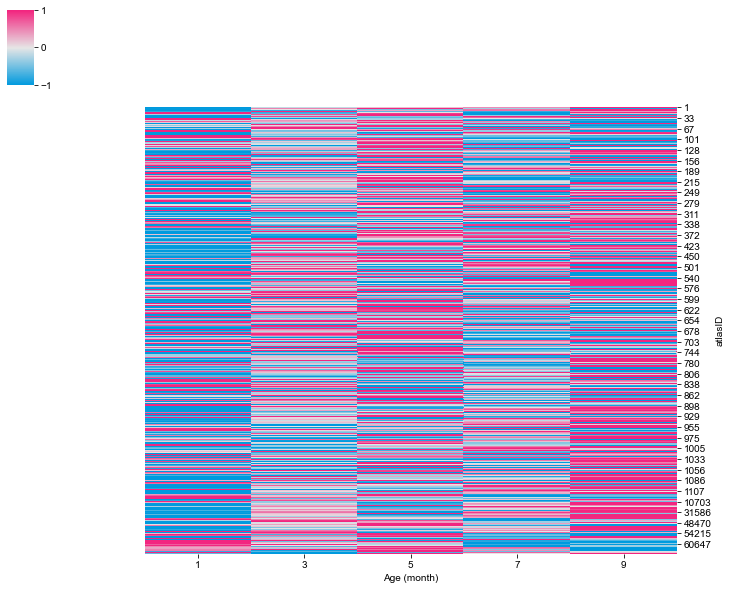

In [620]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json


# Prepare sample info
sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m" ] for s in conditions[c]]
column_order = ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m" ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("APP_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# PDFとして図を保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_Microglia_gradient_heatmap.pdf', 
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [621]:
# CSVファイルとして保存
data_pivot.to_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Others_ratio_all.csv', index=True)

In [623]:
data_pivot

,APP_1m,APP_3m,APP_5m,APP_7m,APP_9m
atlasID,,,,,
1,0.210376,0.199034,0.161808,0.202647,0.193265
2,0.172594,0.197885,0.203168,0.207371,0.219676
6,6.685198,6.809667,7.027525,6.627817,6.723969
7,2.616944,2.720650,2.801719,2.663543,2.621206
9,0.290228,0.328939,0.316482,0.343150,0.363495
...,...,...,...,...,...
60850,0.082593,0.078512,0.084610,0.082311,0.077193
60854,0.054552,0.062799,0.062180,0.065846,0.079429
60858,0.118276,0.118740,0.126423,0.119028,0.120484


In [624]:
np.where(data_pivot.index == 98)

(array([46]),)

Start time: 2024-10-02 20:53:38.647231
0      0.305012
1      0.915840
2      0.639085
3      0.657096
4      0.989059
         ...   
666    0.543005
667    0.949174
668    0.652527
669    0.411148
670    0.602642
Name: dpt_pseudotime, Length: 671, dtype: float32


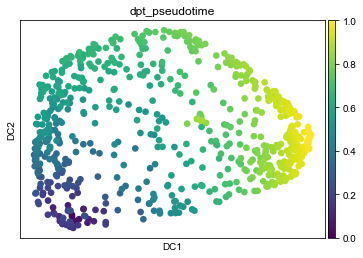

End time after X: 2024-10-02 20:53:39.189892
Duration for UMAP: 0:00:00.542661


In [625]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Others_ratio_all.csv', index_col='atlasID')

# 欠損値を各列の平均値で埋める
data_pivot = X#.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = data_pivot.apply(zscore, axis=1).fillna(0)

# 各行がリストになっているので、それを展開して2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定
adata.uns['iroot'] = 46 #240#597 #532 #634

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()


# 実行時間の計測
end_time1 = datetime.datetime.now()
print("End time after X:", end_time1)
print("Duration for UMAP:", end_time1 - start_time)


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


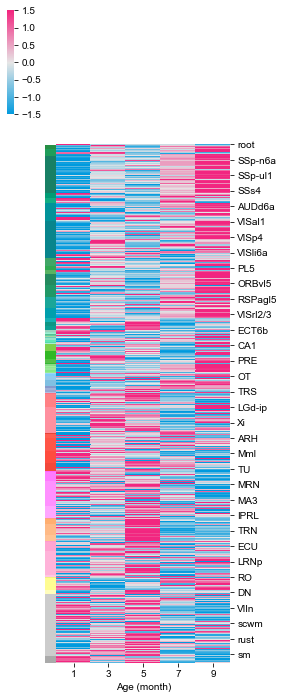

In [626]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df, cmap=cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


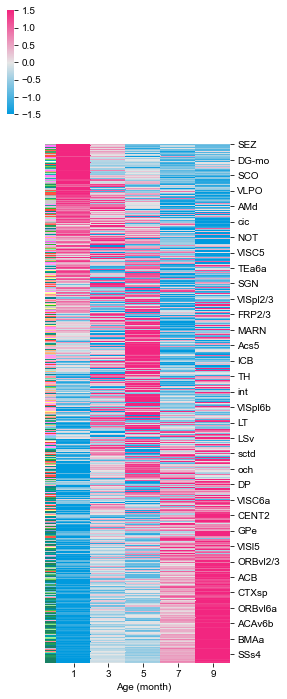

In [627]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


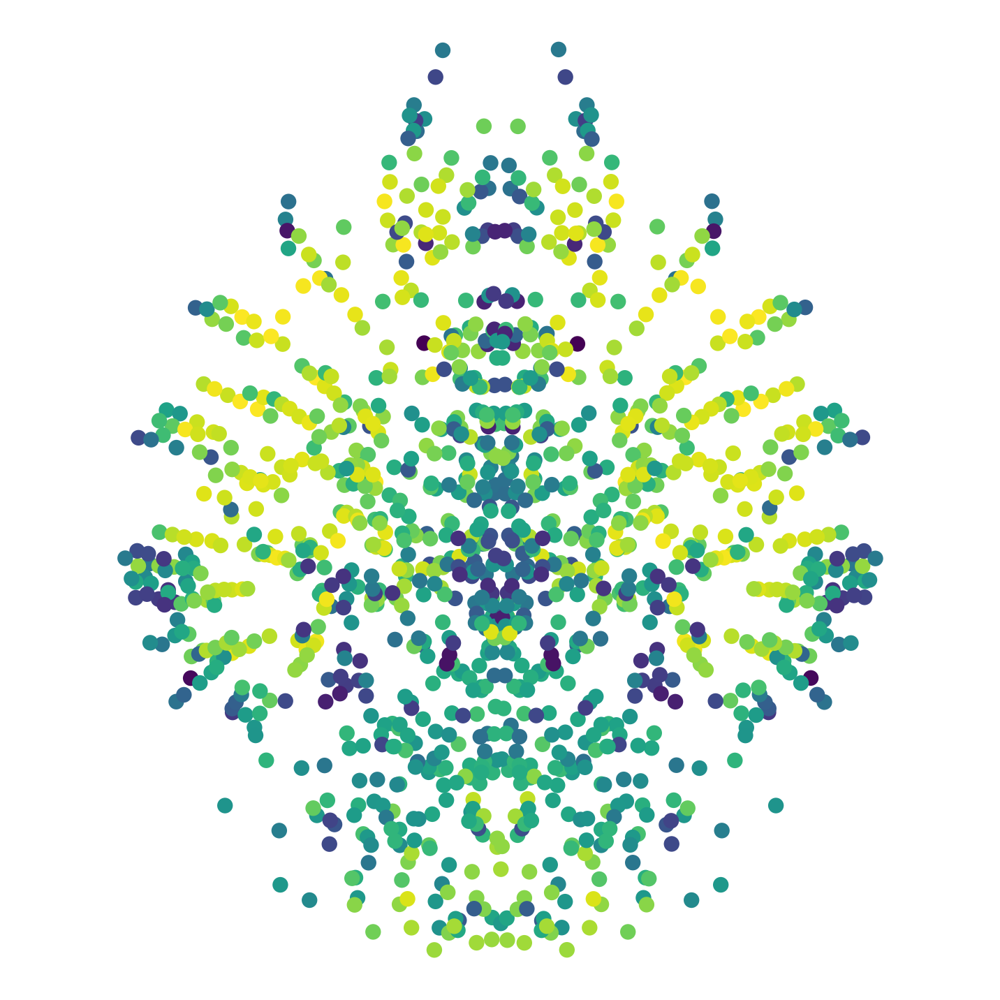

In [628]:
# atlasID が適切に設定されていることを確認する
# adata.obs に atlasID が含まれていることを前提にします
if 'atlasID' not in adata.obs.columns:
    adata.obs['atlasID'] = data_normalized.index

# pseudotime_df を adata.obs から作成し、インデックスを atlasID にする
pseudotime_df = pd.DataFrame(adata.obs[['atlasID', 'dpt_pseudotime']])

# pseudotime_df のインデックスを data_normalized のインデックス（atlasID）に基づいて設定
pseudotime_df = pseudotime_df.set_index('atlasID')

# data_normalized のインデックスに対応して pseudotime の値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['dpt_pseudotime'])

# pseudotime が NaN の場合は 0 で補完（必要に応じて）
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridis_rカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
#plt.title('Centroids of Left and Right Brain with Pseudotime Coloration')
#plt.xlabel('X (um)')
#plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.colorbar(sc, label='Pseudotime from Abeta PCA')  # カラーバーを追加
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Whole_brain_plot_of_Regional_Abeta_psedotime.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


#4_APPmodel_Ctr1m_1_2022_1104_1550
#4_APPmodel_Ctr1m_2_2022_1108_959
#4_APPmodel_Ctr1m_3_2022_1209_1751
#5_APPmodel_Ctr3m_1_2023_0113_1230
#5_APPmodel_Ctr3m_2_2023_0210_1142
#5_APPmodel_Ctr3m_3_2023_0227_1605
#4_APPmodel_Ctr3m_4_2023_0427_1444
#4_APPmodel_Ctr5m_1_2022_1026_252
#4_APPmodel_Ctr5m_2_2022_1028_2336
#4_APPmodel_Ctr5m_3_2022_1101_140
#4_APPmodel_Ctr5m_4_2023_0512_2057
#5_APPmodel_Ctr7m_1_2023_0206_1534
#5_APPmodel_Ctr7m_2_2023_0313_1111
#5_APPmodel_Ctr7m_3_2023_0331_2139
#4_APPmodel_Ctr7m_4_2023_0516_1559
#5_APPmodel_Ctr7m_5_2023_0522_2218
#5_APPmodel_Ctr9m_1_2023_0130_1607
#5_APPmodel_Ctr9m_2_2023_0216_2052
#5_APPmodel_Ctr9m_3_2023_0322_2014
#5_APPmodel_Ctr9m_4_2023_0518_1449
997
Coefficient: 0.0024656304048266504, p-value: 0.9261822742716598
68
Coefficient: -0.005315021399729274, p-value: 0.9792783494110776
667
Coefficient: -0.04430514147691973, p-value: 0.8065963445877404
52192


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005715888451697959, p-value: 0.9693501682866114
52196
Coefficient: -0.0007441423940174033, p-value: 0.9972776118945158
52264
Coefficient: 0.005736254890401307, p-value: 0.997700462208242
320
Coefficient: -0.01059565250147738, p-value: 0.890627750565855
943
Coefficient: -0.00865976176453224, p-value: 0.8293485867307541
648
Coefficient: 0.004558394235111366, p-value: 0.9065375972738461
844
Coefficient: 0.01474742263406269, p-value: 0.7012661307307417
882
Coefficient: 0.026679801722792718, p-value: 0.8255204498284856
656


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.024070498165496872, p-value: 0.6829632009054261
962
Coefficient: -0.019910724388264158, p-value: 0.640584165607208
767
Coefficient: -0.0003509964524384735, p-value: 0.9920686003464435
1021
Coefficient: 0.010802802972887183, p-value: 0.7975508574800391
1085
Coefficient: 0.024140217547696786, p-value: 0.9006339985399663
558
Coefficient: 0.0036959921497802927, p-value: 0.9772423298376514
838
Coefficient: -0.006198100945764458, p-value: 0.9466088520650874
654
Coefficient: -0.0013004531951511958, p-value: 0.9886680225637923
702


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0004316019244390887, p-value: 0.9962016286926021
889
Coefficient: 0.0068422674597877885, p-value: 0.9289430633951719
929
Coefficient: 0.0073440099604877625, p-value: 0.9794111714721074
981
Coefficient: -0.0077831262362077595, p-value: 0.9272899268381701
201
Coefficient: 0.0014684899146214163, p-value: 0.9799600106004464
1047
Coefficient: 0.008498229238233714, p-value: 0.888870290139338
1070
Coefficient: 0.008603319772577368, p-value: 0.8857744071968469
1038
Coefficient: 0.015223514730637093, p-value: 0.7894717247215609
1062


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014283679725150735, p-value: 0.910591393700623
1030
Coefficient: -0.004758993225381919, p-value: 0.9767892750720081
113
Coefficient: -0.0035794387417122236, p-value: 0.97095230781172
1094
Coefficient: 0.00606872417916692, p-value: 0.9633471033446389
1128
Coefficient: 0.003159227546166503, p-value: 0.9710082708920282
478
Coefficient: 0.016279829589492652, p-value: 0.8619033054923015
510
Coefficient: 0.01030199471713562, p-value: 0.9615702777439546
878
Coefficient: -0.0027656769803941035, p-value: 0.9758126050521582
657


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01046587885535395, p-value: 0.8637640959181024
950
Coefficient: -0.002176860454678801, p-value: 0.9744073960575955
974
Coefficient: -0.001475479677742975, p-value: 0.9799080117762371
1102
Coefficient: 0.00645916809644987, p-value: 0.9018707619086692
2
Coefficient: 0.01019329917985453, p-value: 0.956137549265409
450
Coefficient: -0.012273055740873454, p-value: 0.9217352987039078
854
Coefficient: -0.003492683030352974, p-value: 0.9644061298669765
577
Coefficient: 0.006270192033363572, p-value: 0.9478601843108441
625


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004774610745562963, p-value: 0.9489821471312452
945
Coefficient: 0.01325403280956162, p-value: 0.8488273941853324
1026
Coefficient: 0.016561216964608903, p-value: 0.9285631211128262
1006
Coefficient: -0.006303324857440281, p-value: 0.9733105932686215
670
Coefficient: 0.0020800199501991175, p-value: 0.9860730296542388
1086
Coefficient: 0.0035764792424028357, p-value: 0.9853472325303511
1111
Coefficient: 0.0041709731018137915, p-value: 0.9723021148812944
9
Coefficient: 0.015004950511996691, p-value: 0.9188211448578832
461


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.012064087562499983, p-value: 0.9655873847280183
18693
Coefficient: -0.01346358392523823, p-value: 0.9476834685170412
18697
Coefficient: -0.0006756440620901809, p-value: 0.9959440098018587
18701
Coefficient: 0.00746649155880078, p-value: 0.9633707444579064
18705
Coefficient: 0.0037802485093328788, p-value: 0.9779939963494417
18709
Coefficient: 0.009589412499868192, p-value: 0.9381855665592718
18713
Coefficient: 0.010322165969010116, p-value: 0.9746599027517056
873
Coefficient: -0.014916811562072436, p-value: 0.8456727532779328
806


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014940802147641001, p-value: 0.7728184086087965
1035
Coefficient: 0.0021925266535006553, p-value: 0.9730250755691732
1090
Coefficient: -0.0029391887132729005, p-value: 0.9513302050080568
862
Coefficient: -0.002837284316360158, p-value: 0.956993494341377
893
Coefficient: -0.004416092532934701, p-value: 0.9765542191156731
36
Coefficient: -0.03749612516163451, p-value: 0.8703342679863126
180
Coefficient: -0.03618477436352253, p-value: 0.8056727596496733
148
Coefficient: -0.02729380194093563, p-value: 0.9036491194297173
187


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.024380996280735853, p-value: 0.8372084307610417
638
Coefficient: -0.016248762425897668, p-value: 0.8909129396010249
662
Coefficient: -0.005510384457287453, p-value: 0.9873668442403065
897
Coefficient: -0.027753543663811574, p-value: 0.8727594342256846
1106
Coefficient: -0.03802778008400608, p-value: 0.7652685241913555
1010
Coefficient: -0.02747365319803597, p-value: 0.8907774256812208
1058
Coefficient: -0.029841977578441363, p-value: 0.7758219779445168
857
Coefficient: -0.0335572574867554, p-value: 0.7779568165379336
849


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.030971386871138946, p-value: 0.9225543169877166
527
Coefficient: 0.013035721380978868, p-value: 0.9422413986396181
600
Coefficient: 0.0047317485514703425, p-value: 0.9699897521858201
678
Coefficient: 0.023021179333420266, p-value: 0.8930352868638411
252
Coefficient: 0.011930482968211593, p-value: 0.9121987751632339
156
Coefficient: 0.0036351194373331593, p-value: 0.9822035935883214
243
Coefficient: -0.00043932090335874023, p-value: 0.9988845101525915
735
Coefficient: -0.011249566167459679, p-value: 0.9321840842219256
251


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.020897098141643873, p-value: 0.8424019147184634
816
Coefficient: -0.0038366137480950195, p-value: 0.9773206643710235
847
Coefficient: -0.006337387279256312, p-value: 0.9381516747831933
954
Coefficient: -0.003807959619187667, p-value: 0.977671370731936
1005
Coefficient: -0.011193315235105557, p-value: 0.9638986788446083
696
Coefficient: -0.021808161743291962, p-value: 0.9350408679068976
643
Coefficient: -0.010500022803530889, p-value: 0.9595341710676113
759
Coefficient: 0.0036567619278257114, p-value: 0.988835338257703
791


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0005725499156610946, p-value: 0.9973430688583058
249
Coefficient: -0.0009576603178241988, p-value: 0.9971870527515664
456
Coefficient: -0.002181314455194714, p-value: 0.9963098688238248
959
Coefficient: -0.023348831621982542, p-value: 0.887018183966961
755
Coefficient: -0.04104771917803727, p-value: 0.7692581055917247
990
Coefficient: -0.029209380496199908, p-value: 0.8636459202982174
1023
Coefficient: -0.02862886898396929, p-value: 0.7789478876872424
520
Coefficient: -0.014950552292476172, p-value: 0.9211093136737398
598


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01745161721911442, p-value: 0.9557079818066402
1074
Coefficient: -0.008710415740397728, p-value: 0.9723685817470947
905
Coefficient: -0.0013342459525907775, p-value: 0.9941373183759306
1114
Coefficient: 0.01869824905000859, p-value: 0.9330938355137129
233
Coefficient: 0.011172464712308702, p-value: 0.942873455032918
601
Coefficient: 0.013327576327108745, p-value: 0.9519555828989482
649
Coefficient: 0.010438192820471166, p-value: 0.9796881229246094
281
Coefficient: 0.03999678355942948, p-value: 0.8388644639759646
1066


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007573158123019184, p-value: 0.965488849939575
401
Coefficient: 0.010371717273697284, p-value: 0.9719050274720564
433
Coefficient: 0.002020266396223694, p-value: 0.9887381947522771
1046
Coefficient: 0.014211474433941993, p-value: 0.9384418007571147
441
Coefficient: 0.011220070898622673, p-value: 0.9774369358714057
421
Coefficient: -0.0003705139071235038, p-value: 0.9986080330200638
973
Coefficient: -0.01209583486249473, p-value: 0.9384759987767398
573


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0003876298133522357, p-value: 0.9982627978657228
613
Coefficient: -0.008156198672161984, p-value: 0.9501902092617508
74
Coefficient: -0.0064542518995452615, p-value: 0.9694724497894487
121
Coefficient: -0.0015037429425016544, p-value: 0.9963196130597887
593
Coefficient: 0.022263027437207896, p-value: 0.7584104653372918
821
Coefficient: 0.0040196209316752125, p-value: 0.943352489288558
721
Coefficient: 0.009545644009184983, p-value: 0.8898054041951523
778
Coefficient: 0.005213528888595441, p-value: 0.9272095791244902
33


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01003564962703806, p-value: 0.8871108599785456
305
Coefficient: 0.012703993340146843, p-value: 0.9325615050070392
750
Coefficient: 0.006163787376060776, p-value: 0.9661531542274608
269
Coefficient: -0.012356023261513107, p-value: 0.9268120393019933
869
Coefficient: -0.014003934588594235, p-value: 0.9695603432535106
902
Coefficient: -0.008104734177855118, p-value: 0.9495871732706249
377
Coefficient: -0.002254844262099604, p-value: 0.990760394016305
393
Coefficient: 0.008891137373790964, p-value: 0.9894617499708703
805


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.030076591415706854, p-value: 0.8702160102180893
41
Coefficient: -0.003967459221753989, p-value: 0.9785045573910214
501
Coefficient: 0.006195414568683136, p-value: 0.9780828564642143
565
Coefficient: -0.0006663872728165214, p-value: 0.996050925602695
257
Coefficient: 0.012053097860978051, p-value: 0.9491561627357448
469
Coefficient: 0.01075565011918188, p-value: 0.976770539316955
31578
Coefficient: -0.027471767453154466, p-value: 0.938822947612834
31582
Coefficient: -0.019298077042000084, p-value: 0.9406201125447484
31586


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004865799168694343, p-value: 0.9880532330401975
31590
Coefficient: -0.015973356428303886, p-value: 0.9361479584466138
31594
Coefficient: -0.013545873066410401, p-value: 0.9614171343131324
31598
Coefficient: -0.009149870647704466, p-value: 0.9858538779540497
31632
Coefficient: -0.008634242964051046, p-value: 0.9571845011872591
31636
Coefficient: -0.013972821265635371, p-value: 0.9176199303642886
31640
Coefficient: -0.036275766036863985, p-value: 0.9172140006336946
31644
Coefficient: -0.015390216422539158, p-value: 0.9101827979625567
31648


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.018500623643162368, p-value: 0.9276802493599493
31652
Coefficient: -0.012099096695495144, p-value: 0.9732688121409682
935
Coefficient: -0.03031147686540105, p-value: 0.7342895679374594
211
Coefficient: -0.02833988990492928, p-value: 0.7844016524702024
1015
Coefficient: -0.007295858436260488, p-value: 0.9090726105875468
919
Coefficient: 0.00883244061808891, p-value: 0.9081551574304025
927
Coefficient: 0.02893750780646862, p-value: 0.9318840428244267
588
Coefficient: -0.024116305682965893, p-value: 0.8203788199287094
296


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0073707416748776235, p-value: 0.9492362397339974
772
Coefficient: 0.0012393629041139711, p-value: 0.985658058272369
810
Coefficient: 0.010304621068738895, p-value: 0.9242035762178377
819
Coefficient: 0.03230574800690908, p-value: 0.8885179022402325
171
Coefficient: -0.098385811151412, p-value: 0.3876236595644911
304
Coefficient: -0.04982907001556767, p-value: 0.7225126282710983
363
Coefficient: -0.028354110734073252, p-value: 0.746420410136373
84
Coefficient: -4.403995564901668e-05, p-value: 0.9996562970619404
132


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.023164972999892182, p-value: 0.9467304509441216
707
Coefficient: -0.010709234161484239, p-value: 0.9584323169121225
556
Coefficient: -0.0276316445355016, p-value: 0.9112486863835427
827
Coefficient: -0.02710398859883923, p-value: 0.8489366296592644
1054
Coefficient: -0.003812914220553566, p-value: 0.9782165985070282
1081
Coefficient: 0.014126755380952665, p-value: 0.977381275871908
448
Coefficient: 0.027930220724269896, p-value: 0.8388315936067396
412
Coefficient: -0.0022808323969173176, p-value: 0.9834768949413067
630


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.002788369513655367, p-value: 0.9689785584639279
440
Coefficient: 0.0069592202263710065, p-value: 0.9443114156638936
488
Coefficient: 0.010076607453724252, p-value: 0.9702900044357609
484
Coefficient: -0.05583426644283556, p-value: 0.7075911304161169
582
Coefficient: -0.03263762059343503, p-value: 0.8398001089600853
620
Coefficient: -0.01937564109397973, p-value: 0.8688483666660005
910
Coefficient: 0.002761009666712977, p-value: 0.9859770329930042
52977
Coefficient: 0.01797317562217891, p-value: 0.9829820123761728
969


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01420250477400049, p-value: 0.9240606213805765
288
Coefficient: -0.011878668666976342, p-value: 0.9199115135751089
1125
Coefficient: -0.00017174519495725648, p-value: 0.998597232608208
608
Coefficient: 0.006159705277206408, p-value: 0.9654994332285411
680
Coefficient: 0.011805183958924687, p-value: 0.9829530738062348
996
Coefficient: -0.0022980262810004173, p-value: 0.9886201298264138
328
Coefficient: -0.027845762396273906, p-value: 0.7954931927999058
1101
Coefficient: -0.023575067178648035, p-value: 0.7538290142381721
783


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011305804451458784, p-value: 0.8968844723093059
831
Coefficient: -0.0028510641568948287, p-value: 0.9927899591833671
120
Coefficient: -0.023335581565186208, p-value: 0.8974691295777169
163
Coefficient: -0.027287345623786593, p-value: 0.8040452985950364
344
Coefficient: -0.003203656065107313, p-value: 0.9753875263902294
314
Coefficient: -0.005704835792207806, p-value: 0.9628798665424323
355
Coefficient: -0.003343984130128061, p-value: 0.9937422241905846
704
Coefficient: -0.008264693970709034, p-value: 0.9672658347348344
694


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -5.758405139301763e-05, p-value: 0.9996442842987573
800
Coefficient: -0.006072807666620387, p-value: 0.9537197472720434
675
Coefficient: 0.010821074649447664, p-value: 0.951962883668428
699
Coefficient: -0.0002630853916585903, p-value: 0.9998304569760428
671
Coefficient: 0.017860093931527016, p-value: 0.8702560228032664
965
Coefficient: -0.00410417473394973, p-value: 0.9660385845378897
774
Coefficient: -0.0006908442284053393, p-value: 0.9933379525822973
906
Coefficient: 0.004371526494963586, p-value: 0.9684227212167038
279


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.006180737257656568, p-value: 0.9864845049082076
442
Coefficient: 0.02311397691600377, p-value: 0.7506157198257238
434
Coefficient: 0.004617798873676527, p-value: 0.9471042718428287
610
Coefficient: 0.004915715745153205, p-value: 0.9330595606920482
274
Coefficient: 0.004974408932176155, p-value: 0.9468476355783991
330
Coefficient: 0.008104284945653708, p-value: 0.9822158374977855
542
Coefficient: -0.014338494843467242, p-value: 0.7906340357222243
430
Coefficient: -0.0037051422983975717, p-value: 0.9492866266157711
687


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004049817148646564, p-value: 0.9279632478672267
590
Coefficient: 0.011276635869224925, p-value: 0.8792274591249712
622
Coefficient: 0.019715498115841484, p-value: 0.9375299951261706
31550
Coefficient: -0.02335761581440241, p-value: 0.8905691597535427
31554
Coefficient: -0.003167797611074078, p-value: 0.9790087346980032
31558
Coefficient: 0.007475563630084954, p-value: 0.967190184576787
31562
Coefficient: 0.004479050690102284, p-value: 0.9689089941090323
31566
Coefficient: 0.015404649492216073, p-value: 0.9169697129308354
31570


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014407605742703807, p-value: 0.9607919982805116
31604
Coefficient: -0.0023069308471113437, p-value: 0.990200549869504
31608
Coefficient: 0.007977502876527537, p-value: 0.9539491497121696
31612
Coefficient: 0.017081034667411062, p-value: 0.9241068315233778
31616
Coefficient: 0.011002475267370096, p-value: 0.9347858267206792
31620
Coefficient: 0.017230593727875464, p-value: 0.9200111975985907
31624
Coefficient: 0.017803506268156695, p-value: 0.9528925153750349
97
Coefficient: -0.04777888313520259, p-value: 0.7400683611873697
1127


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.04160713268711926, p-value: 0.7143095089731202
234
Coefficient: -0.03696078240851436, p-value: 0.8118555094595523
289
Coefficient: -0.03532609369290238, p-value: 0.6984198579375106
729
Coefficient: -0.019554341929080767, p-value: 0.8714291718374869
786
Coefficient: -0.01373881941059761, p-value: 0.9541249020441502
540
Coefficient: -0.020892430783914475, p-value: 0.921848392006536
888
Coefficient: -0.012473859361389896, p-value: 0.9343376585776484
692
Coefficient: -0.0046005035949463775, p-value: 0.98322752077128
335


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013761781607074216, p-value: 0.9734814134123831
368
Coefficient: -0.007358387722977895, p-value: 0.9911272837362985
836
Coefficient: -0.06951574934518129, p-value: 0.744294259950437
427
Coefficient: -0.03605113875007762, p-value: 0.7974708437584305
988
Coefficient: -0.021764983406352016, p-value: 0.8674818053155422
977
Coefficient: -0.003176130706000874, p-value: 0.9824289516608844
1045
Coefficient: 0.00022103682691087398, p-value: 0.9993566948661396
698
Coefficient: 0.01623722606224713, p-value: 0.5346336676884598
507


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.019003395193273806, p-value: 0.08129624620271643
188
Coefficient: 0.005845026980206602, p-value: 0.954214695293603
196
Coefficient: -0.012814079258927115, p-value: 0.886621398892326
204
Coefficient: 0.0014785323369716835, p-value: 0.9855722582771886
159
Coefficient: 0.004083304123010234, p-value: 0.90129393304135
597
Coefficient: -0.020593635831878853, p-value: 0.8208176705110157
605
Coefficient: 0.021695786177525718, p-value: 0.7922672728576263
814
Coefficient: -0.01386768607974717, p-value: 0.8868380075744163
961


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/p

Coefficient: -0.010362716081989248, p-value: 0.688729474303805
260
Coefficient: 0.08311140160467424, p-value: 0.7219485402294721
268
Coefficient: 0.029352545759076455, p-value: 0.874967339505525
1139
Coefficient: 0.006890833145568351, p-value: 0.9802197231057963
639
Coefficient: 0.006353762237473833, p-value: 0.9413222702004733
655
Coefficient: 0.002756970986444902, p-value: 0.9717222370414257
663
Coefficient: -0.005984135741629411, p-value: 0.9219659799439949
788
Coefficient: -0.0031651165098157547, p-value: 0.9732638386481536
566


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03207844309157961, p-value: 0.6866371119322272
1089
Coefficient: 0.0008310401408288138, p-value: 0.9925729457689024
382
Coefficient: -0.0072065819799310695, p-value: 0.7842415968950018
423
Coefficient: -0.01148545519221189, p-value: 0.9272037325193666
463
Coefficient: -0.00859194005593821, p-value: 0.77872810211347
10703
Coefficient: -0.026072664275113417, p-value: 0.4597087044781738
10704
Coefficient: -0.08347787914167078, p-value: 0.21489622418020699
632
Coefficient: -0.06276739524384435, p-value: 0.22650074968579606
982


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009481014020981627, p-value: 0.9679102481057402
19
Coefficient: -0.006591794643529808, p-value: 0.9673422236409479
1121
Coefficient: -0.026023860067897364, p-value: 0.8099742270574515
20
Coefficient: -0.022306765122539124, p-value: 0.7489688254019665
52
Coefficient: -0.011211183388013822, p-value: 0.8797447543810006
139
Coefficient: -0.005538705696374987, p-value: 0.9408960870008177
28
Coefficient: -0.005518634557684327, p-value: 0.9494364255204533
526
Coefficient: -0.01670143192765274, p-value: 0.8202189326416525
543


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014243188333161728, p-value: 0.8352174371264535
664
Coefficient: -0.013299540948429552, p-value: 0.863630593074336
727
Coefficient: -0.007686354347640582, p-value: 0.9239197681591949
743
Coefficient: -0.002134748250216364, p-value: 0.9829957879498165
843
Coefficient: -0.0133007317783366, p-value: 0.8392920635415231
1037
Coefficient: -0.0064518306555226565, p-value: 0.9013343043802821
1084
Coefficient: 0.003572858099856953, p-value: 0.9568820898279033
502
Coefficient: -0.0018904009444695973, p-value: 0.9645139806339216
48470


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005348534902075524, p-value: 0.9298966953384094
58447
Coefficient: -0.0026021931997822134, p-value: 0.9783044333057946
48508
Coefficient: -0.021694725343831822, p-value: 0.8338888500044819
703
Coefficient: 0.004588963973110526, p-value: 0.9673512643253412
583
Coefficient: -0.009539341387022416, p-value: 0.925492872647438
952
Coefficient: 0.013504140721053085, p-value: 0.8027160404981126
966
Coefficient: 0.00629765891027001, p-value: 0.9360486182257755
131
Coefficient: -0.010112807036864006, p-value: 0.9018597298335611
303


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006499708021667572, p-value: 0.9413458735897372
311
Coefficient: -0.006600571391274608, p-value: 0.9395120004164699
451
Coefficient: -3.682989479725254e-05, p-value: 0.9997942315864933
327
Coefficient: 0.00520818963771795, p-value: 0.9512272465969676
334
Coefficient: -0.006074060418077956, p-value: 0.9467176208216721
780
Coefficient: -0.011761816580350323, p-value: 0.850434454055821
477
Coefficient: -5.0165183654624594e-05, p-value: 0.9989269326766718
672
Coefficient: -0.0055247577894454595, p-value: 0.6819741150750183
56


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003525490763324142, p-value: 0.9182616303590759
998
Coefficient: 0.006158396085770797, p-value: 0.9541286268180522
754
Coefficient: 0.004349592912337068, p-value: 0.9164001282812151
250
Coefficient: -0.002225086082770065, p-value: 0.9813611326019538
258
Coefficient: -0.006775405520142753, p-value: 0.8746774847646828
266
Coefficient: -0.015152686405275688, p-value: 0.8334156240003058
310
Coefficient: 0.006524027773887745, p-value: 0.9328236836166749
333
Coefficient: -0.009286410354797181, p-value: 0.9782564910991581
23


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010911184612806995, p-value: 0.8988855247622352
292
Coefficient: 0.0911160199876604, p-value: 0.809810495116881
544
Coefficient: -0.007906445180046724, p-value: 0.9542952682098282
551
Coefficient: 0.003384468170485392, p-value: 0.9808202301756744
559
Coefficient: 0.007361060722149633, p-value: 0.9237525839846114
1105
Coefficient: 0.001675746637431563, p-value: 0.9923813610319696
403
Coefficient: 0.0041175622300460785, p-value: 0.9337978612334957
803
Coefficient: -0.000957673890446907, p-value: 0.9852559285715597
1022


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0005523111137924364, p-value: 0.9901454928220005
1031
Coefficient: 0.011250846341602462, p-value: 0.8887197359554488
342
Coefficient: 0.0071757003087623075, p-value: 0.84513442939997
298
Coefficient: 0.012427744390001891, p-value: 0.8955730685713359
564
Coefficient: -0.00028056008781953014, p-value: 0.9978383250266714
596
Coefficient: 0.0033755061801877713, p-value: 0.964540091799291
581
Coefficient: 0.00874892630090085, p-value: 0.9087297741529163
351
Coefficient: 0.007839933156332581, p-value: 0.8895972603403045
287


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.02505491422250455, p-value: 0.9655777013991034
549
Coefficient: -0.0023696125355168883, p-value: 0.9669321796804816
629
Coefficient: -0.01003001769479228, p-value: 0.8710024268573369
685
Coefficient: -0.007076517436952589, p-value: 0.907558682563671
718
Coefficient: -0.00202463329585573, p-value: 0.9723592448161987
725
Coefficient: -0.006434096163006578, p-value: 0.9734147967006425
733
Coefficient: -0.00329647287548629, p-value: 0.9430411992298017
741
Coefficient: -0.0030494042483162486, p-value: 0.9805711668059626
56435


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0004970650578655334, p-value: 0.996080857228216
414
Coefficient: 0.0007749236589878551, p-value: 0.9969917117888213
422
Coefficient: -0.0038754883781936065, p-value: 0.9796037992710203
609
Coefficient: -0.004295438066304847, p-value: 0.9793510900981998
1044
Coefficient: -0.0015454821444910443, p-value: 0.9945464772204365
1072
Coefficient: 0.013522996742174541, p-value: 0.9179043685445929
1079
Coefficient: 0.030773805387526425, p-value: 0.7603213658730434
1088
Coefficient: 0.0031758701114972606, p-value: 0.9777982250187087
49664


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.012669429164474442, p-value: 0.916936547442972
49668
Coefficient: 0.007728208334445683, p-value: 0.9337485373744947
49672
Coefficient: 0.014557588061153825, p-value: 0.9401306725634719
218
Coefficient: 0.00811495428540535, p-value: 0.878698553923633
1020
Coefficient: -0.005627343070757089, p-value: 0.9207598923758614
1029
Coefficient: 0.000677874704394682, p-value: 0.9951801845388643
325
Coefficient: -0.004021909054544425, p-value: 0.976042082190603
56551
Coefficient: 0.013002475772960466, p-value: 0.9124743543287211
255


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007197682554488154, p-value: 0.930424564888608
1096
Coefficient: -0.011132370275728918, p-value: 0.9300366669729215
1104
Coefficient: -0.005794813685120703, p-value: 0.9676184908440124
64
Coefficient: -0.00406321005242386, p-value: 0.9761844778207815
1120
Coefficient: -0.021347530888584505, p-value: 0.9487507085338486
1113
Coefficient: -0.0018966266144583878, p-value: 0.9911140853485997
155
Coefficient: -0.006445420712435328, p-value: 0.9132975020573171
59
Coefficient: -0.003982281061233238, p-value: 0.9797897177314769
362


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0026192310397681238, p-value: 0.9586505983701792
366
Coefficient: 0.0016912231204702585, p-value: 0.9872609072473103
1077
Coefficient: -0.008551855101980057, p-value: 0.9602179333881234
149
Coefficient: -0.03381211861448875, p-value: 0.7012031102260643
15
Coefficient: 0.0007928299707943225, p-value: 0.9954871208338186
181
Coefficient: -0.01252807456294713, p-value: 0.9007739794203384
56559
Coefficient: -0.011170050344139794, p-value: 0.9613198314628625
189
Coefficient: -0.0009866396330083073, p-value: 0.9958684388519077
599


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013123339754082365, p-value: 0.9159728002045197
907
Coefficient: -0.009491437369199541, p-value: 0.9380545571687636
575
Coefficient: 0.0019651509610880127, p-value: 0.9838343433328166
930
Coefficient: -0.0026847080154127154, p-value: 0.9740509194053649
56563
Coefficient: 0.00468824146269877, p-value: 0.9714118629588562
262
Coefficient: 0.003933451156253691, p-value: 0.9203937513210085
27
Coefficient: 0.0037873748046317684, p-value: 0.9852206008085801
56439
Coefficient: 0.017308496913061376, p-value: 0.9607306236154569
178


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004380839958866208, p-value: 0.9581914038345021
321
Coefficient: 0.02114158883586134, p-value: 0.9377996100592852
483
Coefficient: -0.0028617671754490102, p-value: 0.9615891812435411
186
Coefficient: 0.004505420395798864, p-value: 0.9526517578437065
1097
Coefficient: 0.0024862472816771625, p-value: 0.9447731823827334
390
Coefficient: 0.021713923490797704, p-value: 0.9359061061261449
332
Coefficient: 0.0008188747175445514, p-value: 0.9992427227308394
38
Coefficient: -0.0043768285450621, p-value: 0.9689922600510553
30


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.000937003210469557, p-value: 0.9954382726644109
118
Coefficient: -0.010916057728009144, p-value: 0.9332088881528543
223
Coefficient: 0.03384043586321346, p-value: 0.7225291022937642
72
Coefficient: 0.007687491647968975, p-value: 0.9685651028200024
263
Coefficient: 0.002624400204024601, p-value: 0.9889337830075998
272
Coefficient: -0.0052510107752995125, p-value: 0.970240294557287
830
Coefficient: -0.008573352495936637, p-value: 0.9333716843989313
452
Coefficient: -0.005523454645001612, p-value: 0.9845054888130201
523


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0016053072659385117, p-value: 0.9845579629597433
763
Coefficient: -0.006909727895746725, p-value: 0.9889199007061178
914
Coefficient: -0.014997518049541752, p-value: 0.981705430861479
1109
Coefficient: 0.0033291958836935407, p-value: 0.9857991682811466
126
Coefficient: 0.08667647663961052, p-value: 0.5533164141008298
133
Coefficient: -0.005773605905195696, p-value: 0.9667237191892383
347
Coefficient: -0.00388922491335674, p-value: 0.9818001990230744
286
Coefficient: 5.476051977075954e-05, p-value: 0.9996490784314566
338


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0016041573177921933, p-value: 0.9955761387321779
57699
Coefficient: 0.027166888799214986, p-value: 0.92475980955865
689
Coefficient: 0.014968529750614594, p-value: 0.9505291645120216
88
Coefficient: 0.002026245606900711, p-value: 0.9779330267739531
210
Coefficient: -0.01211702924049302, p-value: 0.9426480938388553
732
Coefficient: -0.022548039643964457, p-value: 0.9095242625370661
60647
Coefficient: 0.005199425252714806, p-value: 0.9597274441280965
60651
Coefficient: -0.01113345004739241, p-value: 0.9373590030578487
60655


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011159090383782861, p-value: 0.9625915615675782
60659
Coefficient: 0.011095128599553685, p-value: 0.9458925492966923
525
Coefficient: 0.0007946802278956935, p-value: 0.9940700519485903
1126
Coefficient: -0.013589398139864645, p-value: 0.9558304213922136
1
Coefficient: 0.00267652857816972, p-value: 0.988352311578172
515
Coefficient: 0.0017274493703710273, p-value: 0.9883117979538512
980
Coefficient: -0.004114698254961428, p-value: 0.9794528114616635
1004
Coefficient: 0.004052613655859626, p-value: 0.978140311479273
63


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006942577780243308, p-value: 0.9687851174939424
693
Coefficient: 0.01009957933662012, p-value: 0.9170918728096743
946
Coefficient: -0.0008095265652971432, p-value: 0.9913051543660805
194
Coefficient: 0.0007539149624213082, p-value: 0.9844591942627601
226
Coefficient: 0.0044738056370797405, p-value: 0.9530533157729649
356
Coefficient: 0.00021251948044176272, p-value: 0.9996403359902731
364
Coefficient: 0.0058216505350769995, p-value: 0.967877872087671
57704
Coefficient: 0.003454908168208968, p-value: 0.9775436666721926
173


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.025521125295962354, p-value: 0.8430795307818932
470
Coefficient: 0.008197786440598516, p-value: 0.9429106705442537
614
Coefficient: 0.04409575932118333, p-value: 0.5767678917787435
797
Coefficient: 0.0002852515359711998, p-value: 0.9945778590354797
804
Coefficient: -0.00713829752058346, p-value: 0.9514459831284632
10671
Coefficient: 0.08957112395122693, p-value: 0.6092597511168432
313
Coefficient: -0.003218371117755302, p-value: 0.8759406090929887
851
Coefficient: -0.015186875092192555, p-value: 0.8130396516512156
842


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0023272827529039696, p-value: 0.9606815855013046
834
Coefficient: 0.028621167249024415, p-value: 0.7257477612110288
811
Coefficient: 0.006344482560233909, p-value: 0.8865703488429703
820
Coefficient: 0.008626237018919267, p-value: 0.8605036931274487
828
Coefficient: -0.004280231544147714, p-value: 0.9088544735013012
580
Coefficient: -0.002296716039718229, p-value: 0.9904906699411345
271
Coefficient: -0.01754271442718612, p-value: 0.921136565903816
874
Coefficient: -0.05164565434219917, p-value: 0.8311537889592931
460


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009033069030345911, p-value: 0.9859001998550655
59923
Coefficient: -0.02964346290983317, p-value: 0.9020106319362058
381
Coefficient: -0.003364568510467578, p-value: 0.9415230108984561
749
Coefficient: 0.0070537384002921635, p-value: 0.9361667714264827
60830
Coefficient: -0.003771780503027083, p-value: 0.9916620249008178
246
Coefficient: 0.007914340568437548, p-value: 0.9588715406966813
128
Coefficient: -0.004216245844374218, p-value: 0.8630372416878906
26
Coefficient: -0.0014501119988359487, p-value: 0.9750182310053014
42


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00011988796372468668, p-value: 0.9989219705396165
17
Coefficient: -0.004587249702155421, p-value: 0.8908757194776007
10
Coefficient: -0.012105030858901893, p-value: 0.7258151318685414
795
Coefficient: -0.005139434833721537, p-value: 0.8507305264116412
50
Coefficient: -0.010927334940758105, p-value: 0.9376832271885263
67
Coefficient: 4.4189031863691624e-05, p-value: 0.9998008777569654
587
Coefficient: 0.0004409090206328064, p-value: 0.9978006105006343
61277
Coefficient: 0.0009773765170251422, p-value: 0.9971116494923146
215


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -1.9734086159634875e-05, p-value: 0.9996546050778112
531
Coefficient: -0.003907446484110717, p-value: 0.9862012733709844
628
Coefficient: -0.005469769996897267, p-value: 0.9565194177463306
634
Coefficient: -0.0014138768169911547, p-value: 0.9886952030112085
706
Coefficient: 0.0006565546813495268, p-value: 0.9975806109172765
1061
Coefficient: 0.0012263287137861526, p-value: 0.9926946322808906
54203
Coefficient: -0.005193896361160085, p-value: 0.9812963247754046
616
Coefficient: -0.0006909316678293222, p-value: 0.9916454337853166
214


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003783034967605909, p-value: 0.9529262123477493
35
Coefficient: 0.0007537898663318725, p-value: 0.9978570045293772
54211
Coefficient: 0.002105883399030733, p-value: 0.9962823972238278
975
Coefficient: -0.000684913520949049, p-value: 0.9984137800360819
115
Coefficient: -0.005839184871040496, p-value: 0.9935807292650304
60663
Coefficient: -0.0036098559378667464, p-value: 0.9936213433255199
757
Coefficient: 0.016235547597399355, p-value: 0.940560012973244
231
Coefficient: 0.016455957310617726, p-value: 0.9421124912119008
66


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.006710058525646147, p-value: 0.9852037721769201
75
Coefficient: -0.04315809976572174, p-value: 0.933542281268934
58
Coefficient: 0.009061681738200593, p-value: 0.9697814945591449
374
Coefficient: 0.00601883595960232, p-value: 0.9640466531031529
1052
Coefficient: 0.000367588258468397, p-value: 0.995087186083518
12
Coefficient: -0.0015072614255407077, p-value: 0.9929319088239031
100
Coefficient: 0.002259330844270888, p-value: 0.9965570423116256
60834
Coefficient: -0.01164456933339819, p-value: 0.9424645114691635
60838


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011804311176605454, p-value: 0.9550568738430026
60842
Coefficient: 0.013352283440397275, p-value: 0.9642156227575012
60846
Coefficient: 0.0009643332733326225, p-value: 0.9962340681907504
60850
Coefficient: -0.0010137690034910682, p-value: 0.9972175734447951
60854
Coefficient: 0.03888789405673111, p-value: 0.9057925771060144
60858
Coefficient: 0.008956739057986971, p-value: 0.9702853538297747
60862
Coefficient: 0.006346844274544721, p-value: 0.987362173985771
197
Coefficient: -0.015694563222082195, p-value: 0.9407321583455209
591


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004470184077446244, p-value: 0.9809873410024531
872
Coefficient: -0.006708406178175734, p-value: 0.9687494964192603
771
Coefficient: -0.002034245776191359, p-value: 0.9444939149829725
612
Coefficient: -0.0087109126180059, p-value: 0.8806975327129978
7
Coefficient: 0.000841610199024559, p-value: 0.9866626042430565
867
Coefficient: -0.00012683072905614358, p-value: 0.9981398437383066
123
Coefficient: 0.002248866526424011, p-value: 0.9855252463674884
122
Coefficient: -0.014692556503267007, p-value: 0.859929999435834
105


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -2.1384260803300804e-05, p-value: 0.9998523707014826
114
Coefficient: 0.00044869382618826283, p-value: 0.9960373476126068
280
Coefficient: 0.014457073295271673, p-value: 0.9797196393655093
880
Coefficient: -0.00614064147089919, p-value: 0.9634978189200123
59927
Coefficient: 0.021527535681049495, p-value: 0.9412238851801389
898
Coefficient: -0.0023647737532227625, p-value: 0.9749682449196175
931
Coefficient: -0.01090550463871417, p-value: 0.838688923883181
1093
Coefficient: -0.0018323049368080871, p-value: 0.959229682457748
318


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.025577207404904562, p-value: 0.9587057823877015
534
Coefficient: -0.0010722257857824072, p-value: 0.9923523438590632
574
Coefficient: -0.0012899129133787342, p-value: 0.9835724969794152
621
Coefficient: -0.0008699013464616294, p-value: 0.9931978873260126
54215
Coefficient: -0.004678261344036295, p-value: 0.9657354916388902
54219
Coefficient: 0.000317412452987633, p-value: 0.9994998865888441
54223
Coefficient: 0.002257269164788827, p-value: 0.9912264669070062
54227
Coefficient: -0.005694868886513196, p-value: 0.9831265284048131
679


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010823279693434048, p-value: 0.8611113231743533
147
Coefficient: 0.010334681630688769, p-value: 0.9766571011341756
162
Coefficient: 0.004509556698191408, p-value: 0.9698242512151245
604
Coefficient: 0.008513258319031923, p-value: 0.9617660905466889
146
Coefficient: -0.0002962217026983294, p-value: 0.9932593978413486
238
Coefficient: 0.0034669781928645927, p-value: 0.983018939479577
350
Coefficient: 0.002939384337668519, p-value: 0.9919023772844568
358
Coefficient: 0.009215204636749323, p-value: 0.9745216136301627
354


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00898914622719497, p-value: 0.6946437088487188
207
Coefficient: -0.0061295334859532745, p-value: 0.9745007138872284
96
Coefficient: -0.003268895422416259, p-value: 0.9545422685638129
101
Coefficient: -0.0006822062736358733, p-value: 0.9885331689607967
711
Coefficient: 0.013703970507951193, p-value: 0.8546762538497263
1039
Coefficient: 0.02705168635776222, p-value: 0.8974241131446926
903
Coefficient: 0.023048789530457046, p-value: 0.8426668356977365
642
Coefficient: 0.004841674010231228, p-value: 0.9706995577456858
651


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.006891576428604872, p-value: 0.8974560257814018
429
Coefficient: 0.009569548981219202, p-value: 0.8113303377361628
437
Coefficient: 0.014319414538900437, p-value: 0.6972054420211571
445
Coefficient: 0.006568302401622432, p-value: 0.9002182488894018
58451
Coefficient: 0.02483280550992539, p-value: 0.8887738205798236
653
Coefficient: 0.011890634826696342, p-value: 0.970446174748427
661
Coefficient: 0.0066292492647457, p-value: 0.9152652776072393
576
Coefficient: 0.010721263641853163, p-value: 0.9887769675954569
939


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01357683657749737, p-value: 0.9716024808299082
143
Coefficient: 0.029910846858366872, p-value: 0.9282734565938857
839
Coefficient: 0.008333508940247942, p-value: 0.9444920532242355
1048
Coefficient: 0.010419855966639158, p-value: 0.7523443619116353
372
Coefficient: -0.0031960195255737764, p-value: 0.9871119648368468
83
Coefficient: 0.026962780823084224, p-value: 0.6613912593269925
136
Coefficient: 0.014856070400776399, p-value: 0.6469963233508109
106
Coefficient: 0.005881072631029488, p-value: 0.9923130695669641
203


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.02827581132577885, p-value: 0.890847363467411
955
Coefficient: 0.022682315651656144, p-value: 0.735429999715971
963
Coefficient: -0.003437576951574062, p-value: 0.9872283533107519
307
Coefficient: 0.018149491269057436, p-value: 0.8065727552712594
1098
Coefficient: 0.014727429446361243, p-value: 0.7630721020791359
1107
Coefficient: 0.015040969632482247, p-value: 0.7772524772131977
852
Coefficient: 0.01174829132094525, p-value: 0.7421525760189368
859
Coefficient: -0.04209984066081134, p-value: 0.8697619884542462
970


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.017566379246862163, p-value: 0.8621424199129396
978
Coefficient: 0.022024422711625097, p-value: 0.7281776508191738
177
Coefficient: 0.03321942193424512, p-value: 0.911520077204954
169
Coefficient: 0.002980918071003312, p-value: 0.9758958219817633
1069
Coefficient: 0.013213912437271429, p-value: 0.9427869552391586
209
Coefficient: -0.0067638789836347414, p-value: 0.9458341191548768
202
Coefficient: 0.002006932852691732, p-value: 0.9563797558881463
225
Coefficient: -0.0041875767032323674, p-value: 0.9425115812171763
217


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.002960421394040602, p-value: 0.9701518060149181
765
Coefficient: -0.004992934821523166, p-value: 0.9830226714786088
773
Coefficient: 0.02464214974179556, p-value: 0.8076071360139842
781
Coefficient: 0.007460495181036083, p-value: 0.9812559371902322
206
Coefficient: 0.015011217874541126, p-value: 0.9199022143166478
230
Coefficient: 0.016842610383043768, p-value: 0.920399390018511
222
Coefficient: 0.021278058675221236, p-value: 0.9233419038243895
512
Coefficient: -0.002509476937499789, p-value: 0.9640443612089585
912


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013121164238859536, p-value: 0.8990849248193351
976
Coefficient: -0.038204351036453574, p-value: 0.3353814209772841
984
Coefficient: 0.00501171853376457, p-value: 0.8668664691842679
1091
Coefficient: 0.0033000155331468863, p-value: 0.8646547068547427
936
Coefficient: -0.008270776162144644, p-value: 0.7681363416854756
944
Coefficient: -0.013689292298592165, p-value: 0.7785045029110423
951
Coefficient: -0.016957310647866947, p-value: 0.6859021899313611
957
Coefficient: 0.010730339544947204, p-value: 0.7217700802363901
968


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.005959860037151128, p-value: 0.8610564531110363
1007
Coefficient: -0.006214581222518148, p-value: 0.7713700187760791
1056
Coefficient: -0.008283083667259366, p-value: 0.7116378682542461
1064
Coefficient: 0.0005405732061399305, p-value: 0.9836950399646848
1025
Coefficient: -0.0007826737298653894, p-value: 0.9745143890857464
1033
Coefficient: 0.00515479595705571, p-value: 0.8685795836804734
1041
Coefficient: 0.008558313751839791, p-value: 0.6973216805083948
1049
Coefficient: 0.003797421403245045, p-value: 0.9269973541541778
989


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004261473221331999, p-value: 0.9456688381419678
91
Coefficient: 0.007733626026496613, p-value: 0.8742364643847278
846
Coefficient: 0.011229670956194412, p-value: 0.875610452207653
58455
Coefficient: -0.0032605184170153762, p-value: 0.9830644297293477
1009
Coefficient: 0.009917021933315139, p-value: 0.7820815289092529
949
Coefficient: 0.015529172598903433, p-value: 0.9857636349035057
1016
Coefficient: 0.014677955591707776, p-value: 0.6820776779681472
665
Coefficient: 0.024674853300401572, p-value: 0.6447282725682835
538


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.023034164749390913, p-value: 0.8395185070817599
900
Coefficient: -0.03363997246423738, p-value: 0.4479357068890574
848
Coefficient: 0.03702421056604329, p-value: 0.9167627470103837
916
Coefficient: 0.006168083172924786, p-value: 0.9483254438625254
336
Coefficient: -0.0018358482113887058, p-value: 0.9952078062976124
117
Coefficient: 0.015372857579694291, p-value: 0.8685025792568044
125


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00405711956343154, p-value: 0.939394754235377
832
Coefficient: -0.009424210640629632, p-value: 0.9883483174534781
62
Coefficient: -0.0005853258146390671, p-value: 0.9966317455682155
158
Coefficient: -0.013376282368242131, p-value: 0.9523867929175553
911
Coefficient: -0.012869704145878588, p-value: 0.984657888520677
93
Coefficient: -0.04712750220993325, p-value: 0.863139236399163
229
Coefficient: -0.020389586148363326, p-value: 0.8583783183904233
794
Coefficient: -0.0037108372951903316, p-value: 0.9339738730888395
798


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013196619125206805, p-value: 0.954130295653128
1116
Coefficient: -0.0064602178046919605, p-value: 0.9839185044842003
413
Coefficient: -0.007878358896225042, p-value: 0.9439362967796237
841
Coefficient: 0.003515414544374245, p-value: 0.9727151877645387
506
Coefficient: -0.005829262504482666, p-value: 0.9907237337279133
658
Coefficient: -0.009797967597707291, p-value: 0.8665440480814928
633
Coefficient: 0.00921370355121767, p-value: 0.9828376335503772
482
Coefficient: 0.044081066412063746, p-value: 0.6747574029872347
237


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011523512598305082, p-value: 0.981914047788064
380
Coefficient: 0.06025455651152098, p-value: 0.9001867743987229
697
Coefficient: 0.001519261517736381, p-value: 0.9816266472889565
744
Coefficient: -0.021829768325869248, p-value: 0.9043660899180466
326
Coefficient: -0.0008990324710423647, p-value: 0.9914009131617331
812
Coefficient: 0.006137458899700087, p-value: 0.9823646982139859
850
Coefficient: -0.005790149116845698, p-value: 0.9733865867179051
866
Coefficient: 0.007378884186800323, p-value: 0.9446458113172511
78


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014509910324507682, p-value: 0.7832908105732566
1123
Coefficient: 0.008919882771970547, p-value: 0.9005902146056632
553
Coefficient: 0.02179839977979103, p-value: 0.8787392018385599
728
Coefficient: -0.006453715662821067, p-value: 0.7025562932540318
48512
Coefficient: 0.009331027211346807, p-value: 0.8400337699353098
956
Coefficient: -0.004302371275616225, p-value: 0.9208198251591867
579
Coefficient: -0.01381233942675375, p-value: 0.8218567623618672
964
Coefficient: 0.005319805695747829, p-value: 0.9833606941580998
1108


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010130769833448607, p-value: 0.8149291109296664
971
Coefficient: 0.006226038545757954, p-value: 0.8673757470160199
48516
Coefficient: -0.00024971713039520504, p-value: 0.9920241255413429
986
Coefficient: 0.009893975809622127, p-value: 0.8368506687110191
784
Coefficient: -0.010275002555715224, p-value: 0.9548764914185224
6
Coefficient: -0.0027292113909819643, p-value: 0.9311093151450757
924
Coefficient: -0.008636523492586241, p-value: 0.8574391748645958
190
Coefficient: 0.012037858849324018, p-value: 0.8476504549981962
198


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009479566145151807, p-value: 0.9580012826214382
1092
Coefficient: 0.0018229623150578284, p-value: 0.9894813516126549
48520
Coefficient: -0.0047299510589577706, p-value: 0.882477751718502
48524
Coefficient: -0.010218300381567081, p-value: 0.8985576284478722
102
Coefficient: -0.0029810990508944884, p-value: 0.9855549515004333
1051
Coefficient: 0.11025200709899821, p-value: 0.9964941445155853
1060
Coefficient: -0.012514511187113097, p-value: 0.9839436601915104
1043
Coefficient: -0.0005737022596210192, p-value: 0.9939392143677814
863


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.006313425786011551, p-value: 0.9321217487232375
397
Coefficient: -0.0015883039154478335, p-value: 0.9950804134847788
884
Coefficient: 0.002027784041775447, p-value: 0.9899436495949911
908
Coefficient: 0.03047018017273948, p-value: 0.7751454886029165
940
Coefficient: 0.021253959909466474, p-value: 0.6275471741429128
466
Coefficient: 0.011574204258703499, p-value: 0.8011231533094887
530
Coefficient: -0.002342705304171296, p-value: 0.9916366439048429
603
Coefficient: 0.0033911866859368807, p-value: 0.9105122261698055
428


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.035510908606260806, p-value: 0.9529811487752728
436
Coefficient: 0.009858731552737103, p-value: 0.9213920319070845
443
Coefficient: 0.013189086301484326, p-value: 0.7646506240622382
449
Coefficient: 0.006646781998765861, p-value: 0.9676187007520889
301
Coefficient: 0.028719599404035945, p-value: 0.7285034293325316
48528
Coefficient: 0.01279149492480591, p-value: 0.9700935319081463
54
Coefficient: 0.0014963689178271304, p-value: 0.9951736932568006
349
Coefficient: 0.021356706779785975, p-value: 0.9411320613393139
753


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0031658527932688744, p-value: 0.9915515414881106
690
Coefficient: -0.004009283517608675, p-value: 0.9785955651144693
681
Coefficient: -0.010282749810084106, p-value: 0.9612431177804304
673
Coefficient: -0.0034293769028369008, p-value: 0.9916429795009098
802
Coefficient: -0.0007114456602915182, p-value: 0.9926101158449646
595
Coefficient: 0.010765023419053185, p-value: 0.9342210551379201
611
Coefficient: -0.0027925070825507384, p-value: 0.9873458143743579
81


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03383389732716897, p-value: 0.23784390529871938
98
Coefficient: -0.05034278297702264, p-value: 0.6337513001593553
108
Coefficient: -0.02190612256621509, p-value: 0.4783925517850162
129
Coefficient: 0.0011312053596877405, p-value: 0.978821801498661
140
Coefficient: -0.029401888905813918, p-value: 0.7135049012128194
145
Coefficient: -0.017994292572730015, p-value: 0.7557608374128014
153
Coefficient: -0.011349213221796864, p-value: 0.8568350745183234
164
Coefficient: 0.01096655988188751, p-value: 0.9963589747783934


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

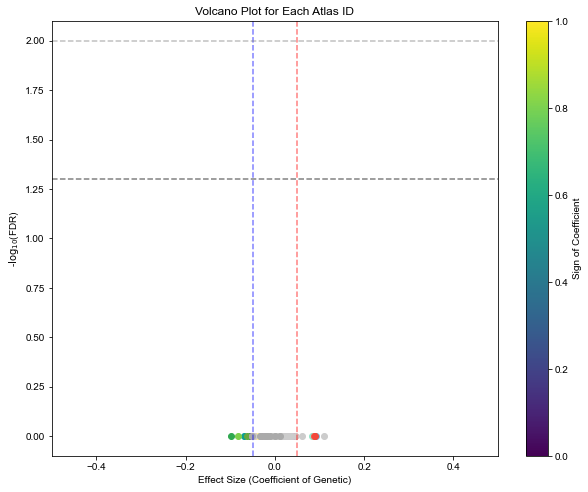

In [541]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    #try:
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # pdfClusterを実行
    r_code = '''
    library(MASS)
    model <- glm.nb('log_All_cell_count ~ Age', data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
    c(coef, p_value)
    '''
    #results_ <- summary(model)
    #results_ <- summary(model)
    #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
    #coef <- summary(model)$Coefficients["Genetic", "coef"]
    ro.r(r_code)

    results = ro.r(r_code)

    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    #except:
    #    coef, p_value = 0.0, 1.0
    #    print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4.csv" #"/Regional_cellome4_WM_mask_ver1_volume_revised.csv"

            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Others_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = healthy_data['Others_cell_count'] / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1


def normalize_and_calculate_difference(data):
    # atlasIDごとにループ
    for atlas_id in data['atlasID'].unique():
        # 各年齢、各ジェネティックタイプに対して正規化を実行
        for age in data['Age'].unique():
            avg_ctr = data[(data['atlasID'] == atlas_id) & (data['Genetic'] == 0) & (data['Age'] == age)]['NeuN+ density (/mm3)'].mean()
            
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0)]['NeuN+ density (/mm3)'] - avg_ctr 
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1)]['NeuN+ density (/mm3)'] - avg_ctr
        #mini = data.loc[(data['atlasID'] == atlas_id), 'Normalized'].min()
        #data.loc[(data['atlasID'] == atlas_id),'Normalized'] = data.loc[(data['atlasID'] == atlas_id),'Normalized'].copy() - mini
    return data

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000
    #data['log_All_cell_count'] = np.round(data['NeuN_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


0
0


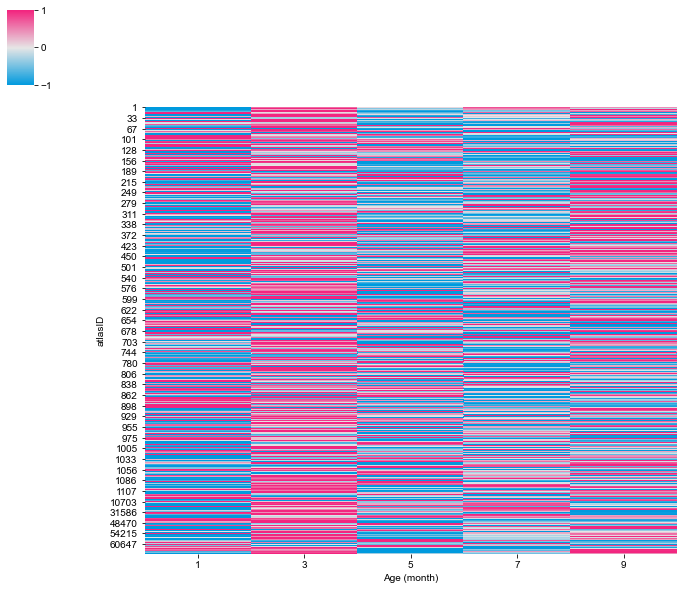

In [542]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
column_order = ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("WT_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# Move atlasID to the left side
clustergrid.ax_heatmap.yaxis.tick_left()  # Move y-axis labels to the left
clustergrid.ax_heatmap.yaxis.set_label_position("left")  # Set the y-axis label position to left

# PDFとして図を保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_Microglia_gradient_heatmap.pdf', 
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [616]:
# CSVファイルとして保存
data_pivot.to_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Others_ratio_all.csv', index=True)

Start time: 2024-10-02 20:54:10.280181
0      0.523025
1      0.892202
2      0.974692
3      0.985002
4      0.966485
         ...   
666    0.695650
667    0.845262
668    0.976640
669    0.823903
670    0.433864
Name: dpt_pseudotime, Length: 671, dtype: float32


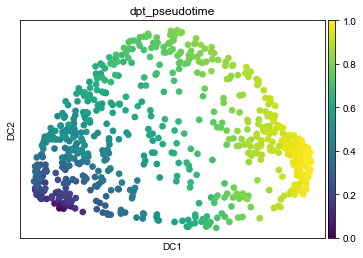

End time after X: 2024-10-02 20:54:10.838699
Duration for UMAP: 0:00:00.558518


In [629]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Others_ratio_all.csv', index_col='atlasID')

# 欠損値を各列の平均値で埋める
data_pivot = X#.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = data_pivot.apply(zscore, axis=1).fillna(0)

# 各行がリストになっているので、それを展開して2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定
adata.uns['iroot'] = 46 #240 #597 #532 #634

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()


# 実行時間の計測
end_time1 = datetime.datetime.now()
print("End time after X:", end_time1)
print("Duration for UMAP:", end_time1 - start_time)


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


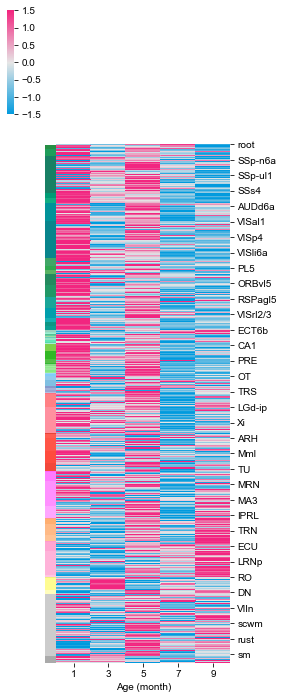

In [630]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df, cmap=cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


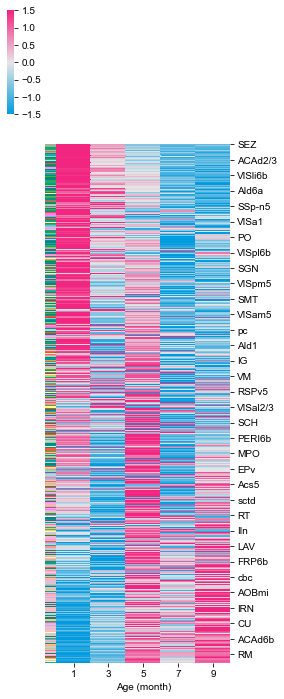

In [631]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


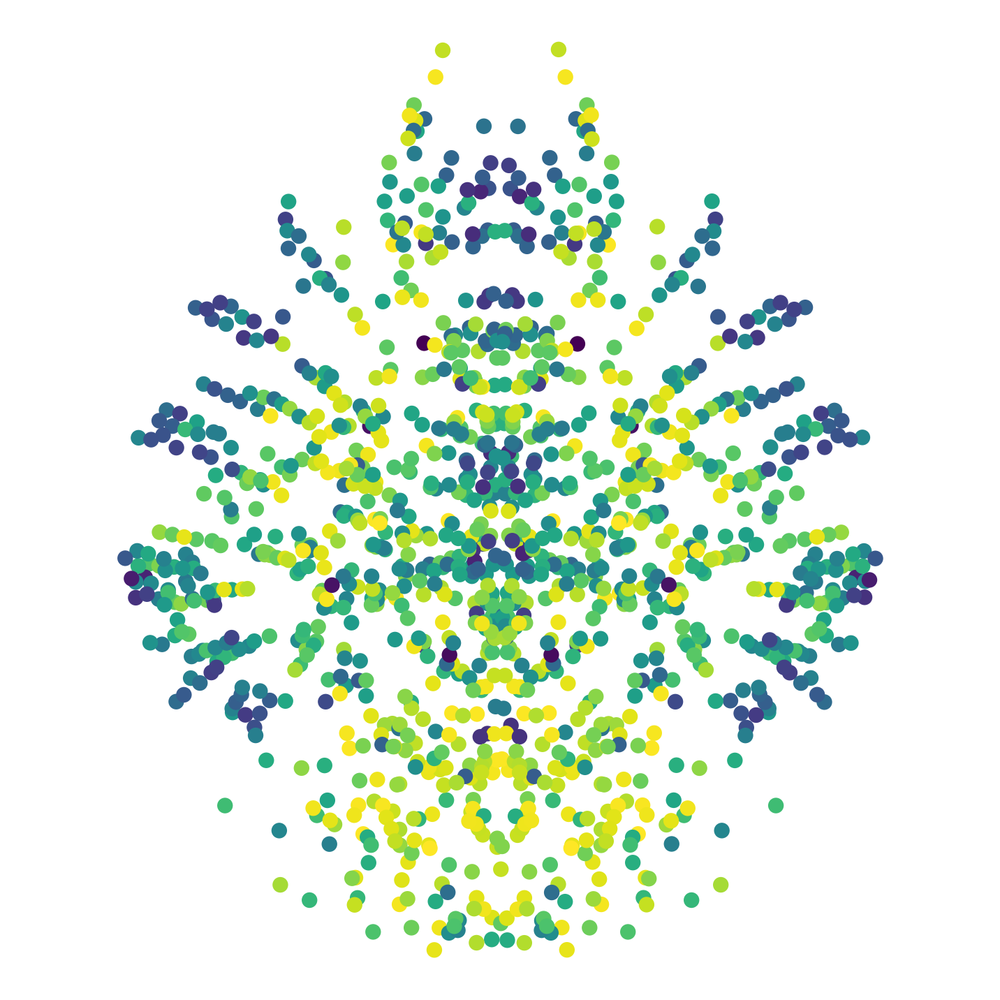

In [632]:
# atlasID が適切に設定されていることを確認する
# adata.obs に atlasID が含まれていることを前提にします
if 'atlasID' not in adata.obs.columns:
    adata.obs['atlasID'] = data_normalized.index

# pseudotime_df を adata.obs から作成し、インデックスを atlasID にする
pseudotime_df = pd.DataFrame(adata.obs[['atlasID', 'dpt_pseudotime']])

# pseudotime_df のインデックスを data_normalized のインデックス（atlasID）に基づいて設定
pseudotime_df = pseudotime_df.set_index('atlasID')

# data_normalized のインデックスに対応して pseudotime の値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['dpt_pseudotime'])

# pseudotime が NaN の場合は 0 で補完（必要に応じて）
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridis_rカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
#plt.title('Centroids of Left and Right Brain with Pseudotime Coloration')
#plt.xlabel('X (um)')
#plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.colorbar(sc, label='Pseudotime from Abeta PCA')  # カラーバーを追加
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Whole_brain_plot_of_Regional_Abeta_psedotime.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


Start time: 2024-10-02 20:54:41.841323
0       0.364826
1       0.743099
2       0.797090
3       0.846279
4       0.775502
          ...   
1337    0.494987
1338    0.947724
1339    0.726047
1340    0.444181
1341    0.731837
Name: dpt_pseudotime, Length: 1342, dtype: float32


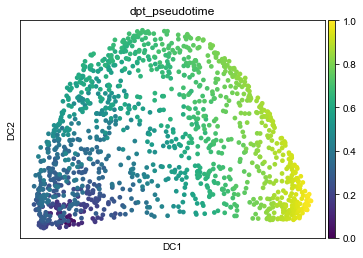

T-test p-value for pseudotime comparison: 8.77683314634453e-27
WT mean pseudotime: 0.5311030620034513
APP mean pseudotime: 0.6494158453650872


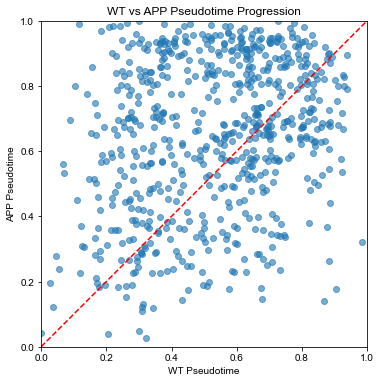

End time: 2024-10-02 20:54:43.015843
Total duration: 0:00:01.174520


In [634]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc
import matplotlib.pyplot as plt
from scipy.stats import ttest_rel

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Others_ratio_all.csv', index_col='atlasID')
X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Others_ratio_all.csv', index_col='atlasID')

# 列名を修正して、WTとAPPの違いをなくし、時間ベースで統一する
X.columns = ['1m', '3m', '5m', '7m', '9m']
X2.columns = ['1m', '3m', '5m', '7m', '9m']

# WTとAPPのデータを結合（行方向に）
combined_data = pd.concat([X, X2], axis=0, keys=['WT', 'APP'])

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = combined_data.apply(zscore, axis=1).fillna(0)

# 各行を2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定（適切なセルインデックスを設定）
adata.uns['iroot'] = 46 #240#597+671  # 適切なセルをルートとして設定

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# pseudotimeを取得
pseudotime = adata.obs['dpt_pseudotime'].values
# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()
# pseudotimeをcombined_dataに追加
combined_data['pseudotime'] = pseudotime

# WTとAPPの行インデックスを取得
wt_indices = combined_data.index.get_level_values(0) == 'WT'
app_indices = combined_data.index.get_level_values(0) == 'APP'

# WTとAPPに分割してpseudotimeを割り当てる
combined_data['WT_pseudotime'] = np.nan
combined_data['APP_pseudotime'] = np.nan
combined_data.loc[wt_indices, 'WT_pseudotime'] = combined_data.loc[wt_indices, 'pseudotime']
combined_data.loc[app_indices, 'APP_pseudotime'] = combined_data.loc[app_indices, 'pseudotime']

# WTとAPPの領域ごとのpseudotimeを比較する
# NaNを除外して比較
wt_pseudotime_clean = combined_data['WT_pseudotime'].dropna()
app_pseudotime_clean = combined_data['APP_pseudotime'].dropna()

# Wilcoxon signed-rank test to compare pseudotime progression
stat, p_val = ttest_rel(wt_pseudotime_clean, app_pseudotime_clean)
print(f'T-test p-value for pseudotime comparison: {p_val}')

# APPとWTのpseudotimeの平均値を計算
wt_mean = wt_pseudotime_clean.mean()
app_mean = app_pseudotime_clean.mean()
print(f'WT mean pseudotime: {wt_mean}')
print(f'APP mean pseudotime: {app_mean}')

# Scatter plot to visualize pseudotime progression
plt.figure(figsize=(8,6))
plt.scatter(wt_pseudotime_clean, app_pseudotime_clean, alpha=0.6)
plt.plot([0, 1], [0, 1], 'r--')  # 0-1の範囲でプロット
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('WT Pseudotime')
plt.ylabel('APP Pseudotime')
plt.title('WT vs APP Pseudotime Progression')
plt.gca().set_aspect('equal', adjustable='box')  # 等方的にプロット
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_comparison_scatter.pdf', dpi=300, bbox_inches='tight')
plt.show()

# 実行時間の計測
end_time = datetime.datetime.now()
print("End time:", end_time)
print("Total duration:", end_time - start_time)

               1m        3m        5m        7m        9m
atlasID                                                  
1        0.994250  0.028667  0.254061 -1.889641  0.612663
2       -1.405131  0.241771  1.577875  0.235208 -0.649724
6       -1.300805 -0.349187  1.487057 -0.611844  0.774779
7       -1.200071 -0.692554  0.498125 -0.267051  1.661551
9       -1.258990 -0.230463  1.144246 -0.825632  1.170839


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


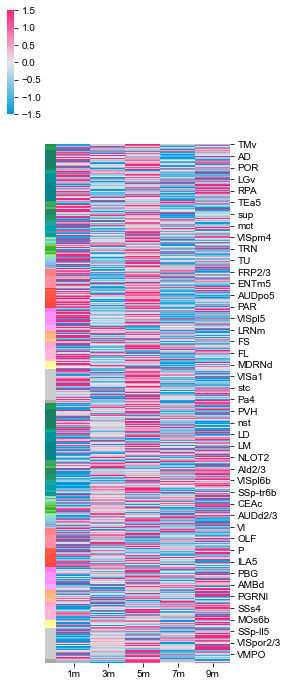

In [635]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Others_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Others_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0 (or handle them as needed)
combined_normalized = combined_normalized.fillna(0)

# Verify that combined_normalized is now a proper DataFrame with numeric values
print(combined_normalized.head())


sorted_index = data_GO['id'].drop_duplicates()

# Generate color list from data_GO
colorlist = [(row['R'] / 255, row['G'] / 255, row['B'] / 255) for idx, row in data_GO.iterrows()]

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap
g = sns.clustermap(
    combined_normalized,
    cmap=create_custom_cmap(),
    row_colors=colorlist * 2,  # Assuming you need to apply the same color list for both WT and APP
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')
# Adjust layout to ensure proper display
plt.tight_layout()

# Show the heatmap
plt.show()

               1m        3m        5m        7m        9m
atlasID                                                  
1        0.994250  0.028667  0.254061 -1.889641  0.612663
2       -1.405131  0.241771  1.577875  0.235208 -0.649724
6       -1.300805 -0.349187  1.487057 -0.611844  0.774779
7       -1.200071 -0.692554  0.498125 -0.267051  1.661551
9       -1.258990 -0.230463  1.144246 -0.825632  1.170839


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:66: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


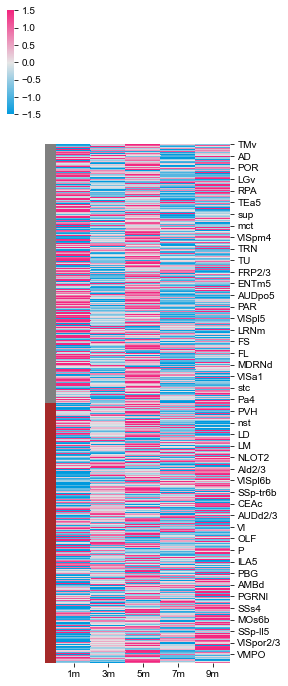

In [636]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Others_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Others_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0 (or handle them as needed)
combined_normalized = combined_normalized.fillna(0)

# Verify that combined_normalized is now a proper DataFrame with numeric values
print(combined_normalized.head())

# Create a color mapping for WT (gray) and APP (brown)
row_colors = ['gray'] * len(X_wt_normalized) + ['brown'] * len(X_app_normalized)

# Custom colormap for heatmap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap
g = sns.clustermap(
    combined_normalized,
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply WT (gray) and APP (brown) colors
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout to ensure proper display
plt.tight_layout()

# Show the heatmap
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


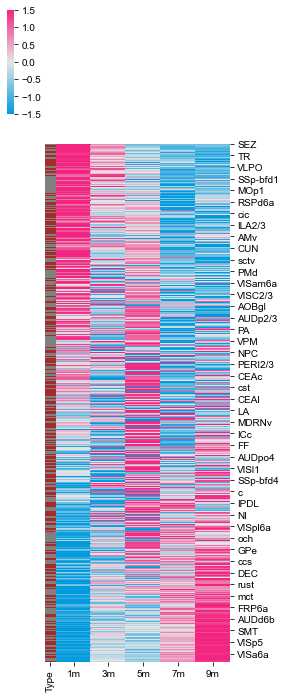

In [637]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Others_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Others_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)

# Generate WT/APP annotation colors based on the 'Type' column after sorting
row_colors = combined_normalized_sorted['Type'].map({'WT': 'gray', 'APP': 'brown'})

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply WT/APP color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


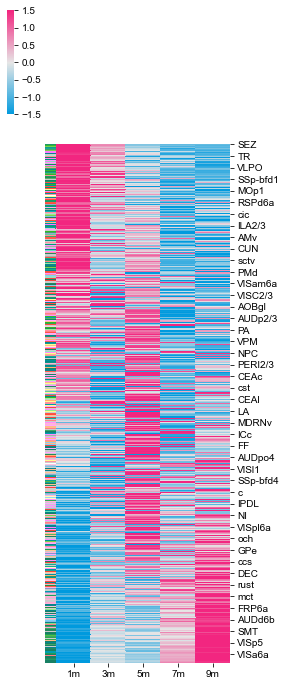

In [638]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Others_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Others_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data (assuming pseudotime calculation is already done)
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)



# Create a dictionary mapping atlasID (from combined_normalized_sorted) to colors from data_GO
id_to_color = {
    row['id']: (row['R'] / 255, row['G'] / 255, row['B'] / 255) 
    for idx, row in data_GO.iterrows()
}

# Generate the row_colors based on the region ID in the sorted data
row_colors = combined_normalized_sorted.index.map(lambda idx: id_to_color.get(idx, (0.5, 0.5, 0.5)))  # Default to gray if not found

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply region-based color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


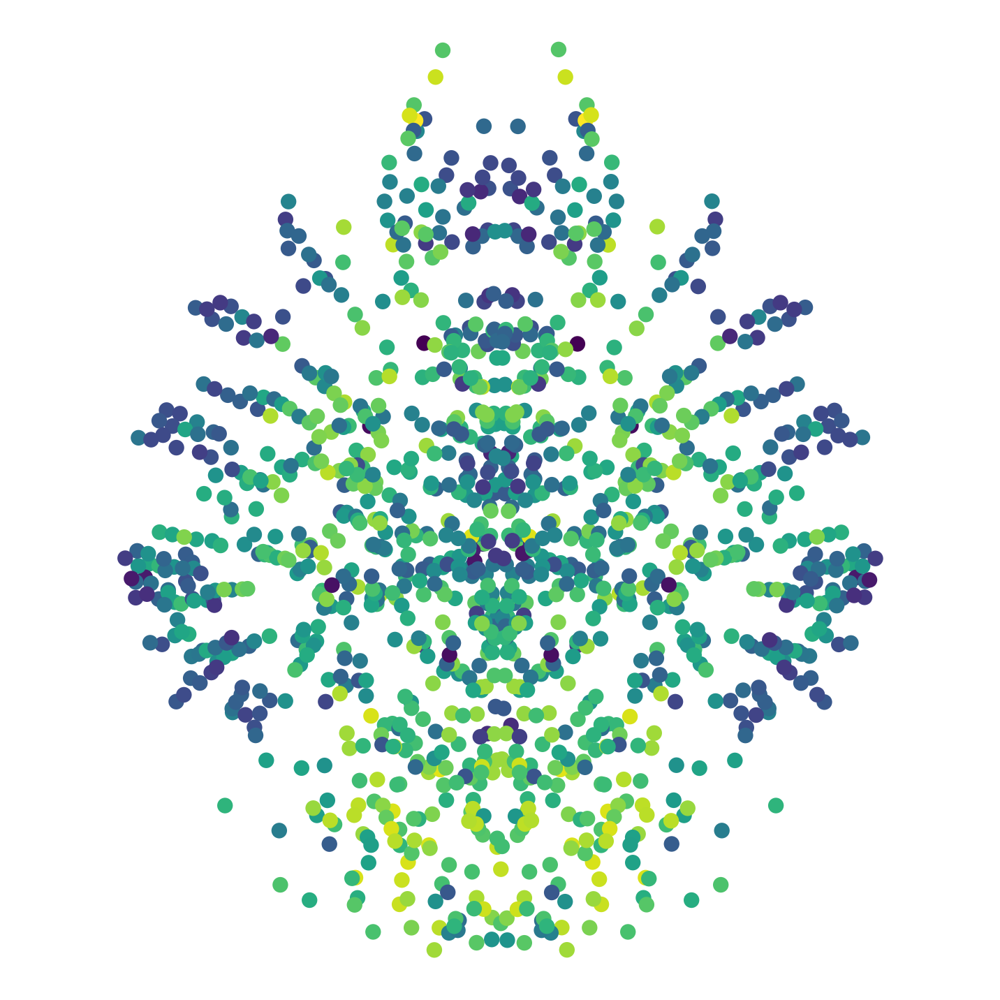

In [639]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# combined_normalizedからTypeがWTの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT']

# WTのpseudotimeを含むDataFrameを作成
pseudotime_df = pd.DataFrame(wt_data['pseudotime'])  # 'pseudotime'を使う
pseudotime_df['atlasID'] = wt_data.index.get_level_values('atlasID')  # 'atlasID'を取得
pseudotime_df.set_index('atlasID', inplace=True)  # インデックスをatlasIDに設定

# all_centroidsにおけるatlasIDに対応してpseudotimeの値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['pseudotime'])

# pseudotimeがNaNの場合は0で補完
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridisカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


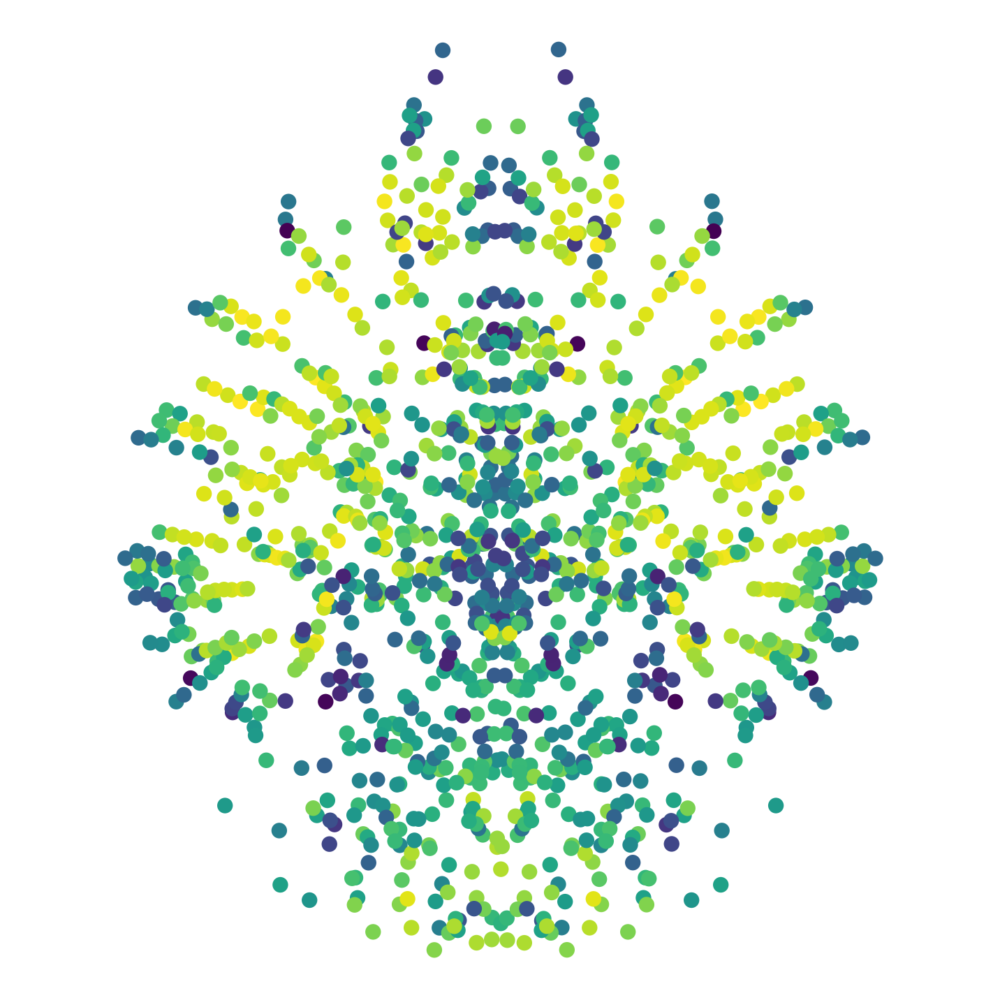

In [640]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# combined_normalizedからTypeがWTの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'APP']

# WTのpseudotimeを含むDataFrameを作成
pseudotime_df = pd.DataFrame(wt_data['pseudotime'])  # 'pseudotime'を使う
pseudotime_df['atlasID'] = wt_data.index.get_level_values('atlasID')  # 'atlasID'を取得
pseudotime_df.set_index('atlasID', inplace=True)  # インデックスをatlasIDに設定

# all_centroidsにおけるatlasIDに対応してpseudotimeの値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['pseudotime'])

# pseudotimeがNaNの場合は0で補完
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridisカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


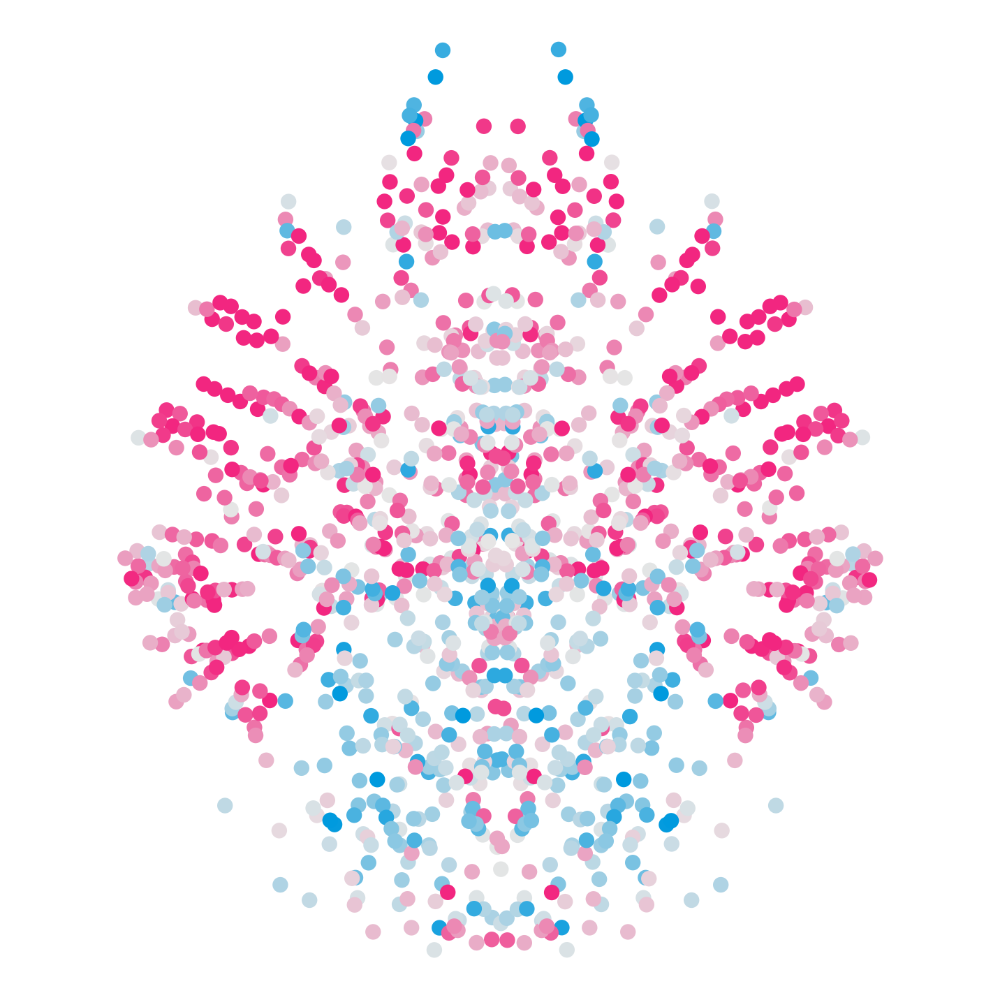

In [641]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

# combined_normalizedからTypeがWTとAPPの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT'] 
app_data = combined_normalized[combined_normalized['Type'] == 'APP'] 

# WTとAPPのpseudotimeを含むDataFrameを作成
pseudotime_wt = pd.DataFrame(wt_data['pseudotime'])
pseudotime_wt['atlasID'] = wt_data.index.get_level_values('atlasID')
pseudotime_wt.set_index('atlasID', inplace=True)

pseudotime_app = pd.DataFrame(app_data['pseudotime'])
pseudotime_app['atlasID'] = app_data.index.get_level_values('atlasID')
pseudotime_app.set_index('atlasID', inplace=True)

# 差分を計算してall_centroidsにマッピング
all_centroids['pseudotime_diff'] = all_centroids['atlasID'].map(pseudotime_app['pseudotime']) - all_centroids['atlasID'].map(pseudotime_wt['pseudotime'])

# 差分がNaNの場合は0で補完
all_centroids['pseudotime_diff'] = all_centroids['pseudotime_diff'].fillna(0)

# カスタムカラーマップを作成
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# カラーマップの生成
custom_cmap = create_custom_cmap()

# 色の範囲を設定
vmin = -0.5#all_centroids['pseudotime_diff'].min()  # 最小値を設定
vmax = 0.5 #all_centroids['pseudotime_diff'].max()  # 最大値を設定

# 差分に基づいて色を生成
norm = plt.Normalize(vmin=vmin, vmax=vmax)
all_centroids['colors'] = all_centroids['pseudotime_diff'].apply(lambda x: custom_cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

# カラーバーを追加
#cbar = plt.colorbar(sc, cmap=custom_cmap)  # カスタムカラーマップを使用
cbar.set_label('Pseudotime Difference (APP - WT)')  # カラーバーのラベルを設定
cbar.set_ticks([vmin, 0, vmax])  # カラーバーの目盛りを設定
cbar.ax.invert_yaxis()  # カラーバーのY軸を反転

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


100


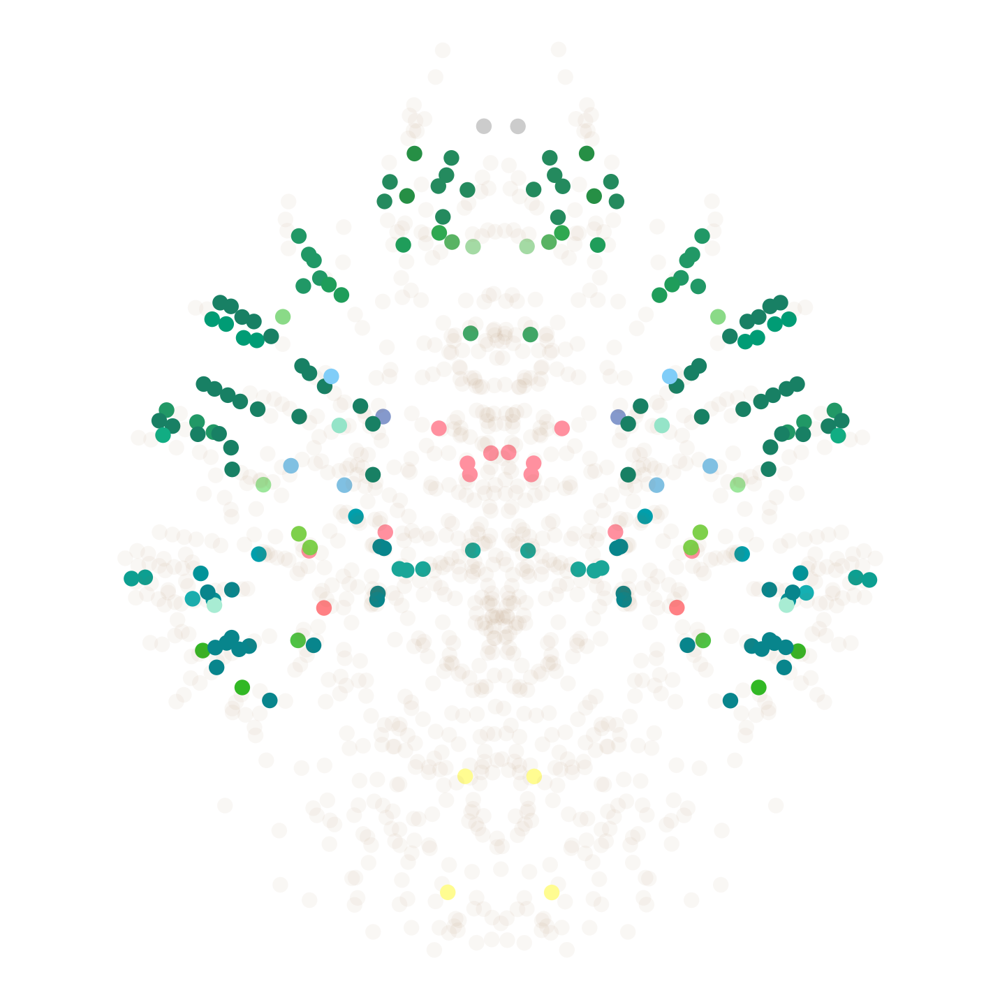

In [642]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

# combined_normalizedからTypeがWTとAPPの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT'] 
app_data = combined_normalized[combined_normalized['Type'] == 'APP'] 

# WTとAPPのpseudotimeを含むDataFrameを作成
pseudotime_wt = pd.DataFrame(wt_data['pseudotime'])
pseudotime_wt['atlasID'] = wt_data.index.get_level_values('atlasID')
pseudotime_wt.set_index('atlasID', inplace=True)

pseudotime_app = pd.DataFrame(app_data['pseudotime'])
pseudotime_app['atlasID'] = app_data.index.get_level_values('atlasID')
pseudotime_app.set_index('atlasID', inplace=True)

# 差分を計算してall_centroidsにマッピング
all_centroids['pseudotime_diff'] = all_centroids['atlasID'].map(pseudotime_app['pseudotime']) - all_centroids['atlasID'].map(pseudotime_wt['pseudotime'])

# 差分がNaNの場合は0で補完
all_centroids['pseudotime_diff'] = all_centroids['pseudotime_diff'].fillna(0)

# 上位100のregionを選択
top_100 = all_centroids.nlargest(200, 'pseudotime_diff')
print(len(np.unique(top_100["atlasID"])))

def get_color(row, data_GO, top_100_ids):
    atlas_id = row['atlasID']
    if atlas_id in top_100_ids:
        color_row = data_GO[data_GO['id'] == atlas_id]
        if not color_row.empty:
            return [
                color_row['R'].values[0] / 255,
                color_row['G'].values[0] / 255,
                color_row['B'].values[0] / 255,
                1.0  # 完全不透明
            ]
    return [0.6, 0.4, 0.2, 0.05]  # default color with low alpha if no match found or not in top_100

# top_100のatlasIDをセットとして取得
top_100_ids = set(top_100['atlasID'])

# Apply colors to all rows based on atlasID, only modifying those in top_100
all_centroids['colors'] = all_centroids.apply(lambda row: get_color(row, data_GO, top_100_ids), axis=1)


# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=np.vstack(all_centroids['colors']), edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


In [ ]:
# Neuronも一応やっておくか。

#4_APPmodel_APP1m_1_2022_1102_1304
#4_APPmodel_APP1m_2_2022_1106_1708
#4_APPmodel_APP1m_3_2022_1213_2151
#4_APPmodel_APP1m_4_2023_0417_2052
#5_APPmodel_APP3m_2_2023_0123_1645
#5_APPmodel_APP3m_3_2023_0212_2217
#5_APPmodel_APP3m_4_2023_0214_2027
#4_APPmodel_APP3m_5_2023_0502_1423
#4_APPmodel_APP5m_1_2022_1024_1336
#4_APPmodel_APP5m_2_2022_1027_1333
#4_APPmodel_APP5m_3_2022_1030_1257
#4_APPmodel_APP5m_4_2023_0509_1021
#5_APPmodel_APP7m_2_2023_0315_1540
#5_APPmodel_APP7m_3_2023_0310_1401
#5_APPmodel_APP7m_4_2023_0317_1630
#5_APPmodel_APP7m_5_2023_0520_1723
#5_APPmodel_APP9m_1_2023_0117_1352
#5_APPmodel_APP9m_2_2023_0327_1425
#5_APPmodel_APP9m_3_2023_0329_1611
#5_APPmodel_APP9m_4_2023_0403_1443
997
Coefficient: -0.01655431734473434, p-value: 0.7104831408850008
68
Coefficient: -0.047636892161095616, p-value: 0.8829214621552479
667
Coefficient: 0.002538799348795581, p-value: 0.9862293945285031
52192


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005879100701206799, p-value: 0.9663192977944866
52196
Coefficient: -0.01721452758135849, p-value: 0.9333016570028376
52264
Coefficient: 0.00041837688212812736, p-value: 0.9998570322106535
320
Coefficient: 0.00814465724577889, p-value: 0.9276036175519089
943
Coefficient: -0.001562500806698515, p-value: 0.9614166407006803
648
Coefficient: -0.0058214905430424395, p-value: 0.884390085545012
844


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004000980453203781, p-value: 0.9092804644486999
882
Coefficient: -0.02063359362054714, p-value: 0.9113916059780833
656
Coefficient: -0.005398640621931404, p-value: 0.9324224103284215
962
Coefficient: -0.006521697233460945, p-value: 0.8456538120519927
767
Coefficient: -0.006580904553178432, p-value: 0.850288318102072
1021
Coefficient: -0.0048427499282582935, p-value: 0.9022969382558147
1085


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/p

Coefficient: -0.0037498735267574228, p-value: 0.9877446530244571
558
Coefficient: 0.005357182703819846, p-value: 0.9628305535531394
838
Coefficient: 0.0011429145007347292, p-value: 0.9879798968760277
654
Coefficient: 0.004596846296227789, p-value: 0.9439329873224044
702
Coefficient: -0.015090738468266468, p-value: 0.8819669593498938
889
Coefficient: 0.0018522110860199007, p-value: 0.9774124728688409
929


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0029691905548706056, p-value: 0.9925698475080695
981
Coefficient: -0.0013111697836303059, p-value: 0.9852419456618339
201
Coefficient: 0.003930396212613323, p-value: 0.9251767097031811
1047
Coefficient: 0.0064437865996709665, p-value: 0.8848086119021983
1070
Coefficient: -0.008083203206132811, p-value: 0.8910344995454293
1038
Coefficient: 0.0032220011873913186, p-value: 0.9473136664650799
1062


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02831997649799311, p-value: 0.9203624960066313
1030
Coefficient: 0.006292730926256285, p-value: 0.9682841907814008
113
Coefficient: 0.0030182097818052347, p-value: 0.9645124756099865
1094
Coefficient: 0.005990589086741771, p-value: 0.9496401924329795
1128
Coefficient: -0.00701054968407308, p-value: 0.9343818878141956
478


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/p

Coefficient: 0.0034147748612670162, p-value: 0.9646196787817244
510
Coefficient: -0.03347108480805185, p-value: 0.9500294235968796
878
Coefficient: 0.0036845855993993012, p-value: 0.9655993110769099
657
Coefficient: 0.004855435984521404, p-value: 0.9216275280373155
950
Coefficient: 0.008159316486805863, p-value: 0.8704657530833823
974
Coefficient: -0.010564375930551723, p-value: 0.8692717616256859
1102


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00016014915859573648, p-value: 0.9971708005723927
2
Coefficient: 0.0006978911949658381, p-value: 0.9970923839658196
450
Coefficient: 0.0016667811492107343, p-value: 0.988119463348256
854
Coefficient: 0.0025229220221120265, p-value: 0.9655518408683874
577
Coefficient: 0.004854376784204304, p-value: 0.9439346117636765
625
Coefficient: -0.011211436250245932, p-value: 0.8864812672769176
945


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.002709180333335721, p-value: 0.9634734406717611
1026
Coefficient: -0.028737284312113545, p-value: 0.9250174132003061
1006
Coefficient: -0.0024189316232229403, p-value: 0.9853937656028683
670
Coefficient: 0.007421535855955796, p-value: 0.9207541679077752
1086
Coefficient: 0.0026970280206935664, p-value: 0.9858924034520459
1111
Coefficient: -0.0019102673887394677, p-value: 0.9854183280296488
9


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0054765821902997575, p-value: 0.9615345399128289
461
Coefficient: -0.016149810855921883, p-value: 0.9704282497417921
18693
Coefficient: -0.0010322771730883076, p-value: 0.995197427138092
18697
Coefficient: 0.008408495931505616, p-value: 0.9337170058335903
18701
Coefficient: 0.013957668333658399, p-value: 0.9097322265128233
18705
Coefficient: -0.005678798179786996, p-value: 0.96850529012624
18709


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.005859563995717971, p-value: 0.9555296550505804
18713
Coefficient: -0.004460504475441396, p-value: 0.9933445072860921
873
Coefficient: 0.0046374091295084685, p-value: 0.9432619948158524
806
Coefficient: 0.004512230887672171, p-value: 0.9116375410104653
1035
Coefficient: 0.004641359661934151, p-value: 0.9348111027533159
1090


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.008810613845801141, p-value: 0.8600161032036338
862
Coefficient: -0.0032292599390038217, p-value: 0.9406272744037862
893
Coefficient: -0.010458569214882073, p-value: 0.9509023516887259
36
Coefficient: 0.004631530319790014, p-value: 0.9837716574334644
180
Coefficient: -0.0011305746290431393, p-value: 0.9907962586394504
148
Coefficient: 0.0010684771403096519, p-value: 0.9950529799612052
187


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.012200619012138553, p-value: 0.9002513311004982
638
Coefficient: -0.014773515775928147, p-value: 0.8693766570724984
662
Coefficient: -0.01209821052319447, p-value: 0.9684524792915825
897
Coefficient: 0.01106535277686566, p-value: 0.9443341120866878
1106
Coefficient: -0.0014990029882515788, p-value: 0.98578684850776
1010
Coefficient: -0.00048203489857986953, p-value: 0.9976519419655424
1058


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014359226417004815, p-value: 0.8746100175065423
857
Coefficient: -0.017602041153239413, p-value: 0.8538340502141364
849
Coefficient: -0.015456834562121269, p-value: 0.9621848290766917
527
Coefficient: 0.005382874173719372, p-value: 0.9717915760862231
600
Coefficient: 0.011167759222260824, p-value: 0.9040786950821543
678
Coefficient: 0.01772914684555426, p-value: 0.9016832897431503
252
Coefficient: 0.001757805199640977, p-value: 0.986888637916428
156


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0045945188077053225, p-value: 0.9725837335496557
243
Coefficient: -0.010406040378239747, p-value: 0.9836392395650667
735
Coefficient: 0.0032848405021041346, p-value: 0.9743119437736579
251
Coefficient: 0.00951144581007497, p-value: 0.903755587686174
816
Coefficient: 0.006500149573647426, p-value: 0.9535574520083892
847
Coefficient: -0.010494259365780124, p-value: 0.8945221864494635
954
Coefficient: 0.0005606423026158817, p-value: 0.9959031013792896
1005
Coefficient: -0.008168558228378415, p-value: 0.9820671916232852
696


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011000444465557632, p-value: 0.9562850491211929
643
Coefficient: 0.007332154122503002, p-value: 0.9574737995508322
759
Coefficient: 0.005485345329060202, p-value: 0.978337415709442
791
Coefficient: -0.0029507485047748686, p-value: 0.9843918258255082
249
Coefficient: 0.0030259180029095943, p-value: 0.9871617565467987
456
Coefficient: 7.71208160945444e-05, p-value: 0.9998797344002212
959
Coefficient: -0.006036817044266698, p-value: 0.9658681477994846
755
Coefficient: -0.010245735983771183, p-value: 0.9119570766961177
990


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01836429361045244, p-value: 0.8898548016157516
1023
Coefficient: -0.022143914978453083, p-value: 0.7966768394083843
520
Coefficient: -0.007442192315252558, p-value: 0.9502665345535407
598
Coefficient: -0.022254055924988005, p-value: 0.9556164176532093
1074
Coefficient: -0.01677699601990513, p-value: 0.9320265677507469
905
Coefficient: 0.01128520495900064, p-value: 0.9244286521131125
1114
Coefficient: 0.011270176394224623, p-value: 0.9476802334324146
233
Coefficient: -0.004797322367596296, p-value: 0.9731890685922658
601


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0060432297374708975, p-value: 0.969663756305025
649
Coefficient: 0.0009724504397259629, p-value: 0.9983338817297515
281
Coefficient: 0.00708718751544187, p-value: 0.9704022970828003
1066
Coefficient: 0.009599115786419657, p-value: 0.9245186841519099
401
Coefficient: 0.017576644195589942, p-value: 0.9219207341531385
433
Coefficient: -0.007215705857721618, p-value: 0.95218331986696
1046
Coefficient: -0.0036899492461347928, p-value: 0.9775847169187788
441
Coefficient: -0.006127055470461801, p-value: 0.9862478475263307
421


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013180356027734519, p-value: 0.9365670469543751
973
Coefficient: -0.0026241690633122196, p-value: 0.9788273170867001
573
Coefficient: -0.00241030865712262, p-value: 0.984962016836886
613
Coefficient: -0.02169018516843558, p-value: 0.843207212385002
74
Coefficient: -0.006351344402271069, p-value: 0.9545226283842739
121
Coefficient: -0.005755713832548933, p-value: 0.985766998723035
593
Coefficient: -0.010415526830107885, p-value: 0.8508461153231227
821
Coefficient: 0.0018364831934609832, p-value: 0.9581696759116984
721


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004611087331196879, p-value: 0.9237976308198695
778
Coefficient: -0.012009688727050317, p-value: 0.7971070172174718
33
Coefficient: -0.0017922401979145162, p-value: 0.9701396714033298
305
Coefficient: -0.006516773505035903, p-value: 0.9656008351765847
750
Coefficient: -0.038379616217113624, p-value: 0.8132173790188341
269
Coefficient: -0.028790837747105228, p-value: 0.837749006811359
869
Coefficient: -0.02442961848036012, p-value: 0.9463055318331398
902
Coefficient: -0.016912335075704422, p-value: 0.9084871763916259
377


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00031602497826407975, p-value: 0.9985401314150637
393
Coefficient: 0.007956796446650571, p-value: 0.9900801617250462
805
Coefficient: 0.008941549045240851, p-value: 0.9562061032074888
41
Coefficient: 0.0034229003075498727, p-value: 0.9686593191503557
501
Coefficient: 0.005920760328138218, p-value: 0.9661418040680079
565
Coefficient: -0.012928771094507144, p-value: 0.9060798500387248
257
Coefficient: -0.0033889492709161264, p-value: 0.9787782202425775
469
Coefficient: -0.005953056049778614, p-value: 0.9857837674923086
31578


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011539337842961416, p-value: 0.9671483358696676
31582
Coefficient: 0.00037917509070266325, p-value: 0.9980102254491815
31586
Coefficient: -0.00046109574364645335, p-value: 0.9983426563571959
31590
Coefficient: -0.01739501793126036, p-value: 0.9129495302113614
31594
Coefficient: -0.007624249609978936, p-value: 0.9659608577593246
31598
Coefficient: -0.005331697843671867, p-value: 0.9911870411442268
31632
Coefficient: -0.005132716678023232, p-value: 0.971152514194788
31636
Coefficient: -0.008833024644350682, p-value: 0.9266572184938874
31640


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02285470644741034, p-value: 0.9272164251581839
31644
Coefficient: -0.01659204106233875, p-value: 0.8866686091855582
31648
Coefficient: -0.003028023008298314, p-value: 0.9809761711872672
31652
Coefficient: -0.005623166829993449, p-value: 0.988104299627584
935
Coefficient: -0.00039865807946065965, p-value: 0.9980718672922689
211
Coefficient: -0.009532321874086931, p-value: 0.8920324380218441
1015
Coefficient: -0.01116024680601552, p-value: 0.8431257832568032
919
Coefficient: -0.007680472726967146, p-value: 0.9066627497803597
927


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010785815023351016, p-value: 0.9794860557729824
588
Coefficient: -0.00479270013328701, p-value: 0.979706489931673
296
Coefficient: -0.008604127440582001, p-value: 0.911196047427384
772
Coefficient: -0.010865334212410522, p-value: 0.8483855080253211
810
Coefficient: -0.011631279768063437, p-value: 0.8935956049767486
819
Coefficient: -0.039296087790515306, p-value: 0.889386466222732
171
Coefficient: -0.023352930160401655, p-value: 0.8906816261885357
304
Coefficient: -0.01826334134222759, p-value: 0.8387586438120943
363


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.021498028534807916, p-value: 0.7608835433762797
84
Coefficient: -0.00802571391623062, p-value: 0.9248779566525182
132
Coefficient: -0.01686999036134667, p-value: 0.9689938567540765
707
Coefficient: -0.00044604397457589164, p-value: 0.9990067997296271
556
Coefficient: -0.02156214137990389, p-value: 0.916665625428558
827
Coefficient: -0.026422187772705535, p-value: 0.7889472479572557
1054
Coefficient: -0.018093085030999184, p-value: 0.8801952690203206
1081
Coefficient: -0.030202720123441523, p-value: 0.9652252869955719
448


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.018473036462182606, p-value: 0.9423390663924397
412
Coefficient: 0.006408944436642098, p-value: 0.9423339984352619
630
Coefficient: -0.006134503464549205, p-value: 0.9267700520233805
440
Coefficient: -0.011928701444985883, p-value: 0.8977075219166335
488
Coefficient: -0.006246115161783648, p-value: 0.984453822237574
484
Coefficient: 0.006179766486479619, p-value: 0.9833951149154442
582
Coefficient: -0.005905387446484261, p-value: 0.960774059124888
620
Coefficient: -0.017428695369411343, p-value: 0.8495380832926172
910


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014537913719617278, p-value: 0.9178898977577461
52977
Coefficient: -0.017575814275584342, p-value: 0.9884546581641254
969
Coefficient: 0.024641009887980292, p-value: 0.9093167887494383
288
Coefficient: 0.0033063239537142034, p-value: 0.9670495893577428
1125
Coefficient: -0.011188881467369922, p-value: 0.8892676210887144
608
Coefficient: -0.010497240291858287, p-value: 0.9279421163644657
680
Coefficient: -0.007178095011738257, p-value: 0.9909684420489986
996
Coefficient: -0.01800885545431864, p-value: 0.9309515700262533
328


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004525626143002014, p-value: 0.9580040403292032
1101
Coefficient: -0.013594033559749202, p-value: 0.8440076735859823
783
Coefficient: -0.016367068209565048, p-value: 0.8231471167682327
831
Coefficient: -0.014653694066540485, p-value: 0.9617485411113548
120
Coefficient: 0.008543657383968166, p-value: 0.9638667225075989
163
Coefficient: -0.004995560510082885, p-value: 0.9506967934962112
344
Coefficient: -0.009781632271387373, p-value: 0.923511933991956
314
Coefficient: -0.016301180276187547, p-value: 0.8677667366259454
355


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014065659580709143, p-value: 0.9768576961726885
704
Coefficient: -0.043367415322311365, p-value: 0.8751796430579951
694
Coefficient: -0.007011684184820759, p-value: 0.9527953936302795
800
Coefficient: -0.013031031789524633, p-value: 0.8952302838199474
675
Coefficient: -0.007815957096621983, p-value: 0.9601315729434725
699
Coefficient: -0.002415829958461262, p-value: 0.9983125834130346
671
Coefficient: 0.009467462580107232, p-value: 0.9219804335698937
965
Coefficient: 0.009508063018999804, p-value: 0.8631270416700823
774


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00046657506166939555, p-value: 0.9941323272842957
906
Coefficient: -0.0032506103984564464, p-value: 0.9684388161322568
279
Coefficient: 0.0025281461661873675, p-value: 0.9940640388074257
442
Coefficient: 0.007170520303448884, p-value: 0.9112854742072032
434
Coefficient: 0.01442712270058289, p-value: 0.7516950835153189
610
Coefficient: -0.0056141871028139445, p-value: 0.9140785158381632
274
Coefficient: -0.008915055598740042, p-value: 0.8869473584005997
330
Coefficient: -0.0015938512684418717, p-value: 0.9969713061684229
542


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.003462742827737695, p-value: 0.9462345844087484
430
Coefficient: -0.005533066504007843, p-value: 0.8796520669108113
687
Coefficient: -0.011632488756588268, p-value: 0.795711842750728
590
Coefficient: -0.014194886982660363, p-value: 0.8411492169069472
622
Coefficient: -0.014104416579379709, p-value: 0.9725452653519658
31550
Coefficient: -0.007871232345735855, p-value: 0.9505209306573545
31554
Coefficient: 0.006526414734990624, p-value: 0.9310628322495743
31558
Coefficient: 0.008565967260203493, p-value: 0.9521080058605312
31562


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00490827071935524, p-value: 0.9628530943160308
31566
Coefficient: 0.003834209193815819, p-value: 0.9722550543693963
31570
Coefficient: 0.00022051790095655176, p-value: 0.9994203182364921
31604
Coefficient: -0.006164420015544151, p-value: 0.9656270217362366
31608
Coefficient: 0.013132566253604198, p-value: 0.8883170168868468
31612
Coefficient: 0.0054198834666125085, p-value: 0.9734237441419916
31616
Coefficient: -0.0006688995052790089, p-value: 0.9957888985666312
31620
Coefficient: 0.009931393477096572, p-value: 0.9405331751444601
31624


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00957100756478228, p-value: 0.9819698643987756
97
Coefficient: -0.021757472155987386, p-value: 0.8533017715839346
1127
Coefficient: -0.011883376042920099, p-value: 0.861159244863851
234
Coefficient: -0.022913604962763175, p-value: 0.8432834278282251
289
Coefficient: -0.026688977051504907, p-value: 0.6950637517655627
729
Coefficient: -0.006238920029812326, p-value: 0.9388260547346882
786
Coefficient: -0.005422373875197842, p-value: 0.9828067539021366
540
Coefficient: -0.017471916292563273, p-value: 0.9341629892531872
888


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014833313847553795, p-value: 0.9107324661089823
692
Coefficient: -0.011126508906331017, p-value: 0.9615667062794201
335
Coefficient: -0.013927658979538201, p-value: 0.9625050968913154
368
Coefficient: -0.015983883245038598, p-value: 0.9805393017671366
836
Coefficient: -0.02052067646574086, p-value: 0.9139375812450068
427
Coefficient: -0.013390434112505695, p-value: 0.8902681710793489
988
Coefficient: -0.018254503876395274, p-value: 0.8594445332377425
977
Coefficient: -0.008486743040901986, p-value: 0.9348434377835677
1045


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010871802995413252, p-value: 0.9743738223434075
698
Coefficient: -0.022876546414797926, p-value: 0.38518091991080566
507
Coefficient: 0.01810989698443014, p-value: 0.06661302837729823
188
Coefficient: -0.05180199843794937, p-value: 0.8173356849464217
196
Coefficient: -0.018641092531860096, p-value: 0.7702108750382468
204
Coefficient: -0.012266476204373853, p-value: 0.9051273279417881
159
Coefficient: -0.005919812735994315, p-value: 0.8361324638045193
597
Coefficient: -0.007540758820740567, p-value: 0.9316224394253418
605


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006390098124845481, p-value: 0.9482885856887866
814
Coefficient: -0.008275160236593384, p-value: 0.9314576129465545
961
Coefficient: -1.2341253437723e-06, p-value: 0.9999522410209783
260
Coefficient: -0.01857289086477154, p-value: 0.958224611550771
268
Coefficient: -0.010084012851229111, p-value: 0.948697735715111
1139
Coefficient: -0.013365412815652487, p-value: 0.9594517408971456
639
Coefficient: -0.008044969474731246, p-value: 0.9127437321419268
655
Coefficient: -0.0066356660364051984, p-value: 0.9185770924285045
663


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0009064605646808192, p-value: 0.9854038685308405
788
Coefficient: -0.0011102753341908367, p-value: 0.9884548645752417
566
Coefficient: -0.0032905878927837564, p-value: 0.9594050286991125
1089
Coefficient: -0.010383381334567234, p-value: 0.9214592517801989
382
Coefficient: 0.0004289203696308516, p-value: 0.984911205377125
423
Coefficient: -0.0067385039108674005, p-value: 0.9607029333916947
463
Coefficient: -0.0024249718809095716, p-value: 0.9342113261457922
10703
Coefficient: -0.005843980226242195, p-value: 0.9019248970334114
10704


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004319372786152168, p-value: 0.9264930345763284
632
Coefficient: 0.0035480649382754583, p-value: 0.8674675582287127
982
Coefficient: -0.03662027709947738, p-value: 0.8839436409383966
19
Coefficient: -0.011053189584312608, p-value: 0.9622311065332712
1121
Coefficient: -0.012112466740789364, p-value: 0.912642167691635
20
Coefficient: 0.002469438189844405, p-value: 0.9659006459956708
52
Coefficient: 0.003470911540995506, p-value: 0.9603927901803755
139
Coefficient: -0.0049052096897464125, p-value: 0.947518598323521
28


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0012404366805635334, p-value: 0.9838711261200819
526
Coefficient: -0.05457501355697222, p-value: 0.5557585792454622
543
Coefficient: -0.02757364872392481, p-value: 0.6943719404811737
664
Coefficient: -0.01642160558431778, p-value: 0.8156280739940324
727
Coefficient: -0.007380896480622167, p-value: 0.9161478870571174
743
Coefficient: 5.167369151307377e-05, p-value: 0.9993864815552833
843
Coefficient: -0.017087521722730797, p-value: 0.8116090460947089
1037
Coefficient: -0.0029281711182927517, p-value: 0.9509885115829981
1084


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004184637670089045, p-value: 0.9361517329473383
502
Coefficient: -0.00860730447757723, p-value: 0.8326159542736475
48470
Coefficient: -0.001871070170733053, p-value: 0.9758898895566476
58447
Coefficient: -0.011199018032130137, p-value: 0.8858833211083488
48508
Coefficient: -0.014550253844764762, p-value: 0.8808135868766209
703
Coefficient: -0.006572783199742815, p-value: 0.9551165853142431
583
Coefficient: -0.016903212712221092, p-value: 0.8307695729819224
952
Coefficient: -0.003861824930964016, p-value: 0.9383770976380137
966


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010253487266027627, p-value: 0.9138457247383407
131
Coefficient: -0.003059097749310046, p-value: 0.9608749233706905
303
Coefficient: -0.014316066160182966, p-value: 0.863310491564669
311
Coefficient: -0.014190234898812656, p-value: 0.870320714045305
451
Coefficient: -0.0077240632008722205, p-value: 0.9591923194109058
327
Coefficient: -0.005173697801482227, p-value: 0.9357578313896333
334
Coefficient: -0.009722753312628516, p-value: 0.9008635741478378
780
Coefficient: -0.012895554096284387, p-value: 0.8040529053206729
477


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00898200608270673, p-value: 0.8276946814146263
672
Coefficient: -0.0036271444583358503, p-value: 0.75512235282636
56
Coefficient: -0.0006593033975788789, p-value: 0.976247932333574
998
Coefficient: -0.006983413863368605, p-value: 0.9404548613994486
754
Coefficient: -0.00699138953324238, p-value: 0.794456879888939
250
Coefficient: -0.012834340991957812, p-value: 0.8908876098305849
258
Coefficient: -0.011367343646779219, p-value: 0.8132628972544111
266
Coefficient: -0.00916789060712499, p-value: 0.9027990073190232
310


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.025095947649343663, p-value: 0.8492876396481401
333
Coefficient: -0.009363120059232382, p-value: 0.9749387572724016
23
Coefficient: -0.017453195083922336, p-value: 0.8671670716118904
292
Coefficient: -0.047938534974898396, p-value: 0.9354623097983209
544
Coefficient: -0.007245081585776391, p-value: 0.9484310268456648
551
Coefficient: -0.005999149335990826, p-value: 0.9585658560245135
559
Coefficient: -0.00552805443756307, p-value: 0.9420596712042657
1105
Coefficient: -0.0038061171559035842, p-value: 0.9687380905462454
403


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007983212338079877, p-value: 0.8468244452948491
803
Coefficient: -0.01518195261879753, p-value: 0.8538860364538732
1022
Coefficient: -0.01658823167567029, p-value: 0.8634593194086679
1031
Coefficient: -0.016833359822826847, p-value: 0.9325320037294931
342
Coefficient: -0.006569299394613405, p-value: 0.8804129988256335
298
Coefficient: -0.020172153490609974, p-value: 0.863521249319078
564
Coefficient: -0.009504101521231713, p-value: 0.9428800367968257
596
Coefficient: -0.006650045570803721, p-value: 0.9404076420896965
581


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.035838311305751984, p-value: 0.8399283202492945
351
Coefficient: -0.009231741364352534, p-value: 0.8612595575568053
287
Coefficient: -0.023841307927112008, p-value: 0.9832805762745123
549
Coefficient: -0.021883725164025997, p-value: 0.7912664100902703
629
Coefficient: -0.017124988948569238, p-value: 0.8593894103871167
685
Coefficient: -0.00937546069903332, p-value: 0.919087842793984
718
Coefficient: -0.011944029332306465, p-value: 0.9045138421872895
725
Coefficient: -0.03142163522585486, p-value: 0.9149397336783702
733


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010010053171783311, p-value: 0.8742234779164728
741
Coefficient: -0.0410869831408399, p-value: 0.7965934382933958
56435
Coefficient: -0.034213680141012115, p-value: 0.8182910698267548
414
Coefficient: -0.014059265427229517, p-value: 0.9516857110134306
422
Coefficient: -0.015653355698310847, p-value: 0.9348425360865368
609
Coefficient: -0.005720083703699125, p-value: 0.9774618458250551
1044
Coefficient: -0.015194275609689806, p-value: 0.953056615365067
1072
Coefficient: -0.0500960291558543, p-value: 0.7569550137147808
1079


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.04967049757600049, p-value: 0.7054645448993507
1088
Coefficient: -0.0412803818842511, p-value: 0.8000783182021818
49664
Coefficient: -0.04012423087894575, p-value: 0.8156283800723729
49668
Coefficient: -0.030622845555446733, p-value: 0.8037689220530846
49672
Coefficient: -0.03105641732675744, p-value: 0.8886170058422048
218
Coefficient: -0.04287337445084575, p-value: 0.5859095845267561
1020
Coefficient: -0.03597832827126487, p-value: 0.6460149806091269
1029
Coefficient: -0.020587364677433703, p-value: 0.9010697834430762
325


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.04736820038993306, p-value: 0.7730512978524618
56551
Coefficient: -0.04450425187753116, p-value: 0.8031897918862424
255
Coefficient: -0.03038949547731787, p-value: 0.7573709478364223
1096
Coefficient: -0.02168062806635169, p-value: 0.8794018304634721
1104
Coefficient: -0.009012993236570531, p-value: 0.9566046492029178
64
Coefficient: -0.012802265377397166, p-value: 0.9426420153068906
1120
Coefficient: -0.03658057661648113, p-value: 0.9103886684839579
1113
Coefficient: -0.017665242206001543, p-value: 0.9188347800521086
155


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.022090340918256967, p-value: 0.8014132527379545
59
Coefficient: -0.01922070476936286, p-value: 0.8996378150582203
362
Coefficient: -0.015114561648244743, p-value: 0.800976289178105
366
Coefficient: -0.02028870260580289, p-value: 0.8773756847110806
1077
Coefficient: -0.005438015597819152, p-value: 0.9752565392555608
149
Coefficient: -0.009805393378001634, p-value: 0.911228329163652
15
Coefficient: -0.008861249496495588, p-value: 0.9500139040283089
181
Coefficient: -0.009706292751786638, p-value: 0.9232331261400343
56559


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.007901229711539443, p-value: 0.9714149796309799
189
Coefficient: -0.058093252456175734, p-value: 0.7817985429845987
599
Coefficient: -0.028229203160612386, p-value: 0.8264887426986068
907
Coefficient: -0.02558018673874716, p-value: 0.868661006372377
575
Coefficient: -0.023444641693436564, p-value: 0.8453344793502546
930
Coefficient: -0.0024858321131992996, p-value: 0.9799714051525693
56563
Coefficient: -0.018629491400732685, p-value: 0.9032224647893221
262
Coefficient: -0.031554997470745055, p-value: 0.6430534529652236
27


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01902386609735484, p-value: 0.9417276640175297
56439
Coefficient: -0.021621583527577554, p-value: 0.9639099866935829
178
Coefficient: -0.01204695874360539, p-value: 0.9122930597402817
321
Coefficient: -0.03271403312033329, p-value: 0.9342949920162679
483
Coefficient: -0.01900226278967545, p-value: 0.8373517478128194
186
Coefficient: -0.02322232793865668, p-value: 0.8362024300348543
1097
Coefficient: -0.009509247391619811, p-value: 0.8193609094521572
390
Coefficient: -0.010883330123794395, p-value: 0.9763675463166412
332


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0071449336776758625, p-value: 0.9911413638371847
38
Coefficient: -0.013919154848033213, p-value: 0.9224399157618502
30
Coefficient: -0.011528409500438555, p-value: 0.9648051688871673
118
Coefficient: -0.039867754706665384, p-value: 0.8360981094803276
223
Coefficient: -0.02674746130914492, p-value: 0.8156474788671859
72
Coefficient: -0.01310622839836229, p-value: 0.9484323580215145
263
Coefficient: -0.005048183309670459, p-value: 0.9820497403354849
272
Coefficient: -0.010748852533231636, p-value: 0.9429293019608992
830


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.029505651226528103, p-value: 0.743519659926722
452
Coefficient: -0.009138913813880468, p-value: 0.9758633072822881
523
Coefficient: -0.003518695618246926, p-value: 0.9668821315300223
763
Coefficient: 0.022319268117973235, p-value: 0.9726035928363169
914
Coefficient: -0.012107753407133739, p-value: 0.9762331303026265
1109
Coefficient: -0.02540783978037805, p-value: 0.8965461594706654
126
Coefficient: -0.032887224413590356, p-value: 0.8418197658039773
133
Coefficient: -0.011169772385985429, p-value: 0.9473981347625985
347


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0022488017522244194, p-value: 0.9890171775933487
286
Coefficient: -0.010647404521672005, p-value: 0.9633877328706253
338
Coefficient: -0.08772901066949161, p-value: 0.9209783647437724
57699
Coefficient: -0.011682606091141802, p-value: 0.9645891011849151
689
Coefficient: -0.01708917542411674, p-value: 0.9486928352416077
88
Coefficient: -0.0014047130718681656, p-value: 0.9832669261197312
210
Coefficient: -0.03178497563465418, p-value: 0.8827409561490002
732
Coefficient: -0.0030918641361747765, p-value: 0.9863897339203933
60647


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013955640636830913, p-value: 0.8975554091281074
60651
Coefficient: -0.008876261273455498, p-value: 0.9462041292160185
60655
Coefficient: -0.047550115331590655, p-value: 0.8795069398470936
60659
Coefficient: -0.023563504447343335, p-value: 0.9167725396001067
525
Coefficient: -0.01566981573261864, p-value: 0.9111235304382612
1126
Coefficient: -0.036539128478427135, p-value: 0.9012038533340452
1
Coefficient: -0.003601632964324547, p-value: 0.98437960527093
515
Coefficient: -0.0026978641427155866, p-value: 0.975634131802635
980


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00788246432051489, p-value: 0.9593511752168201
1004
Coefficient: -0.015060141674686221, p-value: 0.8984204522568782
63
Coefficient: -0.007957453057470571, p-value: 0.9648395511755012
693
Coefficient: 0.0008500598874863251, p-value: 0.9914427363741543
946
Coefficient: -0.006050778744137332, p-value: 0.936611143164428
194
Coefficient: -0.011971987495660573, p-value: 0.8247145716863267
226
Coefficient: -0.01097504746591177, p-value: 0.9113627966591569
356
Coefficient: -0.01636263297983839, p-value: 0.9778627016263813
364


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.001588923055284256, p-value: 0.9917724417550263
57704
Coefficient: -0.011754340135447742, p-value: 0.9386862111684431
173
Coefficient: -0.015433258923290021, p-value: 0.9477347485662995
470
Coefficient: -0.00039759756677856166, p-value: 0.9977142862469477
614
Coefficient: -0.00874117565425289, p-value: 0.9313326322102129
797
Coefficient: -0.014906530786917312, p-value: 0.8070033206405685
804
Coefficient: -0.011155911538272605, p-value: 0.9584764651264642
10671
Coefficient: -0.06056295635922007, p-value: 0.8605432443431276
313


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.016958008025111448, p-value: 0.5937261728982128
851
Coefficient: -0.020814701241086996, p-value: 0.7321428815101259
842
Coefficient: -0.026235082925308503, p-value: 0.6303910193687761
834
Coefficient: -0.016169781594806507, p-value: 0.9023636387372858
811
Coefficient: -0.0061447588707306934, p-value: 0.9024130900556532
820
Coefficient: -0.015552695744635978, p-value: 0.7396831833366222
828
Coefficient: -0.023045165980240163, p-value: 0.6355255100577886
580
Coefficient: -0.025793551774248163, p-value: 0.9318735362226604
271


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03887311672695706, p-value: 0.8898324226133787
874
Coefficient: -0.0724430825629474, p-value: 0.8709995177316447
460
Coefficient: -0.020589309435691, p-value: 0.9794315388672801
59923
Coefficient: -0.018649950616115227, p-value: 0.98201187079635
381
Coefficient: -0.012940460569371712, p-value: 0.8962899694920803
749
Coefficient: -0.013835571670573515, p-value: 0.9209174650237971
60830
Coefficient: -0.027122207270973354, p-value: 0.9577784229684273
246


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004905491685098422, p-value: 0.9843827792750284
128
Coefficient: -0.010898689901583679, p-value: 0.7909749316890825
26
Coefficient: -0.015458300365330718, p-value: 0.7977788542916047
42
Coefficient: -0.016565598915323637, p-value: 0.8822150729095166
17
Coefficient: -0.018014976577504647, p-value: 0.6802000494933285
10
Coefficient: -0.021897913805319944, p-value: 0.5822919539092555
795
Coefficient: -0.012132487954086146, p-value: 0.717753533536035
50
Coefficient: -0.004437145330738552, p-value: 0.977635680673952
67


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009585873672496626, p-value: 0.9753942419121052
587
Coefficient: -0.02276901995307093, p-value: 0.924272072497937
61277
Coefficient: -0.021847517185154583, p-value: 0.9489296424199125
215
Coefficient: -0.011374594762422507, p-value: 0.8566407106341221
531
Coefficient: -0.029091173159647755, p-value: 0.9222705683801541
628
Coefficient: -0.015523943790518132, p-value: 0.9350940762367465
634
Coefficient: -0.015907652181534972, p-value: 0.8998347360107664
706
Coefficient: -0.024104896376201397, p-value: 0.9298957239933799
1061


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.019186293089158975, p-value: 0.9018039780646725
54203
Coefficient: -0.011929764877300953, p-value: 0.9708437470760061
616
Coefficient: -0.015867399926282808, p-value: 0.8807254730429591
214
Coefficient: 0.01268012090003571, p-value: 0.9149265244582637
35
Coefficient: -0.01098030886324677, p-value: 0.9810610922406158
54211
Coefficient: 0.010164849711865166, p-value: 0.9847770939632325
975
Coefficient: -0.01757603150322073, p-value: 0.9688009127754849
115
Coefficient: -0.017017931168333205, p-value: 0.9860881158576346
60663


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.016039559913848322, p-value: 0.9836358714628952
757
Coefficient: -0.018117850917295123, p-value: 0.9660012920251173
231
Coefficient: -0.013718640874555987, p-value: 0.9744679293442016
66
Coefficient: -0.0306890757274878, p-value: 0.9497510367709052
75
Coefficient: -0.028143209229451155, p-value: 0.9785298442746135
58
Coefficient: -0.01693815885756191, p-value: 0.9652506835432623
374
Coefficient: -0.018522006452461475, p-value: 0.9281050645532725
1052
Coefficient: -0.009234972650403869, p-value: 0.9259121169585495
12


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009594934827606958, p-value: 0.968929967420151
100
Coefficient: -0.015458711542881861, p-value: 0.9860985120751543
60834
Coefficient: -0.04716451893483542, p-value: 0.8314630005039981
60838
Coefficient: -0.014225799051327126, p-value: 0.9660362530488623
60842
Coefficient: -0.024221944173155503, p-value: 0.9550659131077238
60846
Coefficient: -0.017537892151329552, p-value: 0.9552615471113645
60850
Coefficient: -0.0359783564696645, p-value: 0.9437531700893881
60854
Coefficient: -0.06161930976989354, p-value: 0.8937473224418638
60858


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.04057675612073086, p-value: 0.9187486191140817
60862
Coefficient: -0.033811033564705606, p-value: 0.9527732429660292
197
Coefficient: -0.029104049640000827, p-value: 0.9312170539993854
591
Coefficient: -0.011812469714986715, p-value: 0.9665582624046521
872
Coefficient: 0.0028644399492020606, p-value: 0.9864434427218175
771
Coefficient: -0.02509465977256502, p-value: 0.6365550965678899
612
Coefficient: -0.020475729285616542, p-value: 0.8694204339836147
7
Coefficient: -0.0032330834843032285, p-value: 0.9650747041406021
867


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.014549069143949718, p-value: 0.8388875508597872
123
Coefficient: -0.0069354078468898805, p-value: 0.9713956163106416
122
Coefficient: -0.034795236277050716, p-value: 0.8738479583598208
105
Coefficient: -0.03396167930326646, p-value: 0.9245426720596158
114
Coefficient: -0.002193016067988686, p-value: 0.9920115085735154
280
Coefficient: 0.012685624108241257, p-value: 0.9828022557267405
880
Coefficient: -0.015414964388111938, p-value: 0.9435518462412302
59927
Coefficient: -0.002506790676040906, p-value: 0.9931405980149706
898


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.012315956952178148, p-value: 0.9030255528562241
931
Coefficient: -0.06351031716340554, p-value: 0.4078254838081448
1093
Coefficient: -0.005847562774854974, p-value: 0.94366629492871
318
Coefficient: 0.004656600395913008, p-value: 0.9928126913734441
534
Coefficient: -0.016293257124651284, p-value: 0.9383379285213698
574
Coefficient: 0.0010346192497971817, p-value: 0.9927463530450977
621
Coefficient: -0.014814400159007734, p-value: 0.9560575346473893
54215
Coefficient: -0.012408899920634238, p-value: 0.969872839728215
54219


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.017945582483537514, p-value: 0.9895801618689555
54223
Coefficient: -0.012679800678251724, p-value: 0.9739722030714659
54227
Coefficient: -0.00867537663394367, p-value: 0.9866541380328079
679
Coefficient: -0.012644206855051273, p-value: 0.8982289987843544
147
Coefficient: 0.015920127519826462, p-value: 0.9796736706581035
162
Coefficient: -0.012301045305632873, p-value: 0.9290501222469281
604
Coefficient: -0.00541638712856654, p-value: 0.9795063695351248
146
Coefficient: -0.0032033647008190497, p-value: 0.9639826387204159
238


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0005693085790878548, p-value: 0.9983948838752226
350
Coefficient: -0.008114553501275915, p-value: 0.9886173589065196
358
Coefficient: 0.004270336193973199, p-value: 0.9903782326631965
354
Coefficient: 0.020342672135030777, p-value: 0.6527597484639037
207
Coefficient: 0.021029635795976952, p-value: 0.9334776885697782
96
Coefficient: -0.002261096044299576, p-value: 0.9751290769956436
101
Coefficient: -0.007214324265683391, p-value: 0.9332934418182265
711
Coefficient: -0.009954592792206368, p-value: 0.9385363276290088
1039


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.04028947847898875, p-value: 0.8771290749316781
903
Coefficient: -0.002852574154235417, p-value: 0.9891079774617514
642
Coefficient: -0.007193450509007093, p-value: 0.9816621228385841
651
Coefficient: 0.0013500835457677558, p-value: 0.9834410666703034
429
Coefficient: -0.0025402358516810352, p-value: 0.9628163016387348
437
Coefficient: -0.004662556675279059, p-value: 0.9359842199931957
445
Coefficient: -0.005879955696178321, p-value: 0.9557296337258807
58451
Coefficient: 0.012048210501402475, p-value: 0.9668572121441341
653


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.000470982747229378, p-value: 0.9994115129044258
661
Coefficient: -0.03333299819529305, p-value: 0.8614729967348451
576
Coefficient: -0.02237998717498855, p-value: 0.9918107439807072
939
Coefficient: -0.014411291148994072, p-value: 0.9824846825348041
143
Coefficient: 0.004975454539987652, p-value: 0.9931752685148911
839
Coefficient: 0.015153438869319497, p-value: 0.9266343201310259
1048
Coefficient: 0.010002039250065263, p-value: 0.9024478887881839
372
Coefficient: -0.041500978229776116, p-value: 0.9398469108331095
83


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.02227739822734053, p-value: 0.8862186062701026
136
Coefficient: 0.009676425436889296, p-value: 0.8757144106699586
106
Coefficient: -0.006151752250710418, p-value: 0.9941644062460889
203
Coefficient: 0.017664703025378183, p-value: 0.9609602890086375
955
Coefficient: 0.026683614433071497, p-value: 0.8158736785059024
963
Coefficient: -0.01168059475531581, p-value: 0.9779500391076005
307
Coefficient: 0.004219540898406863, p-value: 0.9798798047691921
1098
Coefficient: 0.013320133018553245, p-value: 0.8617956093450332
1107


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.04521988242421187, p-value: 0.6485085249687949
852
Coefficient: -0.0011935403266869775, p-value: 0.9841586275785534
859
Coefficient: -0.02029226645882453, p-value: 0.9484302584107959
970
Coefficient: 0.008749743392481406, p-value: 0.9662945218831887
978
Coefficient: -0.01068102785189977, p-value: 0.9307486413432434
177
Coefficient: 0.016806736921288114, p-value: 0.9732859454053205
169
Coefficient: 0.011541847286610724, p-value: 0.9467336229697529
1069
Coefficient: -0.017165728170319788, p-value: 0.9637347710069175
209


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.016990771911277583, p-value: 0.964578664327189
202
Coefficient: 0.0004939528701890219, p-value: 0.9951880619094252
225
Coefficient: -0.01467633401899347, p-value: 0.9235541267554999
217
Coefficient: -0.0338460974239734, p-value: 0.8869700037570438
765
Coefficient: -0.011570649599643294, p-value: 0.9777506438284691
773
Coefficient: 0.029387068628162694, p-value: 0.8928454654434412
781
Coefficient: -0.012681161529461542, p-value: 0.9876726745564721
206
Coefficient: -0.011095037438029783, p-value: 0.9721087670658043
230


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.022023535625108268, p-value: 0.9504396100868723
222
Coefficient: 0.03129711881876741, p-value: 0.9449587445944057
512
Coefficient: -0.02713739754830029, p-value: 0.7656169186333364
912
Coefficient: 0.01843208223987473, p-value: 0.8438499018242328
976
Coefficient: 0.02834451296769783, p-value: 0.304184554724655
984
Coefficient: 0.01505669587775891, p-value: 0.419032572031758
1091
Coefficient: 0.007951049414061028, p-value: 0.49996842890947507
936
Coefficient: 0.0005516212893586759, p-value: 0.9761850007047791
944


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.008855598484437295, p-value: 0.7520236885786857
951
Coefficient: 0.004462786966420048, p-value: 0.8651738499310474
957
Coefficient: 0.0018450956297802218, p-value: 0.9221893682007324
968
Coefficient: 0.009806684133664232, p-value: 0.7113378760666509
1007
Coefficient: 0.012478934143234614, p-value: 0.3267252897368824
1056
Coefficient: 0.008965119610887896, p-value: 0.48860539097760586
1064
Coefficient: 0.00579583892144019, p-value: 0.6926919654532326
1025
Coefficient: 0.0052088385155084705, p-value: 0.7094234641346604
1033


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.005248727826951463, p-value: 0.7751167040895275
1041
Coefficient: -0.000704570247613187, p-value: 0.9566062205417113
1049
Coefficient: 0.0021472366333737465, p-value: 0.9379990686459846
989
Coefficient: -0.025299890991721107, p-value: 0.8759938301358837
91
Coefficient: -0.02915439340162431, p-value: 0.7983368790440911
846
Coefficient: -0.0330315984784331, p-value: 0.8599216910828728
58455
Coefficient: -0.03373165681115795, p-value: 0.938680038851682
1009
Coefficient: -0.023331453028027367, p-value: 0.7891402938465849
949


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.07662239973479648, p-value: 0.9702721009557488
1016
Coefficient: -0.011127871126376048, p-value: 0.8220511652787184
665
Coefficient: 0.004016452145677594, p-value: 0.9582943350857408
538
Coefficient: -0.006080668289642425, p-value: 0.9512724038247302
900
Coefficient: -0.005632229482552379, p-value: 0.9557276818531601
848
Coefficient: 0.1286325403482317, p-value: 0.8034428111836212
916
Coefficient: 0.002659108367042299, p-value: 0.9921133924860491
336
Coefficient: -0.021848602681456754, p-value: 0.9556560196647519
117


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.011636970477087406, p-value: 0.9451700268058505
125
Coefficient: -0.03220056072365648, p-value: 0.8684631515302564
832
Coefficient: -0.037190503804948497, p-value: 0.9777808564527469
62
Coefficient: 0.0034430084566478164, p-value: 0.9909525031847287
158
Coefficient: -0.01772459126490582, p-value: 0.9591691879925291
911
Coefficient: -0.051863998233130724, p-value: 0.9539850221616135
93
Coefficient: -0.1508286304226367, p-value: 0.793609031806723
229
Coefficient: -0.06158830015618853, p-value: 0.7888034026025835
794


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013426644228525223, p-value: 0.9026378838006147
798
Coefficient: 0.010299779094831676, p-value: 0.9878071648522296
1116
Coefficient: 0.009205426124509478, p-value: 0.9888427065626326
413
Coefficient: -0.026230389854074013, p-value: 0.9461006958211275
841
Coefficient: -0.026051014054818522, p-value: 0.917995129635546
506
Coefficient: 0.007886303187117362, p-value: 0.9958015589896866
658
Coefficient: -0.0277348814073493, p-value: 0.8022338892515779
633
Coefficient: -0.031186912913302948, p-value: 0.9431858767308314
482


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.06724725339479956, p-value: 0.7433923727218341
237
Coefficient: -0.006368630989606934, p-value: 0.9904790884361878
380
Coefficient: 0.06565914835678771, p-value: 0.9298315742115704
697
Coefficient: -0.007329839819622811, p-value: 0.959085562783862
744
Coefficient: -0.025554305957328046, p-value: 0.9599877646254591
326
Coefficient: -0.023439176762962314, p-value: 0.8753882033370076
812
Coefficient: -0.0014544350548557116, p-value: 0.9978535290553817
850
Coefficient: -0.05766139437745213, p-value: 0.910509317583723
866


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03291838892558808, p-value: 0.8794301877885995
78
Coefficient: -0.04547532365020593, p-value: 0.6012771151843033
1123
Coefficient: -0.0002648794449407823, p-value: 0.9983053369697953
553
Coefficient: 0.0028126032131854995, p-value: 0.9896961369968025
728
Coefficient: -0.0016822868711726816, p-value: 0.9141611283469817
48512
Coefficient: -0.023792786516194226, p-value: 0.8284872057936585
956
Coefficient: -0.01553418466722786, p-value: 0.897477868814476
579
Coefficient: -0.012660148924226582, p-value: 0.8803163166624682
964


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.008058542499366179, p-value: 0.9728309452236621
1108
Coefficient: -0.02680965421415759, p-value: 0.8719952145289581
971
Coefficient: -0.049616191182436035, p-value: 0.7059023746717441
48516
Coefficient: -0.038344179211212456, p-value: 0.689724670355907
986
Coefficient: -0.05813800013684667, p-value: 0.7788460056876723
784
Coefficient: -0.008011818589407195, p-value: 0.9895132653922762
6
Coefficient: -0.040385343036435616, p-value: 0.7583121854995938
924
Coefficient: -0.04531476681155893, p-value: 0.7449583728747402
190


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.017063417103286915, p-value: 0.9179167307556313
198
Coefficient: 0.1150010819336742, p-value: 0.8176964181158194
1092
Coefficient: -0.020780420511826683, p-value: 0.9306513306479166
48520
Coefficient: -0.027010997022204462, p-value: 0.7906137037646228
48524
Coefficient: -0.02237156557132916, p-value: 0.904544360403311
102
Coefficient: -0.014781816201434499, p-value: 0.9562619107115007
1051
Coefficient: -0.38516838879763426, p-value: 0.9924150092773192
1060
Coefficient: -0.02190348040866458, p-value: 0.9829899302789779
1043


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.008160121854759075, p-value: 0.9654576191532157
863
Coefficient: 0.004556189288604349, p-value: 0.9746950536174774
397
Coefficient: -0.017693056570892325, p-value: 0.9740056274701802
884
Coefficient: -0.0073456776434723805, p-value: 0.9663742230376001
908
Coefficient: 0.0020938897146843246, p-value: 0.9930954281353345
940
Coefficient: -0.01365499971312508, p-value: 0.8837920748224077
466
Coefficient: -0.0053441022481370256, p-value: 0.9603899405404888
530
Coefficient: -0.02491395291466208, p-value: 0.9791300952139325
603


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.04925554728635431, p-value: 0.6998277286375517
428
Coefficient: -0.010731895407452093, p-value: 0.9935180497089959
436
Coefficient: -0.021092837709005097, p-value: 0.9186497572657439
443
Coefficient: -0.04587123638488441, p-value: 0.8003921328730383
449
Coefficient: -0.04294349055106256, p-value: 0.9275920248392371
301
Coefficient: -0.0032267516427019072, p-value: 0.9875863631549344
48528
Coefficient: -0.0076052488775530565, p-value: 0.9842690052793389
54
Coefficient: -0.01571872668553575, p-value: 0.9696060465933001
349


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.041356639238411604, p-value: 0.9571618565894368
753
Coefficient: -0.006520844149729898, p-value: 0.9897819273775872
690
Coefficient: -0.010889459636078342, p-value: 0.9699811796605111
681
Coefficient: -0.012035057179348399, p-value: 0.9784645594552321
673
Coefficient: -0.024973026994814067, p-value: 0.9665024455343695
802
Coefficient: -0.039265073944206516, p-value: 0.8637740115045511
595
Coefficient: -0.010018860206876635, p-value: 0.9600217269948363
611
Coefficient: 0.026174801244911543, p-value: 0.9516311582530363
81


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03307835638401132, p-value: 0.7803898143458217
98
Coefficient: -0.053078167635700585, p-value: 0.9151811375563847
108
Coefficient: 0.02802842581631097, p-value: 0.7502613461207326
129
Coefficient: -0.03153876556344124, p-value: 0.8229574103667756
140
Coefficient: -0.021010056711992273, p-value: 0.9378655932000363
145
Coefficient: 0.0865676942969644, p-value: 0.46384322607336825
153
Coefficient: -0.030151691138976193, p-value: 0.7974508762921367
164
Coefficient: 0.06500900513110178, p-value: 0.9916624871486689


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

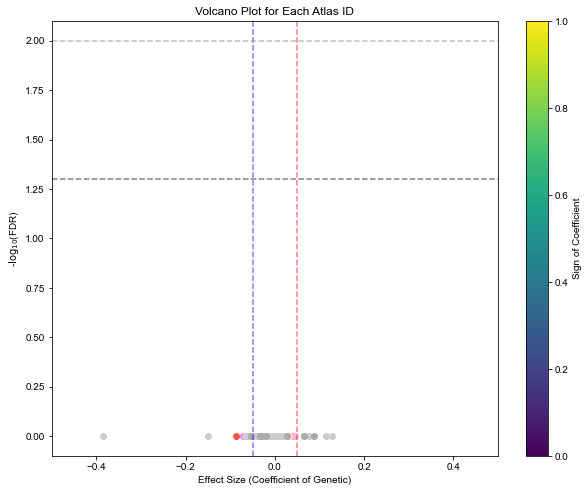

In [650]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
import rpy2.robjects as ro
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    #try:
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # pdfClusterを実行
    r_code = '''
    library(MASS)
    model <- glm.nb('log_All_cell_count ~ Age', data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
    c(coef, p_value)
    '''
    #results_ <- summary(model)
    #results_ <- summary(model)
    #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
    #coef <- summary(model)$Coefficients["Genetic", "coef"]
    ro.r(r_code)

    results = ro.r(r_code)

    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    #except:
    #    coef, p_value = 0.0, 1.0
    #    print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4.csv" #"/Regional_cellome4_WM_mask_ver1_volume_revised.csv"

            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
                
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    #data['log_All_cell_count'] = np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000 #np.round(data['Iba1_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


0
0


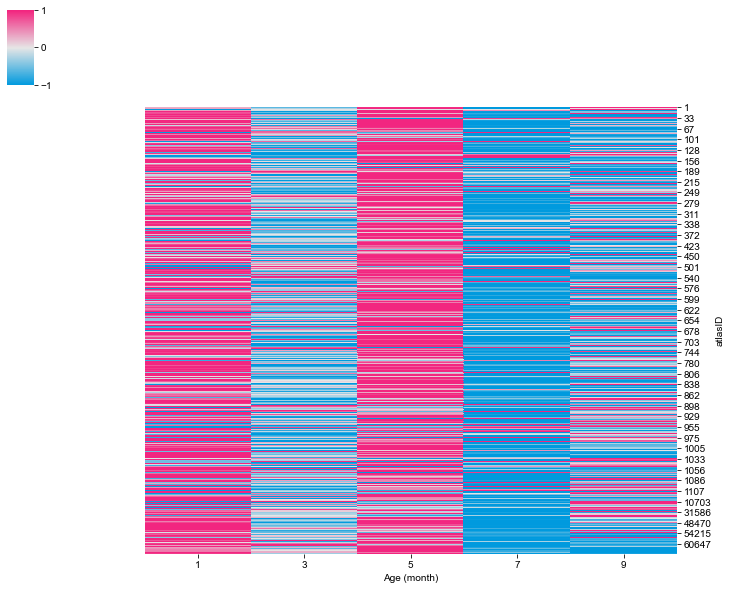

In [651]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json


# Prepare sample info
sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m" ] for s in conditions[c]]
column_order = ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m" ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("APP_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# PDFとして図を保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_Microglia_gradient_heatmap.pdf', 
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [652]:
# CSVファイルとして保存
data_pivot.to_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Neuron_ratio_all.csv', index=True)

Start time: 2024-10-02 21:04:03.677836
0      0.843294
1      0.710529
2      0.978887
3      0.855746
4      0.423083
         ...   
666    0.944971
667    0.944627
668    0.938308
669    0.990210
670    0.958401
Name: dpt_pseudotime, Length: 671, dtype: float32


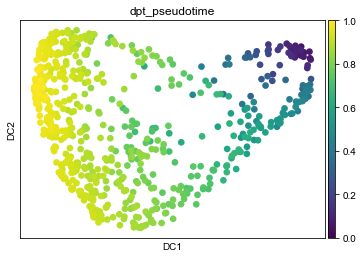

End time after X: 2024-10-02 21:04:04.229449
Duration for UMAP: 0:00:00.551613


In [653]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Neuron_ratio_all.csv', index_col='atlasID')

# 欠損値を各列の平均値で埋める
data_pivot = X#.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = data_pivot.apply(zscore, axis=1).fillna(0)

# 各行がリストになっているので、それを展開して2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定
adata.uns['iroot'] = 240#597 #532 #634

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()


# 実行時間の計測
end_time1 = datetime.datetime.now()
print("End time after X:", end_time1)
print("Duration for UMAP:", end_time1 - start_time)


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


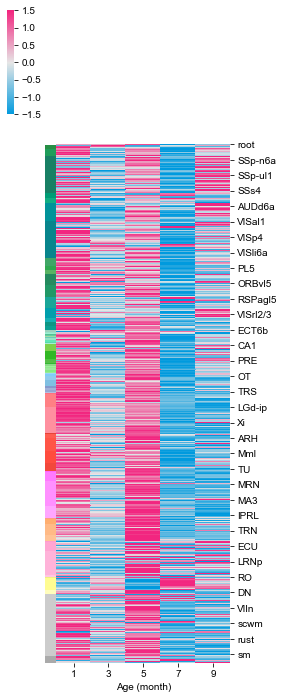

In [654]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df, cmap=cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


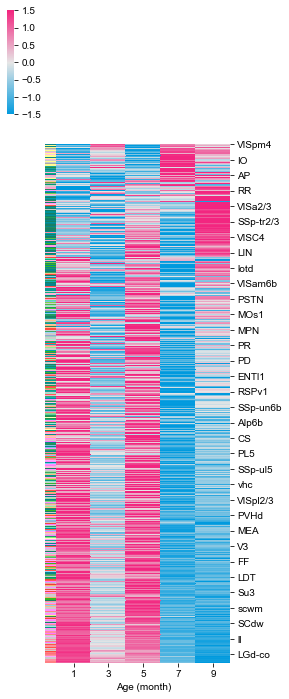

In [570]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


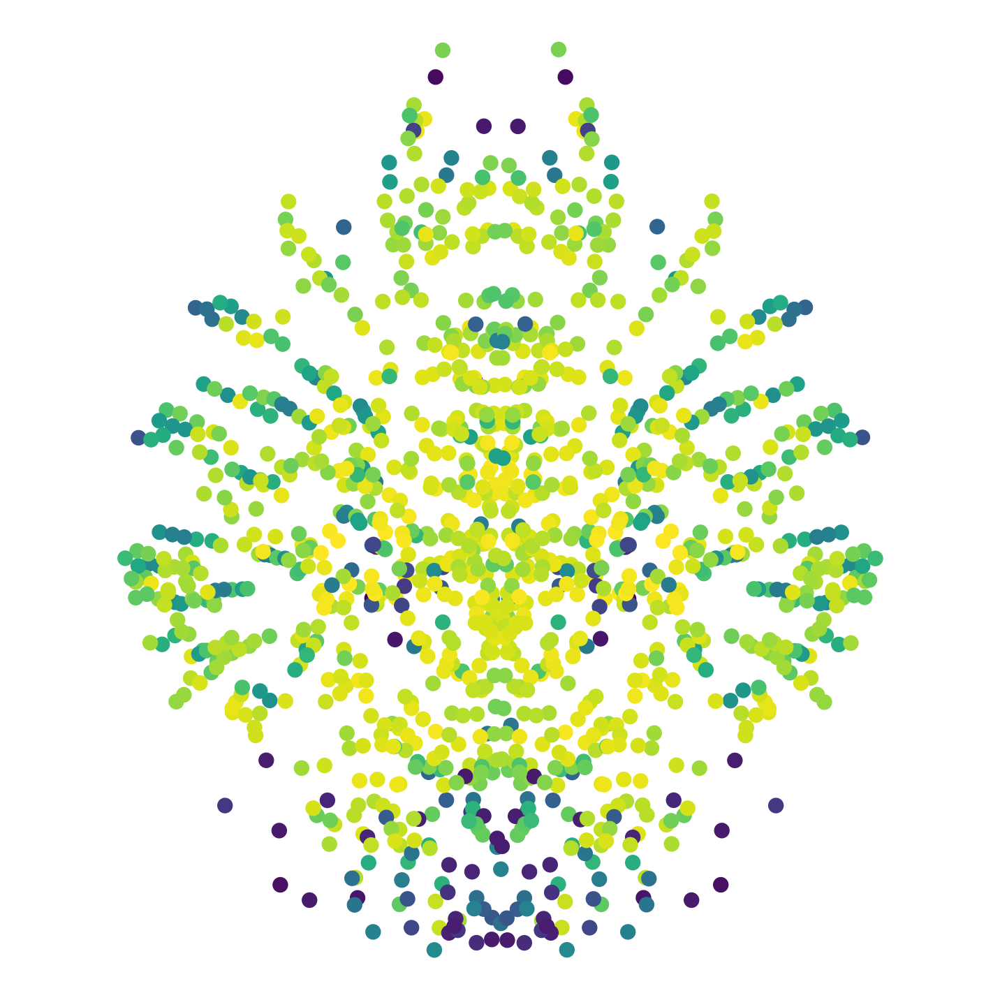

In [571]:
# atlasID が適切に設定されていることを確認する
# adata.obs に atlasID が含まれていることを前提にします
if 'atlasID' not in adata.obs.columns:
    adata.obs['atlasID'] = data_normalized.index

# pseudotime_df を adata.obs から作成し、インデックスを atlasID にする
pseudotime_df = pd.DataFrame(adata.obs[['atlasID', 'dpt_pseudotime']])

# pseudotime_df のインデックスを data_normalized のインデックス（atlasID）に基づいて設定
pseudotime_df = pseudotime_df.set_index('atlasID')

# data_normalized のインデックスに対応して pseudotime の値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['dpt_pseudotime'])

# pseudotime が NaN の場合は 0 で補完（必要に応じて）
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridis_rカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
#plt.title('Centroids of Left and Right Brain with Pseudotime Coloration')
#plt.xlabel('X (um)')
#plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.colorbar(sc, label='Pseudotime from Abeta PCA')  # カラーバーを追加
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Whole_brain_plot_of_Regional_Abeta_psedotime.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


#4_APPmodel_Ctr1m_1_2022_1104_1550
#4_APPmodel_Ctr1m_2_2022_1108_959
#4_APPmodel_Ctr1m_3_2022_1209_1751
#5_APPmodel_Ctr3m_1_2023_0113_1230
#5_APPmodel_Ctr3m_2_2023_0210_1142
#5_APPmodel_Ctr3m_3_2023_0227_1605
#4_APPmodel_Ctr3m_4_2023_0427_1444
#4_APPmodel_Ctr5m_1_2022_1026_252
#4_APPmodel_Ctr5m_2_2022_1028_2336
#4_APPmodel_Ctr5m_3_2022_1101_140
#4_APPmodel_Ctr5m_4_2023_0512_2057
#5_APPmodel_Ctr7m_1_2023_0206_1534
#5_APPmodel_Ctr7m_2_2023_0313_1111
#5_APPmodel_Ctr7m_3_2023_0331_2139
#4_APPmodel_Ctr7m_4_2023_0516_1559
#5_APPmodel_Ctr7m_5_2023_0522_2218
#5_APPmodel_Ctr9m_1_2023_0130_1607
#5_APPmodel_Ctr9m_2_2023_0216_2052
#5_APPmodel_Ctr9m_3_2023_0322_2014
#5_APPmodel_Ctr9m_4_2023_0518_1449
997
Coefficient: -0.014910819709107966, p-value: 0.7531216993150615
68


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.21670528005898113, p-value: 0.46657466635536193
667
Coefficient: -0.0024515345567343587, p-value: 0.9867479983574413
52192
Coefficient: -0.016340240662700473, p-value: 0.9061513244796642
52196
Coefficient: -0.025532918846278098, p-value: 0.9030783046432158
52264
Coefficient: 0.006115135578067753, p-value: 0.9979067364123321
320
Coefficient: -0.01807348175373276, p-value: 0.8410190121200675
943
Coefficient: -0.010682513931607083, p-value: 0.750064388996865
648
Coefficient: -0.01747761771054402, p-value: 0.6760303440410607
844


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0026097520382009367, p-value: 0.94399256666413
882
Coefficient: -0.02361624636143715, p-value: 0.9024237187313019
656
Coefficient: -0.022413794067877073, p-value: 0.7230026404028521
962
Coefficient: -0.018526217425604483, p-value: 0.5892912205525267
767
Coefficient: -0.022018778536937, p-value: 0.5435268374380937
1021
Coefficient: -0.006402756553220829, p-value: 0.8779277432585727
1085
Coefficient: -0.00038182639691119503, p-value: 0.9988047713145475
558
Coefficient: -0.011677587595995919, p-value: 0.9202152474387217
838


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009706098427504922, p-value: 0.9004196709211362
654
Coefficient: -0.007449211045147475, p-value: 0.9107130334617477
702
Coefficient: -0.02444131572328256, p-value: 0.8204330011072045
889
Coefficient: -0.006722779417500129, p-value: 0.9207542704343217
929
Coefficient: 0.0022087873225315087, p-value: 0.994763340080802
981
Coefficient: -0.009663494062777072, p-value: 0.895017900900998
201
Coefficient: -0.0005109287549861599, p-value: 0.9906848378793487
1047
Coefficient: 0.00024006702254033584, p-value: 0.995873502986244
1070


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.012603520302779829, p-value: 0.841384101916737
1038
Coefficient: 0.0021860810902997302, p-value: 0.9655212105734948
1062
Coefficient: -0.022911182961031323, p-value: 0.9388054611567727
1030
Coefficient: -0.02083938629756754, p-value: 0.8973033029305569
113
Coefficient: -0.0023754507141990192, p-value: 0.9728378738165947
1094
Coefficient: -6.355751369507403e-06, p-value: 0.9999470778549229
1128
Coefficient: -0.015124347950208113, p-value: 0.8651095383918112
478
Coefficient: 0.004276442904773504, p-value: 0.9574822226441039
510


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.04030923309474425, p-value: 0.9437893060624933
878
Coefficient: -0.013936998764082054, p-value: 0.8709939546862286
657
Coefficient: -0.009629305377928558, p-value: 0.8482716916382502
950
Coefficient: -0.004991246785189116, p-value: 0.9221270807173855
974
Coefficient: -0.02215466037345546, p-value: 0.7413823323533595
1102
Coefficient: -0.009201487611670577, p-value: 0.8444312917746729
2
Coefficient: -0.0063868825599033025, p-value: 0.9746923809938637
450
Coefficient: -0.014027789362341583, p-value: 0.9037001284530717
854


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005080660407826197, p-value: 0.933324866501448
577
Coefficient: 0.0020798421701454075, p-value: 0.9768335964246907
625
Coefficient: -0.017227082392583824, p-value: 0.8350745016400242
945
Coefficient: 0.0011278598757667423, p-value: 0.9853856419823308
1026
Coefficient: -0.02505533430988794, p-value: 0.9356679086092895
1006
Coefficient: -0.015506097251625568, p-value: 0.9112019127862168
670
Coefficient: 0.0020083512719278563, p-value: 0.9797109981958002
1086
Coefficient: -0.00440024345034525, p-value: 0.9782335783012561
1111


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011384233289429356, p-value: 0.9193592911518642
9
Coefficient: 0.0005039477305153328, p-value: 0.9967005175507782
461
Coefficient: -0.02826700354047763, p-value: 0.9523919733956471
18693
Coefficient: -0.013133968353821803, p-value: 0.9413366363795427
18697
Coefficient: -0.003695294635638158, p-value: 0.9719966917224326
18701
Coefficient: 0.0019937272330814576, p-value: 0.9876259717810466
18705
Coefficient: -0.01742271583485594, p-value: 0.909078214551981
18709
Coefficient: -0.0020888820357587066, p-value: 0.9846924920384282
18713


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006776294470424052, p-value: 0.990307750882362
873
Coefficient: -0.019890082940150138, p-value: 0.767917713456804
806
Coefficient: -0.013143545663053733, p-value: 0.7551454212523436
1035
Coefficient: -0.007575264558341102, p-value: 0.8972080951598865
1090
Coefficient: -0.023547859891756794, p-value: 0.6501702986347461
862
Coefficient: -0.01380460686828, p-value: 0.7580576743848331
893
Coefficient: -0.016049752919785294, p-value: 0.9269083923461618
36
Coefficient: -0.03143699324202701, p-value: 0.8910595081842403
180


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01815734516905032, p-value: 0.8565975190095558
148
Coefficient: -0.012749949840989634, p-value: 0.9414014708688311
187
Coefficient: -0.021818117845524086, p-value: 0.8223455238050053
638
Coefficient: -0.018554458965090614, p-value: 0.8366147465312507
662
Coefficient: -0.013302748533432345, p-value: 0.9653363989101224
897
Coefficient: -0.03180654371660945, p-value: 0.8415034759686362
1106
Coefficient: -0.021217905534642912, p-value: 0.8093228177267122
1010
Coefficient: -0.024740888265436925, p-value: 0.8839677857129095
1058


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03950527789055989, p-value: 0.6707925706604134
857
Coefficient: -0.033726929461037426, p-value: 0.726748703946555
849
Coefficient: -0.03829538878194376, p-value: 0.9071394548569184
527
Coefficient: 0.0005522973770143754, p-value: 0.9972482975890081
600
Coefficient: 0.004106876344250662, p-value: 0.9662843277731133
678
Coefficient: 0.010582189271263897, p-value: 0.9436028319635419
252
Coefficient: -0.010662711682001726, p-value: 0.9248600352123789
156
Coefficient: -0.0003325984462407539, p-value: 0.9981081958992415
243


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.015670512718787902, p-value: 0.9770061446582707
735
Coefficient: -0.007741882991979527, p-value: 0.9428593657098936
251
Coefficient: -0.007530448216221378, p-value: 0.9285978310355633
816
Coefficient: -0.002887181877832325, p-value: 0.980751006786582
847
Coefficient: -0.014511954701348872, p-value: 0.8646640445709962
954
Coefficient: -0.0034615503443693333, p-value: 0.9763230194424587
1005
Coefficient: -0.013233661011857148, p-value: 0.9727616936719551
696
Coefficient: -0.005043405947145181, p-value: 0.9810399751600208
643


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0013099356037775147, p-value: 0.9928671111238816
759
Coefficient: 0.0031138056904027084, p-value: 0.9884140659470049
791
Coefficient: -0.007633126332479361, p-value: 0.9621400458882466
249
Coefficient: 0.003875446952790567, p-value: 0.984782725454903
456
Coefficient: -0.010346686711728482, p-value: 0.9850599195374565
959
Coefficient: -0.02083001331714936, p-value: 0.8870048989503667
755
Coefficient: -0.019275623268997902, p-value: 0.84557743206144
990
Coefficient: -0.021584534190880862, p-value: 0.8804047613972136
1023


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.026551260085630943, p-value: 0.7727645131643934
520
Coefficient: -0.01417446443605594, p-value: 0.9118093001063416
598
Coefficient: -0.02483363917992019, p-value: 0.9536044128888699
1074
Coefficient: -0.01459299293020308, p-value: 0.9419299064677111
905
Coefficient: 0.003444519626383796, p-value: 0.9776714396460285
1114
Coefficient: 0.0045491330514261475, p-value: 0.9795804538393096
233
Coefficient: -0.010057932210148508, p-value: 0.9460960365139569
601
Coefficient: 0.0010220986696393394, p-value: 0.9951679164356503
649


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01126567695248962, p-value: 0.981717779738935
281
Coefficient: 0.0003918092689639352, p-value: 0.9985274119455685
1066
Coefficient: -0.00785725115050838, p-value: 0.9426089501225874
401
Coefficient: 0.00024885625104582756, p-value: 0.9989595540173931
433
Coefficient: -0.017847904079571077, p-value: 0.8895715911014207
1046
Coefficient: -0.003270891516781775, p-value: 0.9813170127324916
441
Coefficient: -0.0018107270960242797, p-value: 0.9961238818432137
421
Coefficient: -0.010862785106057826, p-value: 0.9493933089250843
973


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00552356911762069, p-value: 0.9575409100612183
573
Coefficient: -0.007503580037856282, p-value: 0.9556421931535126
613
Coefficient: -0.027717219022166055, p-value: 0.8128240386528998
74
Coefficient: -0.010837276176838242, p-value: 0.9283835451217843
121
Coefficient: -0.016736595647655027, p-value: 0.9621432365223532
593
Coefficient: -0.005799229652878421, p-value: 0.9199693846003001
821
Coefficient: 0.0008080509973157949, p-value: 0.9825518969510534
721
Coefficient: -0.0015762978209709006, p-value: 0.975637200451722
778


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01563006943730416, p-value: 0.7548818971633342
33
Coefficient: -0.003292985797398765, p-value: 0.9484524437683794
305
Coefficient: -0.014902664487156127, p-value: 0.9262237074304361
750
Coefficient: -0.02170031223830964, p-value: 0.8971446653922581
269
Coefficient: -0.017162512387737788, p-value: 0.9059066868658139
869
Coefficient: -0.02596099944204984, p-value: 0.9447568490763525
902
Coefficient: -0.031117221816749807, p-value: 0.8325241812322222
377
Coefficient: -0.012818043855315273, p-value: 0.9411430816241194
393


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.008237791256400747, p-value: 0.9898105623805924
805
Coefficient: -0.0009203971901632349, p-value: 0.9957406069337822
41
Coefficient: -0.010424069749608713, p-value: 0.9091241185859379
501
Coefficient: -0.007650179367520676, p-value: 0.9586453910860919
565
Coefficient: -0.022338780312079583, p-value: 0.8478033033897875
257
Coefficient: -0.003719991658901739, p-value: 0.9779837388568423
469
Coefficient: -0.010601381319201419, p-value: 0.9757940488110323
31578
Coefficient: -0.008745766303065516, p-value: 0.9758290499123359
31582


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006332218911346659, p-value: 0.9686192201539207
31586
Coefficient: -0.003999077566270852, p-value: 0.9865164094466835
31590
Coefficient: -0.024385439959704193, p-value: 0.8861765035695841
31594
Coefficient: -0.009820339024944778, p-value: 0.9601002752989826
31598
Coefficient: -0.01094479157930959, p-value: 0.9832618323061102
31632
Coefficient: -0.017925304861518006, p-value: 0.9035352384807975
31636
Coefficient: -0.01760782999918532, p-value: 0.8628052296602226
31640
Coefficient: -0.02307846863756919, p-value: 0.9310291936271515
31644


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.026619626723683426, p-value: 0.8285115179666325
31648
Coefficient: -0.011261582587229157, p-value: 0.9340079473244361
31652
Coefficient: -0.013205945913531296, p-value: 0.9742276886175973
935
Coefficient: -0.040987854040785754, p-value: 0.7920021802828358
211
Coefficient: -0.02207124249668998, p-value: 0.7623119285362123
1015
Coefficient: -0.02225356010348473, p-value: 0.7102043409767074
919
Coefficient: -0.0060264145928318, p-value: 0.9308773984067495
927
Coefficient: -0.0057216639037625475, p-value: 0.9896860206528415
588


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011921455791808139, p-value: 0.9483328324003546
296
Coefficient: -0.007127373610425044, p-value: 0.9303725808934238
772
Coefficient: -0.01146345048117581, p-value: 0.8495968869119506
810
Coefficient: -0.004928915180096268, p-value: 0.9579586732359612
819
Coefficient: -0.03441222639586798, p-value: 0.9076061099602469
171
Coefficient: -0.06611010864570842, p-value: 0.6874097742487975
304
Coefficient: -0.03520119014670145, p-value: 0.7069204157890758
363
Coefficient: -0.03017227899084878, p-value: 0.6782743388947303
84


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.012614776772048225, p-value: 0.8863350334784547
132
Coefficient: -0.025350989229160077, p-value: 0.9545280264965322
707
Coefficient: -0.006537446077064502, p-value: 0.9843821546565724
556
Coefficient: -0.024312946707786585, p-value: 0.9059306211343584
827
Coefficient: -0.01621935410909087, p-value: 0.872843800384976
1054
Coefficient: -0.007996695355344639, p-value: 0.9483922700248963
1081
Coefficient: -0.02144757627729496, p-value: 0.9755159725378539
448
Coefficient: -0.016425187644404652, p-value: 0.9456873899034545
412


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004128507993991778, p-value: 0.9644637093538351
630
Coefficient: -0.009552286206823081, p-value: 0.891357905633664
440
Coefficient: -0.0036812981437623, p-value: 0.969805664734235
488
Coefficient: 0.009943750803638973, p-value: 0.9765727226422062
484
Coefficient: -0.07667825230412938, p-value: 0.7832526773369305
582
Coefficient: -0.013738002932175026, p-value: 0.9106154136714617
620
Coefficient: -0.021062897173552766, p-value: 0.8231100660388266
910
Coefficient: -0.008348350717709884, p-value: 0.9551820835506536
52977


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0143490559443022, p-value: 0.9905888969727825
969
Coefficient: -0.02625986656080685, p-value: 0.9035881196344433
288
Coefficient: 0.002261294921593371, p-value: 0.9786664465566238
1125
Coefficient: -0.0066712300071134194, p-value: 0.9370477025069623
608
Coefficient: 8.207272040923941e-05, p-value: 0.9994718394364149
680
Coefficient: 0.01563663983410541, p-value: 0.9814948481896044
996
Coefficient: -0.016157779938238144, p-value: 0.9359469648896007
328
Coefficient: -0.03152114326482837, p-value: 0.7150000401237245
1101


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.035272231399674454, p-value: 0.607775529801805
783
Coefficient: -0.019966689951170603, p-value: 0.7890990555637659
831
Coefficient: -0.013545482113675553, p-value: 0.9658521771439635
120
Coefficient: -0.02537943816273705, p-value: 0.8949799050630165
163
Coefficient: -0.031355946263679886, p-value: 0.7102124366656434
344
Coefficient: -0.02793160799692282, p-value: 0.7878933507116238
314
Coefficient: -0.015437535957319913, p-value: 0.8764406212661917
355
Coefficient: -0.019044894441629132, p-value: 0.9699453577425057
704


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0019481588136644873, p-value: 0.9944516800545969
694
Coefficient: -0.021647726316802646, p-value: 0.8550865251051762
800
Coefficient: -0.02689018381947439, p-value: 0.7902807816786033
675
Coefficient: -0.012651925740551406, p-value: 0.9381094350001286
699
Coefficient: 0.0012200462883310069, p-value: 0.9992147147428357
671
Coefficient: -0.011769118959041914, p-value: 0.9148399059882298
965
Coefficient: -0.005281926901481067, p-value: 0.9294574836880919
774
Coefficient: -0.013885945833745802, p-value: 0.8405196930328673
906


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00611445352104151, p-value: 0.9452437855521287
279
Coefficient: -0.0020490619005996678, p-value: 0.995521269590782
442
Coefficient: -0.003345682728613136, p-value: 0.9632955405968231
434
Coefficient: -0.006199865855420361, p-value: 0.9014811322899569
610
Coefficient: -0.01818784559075341, p-value: 0.7499404520289557
274
Coefficient: -0.011510406822301106, p-value: 0.8644007452870044
330
Coefficient: -0.005744105667867693, p-value: 0.9898361178615732
542


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010436563738603662, p-value: 0.8468303806945171
430
Coefficient: -0.009832850851241795, p-value: 0.7983717018073604
687
Coefficient: -0.013411158522881614, p-value: 0.7809542006910419
590
Coefficient: -0.010490459020970597, p-value: 0.8904296781109232
622
Coefficient: -0.012337614155380127, p-value: 0.9779363930797175
31550
Coefficient: -0.020040324947913513, p-value: 0.8798888337519346
31554
Coefficient: -0.006540794449661584, p-value: 0.9331404244527923
31558
Coefficient: -0.008131857645328975, p-value: 0.9556012794568103
31562


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.019205953978043075, p-value: 0.8612361368993893
31566
Coefficient: -0.0014415273583375681, p-value: 0.9900234018471089
31570
Coefficient: -0.009910750656763376, p-value: 0.9748321746845886
31604
Coefficient: -0.013660593437960878, p-value: 0.9250211378902322
31608
Coefficient: 0.001171231511957658, p-value: 0.9901136153698129
31612
Coefficient: -0.007752331631309458, p-value: 0.9628375643191793
31616
Coefficient: -0.01291394091347703, p-value: 0.9214764059182019
31620
Coefficient: 0.0010592923969344813, p-value: 0.9938537237124704
31624


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.025112006990537793, p-value: 0.9551151474957247
97
Coefficient: -0.03306133735705214, p-value: 0.7901869904349077
1127
Coefficient: -0.02650060362671047, p-value: 0.7171661407775313
234
Coefficient: -0.030046237692159014, p-value: 0.8094604605838726
289
Coefficient: -0.03370382337725478, p-value: 0.6448496938335668
729
Coefficient: -0.015099314692737002, p-value: 0.8638912127024253
786
Coefficient: -0.022082611060986808, p-value: 0.935271950001095
540
Coefficient: -0.015375309331141736, p-value: 0.9440777166900978
888


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.024821459598310978, p-value: 0.8601949478824598
692
Coefficient: -0.015787807048161146, p-value: 0.9481744393434959
335
Coefficient: -0.0018538563035149012, p-value: 0.9953554935918695
368
Coefficient: -0.004805022311514986, p-value: 0.9945392436337364
836
Coefficient: -0.06000902464228476, p-value: 0.7574409598318508
427
Coefficient: -0.03436777359151906, p-value: 0.740704756541692
988
Coefficient: -0.027043316497410857, p-value: 0.8066505891912314
977
Coefficient: -0.008935751341480521, p-value: 0.9368717785698798
1045


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01223885181130165, p-value: 0.9731892206964197
698
Coefficient: 0.05331030444055357, p-value: 0.050363159220959075
507
Coefficient: 0.06179841345135567, p-value: 2.18317803030162e-11
188
Coefficient: -0.028483863035913798, p-value: 0.8878922332929967
196
Coefficient: 0.018470662000762725, p-value: 0.7806508742434815
204
Coefficient: 0.009680776168583552, p-value: 0.9257849473432772
159
Coefficient: -0.0019844701621619327, p-value: 0.9472805083305597
597
Coefficient: -0.009982758437751824, p-value: 0.9122892357190104
605


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02955064287136199, p-value: 0.7570585143176298
814
Coefficient: -0.008434609028697422, p-value: 0.9327641217007796
961
Coefficient: -0.012537653708081761, p-value: 0.5595632641671773
260
Coefficient: -0.00856597562813823, p-value: 0.9807395088826532
268
Coefficient: -0.010949713220473585, p-value: 0.9466015189691002
1139
Coefficient: -0.006702366179570383, p-value: 0.9806020881055431
639
Coefficient: -0.014060650020045277, p-value: 0.8566039100991127
655
Coefficient: -0.0010402929348195156, p-value: 0.9874658682936784
663


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.008035022039645593, p-value: 0.8755350577898369
788
Coefficient: -0.012927887115487296, p-value: 0.8716903398535752
566
Coefficient: -0.021751267244972863, p-value: 0.7434961490181338
1089
Coefficient: -0.013708833014684145, p-value: 0.9003662065706861
382
Coefficient: -0.004220229514110529, p-value: 0.8557578632651288
423
Coefficient: -0.012068508573448551, p-value: 0.9305653663655478
463
Coefficient: -0.012828135673583685, p-value: 0.6748083050361111
10703
Coefficient: -0.0020872958575951783, p-value: 0.9647030760955307
10704


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004467282250683716, p-value: 0.9280863952407499
632
Coefficient: 0.008160084793154155, p-value: 0.7073038255944968
982
Coefficient: -0.023648076024527995, p-value: 0.9303296648591347
19
Coefficient: -0.013280492870293505, p-value: 0.9587845035055734
1121
Coefficient: -0.019537845607940568, p-value: 0.8612871031800557
20
Coefficient: -0.011200001849741258, p-value: 0.851417899509352
52
Coefficient: -0.01219623554039968, p-value: 0.8668461925483241
139
Coefficient: -0.010521674244163242, p-value: 0.8925067120523332
28


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00012964729396065902, p-value: 0.9984429488891853
526
Coefficient: -0.04899793994778619, p-value: 0.6058180765340726
543
Coefficient: -0.018134689326448235, p-value: 0.8062667809734725
664
Coefficient: -0.019790389128505236, p-value: 0.7912626586655453
727
Coefficient: -0.012976019134515127, p-value: 0.8620091257743164
743
Coefficient: -0.008099803908610988, p-value: 0.9097154250066442
843
Coefficient: -0.01802046036153933, p-value: 0.8104822775315885
1037
Coefficient: -0.008122245057281999, p-value: 0.8698311712471813
1084


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004920540364568794, p-value: 0.9294268876920823
502
Coefficient: -0.00850158607386465, p-value: 0.8422027987455487
48470
Coefficient: -0.011280925498320063, p-value: 0.8618045721436022
58447
Coefficient: -0.009833751171817702, p-value: 0.9036943801839186
48508
Coefficient: -0.018715924311541975, p-value: 0.8525313747760292
703
Coefficient: -0.012806999545045838, p-value: 0.9165141828150308
583
Coefficient: -0.015395435396823266, p-value: 0.8498093015541774
952
Coefficient: -0.008685646263044893, p-value: 0.8674592777751062
966


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01453005181952086, p-value: 0.8833352380887542
131
Coefficient: -0.003648948294494512, p-value: 0.9558444292152127
303
Coefficient: -0.01706514617412665, p-value: 0.8461023079796104
311
Coefficient: -0.01522044927043432, p-value: 0.8668792232087933
451
Coefficient: -0.017149100093714318, p-value: 0.9128787698314573
327
Coefficient: -0.0033250138524215226, p-value: 0.9613756653678062
334
Coefficient: -0.009440198656629387, p-value: 0.9094368285291835
780
Coefficient: -0.010334016337660444, p-value: 0.8485343082666851
477


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007034745199657496, p-value: 0.8702151248388026
672
Coefficient: -0.005239297292514792, p-value: 0.673495232718518
56
Coefficient: -0.0006248034290892097, p-value: 0.978948131934147
998
Coefficient: -0.013702083605442752, p-value: 0.8893606256843187
754
Coefficient: -0.008987843293515384, p-value: 0.749277466650853
250
Coefficient: -0.015405406942697153, p-value: 0.8810684265774114
258


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011853920678441036, p-value: 0.8126577347379009
266
Coefficient: -0.008480587463001616, p-value: 0.9118642760614302
310
Coefficient: -0.03112468434809834, p-value: 0.8237898907604533
333
Coefficient: -0.009766359579149978, p-value: 0.9743961813130393
23
Coefficient: -0.011988147258329529, p-value: 0.9135759693924203
292
Coefficient: 0.009199453545186432, p-value: 0.9868749474155805
544
Coefficient: -0.005116378913136344, p-value: 0.9654484204972156
551
Coefficient: -0.0013384173955357387, p-value: 0.9911331597458479
559


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0014955096475285348, p-value: 0.9852090702373818
1105
Coefficient: -0.0063869084035356695, p-value: 0.950451027849799
403
Coefficient: -0.01340840572152007, p-value: 0.7544533167017141
803
Coefficient: -0.019403156382805063, p-value: 0.8232516505201125
1022
Coefficient: -0.0015094819033984674, p-value: 0.9885844976747988
1031
Coefficient: -0.0037008142076747595, p-value: 0.9862284413605061
342
Coefficient: -0.015060474347898013, p-value: 0.7408795519597327
298
Coefficient: -0.008233275566125955, p-value: 0.9475539792345896
564


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007853941620476841, p-value: 0.9550417638607316
596
Coefficient: -0.012788444850062964, p-value: 0.8910555487305505
581
Coefficient: -0.03739487728258239, p-value: 0.8418407260414056
351
Coefficient: -0.008651061113546812, p-value: 0.874551952867224
287
Coefficient: -0.019080742193909192, p-value: 0.9863518884887809
549
Coefficient: -0.013965859778383627, p-value: 0.8728986881714874
629
Coefficient: -0.008126964393731279, p-value: 0.9366823411562404
685
Coefficient: -0.009126242280715822, p-value: 0.9264939346465014
718


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0013942649272992967, p-value: 0.9896125903679842
725
Coefficient: -0.01949811780169619, p-value: 0.948805429053325
733
Coefficient: -0.005318007907682287, p-value: 0.9374914556684077
741
Coefficient: -0.04156605829680971, p-value: 0.8004609456847384
56435
Coefficient: -0.018873739811437768, p-value: 0.9053116328621236
414
Coefficient: -0.007265839293387571, p-value: 0.9764298803777625
422
Coefficient: -0.010056688076932918, p-value: 0.9602533352885905
609
Coefficient: -0.004501672876504904, p-value: 0.9831166566680318
1044


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009145397658672758, p-value: 0.9735689465329929
1072
Coefficient: -0.027082367145922305, p-value: 0.8699977673122399
1079
Coefficient: -0.031775196798562985, p-value: 0.8164025041082755
1088
Coefficient: -0.02364266294049468, p-value: 0.8912442308471265
49664
Coefficient: -0.009383712357998326, p-value: 0.9568131138360463
49668
Coefficient: -0.011876883369003194, p-value: 0.9246993023816645
49672
Coefficient: -0.012349612752968397, p-value: 0.9558142266503905
218
Coefficient: -0.02654262207763926, p-value: 0.7421300389741706
1020


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.024975693672755202, p-value: 0.7571922175812191
1029
Coefficient: -0.007411792551500647, p-value: 0.9662377046655242
325
Coefficient: -0.016992005331614685, p-value: 0.9206664661515167
56551
Coefficient: -0.023328693081841458, p-value: 0.9017016864346267
255
Coefficient: -0.010967370314897303, p-value: 0.9129454409762789
1096
Coefficient: -0.006531255898780389, p-value: 0.9655418801860373
1104
Coefficient: -0.002028354582144673, p-value: 0.990599045675878
64
Coefficient: -0.0049246880226415934, p-value: 0.9784174518796872
1120


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.016419624775077524, p-value: 0.9590367333668567
1113
Coefficient: -0.007863300674408564, p-value: 0.9657287584505173
155
Coefficient: -0.010977984790685505, p-value: 0.9063170431571008
59
Coefficient: -0.013250081699955044, p-value: 0.9315472785368681
362
Coefficient: -0.01364835110906785, p-value: 0.8265064609375948
366
Coefficient: -0.017528902984461858, p-value: 0.8971386513590605
1077
Coefficient: -0.0022105290529135344, p-value: 0.9902424626624922
149
Coefficient: -0.018151690468835503, p-value: 0.84187088145908
15


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007966769355916012, p-value: 0.9580205009028369
181
Coefficient: -0.003724900679316186, p-value: 0.9711020012412609
56559
Coefficient: -0.0013343466770348487, p-value: 0.9952169278850423
189
Coefficient: -0.03300643003448071, p-value: 0.8716111524641103
599
Coefficient: -0.016834933053173136, p-value: 0.8976862893811938
907
Coefficient: -0.01668604763444124, p-value: 0.9168538195709998
575
Coefficient: -0.017730045670481854, p-value: 0.887249492242926
930
Coefficient: -0.006379949608416639, p-value: 0.9520496706950469
56563


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007857833813363883, p-value: 0.9618238019713599
262
Coefficient: -0.020935564444869246, p-value: 0.772535912069239
27
Coefficient: -0.017393078241414547, p-value: 0.9487774247035806
56439
Coefficient: -0.01758501585423085, p-value: 0.9724855339065106
178
Coefficient: -0.014344003687955409, p-value: 0.9022302802749635
321
Coefficient: -0.035219310601762546, p-value: 0.935081703513946
483
Coefficient: -0.030594893715239692, p-value: 0.7528545378446259
186
Coefficient: -0.030045929788023073, p-value: 0.7990708850031915
1097


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01198742090285913, p-value: 0.783179009431695
390
Coefficient: -0.04463842765312278, p-value: 0.9050591804833761
332
Coefficient: -0.004742495160457691, p-value: 0.9943855284424266
38
Coefficient: 0.0019108136780133342, p-value: 0.9895301277810329
30
Coefficient: -0.010409533721022119, p-value: 0.9685597935475057
118
Coefficient: -0.024464686076306228, p-value: 0.8959799895156008
223
Coefficient: -0.029874313971734356, p-value: 0.7993352284218221
72
Coefficient: -0.006004454476714366, p-value: 0.97689038561757
263


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.012426229015471843, p-value: 0.9580899088536429
272
Coefficient: -0.013781111846568961, p-value: 0.9294633725420541
830
Coefficient: -0.013235037578017608, p-value: 0.8879999993009594
452
Coefficient: -0.006230796355640923, p-value: 0.9843567331800659
523
Coefficient: -0.011626901473509964, p-value: 0.8966927852120271
763
Coefficient: -0.03114185223417493, p-value: 0.9637428347194474
914
Coefficient: -0.0027638451902836977, p-value: 0.9948577745703392
1109
Coefficient: -0.014871131331974196, p-value: 0.9420030733831698
126


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01345478054754293, p-value: 0.9363447900581604
133
Coefficient: -0.009196148352284118, p-value: 0.9586682002909614
347
Coefficient: -0.00231184332662051, p-value: 0.9892920696812761
286
Coefficient: -0.012095704607608677, p-value: 0.9606521704510425
338
Coefficient: -0.12116273627247741, p-value: 0.8996608164068064
57699
Coefficient: -0.01085585390226339, p-value: 0.9676818381163147
689
Coefficient: -0.023667903999240347, p-value: 0.9331685968657203
88
Coefficient: -0.009245925025684075, p-value: 0.8955794219147879
210


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.032765984375540236, p-value: 0.8816880028641646
732
Coefficient: -0.020578143908914114, p-value: 0.914729943308232
60647
Coefficient: -0.012203698352709808, p-value: 0.9140142219918268
60651
Coefficient: -0.0181838803092732, p-value: 0.8942420007815418
60655
Coefficient: -0.017900198959046074, p-value: 0.9570935033874262
60659
Coefficient: -0.011752301301413231, p-value: 0.9603913479720091
525
Coefficient: -0.013795474851624091, p-value: 0.9258285687484611
1126
Coefficient: -0.023931945701889022, p-value: 0.9369801593249796
1


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.021944466811861213, p-value: 0.9058566177472164
515
Coefficient: -0.007229905600862667, p-value: 0.9372368928921273
980
Coefficient: -0.009640885770735541, p-value: 0.952701966861216
1004
Coefficient: -0.009686280522102752, p-value: 0.9352606545223603
63
Coefficient: -0.0064037335795408944, p-value: 0.9730148544345685
693
Coefficient: -0.005893136927556501, p-value: 0.9439011985744803
946
Coefficient: -0.005645988594226134, p-value: 0.9441150420147478
194
Coefficient: -0.014624379280864882, p-value: 0.7979013907401787
226


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01157033372044219, p-value: 0.9116722000623069
356
Coefficient: -0.018444932674327466, p-value: 0.9763942960344741
364
Coefficient: -0.003561978727834438, p-value: 0.9825906361607385
57704
Coefficient: -0.016161870830809753, p-value: 0.9204420443332916
173
Coefficient: -0.02209619711681888, p-value: 0.9252801740420675
470
Coefficient: 0.0027528368611340866, p-value: 0.9850589276533378
614
Coefficient: -0.018172741944651325, p-value: 0.8570219551198697
797
Coefficient: -0.008869472315135903, p-value: 0.891121806901648
804


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0006127267033075415, p-value: 0.9978589893847145
10671
Coefficient: -0.012114068576414812, p-value: 0.9723133590918372
313
Coefficient: -0.015089797769854613, p-value: 0.6549985141227435
851
Coefficient: -0.020403046505682605, p-value: 0.7538666025049083
842
Coefficient: -0.010785341409165027, p-value: 0.8520047247532038
834
Coefficient: 0.002169553111073712, p-value: 0.9872642412871153
811
Coefficient: -0.008667783155240688, p-value: 0.8687426643136639
820
Coefficient: -0.008245525049844877, p-value: 0.867915927638613
828


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.022455213610372827, p-value: 0.6540001186821538
580
Coefficient: -0.006123329100349883, p-value: 0.9845737705207733
271
Coefficient: -0.039034021526658115, p-value: 0.8922770662542219
874
Coefficient: -0.048951736262547195, p-value: 0.9111353944839518
460
Coefficient: -0.001294947661013394, p-value: 0.9987596720565107
59923
Coefficient: -0.014838427213124401, p-value: 0.9869147047601052
381
Coefficient: -0.00624206625174299, p-value: 0.9506211951808493
749
Coefficient: -0.005512720599393416, p-value: 0.9706378667126833
60830


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.015038669513096552, p-value: 0.9783315160967239
246
Coefficient: -0.0032786662531855957, p-value: 0.9903013511860078
128
Coefficient: -0.008410840896775278, p-value: 0.8485487935381548
26
Coefficient: -0.013205642215211855, p-value: 0.8369694611468786
42
Coefficient: -0.012831612638244085, p-value: 0.9138182576445468
17
Coefficient: -0.016888897550075783, p-value: 0.7196519422775219
10
Coefficient: -0.019810588356854248, p-value: 0.6422524172586116
795
Coefficient: -0.011473783328422823, p-value: 0.7456817871446906
50


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00811955782931758, p-value: 0.9617563594617999
67
Coefficient: -0.009867417049975664, p-value: 0.9761028457116763
587
Coefficient: -0.015030289823534911, p-value: 0.9527785896996348
61277
Coefficient: -0.015336491439488285, p-value: 0.9667148378753023
215
Coefficient: -0.006535127823223523, p-value: 0.9225463881168453
531
Coefficient: -0.006112938454845753, p-value: 0.984625607928232
628
Coefficient: -0.009983229603253213, p-value: 0.9609669968150121
634
Coefficient: -0.019036024585206784, p-value: 0.8866639637840223
706


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.013002233879960474, p-value: 0.9640310625710427
1061
Coefficient: -0.00903383468527592, p-value: 0.9562672029725147
54203
Coefficient: -0.0054964794130388794, p-value: 0.9874119349815424
616
Coefficient: -0.013319401683151181, p-value: 0.904509323144175
214
Coefficient: 0.01824241984869152, p-value: 0.8886766319981538
35
Coefficient: -0.00657448527522214, p-value: 0.9895752964840113
54211
Coefficient: 0.0019841085369776638, p-value: 0.9972186978962383
975
Coefficient: -0.008697115578737277, p-value: 0.9854909183423529
115


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01687054607196296, p-value: 0.9870663219351146
60663
Coefficient: -0.010963385592559377, p-value: 0.9893631209011656
757
Coefficient: 0.008974100285543763, p-value: 0.9844519266140068
231
Coefficient: 0.016685800286626525, p-value: 0.9715536604438679
66
Coefficient: -0.025631576577644716, p-value: 0.961446993748207
75
Coefficient: -0.031603001974842164, p-value: 0.9779205912211528
58
Coefficient: -0.005677766694333475, p-value: 0.9892883100239265
374
Coefficient: -0.004699670998984232, p-value: 0.9825652045418583
1052


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011126095198478344, p-value: 0.9165070813155652
12
Coefficient: -0.021380196051630905, p-value: 0.9357855802235585
100
Coefficient: -0.019414295775652003, p-value: 0.9832246996544239
60834
Coefficient: -0.03392787337688301, p-value: 0.8861430179299552
60838
Coefficient: -0.015256670271710404, p-value: 0.9656384343139448
60842
Coefficient: -0.02696454798200644, p-value: 0.9523283042428573
60846
Coefficient: -0.014222243919400166, p-value: 0.9662935726608123
60850
Coefficient: -0.03200525452305471, p-value: 0.9530656298100688
60854


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.06167542961688973, p-value: 0.9010140809536049
60858
Coefficient: -0.03180622673922027, p-value: 0.9403648845371166
60862
Coefficient: -0.023735919302001914, p-value: 0.9700002715078224
197
Coefficient: -0.020157048053787565, p-value: 0.9552871155087905
591
Coefficient: -0.015115744809320838, p-value: 0.9600763729802244
872
Coefficient: -0.007072643483457414, p-value: 0.9683414588361476
771
Coefficient: -0.005302807907692883, p-value: 0.9271787286211828
612
Coefficient: -0.007698831403139875, p-value: 0.9546027601404848
7


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.003470242518761242, p-value: 0.9652321843259439
867
Coefficient: -0.005806449030566646, p-value: 0.9395210533953396
123
Coefficient: -0.0011938409795907397, p-value: 0.9954126293898528
122
Coefficient: -0.027117049185420704, p-value: 0.9089299744948585
105
Coefficient: -0.0155023021856977, p-value: 0.9686710205134363
114
Coefficient: -0.007255016854931143, p-value: 0.9755256961388942
280
Coefficient: 0.016618677034455073, p-value: 0.9791399709181203
880
Coefficient: -0.0008099880607303629, p-value: 0.9971451838390734
59927


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004653499574319579, p-value: 0.9881206204679314
898
Coefficient: 0.002564516883074225, p-value: 0.981151173039629
931
Coefficient: -0.020192944711407392, p-value: 0.8147553904632584
1093
Coefficient: 0.0018212367825866166, p-value: 0.9839364811667488
318
Coefficient: 0.022052836785321953, p-value: 0.9684882451095919
534
Coefficient: -0.00948069749035471, p-value: 0.9665264833868353
574
Coefficient: 0.004962510723805168, p-value: 0.967270428024805
621
Coefficient: 0.0028957673656310736, p-value: 0.9919947369232288
54215


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006357189749873187, p-value: 0.9858973944614926
54219
Coefficient: -0.00940994790583633, p-value: 0.9947791214170338
54223
Coefficient: 0.0036558236995923427, p-value: 0.9931683715397837
54227
Coefficient: -0.010417425088602331, p-value: 0.985174698928029
679
Coefficient: -0.002002226669253336, p-value: 0.9852076213113993
147
Coefficient: 0.0506317892567886, p-value: 0.9420669203188223
162
Coefficient: -0.0010639463360623059, p-value: 0.99422180248127
604
Coefficient: -0.002531083424849595, p-value: 0.991234228536389
146


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0029588069529130176, p-value: 0.9689105829949983
238
Coefficient: 0.014316076393509224, p-value: 0.9633608248455394
350
Coefficient: 0.011963112151854041, p-value: 0.9854101181892057
358
Coefficient: 0.0046470344706735275, p-value: 0.9907244707159157
354
Coefficient: 0.0036303464443212703, p-value: 0.9395758123903664
207
Coefficient: 0.059010329799916515, p-value: 0.8238165704514566
96


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.003288259806841002, p-value: 0.9660076057102899
101
Coefficient: -0.00978474295506713, p-value: 0.9163639323731549
711
Coefficient: -0.005336977833173843, p-value: 0.9692926116573715
1039
Coefficient: 0.025224188587947158, p-value: 0.9253247587361736
903
Coefficient: 0.022409858598939996, p-value: 0.9190578373793366
642
Coefficient: 0.007930433010026524, p-value: 0.9816140372997563
651


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0023897757862489646, p-value: 0.9726936578141822
429
Coefficient: -0.019901034530785653, p-value: 0.7215898526581752
437
Coefficient: -0.00749428066438492, p-value: 0.9021640411482784
445
Coefficient: -0.0042212864090137164, p-value: 0.9708171018844752
58451


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01989745355293564, p-value: 0.9458505494774246
653
Coefficient: 0.021732451803362644, p-value: 0.9768811046709936
661
Coefficient: -0.02288040486548954, p-value: 0.9094233123885468
576
Coefficient: -0.006215331816003121, p-value: 0.9978913161871009
939
Coefficient: -0.0023765669202994283, p-value: 0.9973163565729959
143
Coefficient: 0.008716629478216243, p-value: 0.9888332559018111
839


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004865331860750551, p-value: 0.9781845308375748
1048
Coefficient: 0.016814913585510703, p-value: 0.8492864574159948
372
Coefficient: 0.018237723257519416, p-value: 0.9756271652311228
83
Coefficient: 0.01715305106745993, p-value: 0.9185085898057336
136
Coefficient: 0.006221460542945376, p-value: 0.9259192565743748
106
Coefficient: -0.004790387187053171, p-value: 0.9957621878616931
203


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014003587592293023, p-value: 0.9719926407980097
955
Coefficient: 0.009504644801542197, p-value: 0.9372047132970442
963
Coefficient: -0.02744863394912889, p-value: 0.9492704278288324
307
Coefficient: 0.016317030737057335, p-value: 0.9283968324251393
1098
Coefficient: -0.008432938195933826, p-value: 0.9177455033613988
1107
Coefficient: -0.005231125198732187, p-value: 0.9601216736545564
852


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0023722973541335985, p-value: 0.9708609360568312
859
Coefficient: -0.022539478951207434, p-value: 0.9472140330762445
970
Coefficient: 0.026467324327471616, p-value: 0.9066937987419355
978
Coefficient: -0.0016779434434422498, p-value: 0.9899553705870461
177
Coefficient: 0.025887530102205403, p-value: 0.9638641620906158
169
Coefficient: 0.028753702716283323, p-value: 0.8797185953545966
1069
Coefficient: -0.0030984178580186796, p-value: 0.9938824530450499
209


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0365544916220762, p-value: 0.9317600693160046
202
Coefficient: 0.01803678313056403, p-value: 0.8456393700732779
225
Coefficient: 0.002042952590941425, p-value: 0.9901785675590292
217
Coefficient: 0.02881322328876458, p-value: 0.9141942559190498
765
Coefficient: 0.011150301000749091, p-value: 0.9793274692665273
773
Coefficient: 0.023624243766643783, p-value: 0.9212112897287609
781
Coefficient: 0.0038801537677555383, p-value: 0.9964928283983432
206
Coefficient: 0.015732219409890412, p-value: 0.9628401665206746
230


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.006403677713984566, p-value: 0.9861511772782797
222
Coefficient: 0.0247289350600036, p-value: 0.9594676010093166
512
Coefficient: -0.0100619151710045, p-value: 0.9182747942333288
912
Coefficient: -0.010064529022289949, p-value: 0.9181608215608372
976
Coefficient: -0.043862880506248404, p-value: 0.1070049906762363
984
Coefficient: 0.000343691006773525, p-value: 0.986183602762365
1091
Coefficient: 0.001964352042609106, p-value: 0.8751511184179259
936
Coefficient: -0.008530153856324238, p-value: 0.6590095401441678
944


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0021103292216691797, p-value: 0.944861617027817
951
Coefficient: -0.0074091336458438715, p-value: 0.791476260010832
957
Coefficient: 0.004729365105101375, p-value: 0.81405832020617
968
Coefficient: 0.0050349302318086625, p-value: 0.8601255870949344
1007
Coefficient: -0.002232097636662787, p-value: 0.866027665745744
1056
Coefficient: -0.0038371724845692977, p-value: 0.7789640639951639
1064
Coefficient: 0.004462712727113507, p-value: 0.7722517935944297
1025
Coefficient: 0.002978237276804315, p-value: 0.83848008575016
1033


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0008996537104191063, p-value: 0.9625989602267082
1041
Coefficient: 0.003031922923662679, p-value: 0.8211270584884353
1049
Coefficient: -0.002167251136338627, p-value: 0.9385843412070904
989
Coefficient: 0.045626944154791536, p-value: 0.8046779567401596
91
Coefficient: 0.010144046874161443, p-value: 0.9338786049032601
846
Coefficient: -0.005909337027691821, p-value: 0.977328016394175
58455
Coefficient: 0.022067799593725287, p-value: 0.96524659992512
1009
Coefficient: -0.020098070292774876, p-value: 0.8222551886383633
949


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.26481828853972217, p-value: 0.8978240240153869
1016
Coefficient: -0.00843135653102101, p-value: 0.8504952838549121
665
Coefficient: 0.005392800446640166, p-value: 0.9429624989283055
538
Coefficient: 0.03847185773077854, p-value: 0.709101470909457
900
Coefficient: 0.006085455840077227, p-value: 0.9531918940951984
848
Coefficient: -0.026062952305240635, p-value: 0.9522890266558419
916
Coefficient: -0.00987230754164893, p-value: 0.9729921115709701
336
Coefficient: -0.010936894369075262, p-value: 0.9792572555234752
117


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.018980998250225232, p-value: 0.9080332957842614
125
Coefficient: -0.07075466400738224, p-value: 0.6946992852003153
832
Coefficient: -0.04483789332611471, p-value: 0.9739603227053116
62
Coefficient: 0.02295775541461278, p-value: 0.9442984132032994
158
Coefficient: -0.023407060517013863, p-value: 0.9495875836238845
911
Coefficient: -0.03583985418853081, p-value: 0.9700129631831539
93
Coefficient: -0.035904836759119596, p-value: 0.9490122286649655
229
Coefficient: -0.06101703959222876, p-value: 0.783600544507507
794


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00233426378163844, p-value: 0.9838090933022786
798
Coefficient: 0.006436942909943999, p-value: 0.9933424415979301
1116
Coefficient: 0.027616718125339175, p-value: 0.9715274311474242
413
Coefficient: -0.0031214986252327106, p-value: 0.9939831301726451
841
Coefficient: -0.006178375616715164, p-value: 0.982111141956583
506
Coefficient: 0.014992212180726557, p-value: 0.9934640807363657
658
Coefficient: -0.012077949195802934, p-value: 0.9185925689803764
633
Coefficient: -0.017478457055868143, p-value: 0.9702358155676498
482


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0008492416798688949, p-value: 0.9969787472837839
237
Coefficient: -0.004531693997207943, p-value: 0.9937930860973714
380
Coefficient: 0.01726287827427171, p-value: 0.9826310886607376
697
Coefficient: -0.00017523062122527127, p-value: 0.9990761522788945
744
Coefficient: 0.23563343428228006, p-value: 0.718551038718793
326


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.007062444334376318, p-value: 0.9643909253519658
812
Coefficient: 0.0200484206535427, p-value: 0.9723864057339991
850
Coefficient: 0.0180473025547133, p-value: 0.9747814143905951
866
Coefficient: -0.0008781658440210485, p-value: 0.9969039609258966
78
Coefficient: -0.01725181168285413, p-value: 0.8498576254759225
1123
Coefficient: 0.024949753390708207, p-value: 0.8488046508404516
553


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0006875292364329076, p-value: 0.9976344791742392
728
Coefficient: -0.003433458139707052, p-value: 0.8323420692831889
48512
Coefficient: -0.027279631652153163, p-value: 0.8128606444954951
956
Coefficient: -0.005890953236508434, p-value: 0.9633612649607227
579
Coefficient: -0.019145501136051686, p-value: 0.8244464706643315
964
Coefficient: -0.017023463504172217, p-value: 0.9442439997101632
1108


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.033133320592085166, p-value: 0.858317870894543
971
Coefficient: -0.05090176180308764, p-value: 0.7093572727600916
48516
Coefficient: -0.035855276370452, p-value: 0.7300507171070938
986
Coefficient: -0.05442930855245131, p-value: 0.8002102404915505
784
Coefficient: 0.024141943163598, p-value: 0.9708516274680695
6
Coefficient: -0.0237155421156464, p-value: 0.8717560463282539
924


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.030155294345974377, p-value: 0.8385267410572795
190
Coefficient: -0.003192073216508239, p-value: 0.985775788080239
198
Coefficient: -0.015778723772402952, p-value: 0.9749431211309095
1092
Coefficient: -0.010153225583779285, p-value: 0.9687506875640259
48520
Coefficient: -0.025848677799586578, p-value: 0.814089296325484
48524
Coefficient: -0.022426486496366818, p-value: 0.9119989596664949
102
Coefficient: -0.0072047644415715395, p-value: 0.9802555939070838
1051
No non-zero data available for atlas ID 1051. Skipping...
1060


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01237254781383993, p-value: 0.9909925314457584
1043
Coefficient: 0.009157323040264268, p-value: 0.9640771027093249
863
Coefficient: -0.004647335592025187, p-value: 0.9752151725469643
397
Coefficient: -0.02016454839407277, p-value: 0.9730177072378778
884
Coefficient: -0.015291117877019195, p-value: 0.9331735684828417
908
Coefficient: 0.0014386101015290292, p-value: 0.9954858183084059
940
Coefficient: -0.017396055699790736, p-value: 0.8625035454134516
466
Coefficient: -0.013013822289602187, p-value: 0.9075261828822828
530


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01659540568115023, p-value: 0.9874642373277662
603
Coefficient: -0.033262117434286906, p-value: 0.8088819853771528
428
Coefficient: 0.0022199574747408532, p-value: 0.9986863090138172
436
Coefficient: -0.03170362130519229, p-value: 0.8815148405161322
443
Coefficient: -0.035470863006511665, p-value: 0.8554121777257638
449
Coefficient: -0.04174088360815973, p-value: 0.939263441061129
301
Coefficient: -0.013004738231899706, p-value: 0.9518566728937518
48528
Coefficient: -0.0071023021896125535, p-value: 0.9860254620471391
54


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01686170149491188, p-value: 0.969205328945308
349
Coefficient: -0.027421031008700424, p-value: 0.9710816655977945
753
Coefficient: -0.01775980932023978, p-value: 0.9739268716861151
690
Coefficient: -0.015474147515375727, p-value: 0.9597593915422941
681
Coefficient: -0.005490331612680711, p-value: 0.9909193256007301
673
Coefficient: -0.031454093921836436, p-value: 0.9611199220591109
802
Coefficient: -0.03798966478945266, p-value: 0.8775685144733368
595
Coefficient: -0.01658543965594602, p-value: 0.9384513447621041
611


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03438290764251601, p-value: 0.94664899924948
81
Coefficient: -0.032544525659385315, p-value: 0.7703147012574124
98
Coefficient: -0.029526897292177622, p-value: 0.9506207436123563
108
Coefficient: 0.0188887381380455, p-value: 0.8301321898651441
129
Coefficient: -0.043061015622721376, p-value: 0.7551423454898312
140
Coefficient: -0.10252000193920618, p-value: 0.7072357182897975
145
Coefficient: 0.0964928736902988, p-value: 0.4808140874917914
153
Coefficient: -0.02675145730717364, p-value: 0.8133186768807975
164


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:175: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Coefficient: 0.03668994873171018, p-value: 0.9952537663267645


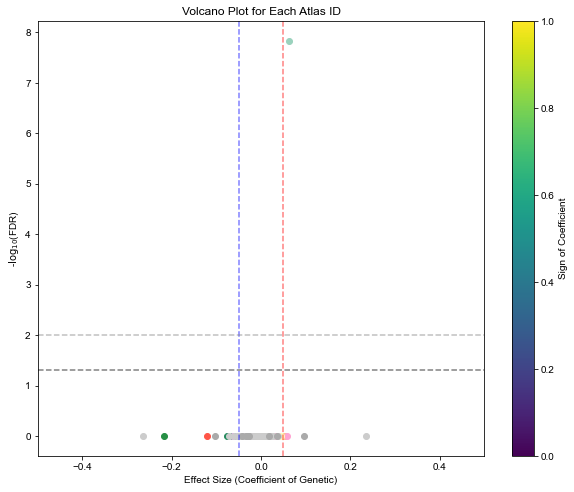

In [572]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    #try:
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # pdfClusterを実行
    r_code = '''
    library(MASS)
    model <- glm.nb('log_All_cell_count ~ Age', data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
    c(coef, p_value)
    '''
    #results_ <- summary(model)
    #results_ <- summary(model)
    #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
    #coef <- summary(model)$Coefficients["Genetic", "coef"]
    ro.r(r_code)

    results = ro.r(r_code)

    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    #except:
    #    coef, p_value = 0.0, 1.0
    #    print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4.csv" #"/Regional_cellome4_WM_mask_ver1_volume_revised.csv"

            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1


def normalize_and_calculate_difference(data):
    # atlasIDごとにループ
    for atlas_id in data['atlasID'].unique():
        # 各年齢、各ジェネティックタイプに対して正規化を実行
        for age in data['Age'].unique():
            avg_ctr = data[(data['atlasID'] == atlas_id) & (data['Genetic'] == 0) & (data['Age'] == age)]['NeuN+ density (/mm3)'].mean()
            
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0)]['NeuN+ density (/mm3)'] - avg_ctr 
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1)]['NeuN+ density (/mm3)'] - avg_ctr
        #mini = data.loc[(data['atlasID'] == atlas_id), 'Normalized'].min()
        #data.loc[(data['atlasID'] == atlas_id),'Normalized'] = data.loc[(data['atlasID'] == atlas_id),'Normalized'].copy() - mini
    return data

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000
    #data['log_All_cell_count'] = np.round(data['NeuN_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd


0
0


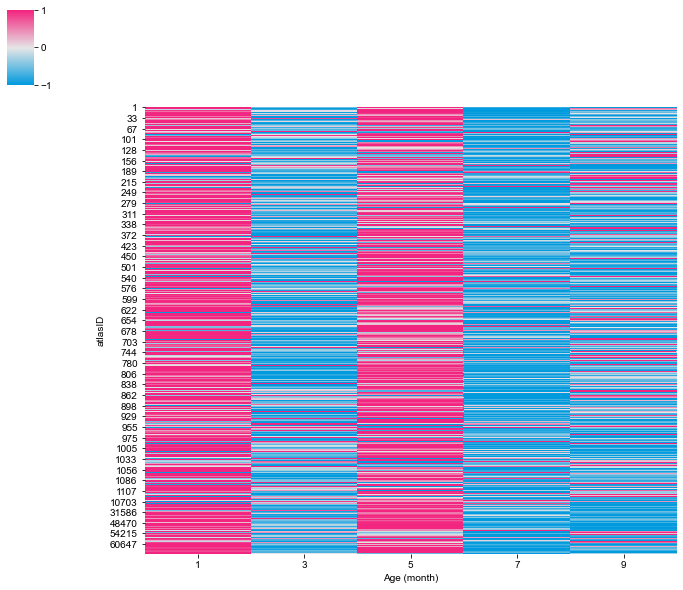

In [573]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
column_order = ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("WT_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# Move atlasID to the left side
clustergrid.ax_heatmap.yaxis.tick_left()  # Move y-axis labels to the left
clustergrid.ax_heatmap.yaxis.set_label_position("left")  # Set the y-axis label position to left

# PDFとして図を保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_Microglia_gradient_heatmap.pdf', 
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [574]:
# CSVファイルとして保存
data_pivot.to_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Neuron_ratio_all.csv', index=True)

Start time: 2024-10-02 20:39:59.856361
0      0.576241
1      0.432881
2      0.484603
3      0.514898
4      0.627200
         ...   
666    0.525406
667    0.426220
668    0.526153
669    0.347427
670    0.531678
Name: dpt_pseudotime, Length: 671, dtype: float32


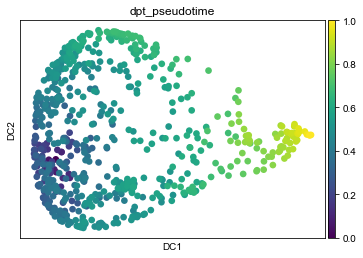

End time after X: 2024-10-02 20:40:00.346438
Duration for UMAP: 0:00:00.490077


In [575]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Neuron_ratio_all.csv', index_col='atlasID')

# 欠損値を各列の平均値で埋める
data_pivot = X#.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = data_pivot.apply(zscore, axis=1).fillna(0)

# 各行がリストになっているので、それを展開して2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定
adata.uns['iroot'] = 240 #597 #532 #634

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()


# 実行時間の計測
end_time1 = datetime.datetime.now()
print("End time after X:", end_time1)
print("Duration for UMAP:", end_time1 - start_time)


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


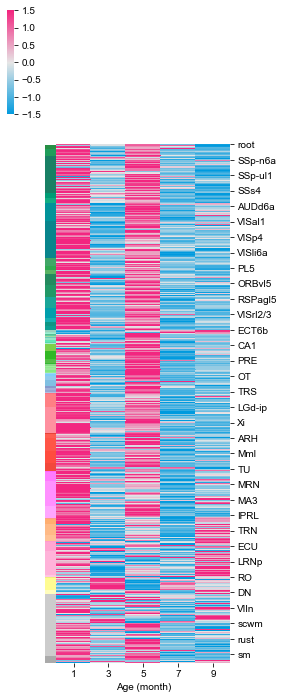

In [576]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df, cmap=cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


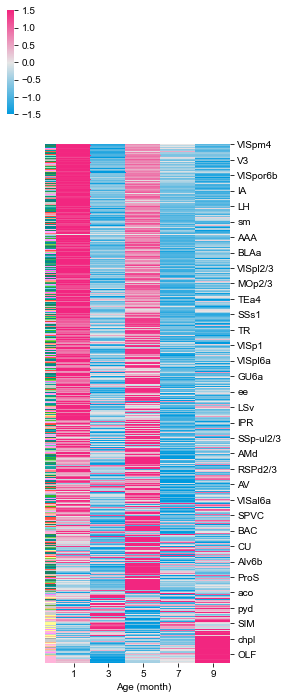

In [577]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


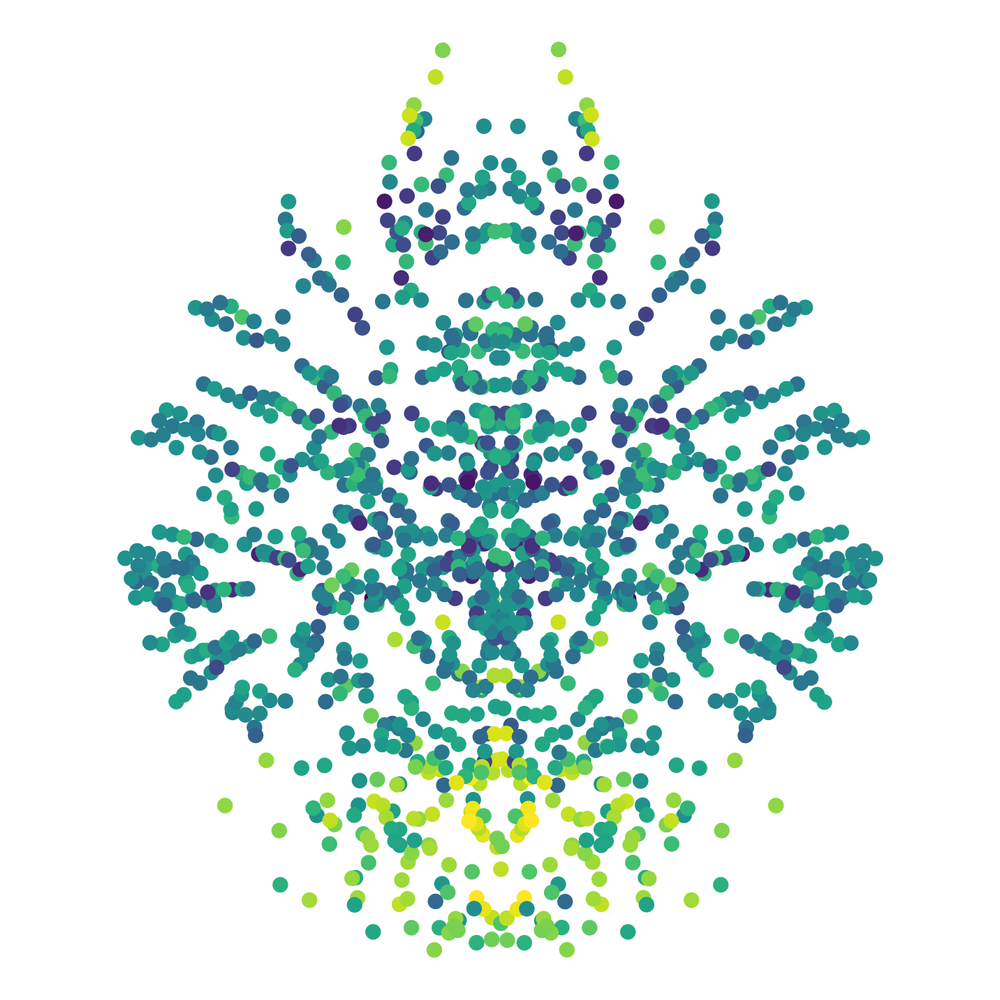

In [578]:
# atlasID が適切に設定されていることを確認する
# adata.obs に atlasID が含まれていることを前提にします
if 'atlasID' not in adata.obs.columns:
    adata.obs['atlasID'] = data_normalized.index

# pseudotime_df を adata.obs から作成し、インデックスを atlasID にする
pseudotime_df = pd.DataFrame(adata.obs[['atlasID', 'dpt_pseudotime']])

# pseudotime_df のインデックスを data_normalized のインデックス（atlasID）に基づいて設定
pseudotime_df = pseudotime_df.set_index('atlasID')

# data_normalized のインデックスに対応して pseudotime の値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['dpt_pseudotime'])

# pseudotime が NaN の場合は 0 で補完（必要に応じて）
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridis_rカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
#plt.title('Centroids of Left and Right Brain with Pseudotime Coloration')
#plt.xlabel('X (um)')
#plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.colorbar(sc, label='Pseudotime from Abeta PCA')  # カラーバーを追加
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Whole_brain_plot_of_Regional_Abeta_psedotime.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


In [655]:
np.where(X.index == 614)

(array([300]),)

Start time: 2024-10-02 21:07:05.312506
0       0.695438
1       0.574370
2       0.673746
3       0.571120
4       0.745510
          ...   
1337    0.698916
1338    0.672495
1339    0.682921
1340    0.610099
1341    0.655125
Name: dpt_pseudotime, Length: 1342, dtype: float32


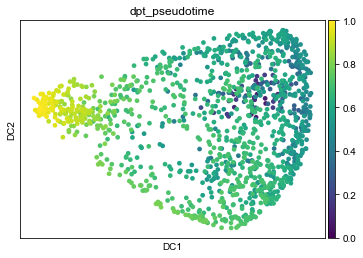

T-test p-value for pseudotime comparison: 7.661686536180634e-15
WT mean pseudotime: 0.595250184718525
APP mean pseudotime: 0.6604542455978791


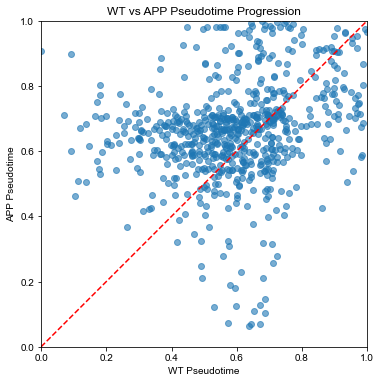

End time: 2024-10-02 21:07:06.643782
Total duration: 0:00:01.331276


In [661]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc
import matplotlib.pyplot as plt
from scipy.stats import ttest_rel

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Neuron_ratio_all.csv', index_col='atlasID')
X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Neuron_ratio_all.csv', index_col='atlasID')

# 列名を修正して、WTとAPPの違いをなくし、時間ベースで統一する
X.columns = ['1m', '3m', '5m', '7m', '9m']
X2.columns = ['1m', '3m', '5m', '7m', '9m']

# WTとAPPのデータを結合（行方向に）
combined_data = pd.concat([X, X2], axis=0, keys=['WT', 'APP'])

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = combined_data.apply(zscore, axis=1).fillna(0)

# 各行を2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定（適切なセルインデックスを設定）
adata.uns['iroot'] = 240#597+671  # 適切なセルをルートとして設定

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# pseudotimeを取得
pseudotime = adata.obs['dpt_pseudotime'].values
# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()
# pseudotimeをcombined_dataに追加
combined_data['pseudotime'] = pseudotime

# WTとAPPの行インデックスを取得
wt_indices = combined_data.index.get_level_values(0) == 'WT'
app_indices = combined_data.index.get_level_values(0) == 'APP'

# WTとAPPに分割してpseudotimeを割り当てる
combined_data['WT_pseudotime'] = np.nan
combined_data['APP_pseudotime'] = np.nan
combined_data.loc[wt_indices, 'WT_pseudotime'] = combined_data.loc[wt_indices, 'pseudotime']
combined_data.loc[app_indices, 'APP_pseudotime'] = combined_data.loc[app_indices, 'pseudotime']

# WTとAPPの領域ごとのpseudotimeを比較する
# NaNを除外して比較
wt_pseudotime_clean = combined_data['WT_pseudotime'].dropna()
app_pseudotime_clean = combined_data['APP_pseudotime'].dropna()

# Wilcoxon signed-rank test to compare pseudotime progression
stat, p_val = ttest_rel(wt_pseudotime_clean, app_pseudotime_clean)
print(f'T-test p-value for pseudotime comparison: {p_val}')

# APPとWTのpseudotimeの平均値を計算
wt_mean = wt_pseudotime_clean.mean()
app_mean = app_pseudotime_clean.mean()
print(f'WT mean pseudotime: {wt_mean}')
print(f'APP mean pseudotime: {app_mean}')

# Scatter plot to visualize pseudotime progression
plt.figure(figsize=(8,6))
plt.scatter(wt_pseudotime_clean, app_pseudotime_clean, alpha=0.6)
plt.plot([0, 1], [0, 1], 'r--')  # 0-1の範囲でプロット
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('WT Pseudotime')
plt.ylabel('APP Pseudotime')
plt.title('WT vs APP Pseudotime Progression')
plt.gca().set_aspect('equal', adjustable='box')  # 等方的にプロット
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_comparison_scatter.pdf', dpi=300, bbox_inches='tight')
plt.show()

# 実行時間の計測
end_time = datetime.datetime.now()
print("End time:", end_time)
print("Total duration:", end_time - start_time)

               1m        3m        5m        7m        9m
atlasID                                                  
1        1.088172  0.841190  0.292687 -1.637269 -0.584779
2        1.000245 -0.524864  1.388590 -0.760735 -1.103236
6        0.629216  0.646925  1.031546 -0.674897 -1.632790
7        1.500897 -0.967603  0.087942 -1.207934  0.586699
9       -0.159669 -0.802976  1.727182 -1.108327  0.343790


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


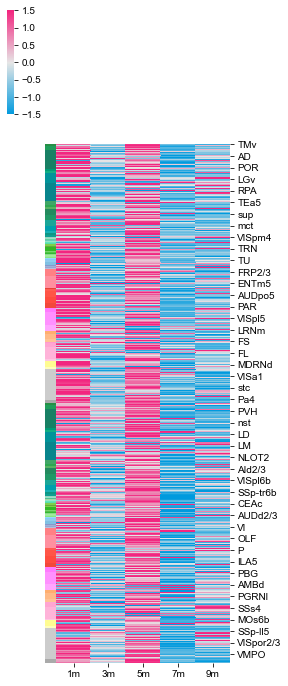

In [662]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Neuron_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Neuron_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0 (or handle them as needed)
combined_normalized = combined_normalized.fillna(0)

# Verify that combined_normalized is now a proper DataFrame with numeric values
print(combined_normalized.head())


sorted_index = data_GO['id'].drop_duplicates()

# Generate color list from data_GO
colorlist = [(row['R'] / 255, row['G'] / 255, row['B'] / 255) for idx, row in data_GO.iterrows()]

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap
g = sns.clustermap(
    combined_normalized,
    cmap=create_custom_cmap(),
    row_colors=colorlist * 2,  # Assuming you need to apply the same color list for both WT and APP
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')
# Adjust layout to ensure proper display
plt.tight_layout()

# Show the heatmap
plt.show()

/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd


               1m        3m        5m        7m        9m
atlasID                                                  
1        1.088172  0.841190  0.292687 -1.637269 -0.584779
2        1.000245 -0.524864  1.388590 -0.760735 -1.103236
6        0.629216  0.646925  1.031546 -0.674897 -1.632790
7        1.500897 -0.967603  0.087942 -1.207934  0.586699
9       -0.159669 -0.802976  1.727182 -1.108327  0.343790


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:66: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


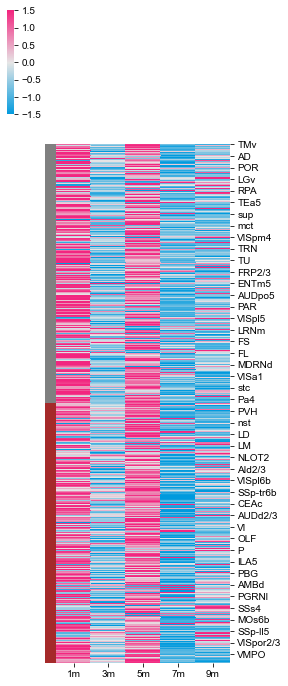

In [663]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Neuron_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Neuron_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0 (or handle them as needed)
combined_normalized = combined_normalized.fillna(0)

# Verify that combined_normalized is now a proper DataFrame with numeric values
print(combined_normalized.head())

# Create a color mapping for WT (gray) and APP (brown)
row_colors = ['gray'] * len(X_wt_normalized) + ['brown'] * len(X_app_normalized)

# Custom colormap for heatmap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap
g = sns.clustermap(
    combined_normalized,
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply WT (gray) and APP (brown) colors
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout to ensure proper display
plt.tight_layout()

# Show the heatmap
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


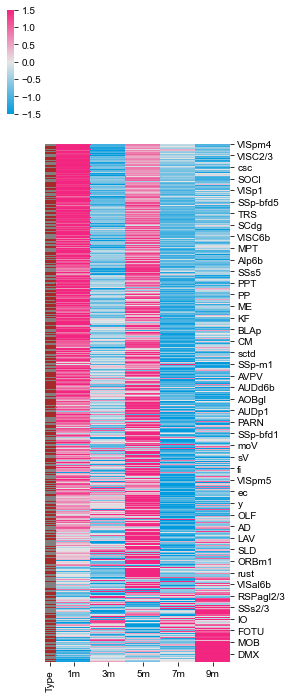

In [664]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Neuron_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Neuron_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)

# Generate WT/APP annotation colors based on the 'Type' column after sorting
row_colors = combined_normalized_sorted['Type'].map({'WT': 'gray', 'APP': 'brown'})

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply WT/APP color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


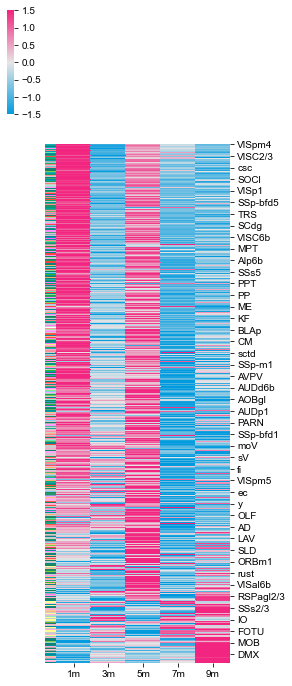

In [665]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Neuron_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Neuron_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data (assuming pseudotime calculation is already done)
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)



# Create a dictionary mapping atlasID (from combined_normalized_sorted) to colors from data_GO
id_to_color = {
    row['id']: (row['R'] / 255, row['G'] / 255, row['B'] / 255) 
    for idx, row in data_GO.iterrows()
}

# Generate the row_colors based on the region ID in the sorted data
row_colors = combined_normalized_sorted.index.map(lambda idx: id_to_color.get(idx, (0.5, 0.5, 0.5)))  # Default to gray if not found

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply region-based color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


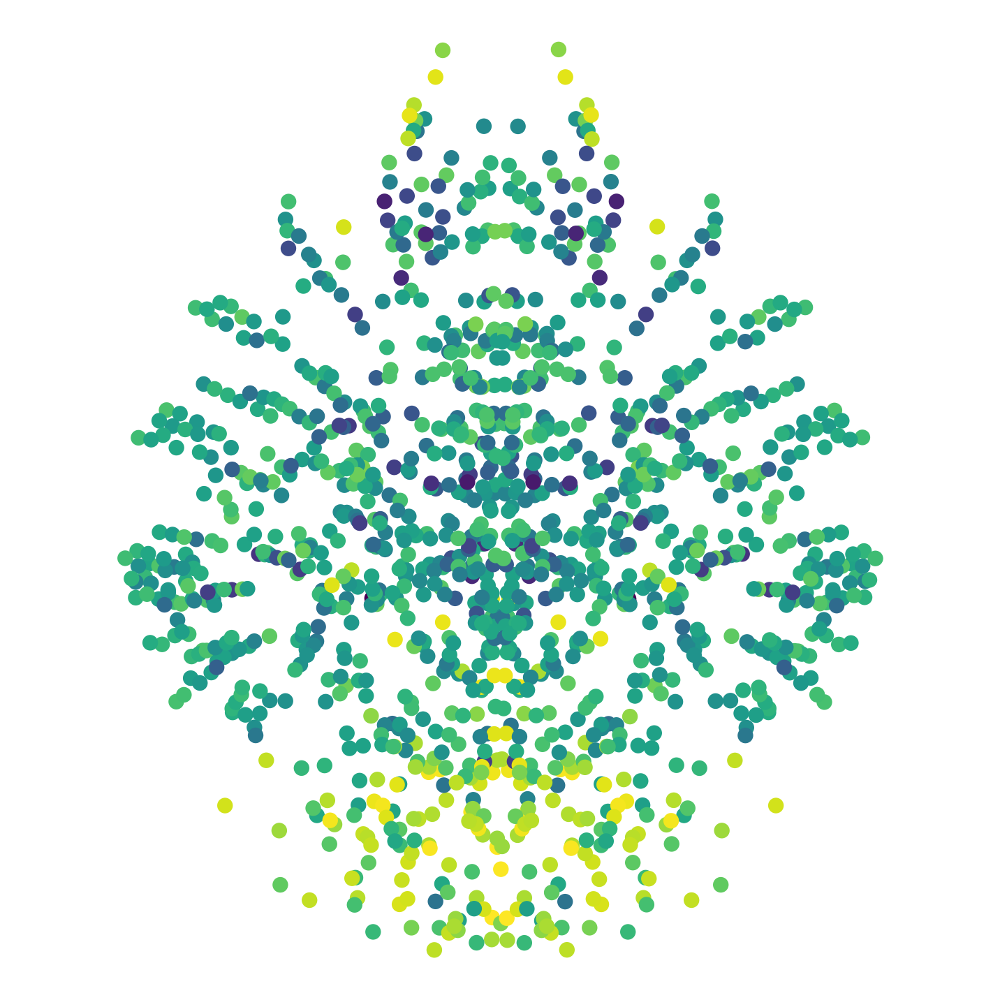

In [666]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# combined_normalizedからTypeがWTの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT']

# WTのpseudotimeを含むDataFrameを作成
pseudotime_df = pd.DataFrame(wt_data['pseudotime'])  # 'pseudotime'を使う
pseudotime_df['atlasID'] = wt_data.index.get_level_values('atlasID')  # 'atlasID'を取得
pseudotime_df.set_index('atlasID', inplace=True)  # インデックスをatlasIDに設定

# all_centroidsにおけるatlasIDに対応してpseudotimeの値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['pseudotime'])

# pseudotimeがNaNの場合は0で補完
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridisカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


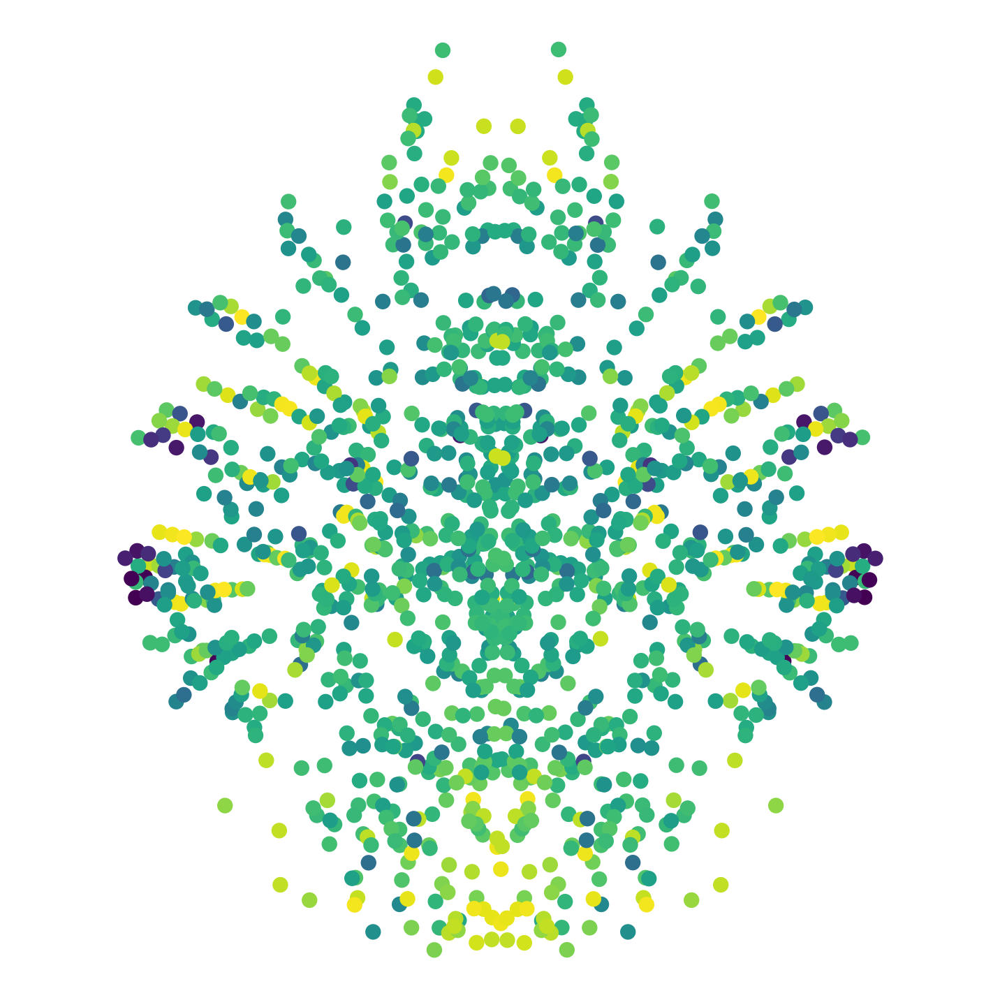

In [667]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# combined_normalizedからTypeがWTの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'APP']

# WTのpseudotimeを含むDataFrameを作成
pseudotime_df = pd.DataFrame(wt_data['pseudotime'])  # 'pseudotime'を使う
pseudotime_df['atlasID'] = wt_data.index.get_level_values('atlasID')  # 'atlasID'を取得
pseudotime_df.set_index('atlasID', inplace=True)  # インデックスをatlasIDに設定

# all_centroidsにおけるatlasIDに対応してpseudotimeの値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['pseudotime'])

# pseudotimeがNaNの場合は0で補完
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridisカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


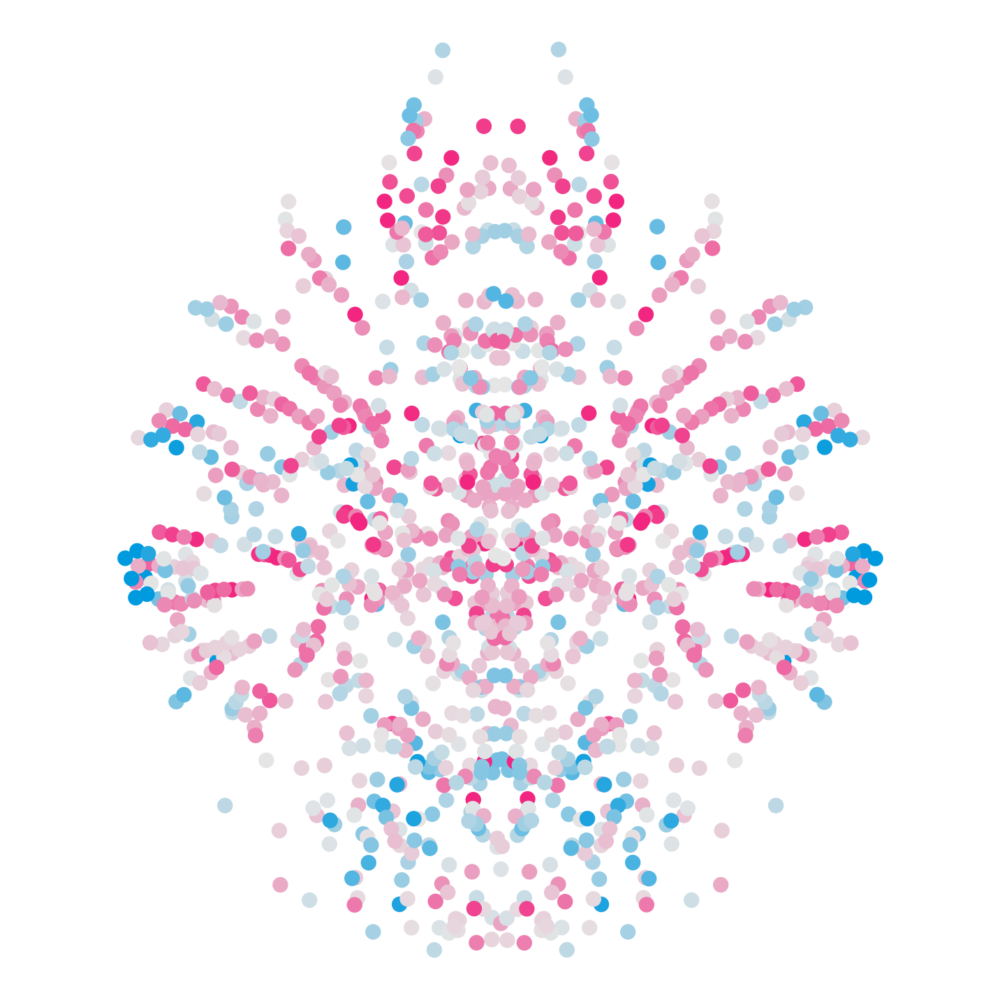

In [668]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

# combined_normalizedからTypeがWTとAPPの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT'] 
app_data = combined_normalized[combined_normalized['Type'] == 'APP'] 

# WTとAPPのpseudotimeを含むDataFrameを作成
pseudotime_wt = pd.DataFrame(wt_data['pseudotime'])
pseudotime_wt['atlasID'] = wt_data.index.get_level_values('atlasID')
pseudotime_wt.set_index('atlasID', inplace=True)

pseudotime_app = pd.DataFrame(app_data['pseudotime'])
pseudotime_app['atlasID'] = app_data.index.get_level_values('atlasID')
pseudotime_app.set_index('atlasID', inplace=True)

# 差分を計算してall_centroidsにマッピング
all_centroids['pseudotime_diff'] = all_centroids['atlasID'].map(pseudotime_app['pseudotime']) - all_centroids['atlasID'].map(pseudotime_wt['pseudotime'])

# 差分がNaNの場合は0で補完
all_centroids['pseudotime_diff'] = all_centroids['pseudotime_diff'].fillna(0)

# カスタムカラーマップを作成
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# カラーマップの生成
custom_cmap = create_custom_cmap()

# 色の範囲を設定
vmin = -0.5#all_centroids['pseudotime_diff'].min()  # 最小値を設定
vmax = 0.5 #all_centroids['pseudotime_diff'].max()  # 最大値を設定

# 差分に基づいて色を生成
norm = plt.Normalize(vmin=vmin, vmax=vmax)
all_centroids['colors'] = all_centroids['pseudotime_diff'].apply(lambda x: custom_cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

# カラーバーを追加
#cbar = plt.colorbar(sc, cmap=custom_cmap)  # カスタムカラーマップを使用
cbar.set_label('Pseudotime Difference (APP - WT)')  # カラーバーのラベルを設定
cbar.set_ticks([vmin, 0, vmax])  # カラーバーの目盛りを設定
cbar.ax.invert_yaxis()  # カラーバーのY軸を反転

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


100


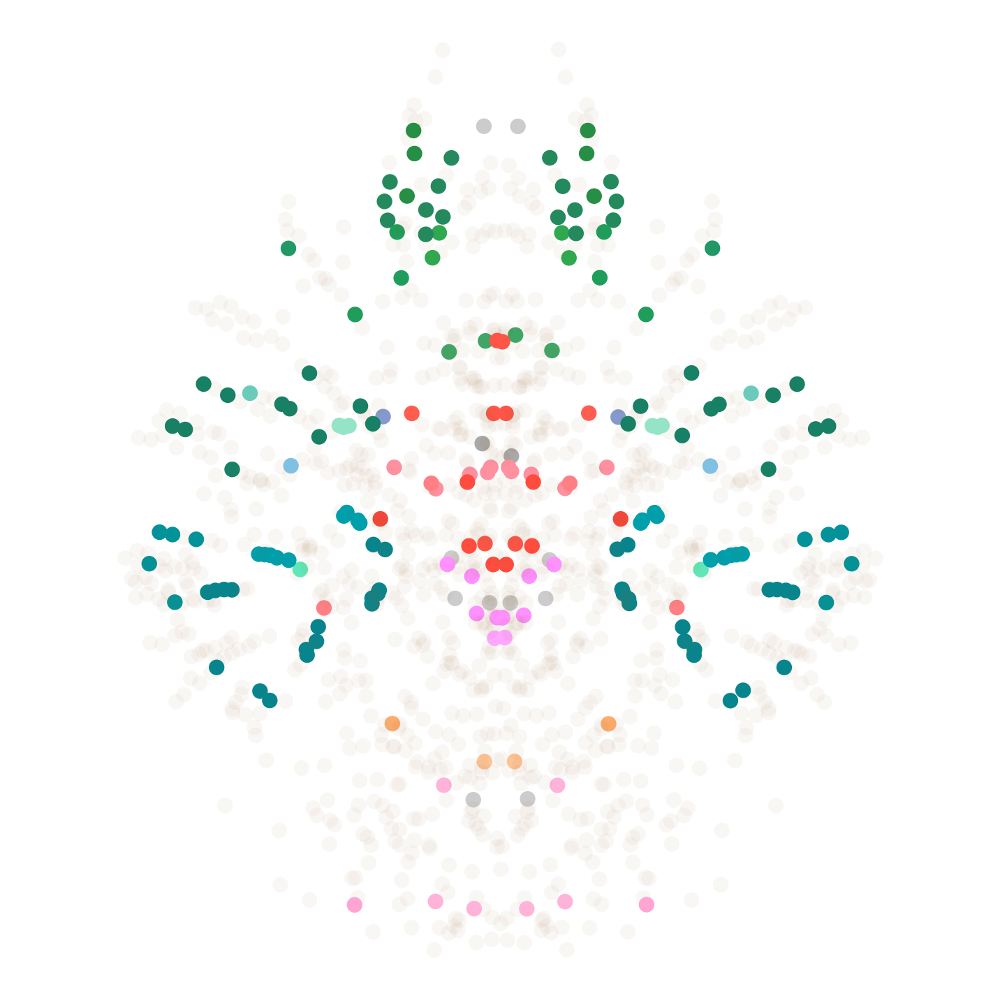

In [669]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

# combined_normalizedからTypeがWTとAPPの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT'] 
app_data = combined_normalized[combined_normalized['Type'] == 'APP'] 

# WTとAPPのpseudotimeを含むDataFrameを作成
pseudotime_wt = pd.DataFrame(wt_data['pseudotime'])
pseudotime_wt['atlasID'] = wt_data.index.get_level_values('atlasID')
pseudotime_wt.set_index('atlasID', inplace=True)

pseudotime_app = pd.DataFrame(app_data['pseudotime'])
pseudotime_app['atlasID'] = app_data.index.get_level_values('atlasID')
pseudotime_app.set_index('atlasID', inplace=True)

# 差分を計算してall_centroidsにマッピング
all_centroids['pseudotime_diff'] = all_centroids['atlasID'].map(pseudotime_app['pseudotime']) - all_centroids['atlasID'].map(pseudotime_wt['pseudotime'])

# 差分がNaNの場合は0で補完
all_centroids['pseudotime_diff'] = all_centroids['pseudotime_diff'].fillna(0)

# 上位100のregionを選択
top_100 = all_centroids.nlargest(200, 'pseudotime_diff')
print(len(np.unique(top_100["atlasID"])))

def get_color(row, data_GO, top_100_ids):
    atlas_id = row['atlasID']
    if atlas_id in top_100_ids:
        color_row = data_GO[data_GO['id'] == atlas_id]
        if not color_row.empty:
            return [
                color_row['R'].values[0] / 255,
                color_row['G'].values[0] / 255,
                color_row['B'].values[0] / 255,
                1.0  # 完全不透明
            ]
    return [0.6, 0.4, 0.2, 0.05]  # default color with low alpha if no match found or not in top_100

# top_100のatlasIDをセットとして取得
top_100_ids = set(top_100['atlasID'])

# Apply colors to all rows based on atlasID, only modifying those in top_100
all_centroids['colors'] = all_centroids.apply(lambda row: get_color(row, data_GO, top_100_ids), axis=1)


# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=np.vstack(all_centroids['colors']), edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


In [ ]:
# Total cell

#4_APPmodel_APP1m_1_2022_1102_1304
#4_APPmodel_APP1m_2_2022_1106_1708
#4_APPmodel_APP1m_3_2022_1213_2151
#4_APPmodel_APP1m_4_2023_0417_2052
#5_APPmodel_APP3m_2_2023_0123_1645
#5_APPmodel_APP3m_3_2023_0212_2217
#5_APPmodel_APP3m_4_2023_0214_2027
#4_APPmodel_APP3m_5_2023_0502_1423
#4_APPmodel_APP5m_1_2022_1024_1336
#4_APPmodel_APP5m_2_2022_1027_1333
#4_APPmodel_APP5m_3_2022_1030_1257
#4_APPmodel_APP5m_4_2023_0509_1021
#5_APPmodel_APP7m_2_2023_0315_1540
#5_APPmodel_APP7m_3_2023_0310_1401
#5_APPmodel_APP7m_4_2023_0317_1630
#5_APPmodel_APP7m_5_2023_0520_1723
#5_APPmodel_APP9m_1_2023_0117_1352
#5_APPmodel_APP9m_2_2023_0327_1425
#5_APPmodel_APP9m_3_2023_0329_1611
#5_APPmodel_APP9m_4_2023_0403_1443
997
Coefficient: -0.00535571012855395, p-value: 0.8653555695407262
68
Coefficient: -0.01708669745253153, p-value: 0.942739947270955
667
Coefficient: -0.002106188866207108, p-value: 0.9893739750334972
52192


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.001115768504336677, p-value: 0.9936502642782451
52196
Coefficient: -0.005616692335178011, p-value: 0.9782316949342645
52264
Coefficient: 0.019489870345898136, p-value: 0.9925482827377167
320
Coefficient: 0.0026680429215820522, p-value: 0.9723909299120524
943
Coefficient: -0.0025835114053428163, p-value: 0.939893558806499
648
Coefficient: 0.007376516528433719, p-value: 0.8459031934814925
844


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004066604691919185, p-value: 0.9083076371277932
882
Coefficient: 0.012581988049428935, p-value: 0.9287468341152438
656
Coefficient: -0.009132304832281172, p-value: 0.876127326134501
962
Coefficient: -0.011080501685270708, p-value: 0.7587099760655506
767
Coefficient: 0.0029463277841773887, p-value: 0.9307828836611638
1021


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003963387752770397, p-value: 0.9194345844516472
1085
Coefficient: 0.016354920647110097, p-value: 0.93757544229701
558
Coefficient: 0.008403563724264589, p-value: 0.9419420756768689
838
Coefficient: 0.0032376863140243153, p-value: 0.9678147234400691
654
Coefficient: 0.004307045630530517, p-value: 0.9529882117801245
702
Coefficient: 0.006416566020307837, p-value: 0.9445515180165732
889


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/p

Coefficient: 0.007101007728327717, p-value: 0.9174677630995344
929
Coefficient: 0.010453230711265523, p-value: 0.9719108358608274
981
Coefficient: 0.0003552508468475629, p-value: 0.9961322736061953
201
Coefficient: 0.0030119746229728766, p-value: 0.9481686807388198
1047
Coefficient: 0.007946583431987946, p-value: 0.8708588173052676
1070
Coefficient: 0.006423383621521767, p-value: 0.9108602060154444
1038
Coefficient: 0.008246145746675822, p-value: 0.8719075693602278
1062


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/p

Coefficient: 0.016522183482891355, p-value: 0.9224332364562358
1030
Coefficient: 0.008551298735507301, p-value: 0.9546613572587772
113
Coefficient: -0.0017487292057156963, p-value: 0.9816731418830345
1094
Coefficient: 0.0043106963658616085, p-value: 0.9675463665579663
1128
Coefficient: 0.00207565549545474, p-value: 0.9801601572524988
478
Coefficient: 0.006680697414877646, p-value: 0.9348136093036893
510
Coefficient: 0.01211654002904195, p-value: 0.9670025258975977
878
Coefficient: 0.0043975184063290255, p-value: 0.9579379279123252
657


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003691630490943089, p-value: 0.9439722597859562
950
Coefficient: 0.007443949268622833, p-value: 0.89302846551452
974
Coefficient: 0.006053622400538545, p-value: 0.9185809472524342
1102
Coefficient: 0.006628011295669272, p-value: 0.8876353467898395
2
Coefficient: 0.013052074217247965, p-value: 0.9433114422263058
450
Coefficient: 0.0016938377265505143, p-value: 0.9878969619720949
854
Coefficient: 0.00013645655244824456, p-value: 0.9982943406718091
577
Coefficient: 0.0035451057347722754, p-value: 0.9631576758467302
625


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0018802115699099334, p-value: 0.9797760311426194
945
Coefficient: 0.0059964866714565645, p-value: 0.9229617579000199
1026
Coefficient: 0.009477799294586342, p-value: 0.9666063645704207
1006
Coefficient: -0.0009473910120730148, p-value: 0.9947534249305353
670
Coefficient: 0.002498247486132583, p-value: 0.9767138010066791
1086
Coefficient: 0.004307901817269145, p-value: 0.9788418375586501
1111
Coefficient: 0.00465818628809722, p-value: 0.9650959391077016
9
Coefficient: 0.008412238269237286, p-value: 0.9452464559549888
461


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.014924439524009368, p-value: 0.9648239912154138
18693
Coefficient: -0.0008419726714807387, p-value: 0.9962125875902966
18697
Coefficient: 0.0066799687898010975, p-value: 0.9514469051506527
18701
Coefficient: 0.013795471451204072, p-value: 0.9182048744252729
18705
Coefficient: 0.008548204619488417, p-value: 0.949912828784067
18709
Coefficient: 0.009649424646884593, p-value: 0.9304125400851887
18713
Coefficient: 0.015005849826126131, p-value: 0.9701885043437569
873
Coefficient: 0.004202604641497866, p-value: 0.9489383544799976
806


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.001674138087921771, p-value: 0.9693652686465982
1035
Coefficient: 0.008718058175957699, p-value: 0.8819339319620605
1090
Coefficient: 0.0026725662918084354, p-value: 0.9553951771884267
862
Coefficient: -0.0010319373661867935, p-value: 0.982129613133001
893
Coefficient: -0.0005317198970596037, p-value: 0.9973128363207686
36
Coefficient: -0.0011538703058249014, p-value: 0.9955744915735875
180
Coefficient: -0.005828702026897537, p-value: 0.9579457524324212
148
Coefficient: 0.002631360220775391, p-value: 0.9886620361139028
187


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006238742592881956, p-value: 0.9510170241774442
638
Coefficient: -0.012098205332855487, p-value: 0.9014622736331526
662
Coefficient: -0.002356689226304259, p-value: 0.9940265267846479
897
Coefficient: -0.0013932886863087925, p-value: 0.9926744543967123
1106
Coefficient: -0.006864645731839519, p-value: 0.9420436458112763
1010
Coefficient: 0.0008497278532947712, p-value: 0.9960222161519218
1058
Coefficient: -0.009910322521481954, p-value: 0.9147233258287096
857
Coefficient: -0.014315642540839255, p-value: 0.8882928641488805
849


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009658542488778529, p-value: 0.975701839339344
527
Coefficient: 0.00474863755038535, p-value: 0.9750843958474226
600
Coefficient: 0.007243057466971861, p-value: 0.9431798001048186
678
Coefficient: 0.021001678099463596, p-value: 0.8896363974898689
252
Coefficient: 0.013119612781758128, p-value: 0.8999981868959732
156
Coefficient: 0.005084371767260057, p-value: 0.9714980973198116
243
Coefficient: 0.010427160574965556, p-value: 0.9784707639232727
735
Coefficient: 0.00461608322844109, p-value: 0.9652467371400819
251


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0010766510432752025, p-value: 0.9899442474190351
816
Coefficient: 0.0054185566783245065, p-value: 0.9630129074247056
847
Coefficient: -0.0013180347302567702, p-value: 0.9863198376892429
954
Coefficient: -0.0006755050204676358, p-value: 0.9953525975268123
1005
Coefficient: 0.005007623500883164, p-value: 0.986108161512247
696
Coefficient: -0.013878225200241082, p-value: 0.9469624602755512
643
Coefficient: -0.004651515799765125, p-value: 0.9760933494998477
759
Coefficient: 0.0022343071052004565, p-value: 0.991807820644293
791


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0009769192615105085, p-value: 0.9949167209332578
249
Coefficient: 0.0010003548463452493, p-value: 0.9961796888343725
456
Coefficient: 0.006378022180553748, p-value: 0.9893726133657192
959
Coefficient: -0.009756918181142948, p-value: 0.9451006551576266
755
Coefficient: -0.01821408728248404, p-value: 0.8611600121274309
990
Coefficient: -0.0190031365169337, p-value: 0.8925190459141312
1023
Coefficient: -0.019856291809544624, p-value: 0.8220223314884982
520
Coefficient: -0.007916974030977254, p-value: 0.9501242636236581
598


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004403568307240814, p-value: 0.9896611884516096
1074
Coefficient: -0.008546418762108548, p-value: 0.9672217305931218
905
Coefficient: 0.005446889505898191, p-value: 0.9680401669691677
1114
Coefficient: 0.014096013532950888, p-value: 0.9396229485721576
233
Coefficient: 0.008111455423733609, p-value: 0.9550627111456612
601
Coefficient: 0.008933867149422074, p-value: 0.9594051012430719
649
Coefficient: 0.014626654424147413, p-value: 0.9728755697202633
281
Coefficient: 0.023462222081755607, p-value: 0.8942208325358122
1066


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01499520385304029, p-value: 0.8967841248082041
401
Coefficient: 0.014335642867059989, p-value: 0.9449364252951102
433
Coefficient: 0.0004469146084902129, p-value: 0.9971311633201245
1046
Coefficient: -0.0008795420292292217, p-value: 0.9951592031456146
441
Coefficient: -0.0011755038799536304, p-value: 0.9974357818714118
421
Coefficient: -0.010526307755928986, p-value: 0.9518880768151667
973
Coefficient: -0.008447627533734675, p-value: 0.9407135740119473
573
Coefficient: 4.8260590212276115e-05, p-value: 0.9997269569981126
613


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009857650085444944, p-value: 0.9305748752122867
74
Coefficient: -0.004290399836037335, p-value: 0.9727261374460576
121
Coefficient: 0.001854036731356988, p-value: 0.995322795883927
593
Coefficient: -0.009057076554918773, p-value: 0.8790094649789952
821
Coefficient: -0.003328368164998941, p-value: 0.9347670160850534
721
Coefficient: 0.005486352533622786, p-value: 0.9191605401884537
778
Coefficient: -0.0029162079437993742, p-value: 0.9526379889849361
33
Coefficient: -0.0008641669760022282, p-value: 0.9872354960467838
305


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0017008277289178996, p-value: 0.9907981459555494
750
Coefficient: -0.023758356403154383, p-value: 0.8757535518337458
269
Coefficient: -0.018146397418864448, p-value: 0.896335775099698
869
Coefficient: -0.015083172208771369, p-value: 0.96704541306506
902
Coefficient: -0.004484729727085199, p-value: 0.9743306468445354
377
Coefficient: 0.002167827897777113, p-value: 0.9905012466859469
393
Coefficient: 0.006604219030250899, p-value: 0.991886269572466
805
Coefficient: 0.022196123595387075, p-value: 0.8884648089262841
41


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0022079908849186305, p-value: 0.9824814752575524
501
Coefficient: 0.0035291257501764957, p-value: 0.98262298889911
565
Coefficient: -0.006817073348377059, p-value: 0.9528450550837962
257
Coefficient: -0.003639296274837721, p-value: 0.9797610388697917
469
Coefficient: -0.0035512012376857807, p-value: 0.991717810838528
31578
Coefficient: -0.003549311067372332, p-value: 0.99024582206587
31582
Coefficient: -0.007677735618383626, p-value: 0.9655013197642139
31586
Coefficient: -0.0018289398263869612, p-value: 0.9941178978722549
31590


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011790937596495923, p-value: 0.9437442322826649
31594
Coefficient: -0.008065974426584356, p-value: 0.968197293669075
31598
Coefficient: -0.000748233752167992, p-value: 0.9987591534193374
31632
Coefficient: -0.004378945429793683, p-value: 0.9755533978071828
31636
Coefficient: -0.012175444097321403, p-value: 0.9091685943868633
31640
Coefficient: -0.022430015583888394, p-value: 0.9343779501174353
31644
Coefficient: -0.0125669206888788, p-value: 0.9166023468078508
31648
Coefficient: -0.007779986006570056, p-value: 0.9574192826445064
31652


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0017616138667777318, p-value: 0.9960791557002701
935
Coefficient: -0.0011552916706328298, p-value: 0.9914141069967894
211
Coefficient: -0.01651832827640253, p-value: 0.8349123760070115
1015
Coefficient: -0.00641985504719911, p-value: 0.9109664987684587
919
Coefficient: -0.000601641659600424, p-value: 0.99290296596018
927
Coefficient: 0.016003317381752546, p-value: 0.9644932558672265
588
Coefficient: -0.014736129803593657, p-value: 0.906130141917178
296
Coefficient: -0.014139542811197394, p-value: 0.8716087831924115
772


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0055773333353506685, p-value: 0.9255333758886681
810
Coefficient: -0.004582631784585012, p-value: 0.9602818779544168
819
Coefficient: 0.004713888127736212, p-value: 0.984470470216371
171
Coefficient: -0.025168789430595865, p-value: 0.8440957375964219
304
Coefficient: -0.022389632480137322, p-value: 0.8269740455147565
363
Coefficient: -0.016260301578571685, p-value: 0.8272493098860086
84
Coefficient: -0.0004461666504931487, p-value: 0.9960150109991075
132
Coefficient: 0.015454031744120841, p-value: 0.9671589551332684
707


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0038205142302794224, p-value: 0.9873254550419802
556
Coefficient: -0.024171020192168175, p-value: 0.9103349316346401
827
Coefficient: -0.024497339297099102, p-value: 0.8226211552451776
1054
Coefficient: -0.0061142405878316835, p-value: 0.960729389277142
1081
Coefficient: 0.011573747811450902, p-value: 0.983399867084364
448
Coefficient: 0.015684468271091163, p-value: 0.9232052641307228
412
Coefficient: 0.008892936793524169, p-value: 0.9242111573770123
630
Coefficient: 0.003203508426888262, p-value: 0.9615318438020731
440


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0022718060037172855, p-value: 0.9805201344298224
488
Coefficient: 0.00653478245029478, p-value: 0.9818227896151296
484
Coefficient: -0.00796877407629458, p-value: 0.965132566238581
582
Coefficient: -0.008233331250518847, p-value: 0.9498269360321114
620
Coefficient: -0.010315739783348626, p-value: 0.9160962358961181
910
Coefficient: -0.0024945653016313794, p-value: 0.9860744747304343
52977
Coefficient: 0.020168595752785585, p-value: 0.9832155478835183
969
Coefficient: 0.021771672652255374, p-value: 0.8911429831177513
288


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0032028992365580405, p-value: 0.9714427190187445
1125
Coefficient: -0.004226702457963987, p-value: 0.9598210419247919
608
Coefficient: -0.0030185743457638347, p-value: 0.9803292030201168
680
Coefficient: 0.007026906911085659, p-value: 0.9903079149904348
996
Coefficient: -0.011212687472592705, p-value: 0.9468910977219205
328
Coefficient: -0.006887302675912876, p-value: 0.9395489578751582
1101
Coefficient: -0.006170874043545092, p-value: 0.9289413147569163
783
Coefficient: -0.01060243697453213, p-value: 0.8898050242494018
831


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.003325097845611487, p-value: 0.991164616525274
120
Coefficient: 0.008699870831932733, p-value: 0.9562305004987928
163
Coefficient: -0.006450667988496615, p-value: 0.9409137393927476
344
Coefficient: 0.007816797263060234, p-value: 0.9348885164668009
314
Coefficient: -0.0034886719725191187, p-value: 0.9727652239591492
355
Coefficient: 0.001100154879862033, p-value: 0.9979655344393665
704
Coefficient: -0.028856934893947233, p-value: 0.8907745972580396
694
Coefficient: -0.005854697417692792, p-value: 0.9600550646138364
800


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0003700598922035108, p-value: 0.9969543755610157
675
Coefficient: 0.004654985756975472, p-value: 0.9764905671837714
699
Coefficient: 0.007991381914790197, p-value: 0.9944316130294902
671
Coefficient: 0.022628393772252224, p-value: 0.8053950686275653
965
Coefficient: 0.018105316404775793, p-value: 0.773139331212791
774
Coefficient: 0.0015174750060137463, p-value: 0.9822531299097781
906
Coefficient: -0.0018808429749568587, p-value: 0.9832421085934122
279
Coefficient: 0.003961151734393868, p-value: 0.9906821381164057
442


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.05530881191308094, p-value: 0.39820325306233434
434
Coefficient: 0.023951238747636494, p-value: 0.6335223700604563
610
Coefficient: -6.657407582764939e-05, p-value: 0.9989952682051857
274
Coefficient: -0.004864248220339769, p-value: 0.9407961471522382
330
Coefficient: 0.007249775944055627, p-value: 0.9845486895051582
542
Coefficient: -0.009200863958818117, p-value: 0.8587525886040339
430
Coefficient: -0.008916769109278102, p-value: 0.8342708204286609
687
Coefficient: -0.003120473773826971, p-value: 0.9428131183762112
590


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004459273555330036, p-value: 0.9492059736168013
622
Coefficient: 0.014276793335405854, p-value: 0.9616457872037144
31550
Coefficient: -0.00616440647101982, p-value: 0.9638168965376996
31554
Coefficient: 0.0019326986187143253, p-value: 0.9822788322067912
31558
Coefficient: 0.010730603974038423, p-value: 0.944352626294109
31562
Coefficient: 0.00450304057327642, p-value: 0.9661050874472028
31566
Coefficient: 0.006821066897404948, p-value: 0.954851388448499
31570
Coefficient: 0.008549828769935026, p-value: 0.9769162402391443
31604


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004578832456040778, p-value: 0.9763579089161685
31608
Coefficient: 0.01033005418854839, p-value: 0.9225945850518116
31612
Coefficient: 0.01624279769000862, p-value: 0.9219902574705555
31616
Coefficient: 0.013236612020944304, p-value: 0.9167835518095124
31620
Coefficient: 0.014759226039218608, p-value: 0.918575440798303
31624
Coefficient: 0.013195110858688193, p-value: 0.9701501391604151
97
Coefficient: -0.03899697865478022, p-value: 0.7371766516266351
1127
Coefficient: -0.02718039591264348, p-value: 0.7267278230870291
234


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02728288492875991, p-value: 0.8257103436591564
289
Coefficient: -0.026709246013663018, p-value: 0.713544695523805
729
Coefficient: -0.008543334321371844, p-value: 0.9248423369625377
786
Coefficient: 0.0017504355870767117, p-value: 0.9940699417659338
540
Coefficient: -0.018817355238540195, p-value: 0.9222508685798358
888
Coefficient: -0.011452664808697808, p-value: 0.9308325773398471
692
Coefficient: -0.002083637950118736, p-value: 0.9920882921184956
335
Coefficient: -0.013723063871363152, p-value: 0.96610922975299
368


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009316306731635747, p-value: 0.9881966781130117
836
Coefficient: -0.02049958991619436, p-value: 0.9106351139654068
427
Coefficient: -0.016107832509704822, p-value: 0.8793126345353367
988
Coefficient: -0.015023650817301053, p-value: 0.8880534302748991
977
Coefficient: -0.005498894059019349, p-value: 0.9607027218586869
1045
Coefficient: 0.0046432534654352285, p-value: 0.9869913163624111
698
Coefficient: -0.030619160635960253, p-value: 0.2354097876832899
507
Coefficient: 0.0013030413573438412, p-value: 0.8925964375450889
188


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.02158725645164278, p-value: 0.86793417920028
196
Coefficient: -0.017012184445820016, p-value: 0.8138588573675339
204
Coefficient: -0.010755685851197443, p-value: 0.9035836313482531
159
Coefficient: -0.0019529453262855845, p-value: 0.9465005254938019
597
Coefficient: -0.0061604569116277775, p-value: 0.9423237037701332
605
Coefficient: 0.0003721527477425902, p-value: 0.9965694558538102
814
Coefficient: 0.002237661258871303, p-value: 0.9806924141108281
961
Coefficient: -0.00013953461561880812, p-value: 0.9948439262683566
260


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00425165401313964, p-value: 0.9870648782226837
268
Coefficient: -0.01287479275479945, p-value: 0.937522228132327
1139
Coefficient: -0.0028996449257031112, p-value: 0.9911313159072336
639
Coefficient: -0.00377784494041384, p-value: 0.9596011613509444
655
Coefficient: -0.00140555656296404, p-value: 0.983252926129106
663
Coefficient: -0.001077276605163791, p-value: 0.9839119623468227
788
Coefficient: 0.000530754256506775, p-value: 0.9946185357608904
566
Coefficient: -0.001089563626882276, p-value: 0.9868412603228597
1089


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004582339641592803, p-value: 0.9608676114798391
382
Coefficient: 0.0016436327849860162, p-value: 0.9425299813561274
423
Coefficient: 0.0055119172684966345, p-value: 0.9638306300720949
463
Coefficient: 0.0029091685681415513, p-value: 0.9186474718099158
10703
Coefficient: -0.007334809140097128, p-value: 0.845615439982244
10704
Coefficient: -0.018544782629716376, p-value: 0.725138382839537
632


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00038886468344387484, p-value: 0.9883448210408875
982
Coefficient: -0.025013668697994127, p-value: 0.9162331084515464
19
Coefficient: 0.0022284290934539, p-value: 0.9902629586979536
1121
Coefficient: -0.014799381175540338, p-value: 0.8803943145998725
20
Coefficient: -0.0019683896130697834, p-value: 0.9735787414856046
52
Coefficient: 0.0036302316577796903, p-value: 0.9575311648411401
139
Coefficient: 0.0035965239020701706, p-value: 0.9588628762229484
28
Coefficient: 0.00033394278311377234, p-value: 0.9960034473431607
526


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.04044095542581119, p-value: 0.591409555432612
543
Coefficient: -0.026352563893016802, p-value: 0.6893179230236937
664
Coefficient: -0.017087094448137292, p-value: 0.8084127804817528
727
Coefficient: -0.006292272271106886, p-value: 0.929896021692937
743
Coefficient: -0.003103412252839494, p-value: 0.9671986428976379
843
Coefficient: -0.009996205333549222, p-value: 0.8805930253843657
1037
Coefficient: -0.003350508486938228, p-value: 0.9457241537227815
1084
Coefficient: 0.004302595213615385, p-value: 0.9386679498666819
502


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0006042143883498233, p-value: 0.9879704175588425
48470
Coefficient: 0.004963299431213931, p-value: 0.9319055148027657
58447
Coefficient: -0.016966940010477476, p-value: 0.8407796397717656
48508
Coefficient: -0.015193938139920865, p-value: 0.8785494329300715
703
Coefficient: 0.005292014812799578, p-value: 0.9606711938056486
583
Coefficient: -0.011127094850580464, p-value: 0.8955086997470134
952
Coefficient: 0.010013413327948174, p-value: 0.8383180617151109
966
Coefficient: 0.014204547994244674, p-value: 0.8579194961041008
131


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.000659211388748514, p-value: 0.9920757580081944
303
Coefficient: 0.002473668475039344, p-value: 0.975233025764213
311
Coefficient: 0.001277671732179645, p-value: 0.9874548462069365
451
Coefficient: 0.01150724481718227, p-value: 0.9321492907867988
327
Coefficient: -0.0011707989761557563, p-value: 0.9863923187847121
334
Coefficient: -0.00011292263542354867, p-value: 0.9988429117559507
780
Coefficient: -0.01228820038799669, p-value: 0.8212100663215143
477
Coefficient: 0.001393676409066017, p-value: 0.9707188769555739
672


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0049253164810167125, p-value: 0.6818983680564283
56
Coefficient: -0.0020843265030255353, p-value: 0.9338236118433226
998
Coefficient: 0.0037269452806182137, p-value: 0.9684387668420043
754
Coefficient: -0.008687660298650141, p-value: 0.7775891928072071
250
Coefficient: -0.005393376732984955, p-value: 0.9524575526540957
258
Coefficient: -0.0030351272172897898, p-value: 0.9454997511468108
266
Coefficient: -0.0012484686195340419, p-value: 0.9862815112006674
310
Coefficient: 0.0021893428077965345, p-value: 0.9814888120701343
333


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004434892073377322, p-value: 0.9885705388242189
23
Coefficient: -0.0021591423340673577, p-value: 0.9810734647595983
292
Coefficient: 0.01411075207246468, p-value: 0.9765550131231002
544
Coefficient: 0.0003411358073967377, p-value: 0.9976353038615814
551
Coefficient: 0.0012985900066038122, p-value: 0.9914123298353273
559
Coefficient: 0.00634713439542571, p-value: 0.9305952777480352
1105
Coefficient: -0.002614960948302494, p-value: 0.98173024409424
403
Coefficient: -0.0035930205818134843, p-value: 0.9342046014283443
803


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.007059414908135141, p-value: 0.9080462093295173
1022
Coefficient: 0.014611797022519104, p-value: 0.7901844348300451
1031
Coefficient: 0.01596527752684262, p-value: 0.8786464841827294
342
Coefficient: 0.009358269987765656, p-value: 0.8042802616196147
298
Coefficient: -0.0026060244780823773, p-value: 0.9795277488029236
564
Coefficient: 0.0021152206308388518, p-value: 0.9851714437674886
596
Coefficient: -0.0017827588801773652, p-value: 0.9821984884362522
581
Coefficient: 0.0039046094946738586, p-value: 0.9687618224728567
351


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0029876333558446692, p-value: 0.955024243094644
287
Coefficient: 0.0059310852363672045, p-value: 0.9935830396775774
549
Coefficient: -0.0032890463906073233, p-value: 0.9602506881255779
629
Coefficient: -0.0037453428211814536, p-value: 0.9592168348317354
685
Coefficient: 0.0024046660015123993, p-value: 0.9727198470734612
718
Coefficient: 0.004729181258227826, p-value: 0.9463517806639145
725
Coefficient: -0.002556910820770257, p-value: 0.9909583551377261
733
Coefficient: 0.004556877891971278, p-value: 0.9294121039055138
741


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011718322519757855, p-value: 0.9318434310429264
56435
Coefficient: -0.011736153154764303, p-value: 0.9201406841303758
414
Coefficient: -0.0021382613495292088, p-value: 0.9920546626131386
422
Coefficient: -0.005681783079212645, p-value: 0.9726517594892437
609
Coefficient: -0.003574667971987005, p-value: 0.9842188544068498
1044
Coefficient: -0.005372714352614995, p-value: 0.9818198377490115
1072
Coefficient: -0.0031494161642527875, p-value: 0.9822082234583556
1079
Coefficient: 0.004787976238408484, p-value: 0.9656222371108186
1088


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011777988716346695, p-value: 0.9279729114722091
49664
Coefficient: 0.005092529235058823, p-value: 0.9708400257479354
49668
Coefficient: 0.0016186174667466038, p-value: 0.9874791293127324
49672
Coefficient: 0.00021060448780447984, p-value: 0.9991702571674159
218
Coefficient: 0.002571040286139974, p-value: 0.9666767922975561
1020
Coefficient: -0.005293851865597159, p-value: 0.9334740521424757
1029
Coefficient: -0.007453348478427585, p-value: 0.9545827078372836
325


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.017160858741671555, p-value: 0.9055962043493102
56551
Coefficient: -0.003907941704918834, p-value: 0.9771363739016398
255
Coefficient: -0.012380046370690463, p-value: 0.8883211129356583
1096
Coefficient: -0.012679472486911031, p-value: 0.9219639034967507
1104
Coefficient: 0.003413519324639334, p-value: 0.9817216768499526
64
Coefficient: -0.006688073748286939, p-value: 0.9650934066388296
1120
Coefficient: -0.0356597640277721, p-value: 0.9110178672717194
1113
Coefficient: -0.011414075332182003, p-value: 0.9454330415715999
155


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -8.46054539738736e-05, p-value: 0.9990012784525669
59
Coefficient: -0.012744249383685796, p-value: 0.9323745099914889
362
Coefficient: -0.0038153156038472002, p-value: 0.9433706654803172
366
Coefficient: 0.006358843074547626, p-value: 0.9548264256201454
1077
Coefficient: -0.00031500081907852886, p-value: 0.99850121137487
149
Coefficient: -0.00329542048442156, p-value: 0.9698247605750224
15
Coefficient: -0.0026237024692660382, p-value: 0.9844641856488807
181
Coefficient: -0.0026169797078529154, p-value: 0.9784251896250187
56559


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.013179262739319762, p-value: 0.9516184045013797
189
Coefficient: -0.03414829829151432, p-value: 0.8625660834731519
599
Coefficient: -0.014172853236447288, p-value: 0.9082537167970185
907
Coefficient: -0.011100224232083043, p-value: 0.9338887766380126
575
Coefficient: -0.007283202126738634, p-value: 0.9447593706171339
930
Coefficient: 0.0007247356509278095, p-value: 0.9934449919252738
56563
Coefficient: -0.006194328097278046, p-value: 0.9642933248061855
262
Coefficient: 9.638896010186246e-05, p-value: 0.9984090499904018
27


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0009413607495367609, p-value: 0.9966916286930895
56439
Coefficient: 0.0016895339794150044, p-value: 0.9966401142167982
178
Coefficient: 0.0043637798751333815, p-value: 0.9626431190302884
321
Coefficient: 0.007736267928265835, p-value: 0.9797909426860268
483
Coefficient: -0.003670314925538185, p-value: 0.9592250296123187
186
Coefficient: 0.004993676238616574, p-value: 0.9549063062050389
1097
Coefficient: 0.0001039424837286911, p-value: 0.997809133938446
390
Coefficient: -0.009491956279842772, p-value: 0.9754348072624857
332


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010306599360773576, p-value: 0.9883606848058413
38
Coefficient: 0.0, p-value: 1.0
30
Coefficient: 0.005599319686559139, p-value: 0.9771065021079007
118
Coefficient: -0.01109552814114308, p-value: 0.9407887939124017
223
Coefficient: -0.023039487779760035, p-value: 0.8281499732857607
72
Coefficient: 0.0033855362924549736, p-value: 0.9860141205096161
263
Coefficient: 0.0074495040433045796, p-value: 0.9704131312763836
272
Coefficient: -0.012436188396674071, p-value: 0.9297301160431322
830


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01762355716302824, p-value: 0.8495835066834517
452
Coefficient: 0.00018042027956599526, p-value: 0.9995031562194764
523
Coefficient: 0.005180885988442353, p-value: 0.9494099725158068
763
Coefficient: 0.018552966761253762, p-value: 0.9727313282130278
914
Coefficient: -0.013670584969384468, p-value: 0.9769247332149332
1109
Coefficient: -0.006698656033568244, p-value: 0.9709697922336167
126
Coefficient: 0.0019817699025147014, p-value: 0.9893763212117842
133
Coefficient: -0.005664568759224449, p-value: 0.9688159199934636
347


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.007201156715737205, p-value: 0.9655064912234711
286
Coefficient: 0.0010299664783139006, p-value: 0.9947697364847023
338
Coefficient: -0.007727388627917351, p-value: 0.9843709128082977
57699
Coefficient: -0.005359685493722134, p-value: 0.9842858299023438
689
Coefficient: -0.010535178631678533, p-value: 0.9653285779756521
88
Coefficient: 0.0034768626926497737, p-value: 0.959429546919822
210
Coefficient: -0.02381230078255247, p-value: 0.8982425042668457
732
Coefficient: -0.0073556756435647925, p-value: 0.96828744899435
60647


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010045434860537201, p-value: 0.9229264770181791
60651
Coefficient: -0.01162805609907522, p-value: 0.9308041074430978
60655
Coefficient: -0.07295379377559358, p-value: 0.7779174025551714
60659
Coefficient: -0.01356991891029799, p-value: 0.9418334337321189
525
Coefficient: -0.004723791976301, p-value: 0.9683722754143189
1126
Coefficient: -0.025705134605374234, p-value: 0.9246340069325785
1
Coefficient: -0.004421379809851979, p-value: 0.980437821574018
515
Coefficient: 0.0012577405858335848, p-value: 0.9896401838541672
980


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.009351267078016418, p-value: 0.9516875518542449
1004
Coefficient: -0.012771735983152703, p-value: 0.9205233011222365
63
Coefficient: -0.0050508656826866285, p-value: 0.9769095284557244
693
Coefficient: 0.0015267864406138404, p-value: 0.9856215594587604
946
Coefficient: -0.0026026154571700453, p-value: 0.9717681532593013
194
Coefficient: 0.003653404894300824, p-value: 0.9339715873796703
226
Coefficient: 0.005504182925434698, p-value: 0.947570682140962
356
Coefficient: -0.0007216662323565585, p-value: 0.9988796082937454
364


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003146448344994627, p-value: 0.9828576189092534
57704
Coefficient: 0.003239430544910339, p-value: 0.9806410625423966
173
Coefficient: -0.012452865419197741, p-value: 0.9416912039859023
470
Coefficient: 0.005181511963701987, p-value: 0.9663106860175534
614
Coefficient: 0.0023939573171045895, p-value: 0.9792302027097104
797
Coefficient: -0.0004146544957455508, p-value: 0.9931757652519132
804
Coefficient: -0.002084689886645276, p-value: 0.9885345585471589
10671
Coefficient: 0.002489724442055654, p-value: 0.9898115829655667
313


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005105221369600814, p-value: 0.8336479109567141
851
Coefficient: -0.02102060359964224, p-value: 0.7330908156143001
842
Coefficient: -0.02490085977582703, p-value: 0.6131287732054422
834
Coefficient: 0.004357243323013771, p-value: 0.963173671823886
811
Coefficient: 0.0010096845358690044, p-value: 0.98290031594266
820
Coefficient: -0.010019672502428842, p-value: 0.8321381841136684
828
Coefficient: -0.015882951198753326, p-value: 0.7071751702684547
580
Coefficient: -0.018817278941964305, p-value: 0.9348497056941281
271


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.024837729681766944, p-value: 0.9082492175619623
874
Coefficient: -0.056842365956747416, p-value: 0.8599928847144425
460
Coefficient: -0.009236074095097843, p-value: 0.9878835664500268
59923
Coefficient: -0.03885786408576789, p-value: 0.9124877141784369
381
Coefficient: 0.012083194922313753, p-value: 0.8306709580242728
749
Coefficient: 0.005428527091053587, p-value: 0.9582022637006972
60830
Coefficient: -0.007651012641539669, p-value: 0.9850895365600671
246
Coefficient: 0.010966774053040838, p-value: 0.9523621071887837
128


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.000485627551435546, p-value: 0.9869069258461152
26
Coefficient: -0.003323757153182607, p-value: 0.9487015447711985
42
Coefficient: -0.0046857703991862315, p-value: 0.961799528488848
17
Coefficient: -0.006034328277701385, p-value: 0.8716707478714145
10
Coefficient: -0.016046746290411862, p-value: 0.6626613383933792
795
Coefficient: -0.0036466381750532286, p-value: 0.9026601793767403
50
Coefficient: -0.006515812796752755, p-value: 0.9645592870800209
67
Coefficient: 0.004402223725605015, p-value: 0.9838929576468579
587


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005836522053246244, p-value: 0.9752857813559598
61277
Coefficient: -0.0008043048237665179, p-value: 0.997829912529539
215
Coefficient: 9.010134001363679e-05, p-value: 0.9986130156911623
531
Coefficient: -0.016808465742950574, p-value: 0.947592524328929
628
Coefficient: -0.009389237657498242, p-value: 0.9418186501323431
634
Coefficient: -0.0030188270494477384, p-value: 0.9779648011434904
706
Coefficient: -0.010932578499084347, p-value: 0.9636415850433437
1061
Coefficient: -0.010929342336368114, p-value: 0.9388088841665152
54203


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005516671438106648, p-value: 0.9829099613666819
616
Coefficient: 0.0025618036320786872, p-value: 0.9743232969420759
214
Coefficient: 0.011171631815963735, p-value: 0.8869907519331763
35
Coefficient: 0.004588322020539841, p-value: 0.9890896518278902
54211
Coefficient: 0.008917948929471084, p-value: 0.9850901374983374
975
Coefficient: -0.004182032560704913, p-value: 0.991319284136199
115
Coefficient: -0.0027332033677127028, p-value: 0.9973144256466616
60663
Coefficient: 0.0008586435091155434, p-value: 0.9987608845565579
757


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.008917008272601392, p-value: 0.9739177569569358
231
Coefficient: 0.0027582392699480223, p-value: 0.9921468108318687
66
Coefficient: -0.004579886407039183, p-value: 0.9909345917541156
75
Coefficient: -0.013393039093416324, p-value: 0.9838058078066398
58
Coefficient: 0.0045971213394741485, p-value: 0.9872362508932382
374
Coefficient: 0.007639978886732006, p-value: 0.9605967065045103
1052
Coefficient: 0.0008051488745990186, p-value: 0.9910928521577616
12
Coefficient: 0.011230884535000462, p-value: 0.9548217334252296
100


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.002524222941314034, p-value: 0.9968210345843254
60834
Coefficient: -0.015711549182809606, p-value: 0.9312524964657172
60838
Coefficient: -0.003370636708921355, p-value: 0.9892474324429121
60842
Coefficient: 0.001943185442822934, p-value: 0.9955487761405931
60846
Coefficient: -0.0011571195832294002, p-value: 0.9961301604496589
60850
Coefficient: -0.00351193461827062, p-value: 0.9920966305451544
60854
Coefficient: 0.010560881953008364, p-value: 0.9772819445891842
60858
Coefficient: -0.0019436002302773913, p-value: 0.9946006065100652
60862


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004119024002184035, p-value: 0.9927082366415233
197
Coefficient: -0.007667494635025329, p-value: 0.9760335537496949
591
Coefficient: -0.0014041160000847885, p-value: 0.9949049271470792
872
Coefficient: 0.0019939220227070025, p-value: 0.9904410782384818
771
Coefficient: -0.011010091551832359, p-value: 0.7573862413170799
612
Coefficient: -0.011373153343763792, p-value: 0.8785277454229129
7
Coefficient: 0.004842704279523034, p-value: 0.9340375769787651
867
Coefficient: -0.0006195814262961759, p-value: 0.9918161424786052
123


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004453911367349072, p-value: 0.9758946398720777
122
Coefficient: -0.008719448254350034, p-value: 0.936638501170485
105
Coefficient: -0.0060977789639044475, p-value: 0.9687351695092904
114
Coefficient: 0.00818889942646944, p-value: 0.9452284846093565
280
Coefficient: 0.011601691138941777, p-value: 0.983576207530991
880
Coefficient: -0.007180241435278847, p-value: 0.964934943430858
59927
Coefficient: 0.00232699154822891, p-value: 0.9934947935138218
898
Coefficient: -0.0016752854637281324, p-value: 0.9841666269439701
931


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.07402794023706864, p-value: 0.2089628419422849
1093
Coefficient: 0.00335923815574019, p-value: 0.9426498026689868
318
Coefficient: 0.005056824567309148, p-value: 0.9917465481876448
534
Coefficient: 0.0006528568965022009, p-value: 0.9962707799235937
574
Coefficient: 0.005984016081958243, p-value: 0.938484805483934
621
Coefficient: 0.0034378482077627947, p-value: 0.9797252611211089
54215
Coefficient: 0.004389510500766717, p-value: 0.9759490591775636
54219
Coefficient: 0.001216445585259146, p-value: 0.9985489571699193
54223


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0003759535794917903, p-value: 0.9988038359627532
54227
Coefficient: 0.003456559246639571, p-value: 0.9918761035687471
679
Coefficient: 0.0037449949016177663, p-value: 0.9590093429273543
147
Coefficient: 0.009759345866557556, p-value: 0.982139759112544
162
Coefficient: -0.002248835873730474, p-value: 0.9858268401218954
604
Coefficient: 0.006988288832641411, p-value: 0.9702143224585078
146
Coefficient: 0.005631486357271355, p-value: 0.8990344859543398
238
Coefficient: 0.00754441387854154, p-value: 0.9696028845984044
350


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 8.093028031474936e-05, p-value: 0.9998220238777801
358
Coefficient: 0.009269505547454274, p-value: 0.9758973398473818
354
Coefficient: 0.032882965004553136, p-value: 0.26248864452063136
207
Coefficient: 0.018103549258292488, p-value: 0.9310647182243574
96
Coefficient: -0.002788814910942903, p-value: 0.9652802404112921
101
Coefficient: -0.0016521342558628157, p-value: 0.977951441684107
711
Coefficient: 0.0018921994680465904, p-value: 0.9835222317774626
1039
Coefficient: 0.028065095194857274, p-value: 0.899635017606955
903


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.022836298000218427, p-value: 0.8726648445677129
642
Coefficient: 0.002879711386576886, p-value: 0.9865843936542801
651
Coefficient: 0.0013118875259395596, p-value: 0.9819389841816545
429
Coefficient: 0.006865401103409236, p-value: 0.8825663744382373
437
Coefficient: 0.006284401314771823, p-value: 0.8885316271929476
445
Coefficient: 0.009812090352516288, p-value: 0.8837842744336494
58451
Coefficient: 0.02448171857188434, p-value: 0.9084166372177345
653
Coefficient: 0.005319921134952679, p-value: 0.9892365276577272
661


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00580453317730101, p-value: 0.9453295208166356
576
Coefficient: -0.004816954249988951, p-value: 0.9962271252864945
939
Coefficient: 0.007090264169581679, p-value: 0.987797642471691
143
Coefficient: 0.014123677058510874, p-value: 0.9725067989225845
839
Coefficient: 0.007602871682739788, p-value: 0.9555581504703308
1048
Coefficient: 0.011834992961496284, p-value: 0.7866381043036523
372
Coefficient: 0.003201652212313741, p-value: 0.9905011531848843
83
Coefficient: 0.0522057948702001, p-value: 0.5329876099811657
136


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01722215922318118, p-value: 0.6724807369703244
106
Coefficient: 0.009724941629250042, p-value: 0.9889746675751433
203
Coefficient: 0.02605186006070959, p-value: 0.9177846236102825
955
Coefficient: 0.04142368716744239, p-value: 0.6208451330755552
963
Coefficient: -0.00201264764759619, p-value: 0.994250697378199
307
Coefficient: 0.014340939443803437, p-value: 0.8813887318466429
1098
Coefficient: 0.024099543621536244, p-value: 0.6818224308829892
1107
Coefficient: 0.05457037723370026, p-value: 0.42230405073750654
852


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010300117895553136, p-value: 0.81280891711745
859
Coefficient: -0.031497725678690414, p-value: 0.9106997804283316
970
Coefficient: 0.01101965431904807, p-value: 0.9325963375033322
978
Coefficient: 0.00811997951420566, p-value: 0.9194465160353518
177
Coefficient: 0.024015253665088197, p-value: 0.9462489170471654
169
Coefficient: 0.01320223955610587, p-value: 0.9139619511734769
1069
Coefficient: -0.0022360180626913393, p-value: 0.9924125492269147
209
Coefficient: 0.004451122795574677, p-value: 0.9741875368455355
202


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003665517065229284, p-value: 0.938501085911081
225
Coefficient: -0.003637703779159191, p-value: 0.9628129091658634
217
Coefficient: 6.423858677179033e-05, p-value: 0.9995211072172887
765
Coefficient: -0.007273217231012421, p-value: 0.9802430600947035
773
Coefficient: 0.025894638238928548, p-value: 0.8405399058368032
781
Coefficient: 0.010086670694236398, p-value: 0.9812515236191774
206
Coefficient: 0.0010364254004695663, p-value: 0.9957562616918647
230
Coefficient: 0.051665780974410866, p-value: 0.8134728501473383
222


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.035941486860482146, p-value: 0.9001645529658694
512
Coefficient: -0.008055488208079572, p-value: 0.9041938207822647
912
Coefficient: 0.020952319159738216, p-value: 0.8306268838778836
976
Coefficient: 0.023444772691170252, p-value: 0.46353988878889923
984
Coefficient: 0.010786401196670315, p-value: 0.6202690476073889
1091
Coefficient: 0.001924939604185819, p-value: 0.8901152579102376
936
Coefficient: -0.00265528350278756, p-value: 0.9018497673222028
944
Coefficient: 0.006291405599392279, p-value: 0.8507373490427963
951


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00031802304042363976, p-value: 0.9917392528060336
957
Coefficient: -0.0009525792920440946, p-value: 0.9657534166305899
968
Coefficient: 0.00544264454518396, p-value: 0.8522476609378491
1007
Coefficient: 0.005530577749444789, p-value: 0.7153166791955629
1056
Coefficient: 0.0017139857261774182, p-value: 0.9119717625914725
1064
Coefficient: -0.0004971064599544245, p-value: 0.977536492361963
1025
Coefficient: -0.0010393654889749686, p-value: 0.9506190668452439
1033
Coefficient: -0.00039949603777115843, p-value: 0.9854692177187026
1041


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0047863957787429405, p-value: 0.7573282432952964
1049
Coefficient: 0.0003547124887835593, p-value: 0.9911535236694485
989
Coefficient: 0.009146371198461371, p-value: 0.9130051094064143
91
Coefficient: 0.010283652286142189, p-value: 0.8734086515599755
846
Coefficient: 0.013742530165740762, p-value: 0.8867590127891174
58455
Coefficient: -0.009570985241516188, p-value: 0.9628510124194375
1009
Coefficient: 0.011918149064999656, p-value: 0.800552763622107
949
Coefficient: 0.08221243365712716, p-value: 0.9533109150869171
1016


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.026797635484146362, p-value: 0.5214229850471251
665
Coefficient: 0.011551148395596003, p-value: 0.8510942016862658
538
Coefficient: -0.003539212556079756, p-value: 0.9729638855965592
900
Coefficient: -0.01626698279010591, p-value: 0.7759234702574307
848
Coefficient: 0.17338200814220403, p-value: 0.7207516826527305
916
Coefficient: 0.009502885832885976, p-value: 0.9428977923276362
336
Coefficient: -0.014740593959083904, p-value: 0.9653517325935043
117
Coefficient: 0.019277303182226636, p-value: 0.8725288961886454
125


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0012188649902191225, p-value: 0.9869828442820778
832
Coefficient: 0.0013669295678746937, p-value: 0.9986402081153168
62
Coefficient: 0.005508792656516908, p-value: 0.9754727632764594
158
Coefficient: -0.010883075967424813, p-value: 0.9673292810448549
911
Coefficient: -0.020454162403087606, p-value: 0.9780851535922649
93
Coefficient: -0.07364353434474609, p-value: 0.8342064314169167
229
Coefficient: -0.06154861810725285, p-value: 0.6917345729709021
794
Coefficient: -0.005522961650893713, p-value: 0.9267002574248528
798


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.005624227949279627, p-value: 0.9854695019674072
1116
Coefficient: 0.0015601450952216424, p-value: 0.9969312967806022
413
Coefficient: -0.007397077954404299, p-value: 0.9623101185761256
841
Coefficient: -0.006734689043757393, p-value: 0.9603069580616881
506
Coefficient: 0.005728117873617005, p-value: 0.9932970481511323
658
Coefficient: -0.011706664133983089, p-value: 0.8708902803296253
633
Coefficient: -0.0212397901103063, p-value: 0.959881026483614
482
Coefficient: -0.025359589156792036, p-value: 0.8428125483365345
237


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.017261957965200567, p-value: 0.9730894694722748
380
Coefficient: 0.0633769787608791, p-value: 0.9104986820541613
697
Coefficient: 0.005629636299587929, p-value: 0.9471707085214393
744
Coefficient: -0.002823478774302135, p-value: 0.9910646256064444
326
Coefficient: -0.003085262707355755, p-value: 0.9759975983160402
812
Coefficient: -0.0027788644242458735, p-value: 0.9935995202536285
850
Coefficient: -0.0060488027739870436, p-value: 0.9793671446624526
866
Coefficient: -0.0025173281697615495, p-value: 0.9849588428814678
78


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.021777730289660877, p-value: 0.7278560487376938
1123
Coefficient: 0.00286571463439501, p-value: 0.9740175494130063
553
Coefficient: 0.011265353494924921, p-value: 0.9456558049688872
728
Coefficient: -0.00157525713488099, p-value: 0.9223289314656697
48512
Coefficient: 0.013104685019388293, p-value: 0.8310123343989719
956
Coefficient: 0.0057453966575335014, p-value: 0.9210170014349736
579
Coefficient: -0.007206792325695665, p-value: 0.9146060201211822
964
Coefficient: 0.012955792731331546, p-value: 0.9548136071068573
1108


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00966332454195035, p-value: 0.8722003025026317
971
Coefficient: 0.00941811617577954, p-value: 0.8521904042933222
48516
Coefficient: 0.0015814460474602983, p-value: 0.9634232564518228
986
Coefficient: 0.016724289157370936, p-value: 0.8037433784277862
784
Coefficient: -0.002650670592977505, p-value: 0.9914441841677288
6
Coefficient: 0.008684871408558696, p-value: 0.8440359751302363
924
Coefficient: -0.006402250444386997, p-value: 0.9193559175480589
190
Coefficient: 0.03783856978224727, p-value: 0.6545045693380305
198


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.12438424453505914, p-value: 0.6355741428852264
1092
Coefficient: -0.0016398179967250643, p-value: 0.9923576076555017
48520
Coefficient: 0.0060020626774680555, p-value: 0.8919525182080769
48524
Coefficient: 0.00025504544205007983, p-value: 0.9980287913102664
102
Coefficient: 0.0, p-value: 1.0
1051
Coefficient: -0.21865076756714322, p-value: 0.9941345068648907
1060
Coefficient: -0.006648410394663963, p-value: 0.9928803791104361
1043
Coefficient: 0.014145380020539488, p-value: 0.8874178696232066
863


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00938320311391583, p-value: 0.9206559122210803
397
Coefficient: 0.007827932355235651, p-value: 0.9811995196450951
884
Coefficient: 0.005265217402599858, p-value: 0.9731607278093333
908
Coefficient: 0.03796186258778412, p-value: 0.7775889910720214
940
Coefficient: 0.019061692945357585, p-value: 0.7331925263816726
466
Coefficient: 0.008349371438792597, p-value: 0.8847731077085715
530
Coefficient: 0.010044207212897878, p-value: 0.9761928267580329
603
Coefficient: 0.015546321048563636, p-value: 0.705196690391062
428


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.028184353886122386, p-value: 0.9707364428486827
436
Coefficient: 0.013887605302280294, p-value: 0.9122952002712166
443
Coefficient: 0.0106937786498832, p-value: 0.8607838939055494
449
Coefficient: 0.003554683699352105, p-value: 0.9874522558934399
301
Coefficient: 0.0405253698122142, p-value: 0.7029264938741498
48528
Coefficient: 0.010409784645806028, p-value: 0.9760508339628634
54
Coefficient: 0.0008482058887933, p-value: 0.9977236955297921
349
Coefficient: -0.014052692858024575, p-value: 0.9721939047318026
753


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0, p-value: 1.0
690
Coefficient: 0.0013749443880433567, p-value: 0.9941121113270119
681
Coefficient: -0.002984355367827997, p-value: 0.9911701339332802
673
Coefficient: -0.007932663665274295, p-value: 0.9842151171577885
802
Coefficient: 0.0016044971039792242, p-value: 0.987875808636447
595
Coefficient: 0.00733335598430586, p-value: 0.9620706781041668
611
Coefficient: 0.02115665081256147, p-value: 0.9277180294907622
81
Coefficient: -0.01029686135994195, p-value: 0.8054237161798257
98


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.06471642864230309, p-value: 0.6870698849465997
108
Coefficient: 0.0005599583505605497, p-value: 0.9894234779029
129
Coefficient: -0.009766794875630055, p-value: 0.8663558594776226
140
Coefficient: -0.021163222458894997, p-value: 0.853553895311976
145
Coefficient: 0.018978585743634743, p-value: 0.7970951938969645
153
Coefficient: -0.008765126214121805, p-value: 0.9119680114750162
164
Coefficient: 0.015880352412339937, p-value: 0.9958180312523499


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:144: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

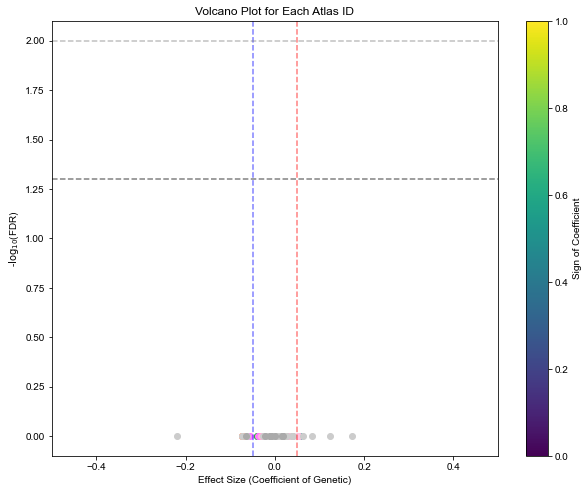

In [591]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
import rpy2.robjects as ro
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    try:
        # R環境にデータフレームを渡す
        ro.globalenv['data'] = pandas2ri.py2rpy(data)
        # pdfClusterを実行
        r_code = '''
        library(MASS)
        model <- glm.nb('log_All_cell_count ~ Age', data = data)
        coef <- summary(model)$coefficients["Age", "Estimate"]
        p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
        c(coef, p_value)
        '''
        #results_ <- summary(model)
        #results_ <- summary(model)
        #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
        #coef <- summary(model)$Coefficients["Genetic", "coef"]
        ro.r(r_code)

        results = ro.r(r_code)

        coef = results[0]
        p_value = results[1]
        print(f"Coefficient: {coef}, p-value: {p_value}")
    except:
        coef, p_value = 0.0, 1.0
        print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4.csv" #"/Regional_cellome4_WM_mask_ver1_volume_revised.csv"

            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
                
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1_cell_count'].transform('sum')+healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')+healthy_data.groupby('Sample')['Others_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = (healthy_data['Iba1_cell_count']+healthy_data['NeuN_cell_count']+healthy_data['Others_cell_count']) / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    #data['log_All_cell_count'] = np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000 #np.round(data['Iba1_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


0
0


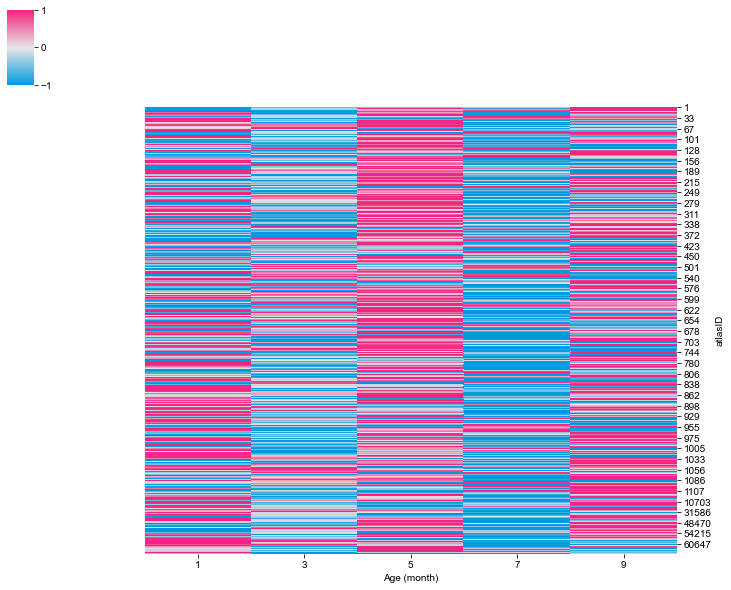

In [592]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json


# Prepare sample info
sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m" ] for s in conditions[c]]
column_order = ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m" ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("APP_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# PDFとして図を保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/APP_Microglia_gradient_heatmap.pdf', 
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [593]:
# CSVファイルとして保存
data_pivot.to_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Total_cell_ratio_all.csv', index=True)

Start time: 2024-10-02 20:46:58.621398
0      0.534342
1      0.768351
2      0.756240
3      0.767956
4      0.566787
         ...   
666    0.977969
667    0.775458
668    0.867521
669    0.809648
670    0.917817
Name: dpt_pseudotime, Length: 671, dtype: float32


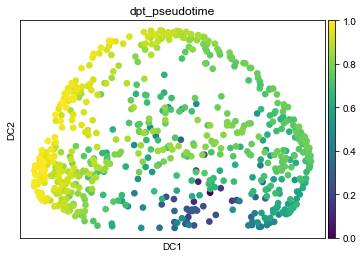

End time after X: 2024-10-02 20:46:59.091529
Duration for UMAP: 0:00:00.470131


In [594]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Total_cell_ratio_all.csv', index_col='atlasID')

# 欠損値を各列の平均値で埋める
data_pivot = X#.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = data_pivot.apply(zscore, axis=1).fillna(0)

# 各行がリストになっているので、それを展開して2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定
adata.uns['iroot'] = 240#597 #532 #634

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()


# 実行時間の計測
end_time1 = datetime.datetime.now()
print("End time after X:", end_time1)
print("Duration for UMAP:", end_time1 - start_time)


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


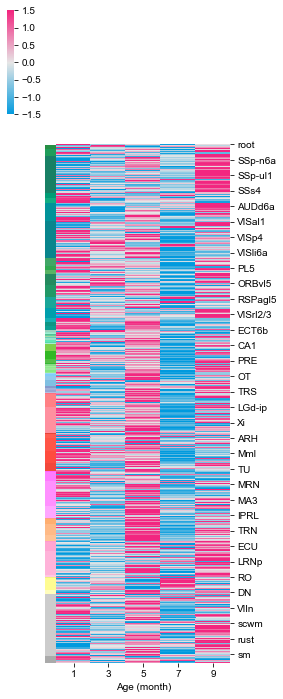

In [595]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df, cmap=cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


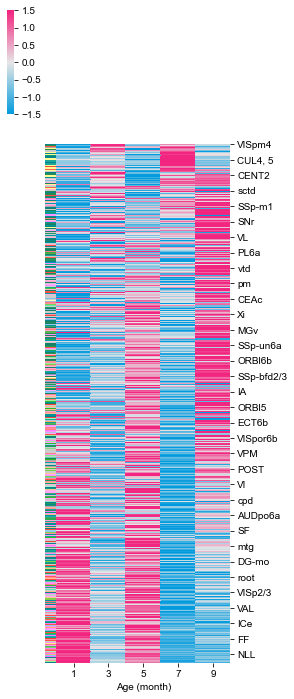

In [596]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


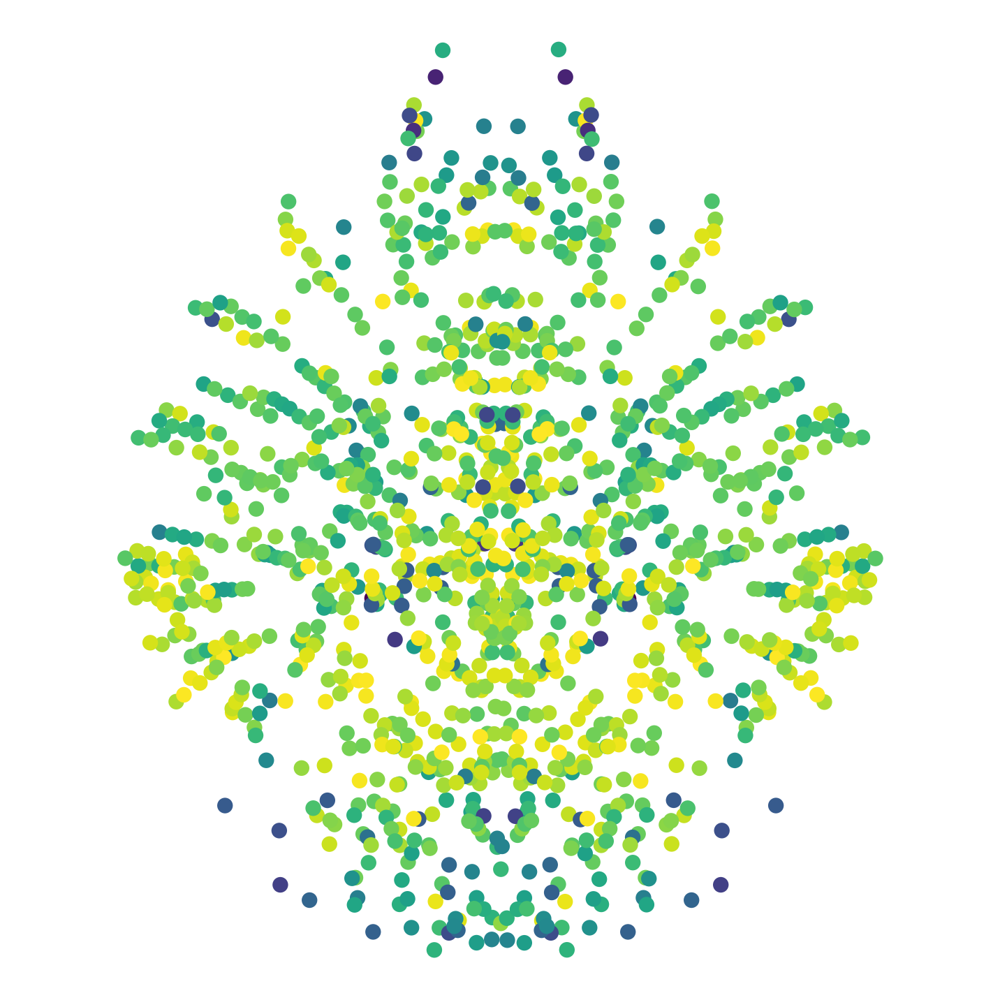

In [597]:
# atlasID が適切に設定されていることを確認する
# adata.obs に atlasID が含まれていることを前提にします
if 'atlasID' not in adata.obs.columns:
    adata.obs['atlasID'] = data_normalized.index

# pseudotime_df を adata.obs から作成し、インデックスを atlasID にする
pseudotime_df = pd.DataFrame(adata.obs[['atlasID', 'dpt_pseudotime']])

# pseudotime_df のインデックスを data_normalized のインデックス（atlasID）に基づいて設定
pseudotime_df = pseudotime_df.set_index('atlasID')

# data_normalized のインデックスに対応して pseudotime の値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['dpt_pseudotime'])

# pseudotime が NaN の場合は 0 で補完（必要に応じて）
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridis_rカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
#plt.title('Centroids of Left and Right Brain with Pseudotime Coloration')
#plt.xlabel('X (um)')
#plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.colorbar(sc, label='Pseudotime from Abeta PCA')  # カラーバーを追加
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Whole_brain_plot_of_Regional_Abeta_psedotime.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


#4_APPmodel_Ctr1m_1_2022_1104_1550
#4_APPmodel_Ctr1m_2_2022_1108_959
#4_APPmodel_Ctr1m_3_2022_1209_1751
#5_APPmodel_Ctr3m_1_2023_0113_1230
#5_APPmodel_Ctr3m_2_2023_0210_1142
#5_APPmodel_Ctr3m_3_2023_0227_1605
#4_APPmodel_Ctr3m_4_2023_0427_1444
#4_APPmodel_Ctr5m_1_2022_1026_252
#4_APPmodel_Ctr5m_2_2022_1028_2336
#4_APPmodel_Ctr5m_3_2022_1101_140
#4_APPmodel_Ctr5m_4_2023_0512_2057
#5_APPmodel_Ctr7m_1_2023_0206_1534
#5_APPmodel_Ctr7m_2_2023_0313_1111
#5_APPmodel_Ctr7m_3_2023_0331_2139
#4_APPmodel_Ctr7m_4_2023_0516_1559
#5_APPmodel_Ctr7m_5_2023_0522_2218
#5_APPmodel_Ctr9m_1_2023_0130_1607
#5_APPmodel_Ctr9m_2_2023_0216_2052
#5_APPmodel_Ctr9m_3_2023_0322_2014
#5_APPmodel_Ctr9m_4_2023_0518_1449
997
Coefficient: 0.0006866350628205281, p-value: 0.9838254085490573
68
Coefficient: -0.07988800499582746, p-value: 0.7252384146542907
667
Coefficient: -0.01635522706348725, p-value: 0.9163558272892125
52192


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.012815866672926014, p-value: 0.9267121538900782
52196
Coefficient: -0.016966234952926148, p-value: 0.9357759173963489
52264
Coefficient: 0.008530764437703864, p-value: 0.9968349903152186
320
Coefficient: -0.014610594308115885, p-value: 0.8565128908983639
943
Coefficient: -0.012081468476125744, p-value: 0.7334596997104283
648
Coefficient: -0.008290500187696932, p-value: 0.8349964454279537
844


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0030925159559601115, p-value: 0.9341207320488422
882
Coefficient: 0.011419959178132126, p-value: 0.9388792870210615
656
Coefficient: -0.022571952354882522, p-value: 0.7030894697472487
962
Coefficient: -0.019974708708068688, p-value: 0.5852405450185171
767
Coefficient: -0.012816624636385634, p-value: 0.7153926959940056
1021
Coefficient: -0.00029177418469950305, p-value: 0.9943927365140313
1085


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01468303323983048, p-value: 0.9471903933008449
558
Coefficient: -0.007894806485636625, p-value: 0.9470638254738817
838
Coefficient: -0.010885376838642494, p-value: 0.8947583716374505
654
Coefficient: -0.008046479740958165, p-value: 0.9139695653499981
702
Coefficient: -0.01205867512492808, p-value: 0.9021622988110762
889
Coefficient: -0.003531564979826937, p-value: 0.9602111891613928
929


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004702525953896168, p-value: 0.9879031559132699
981
Coefficient: -0.011567509628319853, p-value: 0.8793783175701455
201
Coefficient: -0.0028748295748222677, p-value: 0.9525274798778816
1047
Coefficient: 0.00041284814938005753, p-value: 0.99355878276203
1070
Coefficient: -0.003852275877306608, p-value: 0.9497025761756892
1038
Coefficient: 0.005470360482839224, p-value: 0.9176740915857666
1062


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/p

Coefficient: 0.01124473255136113, p-value: 0.9486565633008819
1030
Coefficient: -0.015470563343591615, p-value: 0.9222924275480773
113
Coefficient: -0.00568064710355058, p-value: 0.9420510461577819
1094
Coefficient: -0.0008187549856788431, p-value: 0.9939057671618103
1128
Coefficient: -0.008116859118219162, p-value: 0.925912709362241
478
Coefficient: 0.006863356777379672, p-value: 0.935683912578035
510
Coefficient: 0.0074242557578736365, p-value: 0.980286562871399
878
Coefficient: -0.010919831062761913, p-value: 0.8984377242623466
657


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01200408051459571, p-value: 0.822620340287195
950
Coefficient: -0.006296470152492599, p-value: 0.9113781188740858
974
Coefficient: -0.012411431092646617, p-value: 0.8419608067610909
1102
Coefficient: -0.005361166499552228, p-value: 0.9123952074489976
2
Coefficient: 0.0006313157086677942, p-value: 0.9973914578563805
450


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.015007581520391288, p-value: 0.8978995863751132
854
Coefficient: -0.007281011427606065, p-value: 0.9124076400969504
577
Coefficient: 0.000914737471599409, p-value: 0.9908219434656226
625
Coefficient: -0.007382055168779197, p-value: 0.9247789228725781
945
Coefficient: 0.003939181917345692, p-value: 0.95126678531662
1026
Coefficient: 0.006051944086987073, p-value: 0.9792457964493667
1006


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01574027175231936, p-value: 0.9180811143226416
670
Coefficient: -0.001287494505082056, p-value: 0.9886215098433221
1086
Coefficient: -0.004254598957909478, p-value: 0.9802619599289243
1111
Coefficient: -0.006790022072362203, p-value: 0.9527244499502437
9
Coefficient: 0.0036157042916819676, p-value: 0.9779550053809023
461
Coefficient: 0.0022633447605137197, p-value: 0.9948866119658957
18693


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.015864826316246083, p-value: 0.9316610647713431
18697
Coefficient: -0.005446762245300563, p-value: 0.9618963083707467
18701
Coefficient: 0.0015462977011914, p-value: 0.9911881096943139
18705
Coefficient: -0.007696551853420869, p-value: 0.9573244175020666
18709
Coefficient: 0.0006931613309599257, p-value: 0.9951592099436263
18713
Coefficient: 0.007588867182742294, p-value: 0.9853256843867586
873


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.019572891457668582, p-value: 0.7771040666475916
806
Coefficient: -0.01600070241903603, p-value: 0.7227131584195285
1035
Coefficient: -0.0053138766287349915, p-value: 0.9302479956162119
1090
Coefficient: -0.014806473006241098, p-value: 0.7653935607389626
862
Coefficient: -0.012087791032361326, p-value: 0.7988829640250592
893
Coefficient: -0.010408974372956872, p-value: 0.9488306700213881
36
Coefficient: -0.03177862581913965, p-value: 0.8852198169398546
180
Coefficient: -0.022631185859950595, p-value: 0.8405182525784342
148


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01690532719624742, p-value: 0.9283365345501633
187
Coefficient: -0.023124951121390343, p-value: 0.8223371798656642
638
Coefficient: -0.019689678269569237, p-value: 0.8413231837657011
662
Coefficient: -0.012104469469572573, p-value: 0.9696681738709466
897
Coefficient: -0.0292699277918024, p-value: 0.8536469389039509
1106
Coefficient: -0.027920094504548826, p-value: 0.776693559861224
1010
Coefficient: -0.02691440580884748, p-value: 0.8799883881874528
1058
Coefficient: -0.037173502467168766, p-value: 0.697855321817523
857


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.03575307445196584, p-value: 0.7293587734814211
849
Coefficient: -0.0362703916056936, p-value: 0.9100149050965805
527
Coefficient: 0.0029578500578825748, p-value: 0.9856204263269913
600
Coefficient: 0.0013854260024724425, p-value: 0.9895774849434628
678
Coefficient: 0.013144108706062873, p-value: 0.9333095155932073
252
Coefficient: -0.001370465154057516, p-value: 0.9900376077921046
156
Coefficient: -0.0005503219577377909, p-value: 0.9970388265768684
243
Coefficient: -0.002498131807055711, p-value: 0.995002038958058
735


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011184478015237524, p-value: 0.9221315469724611
251
Coefficient: -0.013756577671570978, p-value: 0.8796948745851956
816
Coefficient: -0.004451069245501687, p-value: 0.9716306373362897
847
Coefficient: -0.011519327752843289, p-value: 0.8892697520425127
954
Coefficient: -0.005117222906731671, p-value: 0.9669378573197676
1005
Coefficient: -0.008961642000182225, p-value: 0.9764782363475988
696
Coefficient: -0.012802248818060176, p-value: 0.9550255069674269
643
Coefficient: -0.004472289736699357, p-value: 0.9782996743943575
759


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0014209667666200054, p-value: 0.9950761433693718
791
Coefficient: -0.00650945591206779, p-value: 0.9682349179769313
249
Coefficient: 7.793130130329565e-05, p-value: 0.9997234340302218
456
Coefficient: -0.005146423382588221, p-value: 0.9919834784060747
959
Coefficient: -0.022527320964346148, p-value: 0.8802337276284343
755
Coefficient: -0.027572001967876077, p-value: 0.8030720279529917
990
Coefficient: -0.025827643701203763, p-value: 0.8651015298504451
1023
Coefficient: -0.02869298696254694, p-value: 0.7621472917381601
520


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01605026821188886, p-value: 0.9059350547758432
598
Coefficient: -0.018785242008719585, p-value: 0.9588639953442377
1074
Coefficient: -0.014606914770640618, p-value: 0.9456513268725006
905
Coefficient: -0.0011792449799887534, p-value: 0.9932605581438858
1114
Coefficient: 0.006663878827153899, p-value: 0.9723530920243336
233
Coefficient: -0.0030100709931532997, p-value: 0.9839977783936167
601
Coefficient: 0.0022972517821441937, p-value: 0.9901310786642338
649
Coefficient: 0.0010653239234830621, p-value: 0.998112372866926
281


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01774515580208061, p-value: 0.9296093119457364
1066
Coefficient: -0.011413213341436686, p-value: 0.9279754468518528
401
Coefficient: -0.0006831943208897604, p-value: 0.9975201580923253
433
Coefficient: -0.012323132050079684, p-value: 0.9260589618472012
1046
Coefficient: -0.0003966829741602642, p-value: 0.9979465995930533
441
Coefficient: 0.002477862799268564, p-value: 0.9948381482904755
421
Coefficient: -0.009730148336021944, p-value: 0.9573644625171395
973
Coefficient: -0.010680934062161203, p-value: 0.9280568948477063
573


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007871479336490298, p-value: 0.9577148124314927
613
Coefficient: -0.022206343760402286, p-value: 0.8543396369303972
74
Coefficient: -0.012262073093561386, p-value: 0.9277854781429864
121
Coefficient: -0.009042517406793016, p-value: 0.9787780562327962
593
Coefficient: 0.0008200135080927633, p-value: 0.9894261877039778
821
Coefficient: -0.0016012567616841573, p-value: 0.969876910680502
721
Coefficient: -0.0006717697160240004, p-value: 0.9906314716021752
778
Coefficient: -0.009658818631064697, p-value: 0.8535366168368597
33


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0018740099233384181, p-value: 0.9738403742467675
305
Coefficient: -0.0015572394734096084, p-value: 0.9920403565034339
750
Coefficient: -0.0075532352274203666, p-value: 0.9610339862216511
269
Coefficient: -0.014801567021755063, p-value: 0.9157327260330104
869
Coefficient: -0.02066508198939467, p-value: 0.9553328294117437
902
Coefficient: -0.019040466540937655, p-value: 0.8898726191536329
377
Coefficient: -0.00990955961237475, p-value: 0.9566136579063066
393
Coefficient: -0.002051461972906577, p-value: 0.9975089940641615
805


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.009081975208201996, p-value: 0.9583361948872227
41
Coefficient: -0.012285279234631262, p-value: 0.9077361303740599
501
Coefficient: -0.0071881442527888095, p-value: 0.966248318301907
565
Coefficient: -0.016384098188495122, p-value: 0.8933314786539999
257
Coefficient: -0.0019114420866713298, p-value: 0.9899436714399613
469
Coefficient: -0.0021319856431614875, p-value: 0.995252407520549
31578
Coefficient: -0.018611600530186373, p-value: 0.9514781887375485
31582
Coefficient: -0.013146666356517333, p-value: 0.9437970253693733
31586


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007160839303192786, p-value: 0.9783297590684054
31590
Coefficient: -0.023336511039414164, p-value: 0.8963737839673911
31594
Coefficient: -0.013492882759014944, p-value: 0.9513890384641573
31598
Coefficient: -0.009817299821410368, p-value: 0.9848968430971298
31632
Coefficient: -0.015231425595580269, p-value: 0.9190771964926148
31636
Coefficient: -0.018440529714789843, p-value: 0.8691937299396963
31640
Coefficient: -0.02946499499365383, p-value: 0.919451978810116
31644


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.023778379122189972, p-value: 0.8511289039631842
31648
Coefficient: -0.01587102954089713, p-value: 0.9186969011894024
31652
Coefficient: -0.01174013219656963, p-value: 0.9756643194628701
935
Coefficient: -0.030624722431279394, p-value: 0.7815582876187928
211
Coefficient: -0.026589867197613064, p-value: 0.7446863887936955
1015
Coefficient: -0.01752948597025481, p-value: 0.7730007541272353
919
Coefficient: -0.001707945877949099, p-value: 0.9810524132076001
927
Coefficient: 0.01476619126240039, p-value: 0.9695749440770662
588


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01845791741069258, p-value: 0.8887947230773313
296
Coefficient: -0.01044725248156292, p-value: 0.9093136543901778
772
Coefficient: -0.008533999271750605, p-value: 0.8927298072111995
810
Coefficient: -0.0008242852855315141, p-value: 0.99335633041924
819
Coefficient: 0.004765516694551897, p-value: 0.9854567847689185
171
Coefficient: -0.08068642676359636, p-value: 0.5395378744436261
304
Coefficient: -0.0406797143570627, p-value: 0.7009278763444444
363
Coefficient: -0.030656030903525623, p-value: 0.6905616274451046
84


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00958966226242938, p-value: 0.9178988821580297
132
Coefficient: 0.0027362801263442014, p-value: 0.9944226425821028
707
Coefficient: -0.005710572938205706, p-value: 0.9816822671301254
556
Coefficient: -0.025638497598710442, p-value: 0.9063016321062952
827
Coefficient: -0.021412344673837333, p-value: 0.8496416432371791
1054
Coefficient: -0.007724416550638619, p-value: 0.9523315128072698
1081
Coefficient: 0.0012846052873145733, p-value: 0.998246560351444
448
Coefficient: 0.015125786777227779, p-value: 0.9288641940724534
412


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005867160135668138, p-value: 0.9520358372865505
630
Coefficient: -0.006255391186177569, p-value: 0.92848976630145
440
Coefficient: -0.0006927575143275364, p-value: 0.994328973434119
488
Coefficient: 0.010383700340390645, p-value: 0.9726226819285849
484
Coefficient: -0.05578649449834417, p-value: 0.7648988197008358
582
Coefficient: -0.021144206559873594, p-value: 0.8737629106610317
620
Coefficient: -0.02248373749012476, p-value: 0.8238895546009798
910
Coefficient: -0.005006316949056748, p-value: 0.9735650015396625
52977


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.007582294237380952, p-value: 0.9939495722034535
969
Coefficient: -0.0154309789729729, p-value: 0.9287555473192688
288
Coefficient: -0.003908921459246094, p-value: 0.9667764665275171
1125
Coefficient: -0.0062493342064533965, p-value: 0.943556422998359
608
Coefficient: 0.0004609870437226402, p-value: 0.9971757890456813
680
Coefficient: 0.01448129803701289, p-value: 0.9810753522026466
996
Coefficient: -0.01042245254481387, p-value: 0.9519544063759471
328
Coefficient: -0.031698266323844294, p-value: 0.7281862228586933
1101


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0327926699972786, p-value: 0.6374102552031522
783
Coefficient: -0.018900469868006718, p-value: 0.8095058382408202
831
Coefficient: -0.01022719276411542, p-value: 0.9738963053052399
120
Coefficient: -0.023797167654336236, p-value: 0.8936956579461078
163
Coefficient: -0.030113150780099945, p-value: 0.7412948313615527
344
Coefficient: -0.016587142877040533, p-value: 0.8693828582588834
314
Coefficient: -0.013299128444646136, p-value: 0.8998989764094011
355
Coefficient: -0.010892231123196188, p-value: 0.9811478298262729
704


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00692355546347478, p-value: 0.9758779013392465
694
Coefficient: -0.015490641771067702, p-value: 0.8966578418260991
800
Coefficient: -0.02168406682862785, p-value: 0.8286649913442043
675
Coefficient: -0.006294824477585964, p-value: 0.9698540856245452
699
Coefficient: -0.000614068025407834, p-value: 0.99960020851622
671
Coefficient: -0.0008358020217761683, p-value: 0.9938053903571724
965
Coefficient: -0.008384728172423417, p-value: 0.903807663778875
774
Coefficient: -0.011362839426905398, p-value: 0.877073853354978
906


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004603271090888291, p-value: 0.9618906912905107
279
Coefficient: 0.001368679146118859, p-value: 0.9970083700470395
442
Coefficient: 0.005982645532023636, p-value: 0.9336158535487298
434
Coefficient: -0.005876666996540499, p-value: 0.9167239275170072
610
Coefficient: -0.009516600645735344, p-value: 0.8683352343954633
274
Coefficient: -0.006549119602388545, p-value: 0.9255841002375824
330
Coefficient: 0.0023122700402693924, p-value: 0.9954619742787509
542
Coefficient: -0.012864486074804832, p-value: 0.8119178239636559
430


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010879810061340853, p-value: 0.8068310648067814
687
Coefficient: -0.0054754299192160145, p-value: 0.9064805038035953
590
Coefficient: -0.0011452700087600499, p-value: 0.9878862768069674
622
Coefficient: 0.01292848264199141, p-value: 0.9680579358992731
31550
Coefficient: -0.023831321233653325, p-value: 0.867872858717575
31554
Coefficient: -0.009194295412110042, p-value: 0.918244393734795
31558
Coefficient: -0.005518312953539318, p-value: 0.9720393224231035
31562
Coefficient: -0.01104812846031623, p-value: 0.9205310803305125
31566


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0015996146844760573, p-value: 0.9898825016840149
31570
Coefficient: 0.0016791472345872589, p-value: 0.9956047638318625
31604
Coefficient: -0.012875816455580155, p-value: 0.9347183895229876
31608
Coefficient: -0.0003871576657761223, p-value: 0.9971154808584974
31612
Coefficient: 0.00025998448107087394, p-value: 0.9987780519236605
31616
Coefficient: -0.00430061054297998, p-value: 0.9738449028143138
31620
Coefficient: 0.004223390046817132, p-value: 0.9774056452933686
31624
Coefficient: 0.003733822347183619, p-value: 0.9917808467922021
97


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0387109159499369, p-value: 0.761847558589789
1127
Coefficient: -0.032452145729199175, p-value: 0.6979709517604666
234
Coefficient: -0.033636494870675354, p-value: 0.8014417180701912
289
Coefficient: -0.03580077605970261, p-value: 0.6477972696115527
729
Coefficient: -0.018536940347348835, p-value: 0.8498409915683736
786
Coefficient: -0.01703911887426456, p-value: 0.9466923727267326
540
Coefficient: -0.015894997133598546, p-value: 0.9390831710035675
888
Coefficient: -0.018297132890069928, p-value: 0.8970812987254838
692


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00937829203816304, p-value: 0.9666440311294462
335
Coefficient: -0.005006443510401201, p-value: 0.9883412872273034
368
Coefficient: -0.004601080700428715, p-value: 0.9945621732927727
836
Coefficient: -0.062335227558237956, p-value: 0.7490589617462686
427
Coefficient: -0.0352309425076981, p-value: 0.7565027599052534
988
Coefficient: -0.02570291704318604, p-value: 0.8236616347919561
977
Coefficient: -0.007564544567641856, p-value: 0.9504122837610236
1045
Coefficient: -0.002287581499150815, p-value: 0.9941659439269467
698


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.03608272044660794, p-value: 0.17580599928161902
507
Coefficient: 0.04588742426811917, p-value: 3.0680856338041136e-06
188
Coefficient: 0.0018812727981269502, p-value: 0.9888014275477146
196
Coefficient: 0.0075263077184258885, p-value: 0.919577648837851
204
Coefficient: 0.007407391694175486, p-value: 0.9359419501543056
159
Coefficient: -0.0022732647631856376, p-value: 0.9411468995609215
597
Coefficient: -0.01459089891685214, p-value: 0.8703824756129332
605
Coefficient: -0.004430584900796673, p-value: 0.9595760480692745
814


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.01100627625246024, p-value: 0.9104043036340786
961
Coefficient: -0.012931083163445684, p-value: 0.5695754741671201
260
Coefficient: 0.049525412459977325, p-value: 0.8586188027307803
268
Coefficient: 0.003170143311398245, p-value: 0.9851865063103653
1139
Coefficient: -0.0008597453889262168, p-value: 0.9975019645260653
639
Coefficient: -0.0068615734774626624, p-value: 0.9318893071841776
655


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.00018578174668736747, p-value: 0.9978569601460522
663
Coefficient: -0.00723695299947469, p-value: 0.8937919164322492
788
Coefficient: -0.010142576266142544, p-value: 0.9036778857005467
566
Coefficient: -0.025505426519591177, p-value: 0.7132765781249063
1089
Coefficient: -0.00450892156320592, p-value: 0.9637338653248843
382
Coefficient: -0.005782297639943159, p-value: 0.8098733744248918
423
Coefficient: -0.01050110167310728, p-value: 0.9356353196686178
463
Coefficient: -0.009955860733083854, p-value: 0.7423795546698087
10703


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.012392611047042373, p-value: 0.7558993757794816
10704
Coefficient: -0.021114378404160163, p-value: 0.7026637308612298
632
Coefficient: -0.0034039128448140484, p-value: 0.9006017511655208
982
Coefficient: -0.015200607842841173, p-value: 0.9522503483530038
19
Coefficient: -0.006364421729084387, p-value: 0.9744336529667768
1121
Coefficient: -0.021043869630321017, p-value: 0.8421199263642996
20
Coefficient: -0.01397216151559495, p-value: 0.8213394648190484
52
Coefficient: -0.010722449489584653, p-value: 0.8806663978816309
139


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006878740724593589, p-value: 0.9260589332039598
28
Coefficient: -0.002122838080842631, p-value: 0.9765486860847279
526
Coefficient: -0.030542356950714503, p-value: 0.7080445580708713
543
Coefficient: -0.01693539108949821, p-value: 0.8094190669688187
664
Coefficient: -0.018302337608450785, p-value: 0.8072392465326007
727
Coefficient: -0.011912860877344712, p-value: 0.8760023140060829
743
Coefficient: -0.008503363708010319, p-value: 0.9156028489899422
843
Coefficient: -0.014936307516290964, p-value: 0.8311839668615852
1037


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007729374493372336, p-value: 0.8790851462649552
1084
Coefficient: 0.0031394631157442856, p-value: 0.9579739349837619
502
Coefficient: -0.005717084511565712, p-value: 0.8929598901693446
48470
Coefficient: -0.007961788644305337, p-value: 0.8980433105305212
58447
Coefficient: -0.009450138151383477, p-value: 0.9125182201236137
48508
Coefficient: -0.020313248204123557, p-value: 0.8419700699514264
703


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.003987368446921705, p-value: 0.972539992518098
583
Coefficient: -0.015792573302764127, p-value: 0.8566887580129281
952
Coefficient: -0.0007758261943824287, p-value: 0.9880733009925357
966
Coefficient: -0.0014692684071873521, p-value: 0.9863663975279005
131
Coefficient: -0.00677222260727573, p-value: 0.9238434160097042
303
Coefficient: -0.012962694243941997, p-value: 0.8810580433743687
311
Coefficient: -0.010196536205960437, p-value: 0.9071446028906296
451
Coefficient: -0.0076560489141358065, p-value: 0.9581276268738497
327


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.001076420914845717, p-value: 0.9883646956194415
334
Coefficient: -0.007905935098539273, p-value: 0.9258490777242621
780
Coefficient: -0.011181919559134265, p-value: 0.8445443729700528
477
Coefficient: -0.0024184214969075407, p-value: 0.9519078846152578
672
Coefficient: -0.006695694028579434, p-value: 0.5995278832329942
56
Coefficient: -0.001775605604143006, p-value: 0.9471874672685244
998


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007111518051356357, p-value: 0.9436384194783236
754
Coefficient: -0.00785332675141677, p-value: 0.8055325645568125
250
Coefficient: -0.007370367708020319, p-value: 0.9404852130429914
258
Coefficient: -0.007577027403947615, p-value: 0.8705319952714348
266
Coefficient: -0.009818762849715572, p-value: 0.8955675169734494
310
Coefficient: 7.69118219906825e-05, p-value: 0.9993841952326217
333
Coefficient: -0.009974985184069203, p-value: 0.9750012032770328
23
Coefficient: 0.002352085486103057, p-value: 0.9806387599807884
292


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.05686794549963514, p-value: 0.8988184987372774
544
Coefficient: -0.0069317433656559185, p-value: 0.9554053813245071
551
Coefficient: 6.05342235910699e-05, p-value: 0.9996202958393652
559
Coefficient: 0.0035061706000367814, p-value: 0.9642867731291206
1105
Coefficient: -0.007416929675687491, p-value: 0.9512260166552748
403
Coefficient: -0.006951236171349101, p-value: 0.8776400204443824
803
Coefficient: -0.0037427354136317197, p-value: 0.9539747267019918
1022
Coefficient: 0.003690348950378431, p-value: 0.9511002647078637
1031


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.013186579675154467, p-value: 0.9056357540162008
342
Coefficient: -0.0019158408717036212, p-value: 0.9621891458889654
298
Coefficient: 0.006040968058922392, p-value: 0.9556219563291439
564
Coefficient: -0.0009265917141818871, p-value: 0.9938419820976205
596
Coefficient: -0.0022334396818052276, p-value: 0.9789062102334465
581
Coefficient: 0.006206290097487774, p-value: 0.9532896735037082
351
Coefficient: -0.001144872260346002, p-value: 0.983498654895179
287
Coefficient: 0.018014804778718436, p-value: 0.981145320572943
549


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0033331459415092517, p-value: 0.9618661157381023
629
Coefficient: -0.005676864619639388, p-value: 0.94130763754779
685
Coefficient: -0.00425740173268855, p-value: 0.9551138399785405
718
Coefficient: 0.003332137367728509, p-value: 0.9647893845215457
725
Coefficient: -0.007459876300558941, p-value: 0.9749221967538758
733
Coefficient: -0.00048821353943389673, p-value: 0.992969718433504
741
Coefficient: -0.017770132068821772, p-value: 0.9013697484764261
56435
Coefficient: -0.0036995495525509034, p-value: 0.9763029127593563
414


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.001719527921949452, p-value: 0.9939404612549769
422
Coefficient: -0.004030029239354782, p-value: 0.9816537031834695
609
Coefficient: -0.0018329779839733379, p-value: 0.9922437743548157
1044
Coefficient: -0.0034356178613208577, p-value: 0.9890929852091611
1072
Coefficient: -0.0032034126564303976, p-value: 0.9826724164524967
1079
Coefficient: 0.006789511900974651, p-value: 0.9537929171815245
1088
Coefficient: -0.003539777995140092, p-value: 0.9796439352473145
49664
Coefficient: 0.006764336001463067, p-value: 0.9626929274858211
49668


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0022202268601544156, p-value: 0.9836173307794842
49672
Coefficient: 0.002770261769714326, p-value: 0.9894514547629899
218
Coefficient: -0.0017248738490882123, p-value: 0.9786464786768511
1020
Coefficient: -0.010858918798814126, p-value: 0.8708096003396578
1029
Coefficient: 0.0011799151864023462, p-value: 0.9931799139404357
325
Coefficient: -0.008193933798025316, p-value: 0.9568769918598781
56551
Coefficient: 0.004031038871406615, p-value: 0.978006633992925
255
Coefficient: -0.0074495841482916545, p-value: 0.9350775866552294
1096


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007829143408334146, p-value: 0.9549074461578202
1104
Coefficient: -0.0029092032694141216, p-value: 0.9852144514596217
64
Coefficient: -0.0018798844964518669, p-value: 0.9905170784497502
1120
Coefficient: -0.018737670189742282, p-value: 0.9538074140650873
1113
Coefficient: -0.0045399658366734146, p-value: 0.979582855391933
155
Coefficient: -0.005454808753370222, p-value: 0.9400497668330745
59
Coefficient: -0.009331964490294857, p-value: 0.9519361321669937
362
Coefficient: -0.006129097103566099, p-value: 0.9130967003393817
366


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0054147693696376935, p-value: 0.9638851109609785
1077
Coefficient: -0.004877988392827156, p-value: 0.9778804418857047
149
Coefficient: -0.02350884757471726, p-value: 0.7937279652820681
15
Coefficient: -0.003074298028317523, p-value: 0.9831884995322215
181
Coefficient: -0.007288931741207789, p-value: 0.9426475741996387
56559
Coefficient: -0.004894160576359747, p-value: 0.982678968114968
189
Coefficient: -0.01725800484030878, p-value: 0.9305191366099526
599
Coefficient: -0.014321428302267358, p-value: 0.9107818472371166
907


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.010422901636721726, p-value: 0.9404330473056469
575
Coefficient: -0.004918971575507025, p-value: 0.9643559067903626
930
Coefficient: -0.002215160635783709, p-value: 0.981185699505183
56563
Coefficient: 0.0009363289919850358, p-value: 0.9949272293003528
262
Coefficient: 0.0010749580714964567, p-value: 0.9831954560227153
27
Coefficient: -0.002856257547457661, p-value: 0.9903477262450977
56439
Coefficient: 0.006887119906411349, p-value: 0.9869577415869185
178


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0003866112780440298, p-value: 0.9968737466134016
321
Coefficient: 0.005920509809132684, p-value: 0.9859528120920096
483
Coefficient: -0.007638826088900734, p-value: 0.9187458999560394
186
Coefficient: -0.004012387986025692, p-value: 0.9657989208939682
1097
Coefficient: -0.0022845680661798245, p-value: 0.954109216104405
390
Coefficient: -0.0037102840125122043, p-value: 0.9906011105221225
332
Coefficient: -0.003840625884244597, p-value: 0.9958676163155384
38


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/p

Coefficient: 0.0018288415520362454, p-value: 0.9886620942362331
30
Coefficient: 0.0008309882585102592, p-value: 0.9967681805551615
118
Coefficient: -0.011998646402817266, p-value: 0.9384335422609367
223
Coefficient: 0.006303104413136369, p-value: 0.9526056400513585
72
Coefficient: 0.001734339955239436, p-value: 0.9931529692528084
263


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.00181094023984607, p-value: 0.9931980587439669
272
Coefficient: -0.008226544885700937, p-value: 0.9558570249992636
830
Coefficient: -0.010824710692094956, p-value: 0.9118112581552998
452
Coefficient: -0.0038859484304341343, p-value: 0.9898072655493458
523
Coefficient: -0.00389721190082559, p-value: 0.9640112189847482
763
Coefficient: -0.013795180208435858, p-value: 0.9810362692483202
914
Coefficient: -0.006868472061239674, p-value: 0.988903123823861
1109


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0048978566660506685, p-value: 0.9800515143719499
126
Coefficient: 0.037901078349579544, p-value: 0.8097570094121145
133
Coefficient: -0.0032467802027896986, p-value: 0.9835927771252745
347
Coefficient: -0.0019822708697555076, p-value: 0.9908135077891989
286
Coefficient: 0.002566693967167631, p-value: 0.9876507073186225
338
Coefficient: -0.008164736455254718, p-value: 0.9844066378769728
57699


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.003371423594251403, p-value: 0.9902275681185488
689
Coefficient: -0.004803300594458021, p-value: 0.985279640097826
88
Coefficient: -0.004291298506165649, p-value: 0.9522874563820312
210
Coefficient: -0.01981687061402694, p-value: 0.9181503345591846
732
Coefficient: -0.021981447270251326, p-value: 0.9105857109353339
60647
Coefficient: -0.0034365350345889755, p-value: 0.9747772353623119
60651


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.015973490974956102, p-value: 0.908804799317535
60655
Coefficient: -0.012526060428256571, p-value: 0.9640777321876429
60659
Coefficient: 0.0046635195804564725, p-value: 0.9808381149846491
525
Coefficient: -0.0028597767525769696, p-value: 0.9818117228314895
1126
Coefficient: -0.01561508843161531, p-value: 0.9547954835811877
1
Coefficient: -0.010676603180300741, p-value: 0.953418850965544
515


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.004567626822222278, p-value: 0.9637829762415714
980
Coefficient: -0.006351923774027481, p-value: 0.968753997294862
1004
Coefficient: -0.004886819137606423, p-value: 0.9698620391001016
63
Coefficient: -0.0056702523921322925, p-value: 0.9754323338987041
693
Coefficient: 1.7263197774565968e-05, p-value: 0.9998447254573495
946
Coefficient: -0.0022262935438419444, p-value: 0.9771886599639696
194


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0018828045012009467, p-value: 0.9677235501469655
226
Coefficient: 0.0005253688793595277, p-value: 0.9952711924811585
356
Coefficient: -0.005607557989697004, p-value: 0.9917550992165367
364
Coefficient: 0.002232196428108295, p-value: 0.9884778875463464
57704
Coefficient: -0.0025098193607476487, p-value: 0.9858120590267968
173
Coefficient: 0.014193194302417344, p-value: 0.9321059728698723
470
Coefficient: 0.008464304904675955, p-value: 0.9482598455418969
614
Coefficient: 0.016745568134006544, p-value: 0.8508152537242344
797


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0005203899883050033, p-value: 0.9919349372081916
804
Coefficient: 0.00013116589045337863, p-value: 0.999320908728645
10671
Coefficient: 0.07122486505753912, p-value: 0.7550151977443371
313
Coefficient: -0.0034517906120371585, p-value: 0.8933367357744589
851
Coefficient: -0.017687101998428118, p-value: 0.7857460081111851
842
Coefficient: -0.004971968800297831, p-value: 0.9246167879482344
834
Coefficient: 0.022347876966963137, p-value: 0.8262938434439877
811


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0007304901090025686, p-value: 0.9880627652007326
820
Coefficient: -0.0004952854169614781, p-value: 0.9920199055060195
828
Coefficient: -0.010115743052024182, p-value: 0.815079764344
580
Coefficient: -0.00024969027916903116, p-value: 0.9991746641892965
271
Coefficient: -0.02060167592256991, p-value: 0.9258931803486856
874
Coefficient: -0.04729426982255106, p-value: 0.8796792566501692
460
Coefficient: -0.002122007697892302, p-value: 0.9973462706057696
59923
Coefficient: -0.020229952219998078, p-value: 0.9546295457942333
381


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.001472938885704136, p-value: 0.98051587481833
749
Coefficient: 0.007419748783270519, p-value: 0.9467945149186909
60830
Coefficient: -0.004219038244517127, p-value: 0.992365357634195
246
Coefficient: 0.008872254361899893, p-value: 0.9637938301841169
128
Coefficient: -0.000746754283730416, p-value: 0.9810661611948459
26
Coefficient: -0.0033471673525801637, p-value: 0.950979829469459
42
Coefficient: -0.0026719802135022, p-value: 0.9792550389937444
17
Coefficient: -0.006599019684141526, p-value: 0.8676281443727809
10


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/p

Coefficient: -0.013802742154056595, p-value: 0.7211526934703977
795
Coefficient: -0.005446568048635159, p-value: 0.8614260513053769
50
Coefficient: -0.0073098933710945, p-value: 0.9624159031418323
67
Coefficient: 0.0021621569765674898, p-value: 0.9925221661732893
587
Coefficient: -0.0009559401382045467, p-value: 0.996161353311121
61277
Coefficient: -0.0029393892873265048, p-value: 0.9925616233777479
215
Coefficient: 0.0008038528493903648, p-value: 0.9883410271162194
531
Coefficient: -0.0016236580098905537, p-value: 0.9951545389097212
628


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0015710662791495792, p-value: 0.9906370306271473
634
Coefficient: -0.0063151581283674395, p-value: 0.9565241597360872
706
Coefficient: -0.0022750616500264954, p-value: 0.99277039450681
1061
Coefficient: -0.0016050117600446298, p-value: 0.9914487751440664
54203
Coefficient: -0.0010908384797902995, p-value: 0.9968183826759414
616
Coefficient: -0.0008299031426042796, p-value: 0.9920382108272267
214
Coefficient: 0.013084608853420852, p-value: 0.8779069686378735
35
Coefficient: 0.003653254997018399, p-value: 0.9919598725998598
54211


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.004142601447740603, p-value: 0.9934965967008816
975
Coefficient: -0.0006642651208048879, p-value: 0.9986940411776447
115
Coefficient: -0.007075488943273326, p-value: 0.9934613203275046
60663
Coefficient: -0.0009955529985352814, p-value: 0.998636716761635
757
Coefficient: 0.02000972890227907, p-value: 0.9454948680716393
231
Coefficient: 0.022183701983820085, p-value: 0.9415534442358076
66
Coefficient: -0.002361404687000946, p-value: 0.9956793436499678
75
Coefficient: -0.034571636752508406, p-value: 0.9606613947671947
58


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.008850138825550571, p-value: 0.9769039974125611
374
Coefficient: 0.006489330685289805, p-value: 0.9685038264348189
1052
Coefficient: 0.0016830164699228377, p-value: 0.9824510041221547
12
Coefficient: -0.004580666170968954, p-value: 0.9825316637238829
100
Coefficient: 0.0008961198554520429, p-value: 0.9989335499140556
60834
Coefficient: -0.015239451952211025, p-value: 0.9373147307491806
60838
Coefficient: -0.007616748675479511, p-value: 0.977030634198978
60842
Coefficient: 0.0029437225515946386, p-value: 0.9935248288320786
60846


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0005866436199668861, p-value: 0.9981647919529174
60850
Coefficient: -0.003466977392460432, p-value: 0.9926677407859392
60854
Coefficient: 0.00540024775957884, p-value: 0.9891780964917002
60858
Coefficient: 0.0019742152461664653, p-value: 0.9948784678812215
60862
Coefficient: 0.0007269642136633952, p-value: 0.9988207380823652
197
Coefficient: -0.012603263424813433, p-value: 0.9624518325112721
591
Coefficient: -0.004029576956574991, p-value: 0.9861853330042033
872
Coefficient: -0.00597430495748063, p-value: 0.9728433336225897
771


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0023067554802155394, p-value: 0.9522762509212088
612
Coefficient: -0.0021604965127799743, p-value: 0.978393314531976
7
Coefficient: 0.003677051169184286, p-value: 0.9528957476455394
867
Coefficient: 0.0009032549085024277, p-value: 0.988797817414757
123
Coefficient: 0.005619338480440256, p-value: 0.9713127438980022
122
Coefficient: -0.009472688411854831, p-value: 0.9360812667876541
105
Coefficient: 0.006115569993711592, p-value: 0.9709376773455404
114
Coefficient: 0.005120464360956704, p-value: 0.9677473235638604
280


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.016188619190552766, p-value: 0.9786307952416572
880
Coefficient: 0.00017880954695781616, p-value: 0.9991640746814483
59927
Coefficient: 0.013490281006728, p-value: 0.9647446315728683
898
Coefficient: 0.0022572072099163714, p-value: 0.9800387138417873
931
Coefficient: -0.010810458318794177, p-value: 0.8707534937247143
1093
Coefficient: 0.005443946297687438, p-value: 0.9130309006933899
318
Coefficient: 0.023860915539395157, p-value: 0.9641461363123358
534


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0023474695308506356, p-value: 0.9873919597257773
574
Coefficient: 0.006280918688577692, p-value: 0.9391011907460892
621
Coefficient: 0.007622484766158848, p-value: 0.957822856069231
54215
Coefficient: 0.003201365458366335, p-value: 0.9837323329062748
54219
Coefficient: 0.006370269444123744, p-value: 0.9929028049423136
54223
Coefficient: 0.008858889979120007, p-value: 0.9742076695955427
54227


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0007439227286683212, p-value: 0.9983493825729348
679
Coefficient: 0.011987729637453119, p-value: 0.8794477012476606
147
Coefficient: 0.02482758145175289, p-value: 0.95761680408554
162
Coefficient: 0.004008681037687078, p-value: 0.9760466681215613
604
Coefficient: 0.005908921750663353, p-value: 0.9768271059763417
146
Coefficient: 0.00512236168558419, p-value: 0.9137562368389303
238
Coefficient: 0.011538412636938852, p-value: 0.9568630115847967
350


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.01028889784686061, p-value: 0.9792024171312059
358
Coefficient: 0.009943122425900787, p-value: 0.9766355581238539
354
Coefficient: 0.012384004593463319, p-value: 0.6850984452454861
207
Coefficient: 0.020932352066311288, p-value: 0.9254362216794654
96
Coefficient: -0.0010529313827513562, p-value: 0.9874432727998084
101
Coefficient: 0.0009807889944529232, p-value: 0.9875084513417881
711
Coefficient: 0.010878274004794216, p-value: 0.9105587708837013
1039
Coefficient: 0.023060225455163886, p-value: 0.9224557504553886
903


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.021903695734760156, p-value: 0.8837367917525725
642
Coefficient: 0.012007128038708488, p-value: 0.9480727125491463
651
Coefficient: 0.0067191768136966356, p-value: 0.9125727464399287
429
Coefficient: 0.00034083841911670607, p-value: 0.9942314861435977
437
Coefficient: 0.011590137782349191, p-value: 0.8016557008984357
445
Coefficient: 0.010746103629380051, p-value: 0.8792844675958954
58451
Coefficient: 0.013189648694906908, p-value: 0.9522865026678876
653
Coefficient: 0.018325593642262817, p-value: 0.9666757702993652
661


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.010231438109888701, p-value: 0.908921242228431
576
Coefficient: 0.01659564316764906, p-value: 0.9878636181700184
939
Coefficient: 0.013006293917687244, p-value: 0.9789440492081897
143
Coefficient: 0.0280734476699194, p-value: 0.9481623513449305
839
Coefficient: 0.007217175667981273, p-value: 0.9599094441862289
1048
Coefficient: 0.018312918555363475, p-value: 0.6924569904684859
372
Coefficient: 0.006948784275425093, p-value: 0.9804084094305648
83
Coefficient: 0.03184759305389005, p-value: 0.7127463894346089
136


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.018268379933487632, p-value: 0.6726584244840949
106
Coefficient: 0.005167404596497776, p-value: 0.9943969203939644
203
Coefficient: 0.030971290800311316, p-value: 0.908623733325414
955
Coefficient: 0.023505273489521746, p-value: 0.7846753658335527
963
Coefficient: -0.005600032276744415, p-value: 0.9841944680593414
307
Coefficient: 0.0240940737309604, p-value: 0.8140507839237818
1098
Coefficient: 0.011180235100774542, p-value: 0.8556410426314002
1107
Coefficient: 0.014048454552825813, p-value: 0.8409298637013437
852


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.012709652865655554, p-value: 0.7826105833322418
859
Coefficient: -0.03089622875313442, p-value: 0.9171552886675217
970
Coefficient: 0.02495083441057748, p-value: 0.8560011922612145
978
Coefficient: 0.021992350406235112, p-value: 0.7954502059401455
177
Coefficient: 0.03463147922189271, p-value: 0.9293341341848557
169
Coefficient: 0.010842837846002493, p-value: 0.9330550795827192
1069
Coefficient: 0.015148766114268696, p-value: 0.9515051269575854
209
Coefficient: 0.0047598709774904135, p-value: 0.9741180131384045
202


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.009402502616941382, p-value: 0.8538157760083496
225
Coefficient: 0.002389064528983399, p-value: 0.9768417272504597
217
Coefficient: 0.013163134483416147, p-value: 0.9085461825302443
765
Coefficient: 0.0019735355674200873, p-value: 0.9947989590697855
773
Coefficient: 0.026652694220902422, p-value: 0.8463941721083259
781
Coefficient: 0.011337776664189657, p-value: 0.9797936121190796
206
Coefficient: 0.021213592491371436, p-value: 0.9168226133998184
230
Coefficient: 0.020710479057727615, p-value: 0.9275505362704539
222


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.02854129025314403, p-value: 0.9240631634760382
512
Coefficient: -0.0006375399089909572, p-value: 0.9928514498292748
912
Coefficient: -0.01098405692520921, p-value: 0.9137219915480056
976
Coefficient: -0.044156047768786, p-value: 0.15883545535753865
984
Coefficient: -0.0004086922130594283, p-value: 0.9858472329028503
1091
Coefficient: 0.000165761046465713, p-value: 0.990945086899075
936
Coefficient: -0.010651956603280572, p-value: 0.6310121779866522
944
Coefficient: -0.0041790982574054945, p-value: 0.9072247799458409
951


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011839254435248081, p-value: 0.7152646573810282
957
Coefficient: 0.004042568678225048, p-value: 0.862255319769813
968
Coefficient: 0.004499000674639044, p-value: 0.8842819882814832
1007
Coefficient: -0.005361500794837646, p-value: 0.7311867849068848
1056
Coefficient: -0.007189003308437401, p-value: 0.656693744076366
1064
Coefficient: 0.0007989648237830326, p-value: 0.9653607578102215
1025
Coefficient: -0.0005181817650539123, p-value: 0.9761977471484053
1033
Coefficient: -0.0019256784422513559, p-value: 0.9322749978094026
1041


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0016843086601593218, p-value: 0.9154721837619048
1049
Coefficient: -0.0028312992773831735, p-value: 0.9304804781404556
989
Coefficient: 0.01665779187935704, p-value: 0.8515670190404787
91
Coefficient: 0.0135993284662725, p-value: 0.8412168681011895
846
Coefficient: 0.01466006263160085, p-value: 0.8856890896419214
58455
Coefficient: 0.006997716064173816, p-value: 0.9748663067952527
1009
Coefficient: 0.009659684937382215, p-value: 0.8456306534642921
949
Coefficient: -0.04798861079649751, p-value: 0.9665286451910243
1016


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.006390056960725546, p-value: 0.8731457662297978
665
Coefficient: 0.017759471842945466, p-value: 0.7779980279848628
538
Coefficient: 0.031321572422274783, p-value: 0.7710610190162799
900
Coefficient: -0.019600130072904887, p-value: 0.7480314998150442
848
Coefficient: 0.008684579845268754, p-value: 0.9821902853083122
916
Coefficient: 0.009325682319736675, p-value: 0.9453457963697088
336
Coefficient: -0.002889659350524036, p-value: 0.9935683958304973
117
Coefficient: 0.007044353417840157, p-value: 0.952268687979162
125


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.006684928061364092, p-value: 0.9307293442485617
832
Coefficient: -0.010753020786159669, p-value: 0.989862598639863
62
Coefficient: 0.009967315611943209, p-value: 0.9582155619918468
158
Coefficient: -0.012229222441861297, p-value: 0.9653407292773282
911
Coefficient: -0.018739304591172238, p-value: 0.9811755335198141
93
Coefficient: -0.03915644099987026, p-value: 0.9134209426351405
229
Coefficient: -0.026628069090473563, p-value: 0.8568461326395784
794
Coefficient: 0.002108877984502797, p-value: 0.9728602610414563
798


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.003704470320728848, p-value: 0.991036095561572
1116
Coefficient: 0.0052466935303163665, p-value: 0.9905016228979172
413
Coefficient: -1.4754697146088863e-05, p-value: 0.9999274877338455
841
Coefficient: 0.00848596137116025, p-value: 0.9529815990513324
506
Coefficient: 0.003231996602918036, p-value: 0.9964651079209452
658
Coefficient: -0.005592534505239306, p-value: 0.9422269247855622
633
Coefficient: -0.0032894816243074884, p-value: 0.9941646276929443
482
Coefficient: 0.03690185038855403, p-value: 0.7920274481694565
237


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.007205166241619299, p-value: 0.9895150379531656
380
Coefficient: 0.04605123446491899, p-value: 0.9382344156764214
697
Coefficient: 0.00727608364498606, p-value: 0.9355502793937746
744
Coefficient: 0.013516816577765633, p-value: 0.9588227301289487
326
Coefficient: 0.00651716175696565, p-value: 0.9522296470783732
812
Coefficient: 0.01465300745589265, p-value: 0.9684222352261969
850
Coefficient: 0.004057462532605803, p-value: 0.9870505250561006
866
Coefficient: 0.01040185757641493, p-value: 0.9416358908310254
78


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.011877228398935928, p-value: 0.8584170956086552
1123
Coefficient: 0.017453763035373628, p-value: 0.8490520914320699
553
Coefficient: 0.016820931095032014, p-value: 0.9242146359401566
728
Coefficient: -0.0044099012483294125, p-value: 0.7912051397853878
48512
Coefficient: 0.007071395049398294, p-value: 0.9122003573440631
956
Coefficient: 0.0017046883899421916, p-value: 0.9780127516041178
579


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0137798646202322, p-value: 0.8480136681054503
964
Coefficient: -0.008122333998630944, p-value: 0.9732608133163059
1108
Coefficient: 0.013596096090779313, p-value: 0.8322907185828048
971
Coefficient: 0.007134966154703783, p-value: 0.8956454041870955
48516
Coefficient: 0.0036094056537150244, p-value: 0.9221817353732893
986
Coefficient: 0.012578522293712506, p-value: 0.8599503912965357
784
Coefficient: 0.00034194012481121453, p-value: 0.9989699291199795
6
Coefficient: 0.0026758572630324827, p-value: 0.954470001088855
924


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.005237053191160972, p-value: 0.9387761944793126
190
Coefficient: 0.016365190784575476, p-value: 0.8533888228311359
198
Coefficient: -0.004171365893096317, p-value: 0.9869045611708593
1092
Coefficient: 0.0025794675648807973, p-value: 0.9885765714335476
48520
Coefficient: -0.0008510085579865157, p-value: 0.985399768006415
48524
Coefficient: -0.007363899454633278, p-value: 0.9473269685716712
102
Coefficient: -3.8905684132826915e-05, p-value: 0.9998522834424667
1051
Coefficient: 0.1153038525511387, p-value: 0.9976417768066971
1060


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0, p-value: 1.0
1043
Coefficient: 0.008099856643877629, p-value: 0.9390871160824568
863
Coefficient: 0.008811117898513991, p-value: 0.9284478024049596
397
Coefficient: 0.00044127498104736587, p-value: 0.9989993980390464
884
Coefficient: -0.005585020212354062, p-value: 0.973778060397761
908
Coefficient: 0.028337365657707662, p-value: 0.8458406811484845
940
Coefficient: 0.017735378899193074, p-value: 0.7669480395352944
466
Coefficient: 0.012226076533364156, p-value: 0.846146323707346
530


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.0037086492309169107, p-value: 0.9911333262163436
603
Coefficient: 0.007855739413715628, p-value: 0.8608897197811815
428
Coefficient: 0.03292890076818241, p-value: 0.9679721201123169
436
Coefficient: 0.005306127985253125, p-value: 0.9685097447013327
443
Coefficient: 0.016745390725758147, p-value: 0.7979666943258201
449
Coefficient: 0.007804542946036454, p-value: 0.9737126614640577
301
Coefficient: 0.02616284088991907, p-value: 0.820724147050406
48528
Coefficient: 0.004767896662420938, p-value: 0.9897419002015966
54


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 9.289087159530538e-05, p-value: 0.9997656834120495
349
Coefficient: 0.01770661024520282, p-value: 0.964860281382754
753
Coefficient: 0.0011987146095482585, p-value: 0.9975213931454013
690
Coefficient: -0.002184807335872897, p-value: 0.991227738209045
681
Coefficient: -0.003219239848720978, p-value: 0.9910997531688618
673
Coefficient: -0.005354427223710549, p-value: 0.9900979953324623
802
Coefficient: 0.0011386741403483151, p-value: 0.99181973060645
595
Coefficient: 0.005727664579347002, p-value: 0.972041510566686
611


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: -0.0009925552301024013, p-value: 0.996855968814347
81
Coefficient: -0.024669094909003136, p-value: 0.559360008955228
98
Coefficient: -0.03855681222318951, p-value: 0.8066889421864325
108
Coefficient: -0.009538531216291387, p-value: 0.8281485608775588
129
Coefficient: 0.0032644857870406207, p-value: 0.9577584357824674
140
Coefficient: -0.02890400563495897, p-value: 0.8033456020966369
145
Coefficient: 0.009816433856258796, p-value: 0.9016762432415677
153
Coefficient: -0.011747964255669631, p-value: 0.8849175388321903
164


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:155: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Coefficient: 0.022101023278812568, p-value: 0.9947418823126324


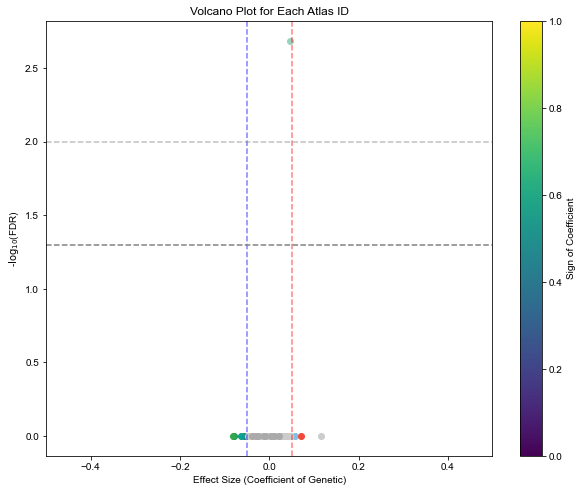

In [599]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
from statsmodels.stats.multitest import multipletests
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')
import numpy as np
import rpy2.robjects as robjects
# Rのインスタンスを取得
r = robjects.r
from rpy2.robjects import pandas2ri
pandas2ri.activate()
# Rのライブラリをロード
r = robjects.r
r('library(MASS)')

def run_glm (data):
    try:
        # R環境にデータフレームを渡す
        ro.globalenv['data'] = pandas2ri.py2rpy(data)
        # pdfClusterを実行
        r_code = '''
        library(MASS)
        model <- glm.nb('log_All_cell_count ~ Age', data = data)
        coef <- summary(model)$coefficients["Age", "Estimate"]
        p_value <- summary(model)$coefficients["Age", "Pr(>|z|)"]
        c(coef, p_value)
        '''
        #results_ <- summary(model)
        #results_ <- summary(model)
        #p_value <- summary(model)$Coefficients["Genetic", "Pr(>|z|)"]
        #coef <- summary(model)$Coefficients["Genetic", "coef"]
        ro.r(r_code)

        results = ro.r(r_code)

        coef = results[0]
        p_value = results[1]
        print(f"Coefficient: {coef}, p-value: {p_value}")
    except:
        coef, p_value = 0.0, 1.0
        print(f"Coefficient: {coef}, p-value: {p_value}")
    return coef, p_value

def run_linear_regression(data):
    # R環境にデータフレームを渡す
    ro.globalenv['data'] = pandas2ri.py2rpy(data)
    # lmを実行
    r_code = '''
    library(stats)  # lm() 関数を使うために必要
    model <- lm(log_All_cell_count ~ Age, data = data)
    coef <- summary(model)$coefficients["Age", "Estimate"]
    p_value <- summary(model)$coefficients["Age", "Pr(>|t|)"]
    c(coef, p_value)
    '''
    results = ro.r(r_code)
    
    coef = results[0]
    p_value = results[1]
    print(f"Coefficient: {coef}, p-value: {p_value}")
    
    return coef, p_value

# サンプルごとにデータを読み込んで 'Condition' 列を追加する関数を修正
def load_data(sample_info):
    df_list = []
    for sample, condition in sample_info:  # sample_infoには(sample_path, condition)のタプルが格納されている
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]

            cellome_file = fw_dir_nu + "/Regional_cellome4.csv" #"/Regional_cellome4_WM_mask_ver1_volume_revised.csv"

            if os.path.exists(cellome_file):  # 確認するファイルパスに注意
                print(sample)
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition  # 'Condition' 列を追加
                df['Sample'] = sample  # サンプル名を追加
                df_list.append(df)
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")

    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()


# Healthy controlとDiseaseのサンプル情報のタプルを取得
healthy_sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in ["APP_1m", "APP_3m", "APP_5m", "APP_7m", "APP_9m"] for s in conditions[c]]
#healthy_sample_info = [(s, c) for c in ["WT_7m", "WT_9m"] for s in conditions[c]]
#disease_sample_info = [(s, c) for c in [  "APP_7m", "APP_9m"] for s in conditions[c]]

# データを読み込む
healthy_data = load_data(healthy_sample_info)
#disease_data = load_data(disease_sample_info)

# サンプルごとの総和で正規化
#healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1+ density (/mm3)'].transform('sum')
#healthy_data['Iba1_ratio'] = healthy_data['Iba1+ density (/mm3)'] / healthy_data['Total_Iba1']
healthy_data['Total_Iba1'] = healthy_data.groupby('Sample')['Iba1_cell_count'].transform('sum')+healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')+healthy_data.groupby('Sample')['Others_cell_count'].transform('sum')
healthy_data['Iba1_ratio'] = (healthy_data['Iba1_cell_count']+healthy_data['NeuN_cell_count']+healthy_data['Others_cell_count']) / healthy_data['Total_Iba1']

#healthy_data['Total_NeuN'] = healthy_data.groupby('Sample')['NeuN_cell_count'].transform('sum')
#healthy_data['NeuN_ratio'] = healthy_data['NeuN_cell_count'] / healthy_data['Total_NeuN']

# AgeとGeneticの列を追加
healthy_data['Age'] = healthy_data['Condition'].str.extract('(\d+)m').astype(int)
healthy_data['Genetic'] = 0  # Healthyは0
#disease_data['Age'] = disease_data['Condition'].str.extract('(\d+)m').astype(int)
#disease_data['Genetic'] = 1  # Diseaseは1


def normalize_and_calculate_difference(data):
    # atlasIDごとにループ
    for atlas_id in data['atlasID'].unique():
        # 各年齢、各ジェネティックタイプに対して正規化を実行
        for age in data['Age'].unique():
            avg_ctr = data[(data['atlasID'] == atlas_id) & (data['Genetic'] == 0) & (data['Age'] == age)]['NeuN+ density (/mm3)'].mean()
            
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 0)]['NeuN+ density (/mm3)'] - avg_ctr 
            data.loc[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1), 'Normalized'] = data[(data['atlasID'] == atlas_id) & (data['Age'] == age) & (data['Genetic'] == 1)]['NeuN+ density (/mm3)'] - avg_ctr
        #mini = data.loc[(data['atlasID'] == atlas_id), 'Normalized'].min()
        #data.loc[(data['atlasID'] == atlas_id),'Normalized'] = data.loc[(data['atlasID'] == atlas_id),'Normalized'].copy() - mini
    return data

# データを結合
#all_data = pd.concat([healthy_data, disease_data])
all_data = healthy_data #disease_data

#all_data = normalize_and_calculate_difference(all_data)
all_data['log_All_cell_count'] = 0
# 全サンプルにわたるAgeの平均を計算
#mean_age = all_data['Age'].mean()
#print(mean_age)
#all_data["Age"] = all_data["Age"] - mean_age

# 線形回帰モデルの作成
results = {}
for atlas_id in all_data['atlasID'].unique():
    print(atlas_id)
    data = all_data[all_data['atlasID'] == atlas_id]
    
    
    #data['log_All_cell_count'] = np.round(data['Iba1+ density (/mm3)']) #np.round(data['Iba1_ratio'] *1000)
    data['log_All_cell_count'] = data['Iba1_ratio'] *1000
    #data['log_All_cell_count'] = np.round(data['NeuN_ratio'] *1000)
    
    data = data.dropna(subset=['log_All_cell_count'])
    
    all_data['log_All_cell_count'][all_data['atlasID'] == atlas_id] = data['log_All_cell_count'].copy()
    if data['log_All_cell_count'].sum() <= 0.0:
        results[atlas_id] = [0.0, 1.0]
        print(f"No non-zero data available for atlas ID {atlas_id}. Skipping...")
        continue
    results[atlas_id] = run_glm(data)

volcano_data = pd.DataFrame({
    'AtlasID': list(results.keys()),
    'coef': [result[0] for result in results.values()],
    'pvalue': [result[1] for result in results.values()]

})

# BH法による多重検定補正
volcano_data['pvalue'][volcano_data['pvalue'] == 0.0] = 1.0
_, p_adjusted, _, _ = multipletests(volcano_data['pvalue'], method='fdr_bh')

# 補正後のp-valueをデータフレームに追加
volcano_data['adjusted_pvalue'] =  p_adjusted
volcano_data['-log10(adjusted_pvalue)'] = -np.log10(volcano_data['adjusted_pvalue'])

# ID を基準にして volcano_data に RGB 値をマージ
volcano_data = pd.merge(volcano_data, data_GO[['id', 'R', 'G', 'B']], left_on='AtlasID', right_on='id', how='left')

# RGB 値を正規化
volcano_data['color'] = volcano_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)

#volcano_data['log2(coef)'] = np.log2(volcano_data['coef'])

###########################

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 10  # Adjust the size as needed

# ボルカノプロットの描画
plt.figure(figsize=(10, 8))
for _, row in volcano_data.iterrows():
    plt.scatter(row['coef'], row['-log10(adjusted_pvalue)'], color=row['color'])

plt.xlabel("Effect Size (Coefficient of Genetic)")
plt.ylabel(r'-$\log_{10}$(FDR)')  # LaTeX形式で下付き文字を使用
plt.title('Volcano Plot for Each Atlas ID')
plt.xlim(-0.5,0.5)
#plt.ylim(-0.5,10)
plt.axvline(x=-0.05, color='blue', linestyle='--', alpha = 0.5)
plt.axvline(x=0.05, color='red', linestyle='--', alpha = 0.5)
plt.axhline(y=-np.log10(0.05), color='grey', linestyle='--', alpha = 1.0)
plt.axhline(y=-np.log10(0.01), color='grey', linestyle='--', alpha = 0.5)
plt.colorbar(label='Sign of Coefficient')
plt.show()    


0
0


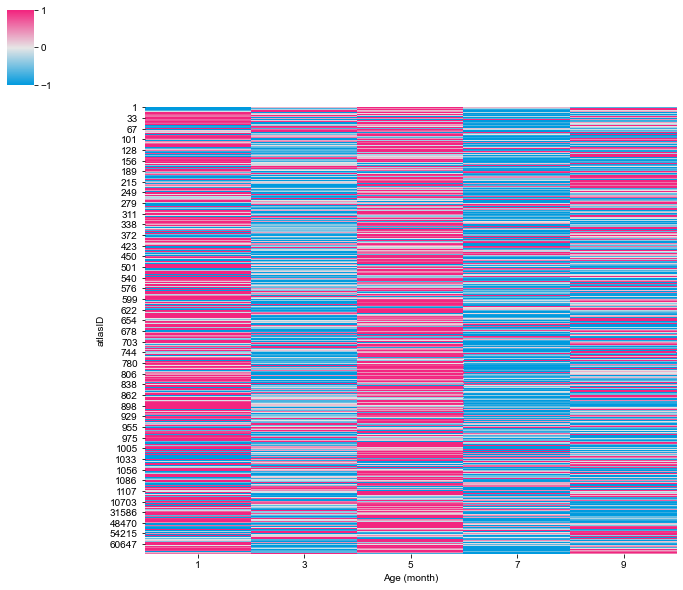

In [600]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
import matplotlib.colors as mcolors
import json

# Function to load data and extract 'Iba1+ density (/mm3)' with Condition
def load_and_extract_data(sample_info, conditions):
    df_list = []
    for sample, condition in sample_info:
        param_path = f"/home/mitani/CUBIC-informatics/param/Neuronomics/{sample}/param_multichannel-rank.json"
        try:
            with open(param_path) as f:
                param = json.load(f)
            fw_dir_nu = param["dst_basedir"]
            cellome_file = fw_dir_nu + "/Regional_cellome4.csv"
            if os.path.exists(cellome_file):
                df = pd.read_csv(cellome_file)
                df['Condition'] = condition
                df['Sample'] = sample
                df_list.append(df[['atlasID','NeuN+ density (/mm3)', 'Iba1+ density (/mm3)', 'Condition']])
            else:
                print(f"File not found: {cellome_file}")
        except Exception as e:
            print(f"Error loading data for {sample}: {e}")
    
    return pd.concat(df_list, ignore_index=True) if df_list else pd.DataFrame()

# Prepare sample info
sample_info = [(s, c) for c in ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ] for s in conditions[c]]
column_order = ["WT_1m", "WT_3m","WT_5m", "WT_7m", "WT_9m", ]

# Load and extract data
data = all_data[(all_data["Genetic"] == 0)] #load_and_extract_data(sample_info, conditions)

# Pivot the data for heatmap and calculate mean density for each atlasID and condition
data_pivot = data.pivot_table(index='atlasID', columns='Condition', values='log_All_cell_count', aggfunc='mean')

# Fill NaN with column means and check if entire columns were NaN
data_pivot = data_pivot.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Reorder columns based on specified order
data_pivot = data_pivot[column_order]

# Ensure the data is numeric
data_pivot = data_pivot.apply(pd.to_numeric, errors='coerce')

# Normalize data by row using Z-score
data_normalized = data_pivot.apply(zscore, axis=1, nan_policy='omit')

# Convert the list of values into a DataFrame with numeric values
data_normalized = pd.DataFrame(data_normalized.tolist(), index=data_pivot.index, columns=data_pivot.columns)

# Handle any potential NaN or inf values
data_normalized = data_normalized.fillna(0).replace([np.inf, -np.inf], 0)

def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

colorlist = []

# Assuming data_GO and its 'id' column are defined elsewhere in the code
for atlas_id in data_pivot.index:
    for i in range(len(data_GO)): # Adjust length to the actual number of rows in data_GO
        if data_GO["id"].values[i] == atlas_id:
            colorlist.append((data_GO["R"].values[i]/255, data_GO["G"].values[i]/255, data_GO["B"].values[i]/255))
    colorlist_671 = colorlist

# Using the new custom colormap
cmap = create_custom_cmap()

# Validate data before plotting
print(data_normalized.isnull().sum().sum())  # Should be 0
print(np.isinf(data_normalized).sum().sum())  # Should be 0

# Create cluster map and capture the Axes object
clustergrid = sns.clustermap(data_normalized, method="average", cmap=cmap, vmin=-1, vmax=1, row_cluster=False, col_cluster=False, 
                             figsize=(12, 10), cbar_kws={'ticks': [-1, 0, 1]})

# Customize the x-axis labels
clustergrid.ax_heatmap.set_xticklabels([str(x).replace("WT_", "").replace("m", "") for x in column_order],)  # Replaces 'APP_1m' with '1', etc.
clustergrid.ax_heatmap.set_xlabel('Age (month)', )  # Change 'Condition' to 'Age (month)'

# Move atlasID to the left side
clustergrid.ax_heatmap.yaxis.tick_left()  # Move y-axis labels to the left
clustergrid.ax_heatmap.yaxis.set_label_position("left")  # Set the y-axis label position to left

# PDFとして図を保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_Microglia_gradient_heatmap.pdf', 
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


In [601]:
# CSVファイルとして保存
data_pivot.to_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Total_cell_ratio_all.csv', index=True)

Start time: 2024-10-02 20:48:25.361893
0      0.573210
1      0.858948
2      0.967430
3      0.994003
4      0.969501
         ...   
666    0.535104
667    0.748727
668    0.960556
669    0.778547
670    0.654396
Name: dpt_pseudotime, Length: 671, dtype: float32


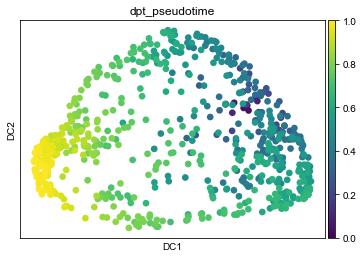

End time after X: 2024-10-02 20:48:25.841789
Duration for UMAP: 0:00:00.479896


In [602]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Total_cell_ratio_all.csv', index_col='atlasID')

# 欠損値を各列の平均値で埋める
data_pivot = X#.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = data_pivot.apply(zscore, axis=1).fillna(0)

# 各行がリストになっているので、それを展開して2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定
adata.uns['iroot'] = 240 #597 #532 #634

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()


# 実行時間の計測
end_time1 = datetime.datetime.now()
print("End time after X:", end_time1)
print("Duration for UMAP:", end_time1 - start_time)


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


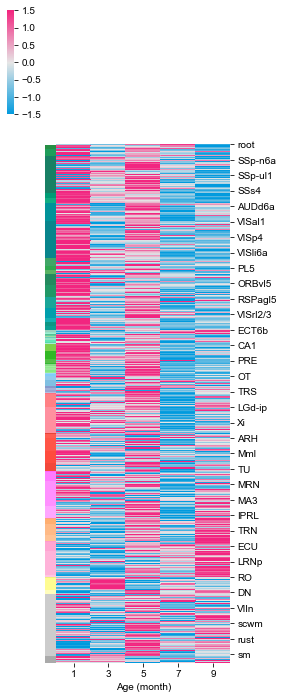

In [603]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# data_GO の id の順番に従って並び替える
sorted_order = data_GO['id']  # 並び替え順
sorted_data_df = sorted_data_df.reindex(sorted_order)

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df, cmap=cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_before_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


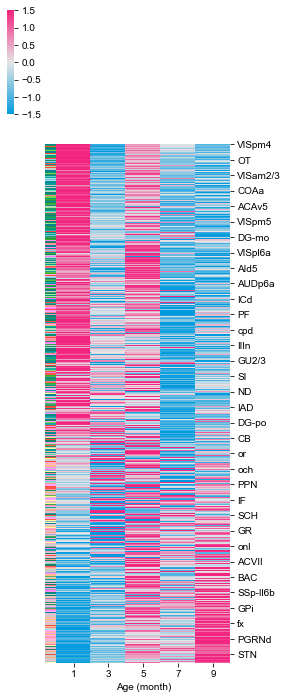

In [604]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 欠損値を列ごとの平均で埋める
data_pivot = X.apply(lambda col: col.fillna(col.mean()) if not col.isnull().all() else col.fillna(0))

# Zスコアで正規化し、NaNを0で置換
data_normalized = data_pivot.apply(zscore, axis=1)

# リスト状のデータを各列に展開
data_normalized_df = pd.DataFrame(data_normalized.tolist(), index=data_normalized.index)

# NaN 値を 0 で置換
data_normalized_df = data_normalized_df.fillna(0)

# adata.obs のインデックスに対応する atlasID を data_normalized_df のインデックスに基づいて再設定
adata.obs['atlasID'] = data_normalized_df.index

# data_normalized_df のインデックスに基づいて、すべての atlasID に対応する dpt_pseudotime を取得
# atlasID に基づいてマージ
merged_data = pd.merge(
    data_normalized_df, 
    adata.obs[['atlasID', 'dpt_pseudotime']], 
    left_index=True, right_on='atlasID', 
    how='left'
)

# pseudotime に基づいて並べ替え
merged_data = merged_data.sort_values(by='dpt_pseudotime')

# 並べ替え後に pseudotime をデータから取り出す
sorted_pseudotime_full = merged_data['dpt_pseudotime']

# 並べ替えられたデータを整理
sorted_data_df = merged_data.drop(columns=['atlasID', 'dpt_pseudotime'])

# データがすべて数値であることを確認
sorted_data_df = sorted_data_df.apply(pd.to_numeric, errors='coerce')

# NaNや無効な値を確認し、すべてを数値に変換
sorted_data_df = sorted_data_df.fillna(0)
sorted_data_df = sorted_data_df.astype(float)

# 元の atlasID を取得し、sorted_data_df のインデックスに再設定する
sorted_data_df.index = merged_data['atlasID']

# acronymのインデックスを取得するために、sorted_data_df.index と data_id['id'] の共通部分のみを使用
acronyms = data_id.set_index('id').loc[sorted_data_df.index, 'acronym']

# colorlist の生成（atlasID と一致させる）
colorlist = []
for atlas_id in sorted_data_df.index:
    if atlas_id in data_GO['id'].values:
        match = data_GO[data_GO['id'] == atlas_id]
        color = (match['R'].values[0] / 255, match['G'].values[0] / 255, match['B'].values[0] / 255)
        colorlist.append(color)

# 色リストがソートされたインデックスに対応しているかを確認
if len(colorlist) == len(sorted_data_df):
    colorlist_671 = colorlist
else:
    print(f"色リストの長さがデータと一致していません。"
          f"colorlist length: {len(colorlist)}, data length: {len(sorted_data_df)}")

# カスタムカラーマップを作成
def create_custom_cmap():
    colors = [(0.0, 154/255, 222/255), (0.9, 0.9, 0.9), (0.95, 0.15, 0.5)] 
    #colors = [(0/255,180/255,255/255), (0/255,80/255,150/255), (190/255, 190/255, 190/255), (100/255,255/255, 0/255), (0,255/255, 0/255)]  # Using Matplotlib's named colors
    # Alternatively, you can use RGB tuples like:
    # colors = [(0, 0, 1), (0.5, 0.5, 0.5), (0, 1, 0)]  # RGB for Blue, Gray, Green
    cmap_name = "custom_cmap"
    return mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)

cmap = create_custom_cmap()

# clustermapプロット
g = sns.clustermap(sorted_data_df,  cmap = cmap, row_colors=colorlist_671, vmin=-1.5, vmax=1.5, 
                   row_cluster=False, col_cluster=False, figsize=(4, 12))

# x軸のラベルを 1, 3, 5, 7, 9 に変更
g.ax_heatmap.set_xticks(np.arange(len(sorted_data_df.columns))+0.5)  # デフォルトの位置に x の ticks を配置
g.ax_heatmap.set_xticklabels([1, 3, 5, 7, 9], rotation=0)  # ラベルを 1, 3, 5, 7, 9 に変更

# x軸のタイトルを Age (month) に設定
g.ax_heatmap.set_xlabel("Age (month)")#, fontsize=12)
g.ax_heatmap.set_ylabel("", fontsize=12)
# y軸のラベル（region名）を設定
step = 20  # ラベルの間隔を調整
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)

# Adjust layout to avoid overlap and save as a single figure
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Regional_Abeta_heatmap_after_Pseudotime_reordered.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


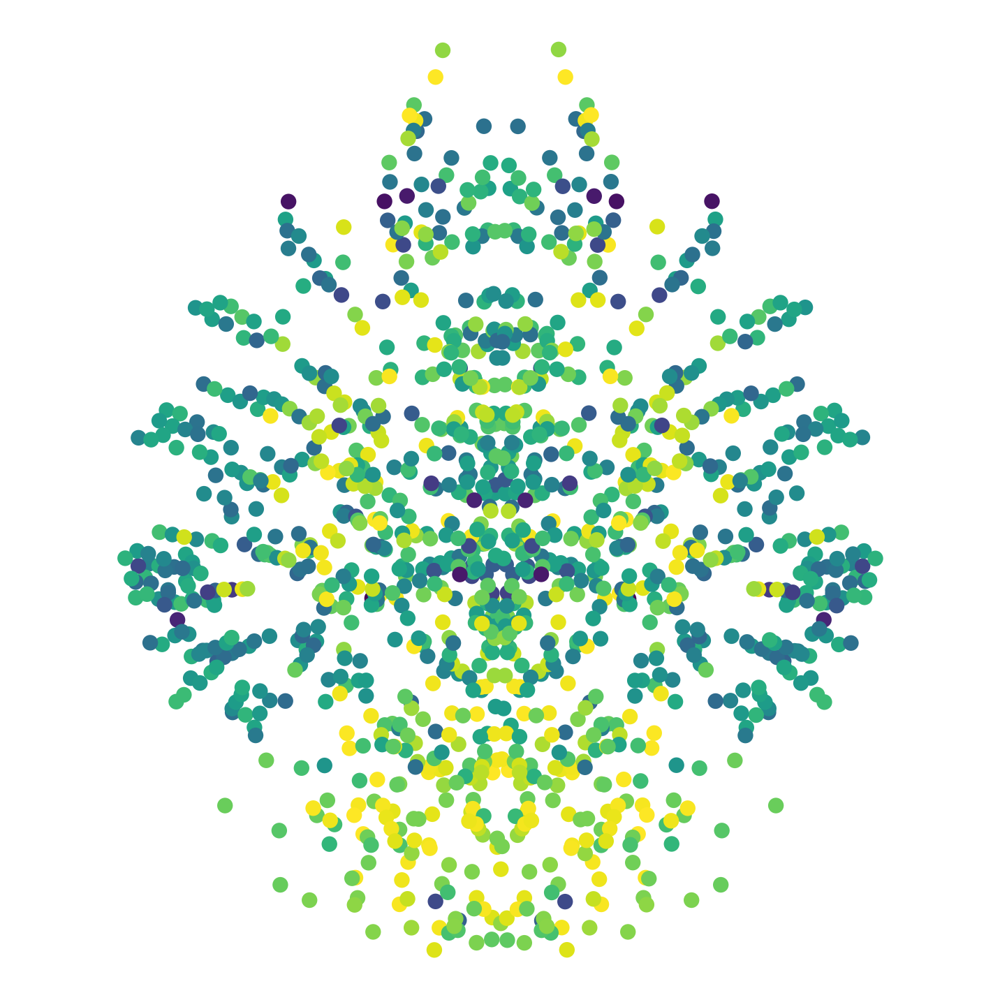

In [605]:
# atlasID が適切に設定されていることを確認する
# adata.obs に atlasID が含まれていることを前提にします
if 'atlasID' not in adata.obs.columns:
    adata.obs['atlasID'] = data_normalized.index

# pseudotime_df を adata.obs から作成し、インデックスを atlasID にする
pseudotime_df = pd.DataFrame(adata.obs[['atlasID', 'dpt_pseudotime']])

# pseudotime_df のインデックスを data_normalized のインデックス（atlasID）に基づいて設定
pseudotime_df = pseudotime_df.set_index('atlasID')

# data_normalized のインデックスに対応して pseudotime の値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['dpt_pseudotime'])

# pseudotime が NaN の場合は 0 で補完（必要に応じて）
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridis_rカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
#plt.title('Centroids of Left and Right Brain with Pseudotime Coloration')
#plt.xlabel('X (um)')
#plt.ylabel('Y (um)')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
#plt.colorbar(sc, label='Pseudotime from Abeta PCA')  # カラーバーを追加
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Whole_brain_plot_of_Regional_Abeta_psedotime.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot
plt.show()


Start time: 2024-10-02 20:48:28.701178
0       0.573705
1       0.689643
2       0.854953
3       0.969582
4       0.902146
          ...   
1337    0.517207
1338    0.892591
1339    0.653371
1340    0.154099
1341    0.660139
Name: dpt_pseudotime, Length: 1342, dtype: float32


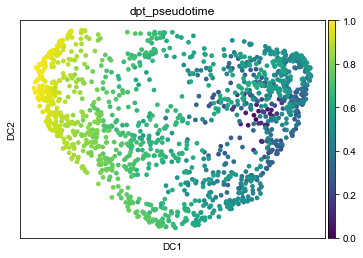

T-test p-value for pseudotime comparison: 1.7755129954880667e-16
WT mean pseudotime: 0.576799369304706
APP mean pseudotime: 0.6505211044086252


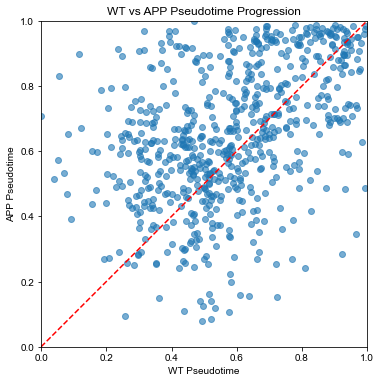

End time: 2024-10-02 20:48:29.743006
Total duration: 0:00:01.041828


In [606]:
import datetime
import pandas as pd
import numpy as np
from scipy.stats import zscore
import anndata
import scanpy as sc
import matplotlib.pyplot as plt
from scipy.stats import ttest_rel

start_time = datetime.datetime.now()
print("Start time:", start_time)

# CSVファイルを読み込む
X = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Total_cell_ratio_all.csv', index_col='atlasID')
X2 = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Total_cell_ratio_all.csv', index_col='atlasID')

# 列名を修正して、WTとAPPの違いをなくし、時間ベースで統一する
X.columns = ['1m', '3m', '5m', '7m', '9m']
X2.columns = ['1m', '3m', '5m', '7m', '9m']

# WTとAPPのデータを結合（行方向に）
combined_data = pd.concat([X, X2], axis=0, keys=['WT', 'APP'])

# Zスコアでデータを正規化し、ゼロ分散を持つ行に対してNaNを0に置換
data_normalized = combined_data.apply(zscore, axis=1).fillna(0)

# 各行を2次元のnumpy配列に変換
X_matrix = np.vstack(data_normalized)

# 無効な値（NaNや無限大）が含まれていないか確認し、置換
X_matrix_cleaned = np.nan_to_num(X_matrix, nan=0, posinf=0, neginf=0)

# AnnDataオブジェクトに変換
adata = anndata.AnnData(X_matrix_cleaned)

# 最近傍グラフの計算
sc.pp.neighbors(adata, use_rep='X', n_neighbors=15)

# ルートセルの設定（適切なセルインデックスを設定）
adata.uns['iroot'] = 240#597+671  # 適切なセルをルートとして設定

# 拡散マップの計算
sc.tl.diffmap(adata)

# 疑似時間の計算
sc.tl.dpt(adata)

# pseudotimeを取得
pseudotime = adata.obs['dpt_pseudotime'].values
# 疑似時間の表示
print(adata.obs['dpt_pseudotime'])

# 拡散マップを表示
sc.pl.diffmap(adata, color=['dpt_pseudotime'], cmap='viridis',show=False)

# plt.savefigで直接PDFに保存
#plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_diffusion_map.pdf',
#            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# Show the plot (not necessary if it's already saved, but optional)
plt.show()
# pseudotimeをcombined_dataに追加
combined_data['pseudotime'] = pseudotime

# WTとAPPの行インデックスを取得
wt_indices = combined_data.index.get_level_values(0) == 'WT'
app_indices = combined_data.index.get_level_values(0) == 'APP'

# WTとAPPに分割してpseudotimeを割り当てる
combined_data['WT_pseudotime'] = np.nan
combined_data['APP_pseudotime'] = np.nan
combined_data.loc[wt_indices, 'WT_pseudotime'] = combined_data.loc[wt_indices, 'pseudotime']
combined_data.loc[app_indices, 'APP_pseudotime'] = combined_data.loc[app_indices, 'pseudotime']

# WTとAPPの領域ごとのpseudotimeを比較する
# NaNを除外して比較
wt_pseudotime_clean = combined_data['WT_pseudotime'].dropna()
app_pseudotime_clean = combined_data['APP_pseudotime'].dropna()

# Wilcoxon signed-rank test to compare pseudotime progression
stat, p_val = ttest_rel(wt_pseudotime_clean, app_pseudotime_clean)
print(f'T-test p-value for pseudotime comparison: {p_val}')

# APPとWTのpseudotimeの平均値を計算
wt_mean = wt_pseudotime_clean.mean()
app_mean = app_pseudotime_clean.mean()
print(f'WT mean pseudotime: {wt_mean}')
print(f'APP mean pseudotime: {app_mean}')

# Scatter plot to visualize pseudotime progression
plt.figure(figsize=(8,6))
plt.scatter(wt_pseudotime_clean, app_pseudotime_clean, alpha=0.6)
plt.plot([0, 1], [0, 1], 'r--')  # 0-1の範囲でプロット
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('WT Pseudotime')
plt.ylabel('APP Pseudotime')
plt.title('WT vs APP Pseudotime Progression')
plt.gca().set_aspect('equal', adjustable='box')  # 等方的にプロット
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.3/Abeta_pseudotime_comparison_scatter.pdf', dpi=300, bbox_inches='tight')
plt.show()

# 実行時間の計測
end_time = datetime.datetime.now()
print("End time:", end_time)
print("Total duration:", end_time - start_time)

               1m        3m        5m        7m        9m
atlasID                                                  
1        0.994250  0.028667  0.254061 -1.889641  0.612663
2       -1.405131  0.241771  1.577875  0.235208 -0.649724
6       -1.300805 -0.349187  1.487057 -0.611844  0.774779
7       -1.200071 -0.692554  0.498125 -0.267051  1.661551
9       -1.258990 -0.230463  1.144246 -0.825632  1.170839


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


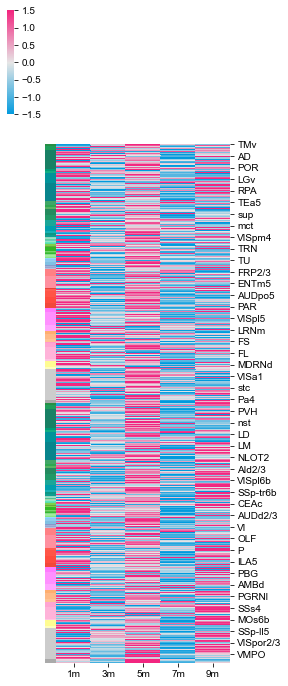

In [607]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Total_cell_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Total_cell_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0 (or handle them as needed)
combined_normalized = combined_normalized.fillna(0)

# Verify that combined_normalized is now a proper DataFrame with numeric values
print(combined_normalized.head())


sorted_index = data_GO['id'].drop_duplicates()

# Generate color list from data_GO
colorlist = [(row['R'] / 255, row['G'] / 255, row['B'] / 255) for idx, row in data_GO.iterrows()]

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap
g = sns.clustermap(
    combined_normalized,
    cmap=create_custom_cmap(),
    row_colors=colorlist * 2,  # Assuming you need to apply the same color list for both WT and APP
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')
# Adjust layout to ensure proper display
plt.tight_layout()

# Show the heatmap
plt.show()

               1m        3m        5m        7m        9m
atlasID                                                  
1        0.994250  0.028667  0.254061 -1.889641  0.612663
2       -1.405131  0.241771  1.577875  0.235208 -0.649724
6       -1.300805 -0.349187  1.487057 -0.611844  0.774779
7       -1.200071 -0.692554  0.498125 -0.267051  1.661551
9       -1.258990 -0.230463  1.144246 -0.825632  1.170839


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:66: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


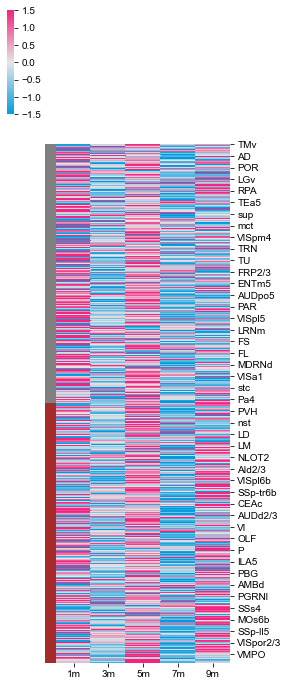

In [608]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Total_cell_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Total_cell_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP)
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Ensure the combined data is numeric
combined_normalized = combined_normalized.apply(pd.to_numeric, errors='coerce')

# Check for any NaN values and fill them with 0 (or handle them as needed)
combined_normalized = combined_normalized.fillna(0)

# Verify that combined_normalized is now a proper DataFrame with numeric values
print(combined_normalized.head())

# Create a color mapping for WT (gray) and APP (brown)
row_colors = ['gray'] * len(X_wt_normalized) + ['brown'] * len(X_app_normalized)

# Custom colormap for heatmap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot using seaborn's clustermap
g = sns.clustermap(
    combined_normalized,
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply WT (gray) and APP (brown) colors
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized.index, 'acronym']  # Get matching acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set the ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Set the labels at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout to ensure proper display
plt.tight_layout()

# Show the heatmap
plt.show()


/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


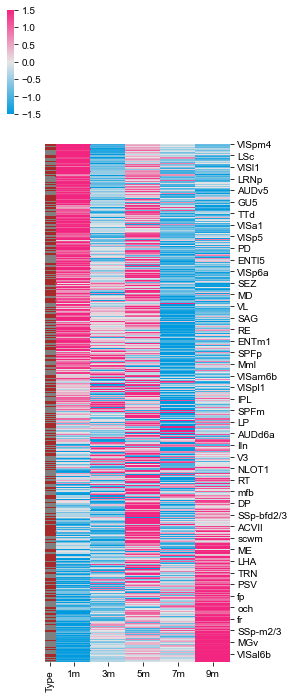

In [609]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Total_cell_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Total_cell_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)

# Generate WT/APP annotation colors based on the 'Type' column after sorting
row_colors = combined_normalized_sorted['Type'].map({'WT': 'gray', 'APP': 'brown'})

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply WT/APP color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

/home/mitani/my_env/lib/python3.6/site-packages/ipykernel_launcher.py:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


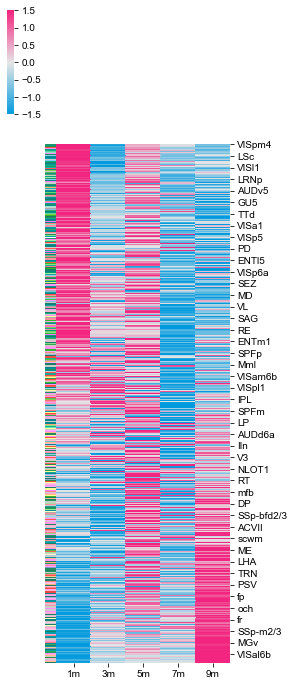

In [610]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import matplotlib.colors as mcolors
import anndata
import scanpy as sc

# Load data
X_wt = pd.read_csv('/export3/Imaging/ds4_Data4/Region/WT_Whole_brain_normalized_Total_cell_ratio_all.csv')
X_app = pd.read_csv('/export3/Imaging/ds4_Data4/Region/APP_Whole_brain_normalized_Total_cell_ratio_all.csv')

# Ensure the data is set with 'atlasID' as index
X_wt.set_index('atlasID', inplace=True)
X_app.set_index('atlasID', inplace=True)

# Align columns by renaming to be consistent across both datasets
X_wt.columns = ['1m', '3m', '5m', '7m', '9m']
X_app.columns = ['1m', '3m', '5m', '7m', '9m']

# Apply z-score normalization across rows (for each region) and expand lists into DataFrame properly
X_wt_normalized = pd.DataFrame(zscore(X_wt, axis=1), index=X_wt.index, columns=X_wt.columns)
X_app_normalized = pd.DataFrame(zscore(X_app, axis=1), index=X_app.index, columns=X_app.columns)

# Combine the two datasets (WT and APP) with an identifier for each type
X_wt_normalized['Type'] = 'WT'
X_app_normalized['Type'] = 'APP'
combined_normalized = pd.concat([X_wt_normalized, X_app_normalized], axis=0)

# Extract pseudotime and add it to the combined data (assuming pseudotime calculation is already done)
pseudotime = adata.obs['dpt_pseudotime'].values
combined_normalized['pseudotime'] = pseudotime

# Sort the data based on pseudotime in ascending order
combined_normalized_sorted = combined_normalized.sort_values('pseudotime', ascending=True)



# Create a dictionary mapping atlasID (from combined_normalized_sorted) to colors from data_GO
id_to_color = {
    row['id']: (row['R'] / 255, row['G'] / 255, row['B'] / 255) 
    for idx, row in data_GO.iterrows()
}

# Generate the row_colors based on the region ID in the sorted data
row_colors = combined_normalized_sorted.index.map(lambda idx: id_to_color.get(idx, (0.5, 0.5, 0.5)))  # Default to gray if not found

# Custom colormap
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# Plot the heatmap
g = sns.clustermap(
    combined_normalized_sorted.drop(columns=['pseudotime', 'Type']),  # Drop pseudotime and type from heatmap
    cmap=create_custom_cmap(),
    row_colors=row_colors,  # Apply region-based color annotation
    col_cluster=False,
    row_cluster=False,
    vmin=-1.5, vmax=1.5,
    figsize=(4, 12)
)

# Assuming you have acronyms and sorted_data_df, adjust y-axis labels
step = 30  # Adjust the step based on how many regions you want to show on the y-axis
acronyms = data_id.set_index('id').loc[combined_normalized_sorted.index, 'acronym']  # Match acronyms for y-axis labels
g.ax_heatmap.set_yticks(np.arange(0, len(acronyms), step))  # Set ticks at the desired step
g.ax_heatmap.set_yticklabels(acronyms[::step], rotation=0)  # Label y-axis at the same step
g.ax_heatmap.set_ylabel('')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


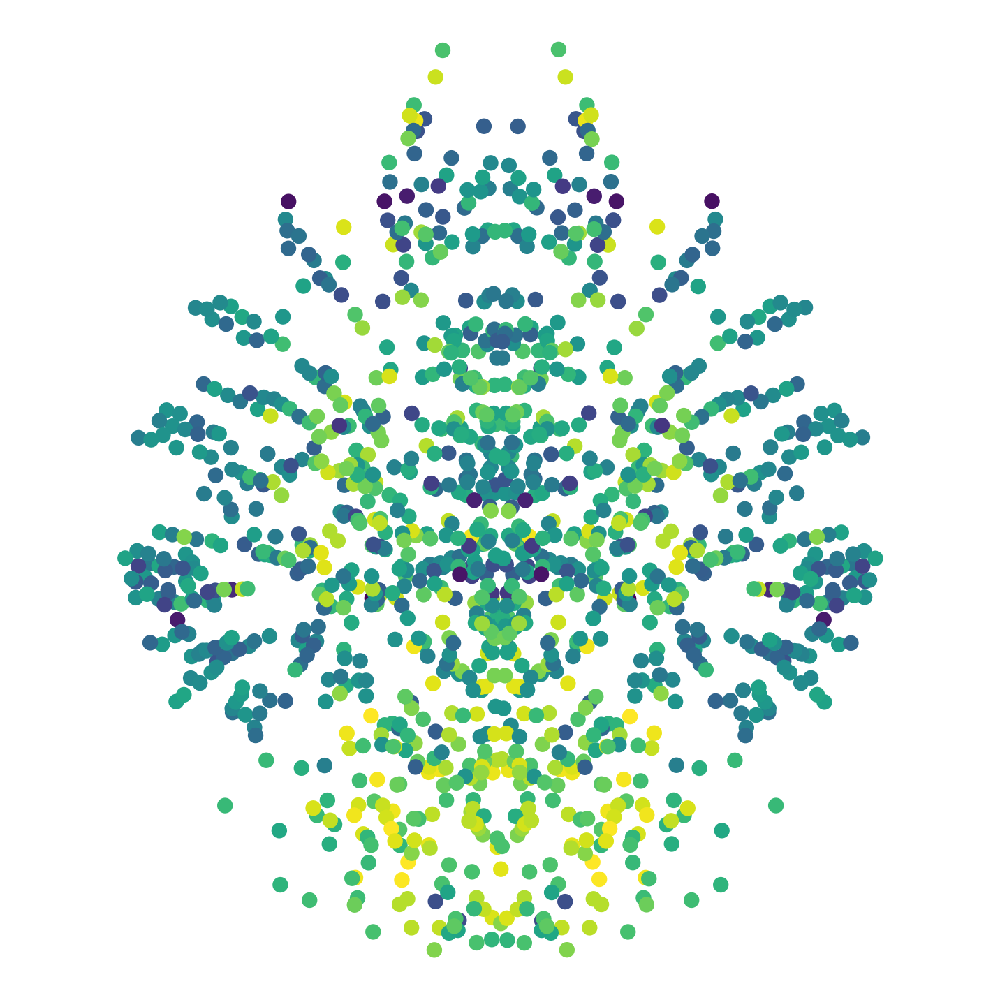

In [611]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# combined_normalizedからTypeがWTの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT']

# WTのpseudotimeを含むDataFrameを作成
pseudotime_df = pd.DataFrame(wt_data['pseudotime'])  # 'pseudotime'を使う
pseudotime_df['atlasID'] = wt_data.index.get_level_values('atlasID')  # 'atlasID'を取得
pseudotime_df.set_index('atlasID', inplace=True)  # インデックスをatlasIDに設定

# all_centroidsにおけるatlasIDに対応してpseudotimeの値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['pseudotime'])

# pseudotimeがNaNの場合は0で補完
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridisカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


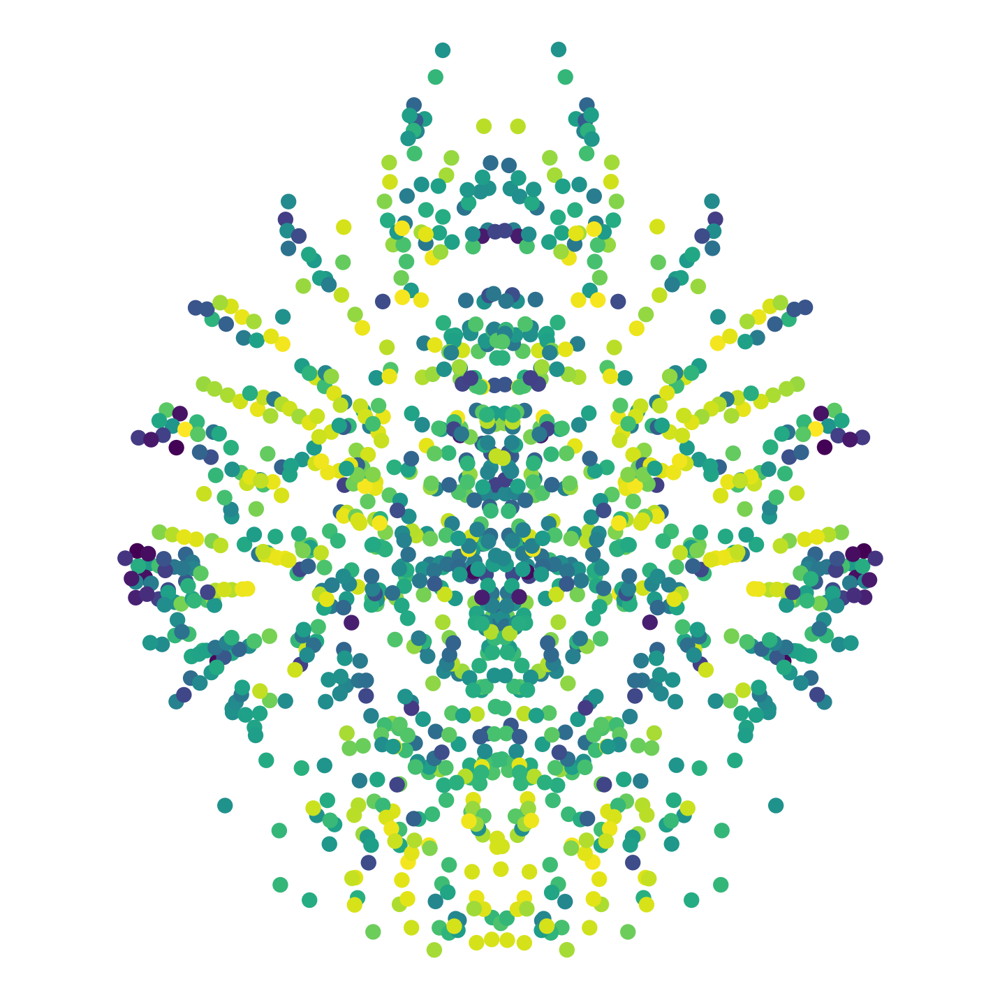

In [612]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# combined_normalizedからTypeがWTの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'APP']

# WTのpseudotimeを含むDataFrameを作成
pseudotime_df = pd.DataFrame(wt_data['pseudotime'])  # 'pseudotime'を使う
pseudotime_df['atlasID'] = wt_data.index.get_level_values('atlasID')  # 'atlasID'を取得
pseudotime_df.set_index('atlasID', inplace=True)  # インデックスをatlasIDに設定

# all_centroidsにおけるatlasIDに対応してpseudotimeの値をマッピング
all_centroids['pseudotime'] = all_centroids['atlasID'].map(pseudotime_df['pseudotime'])

# pseudotimeがNaNの場合は0で補完
all_centroids['pseudotime'] = all_centroids['pseudotime'].fillna(0)

# viridisカラーマップを使用して色情報を生成
cmap = plt.get_cmap('viridis')
norm = plt.Normalize(vmin=all_centroids['pseudotime'].min(), vmax=all_centroids['pseudotime'].max())
all_centroids['colors'] = all_centroids['pseudotime'].apply(lambda x: cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


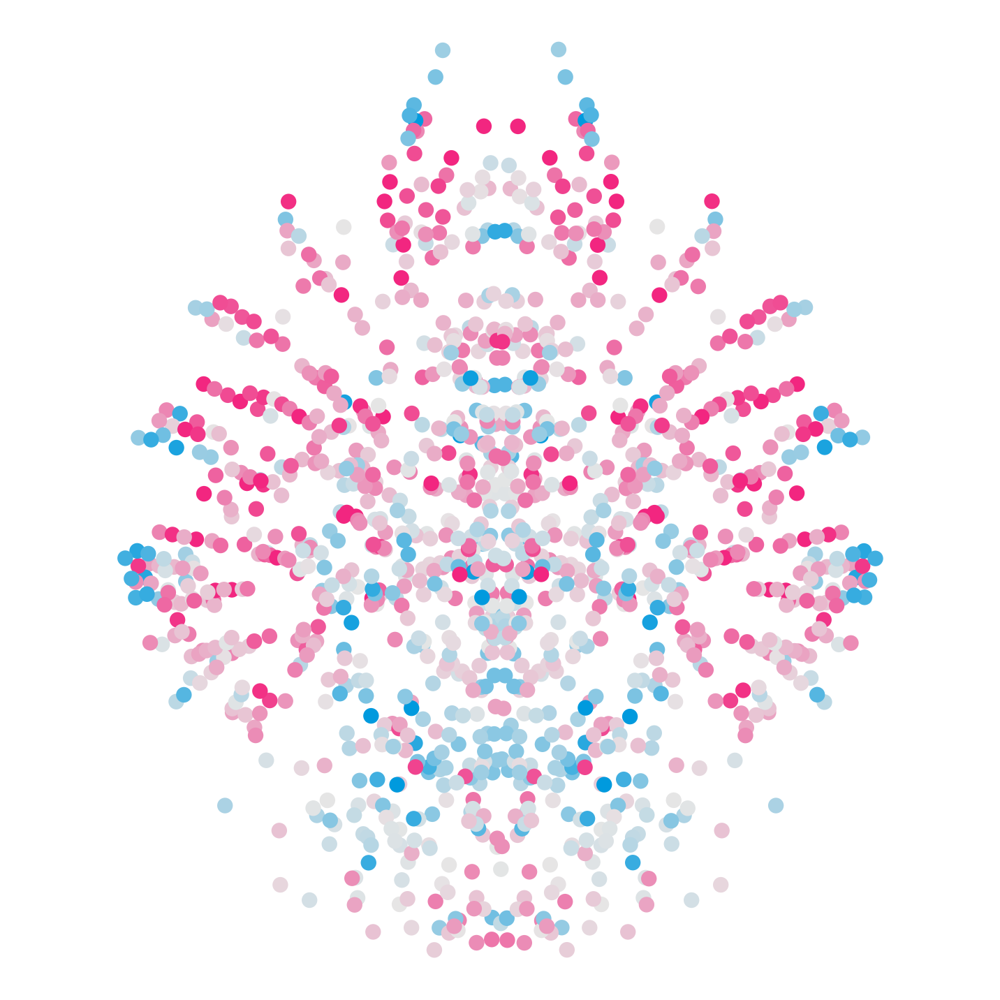

In [613]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

# combined_normalizedからTypeがWTとAPPの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT'] 
app_data = combined_normalized[combined_normalized['Type'] == 'APP'] 

# WTとAPPのpseudotimeを含むDataFrameを作成
pseudotime_wt = pd.DataFrame(wt_data['pseudotime'])
pseudotime_wt['atlasID'] = wt_data.index.get_level_values('atlasID')
pseudotime_wt.set_index('atlasID', inplace=True)

pseudotime_app = pd.DataFrame(app_data['pseudotime'])
pseudotime_app['atlasID'] = app_data.index.get_level_values('atlasID')
pseudotime_app.set_index('atlasID', inplace=True)

# 差分を計算してall_centroidsにマッピング
all_centroids['pseudotime_diff'] = all_centroids['atlasID'].map(pseudotime_app['pseudotime']) - all_centroids['atlasID'].map(pseudotime_wt['pseudotime'])

# 差分がNaNの場合は0で補完
all_centroids['pseudotime_diff'] = all_centroids['pseudotime_diff'].fillna(0)

# カスタムカラーマップを作成
def create_custom_cmap():
    return mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
        (0.0, 154/255, 222/255), 
        (0.9, 0.9, 0.9), 
        (0.95, 0.15, 0.5)
    ])

# カラーマップの生成
custom_cmap = create_custom_cmap()

# 色の範囲を設定
vmin = -0.5#all_centroids['pseudotime_diff'].min()  # 最小値を設定
vmax = 0.5 #all_centroids['pseudotime_diff'].max()  # 最大値を設定

# 差分に基づいて色を生成
norm = plt.Normalize(vmin=vmin, vmax=vmax)
all_centroids['colors'] = all_centroids['pseudotime_diff'].apply(lambda x: custom_cmap(norm(x)))

# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=all_centroids['colors'], edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

# カラーバーを追加
#cbar = plt.colorbar(sc, cmap=custom_cmap)  # カスタムカラーマップを使用
cbar.set_label('Pseudotime Difference (APP - WT)')  # カラーバーのラベルを設定
cbar.set_ticks([vmin, 0, vmax])  # カラーバーの目盛りを設定
cbar.ax.invert_yaxis()  # カラーバーのY軸を反転

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


100


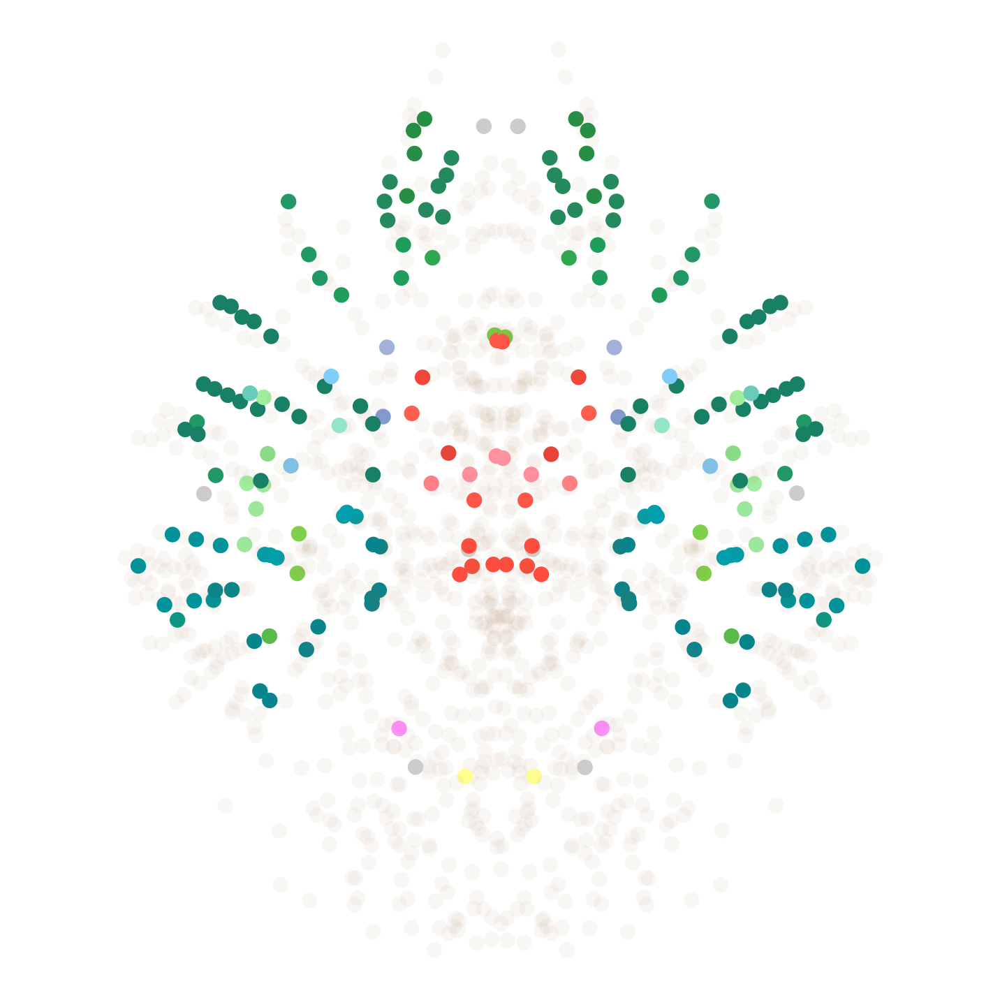

In [614]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors as mcolors

# combined_normalizedからTypeがWTとAPPの行を取得
wt_data = combined_normalized[combined_normalized['Type'] == 'WT'] 
app_data = combined_normalized[combined_normalized['Type'] == 'APP'] 

# WTとAPPのpseudotimeを含むDataFrameを作成
pseudotime_wt = pd.DataFrame(wt_data['pseudotime'])
pseudotime_wt['atlasID'] = wt_data.index.get_level_values('atlasID')
pseudotime_wt.set_index('atlasID', inplace=True)

pseudotime_app = pd.DataFrame(app_data['pseudotime'])
pseudotime_app['atlasID'] = app_data.index.get_level_values('atlasID')
pseudotime_app.set_index('atlasID', inplace=True)

# 差分を計算してall_centroidsにマッピング
all_centroids['pseudotime_diff'] = all_centroids['atlasID'].map(pseudotime_app['pseudotime']) - all_centroids['atlasID'].map(pseudotime_wt['pseudotime'])

# 差分がNaNの場合は0で補完
all_centroids['pseudotime_diff'] = all_centroids['pseudotime_diff'].fillna(0)

# 上位100のregionを選択
top_100 = all_centroids.nlargest(200, 'pseudotime_diff')
print(len(np.unique(top_100["atlasID"])))

def get_color(row, data_GO, top_100_ids):
    atlas_id = row['atlasID']
    if atlas_id in top_100_ids:
        color_row = data_GO[data_GO['id'] == atlas_id]
        if not color_row.empty:
            return [
                color_row['R'].values[0] / 255,
                color_row['G'].values[0] / 255,
                color_row['B'].values[0] / 255,
                1.0  # 完全不透明
            ]
    return [0.6, 0.4, 0.2, 0.05]  # default color with low alpha if no match found or not in top_100

# top_100のatlasIDをセットとして取得
top_100_ids = set(top_100['atlasID'])

# Apply colors to all rows based on atlasID, only modifying those in top_100
all_centroids['colors'] = all_centroids.apply(lambda row: get_color(row, data_GO, top_100_ids), axis=1)


# 散布図をプロット
plt.figure(figsize=(20, 20))
sc = plt.scatter(all_centroids['X(um)'], all_centroids['Y(um)'], s=500, c=np.vstack(all_centroids['colors']), edgecolor='none')
plt.axis('equal')  # 軸を等方的にする
plt.gca().invert_yaxis()  # Y軸を反転
plt.gca().spines['top'].set_visible(False)  # 上の軸線を非表示
plt.gca().spines['right'].set_visible(False)  # 右の軸線を非表示
plt.gca().spines['left'].set_visible(False)  # 左の軸線を非表示
plt.gca().spines['bottom'].set_visible(False)  # 下の軸線を非表示
plt.xticks([])  # X軸の目盛りを非表示
plt.yticks([])  # Y軸の目盛りを非表示

plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Show the plot
plt.show()


In [ ]:
# WM ratioを各regionごとに計算する。

In [670]:
image = tifffile.imread("/export2/Imaging/ds4_Data4/Cellome/30_distance_map_using_0.43812782_Threshed_Mask_WM_and_GM.tif")

In [671]:
image.shape

(800, 1320, 1140)

In [672]:
annotation_10 = tifffile.imread('/export2/Imaging/ds4_Data4/atlas/annotation_10_LUT_modified_final.tif') 

In [673]:
annotation_10.shape

(800, 1320, 1140)

In [674]:
data_GO

,id,graph_order,R,G,B
0,997,0,255,255,255
1,68,7,38,143,69
2,667,8,38,143,69
3,52192,9,38,143,69
4,52196,10,38,143,69
...,...,...,...,...,...
666,129,1299,170,170,170
667,140,1300,170,170,170
668,145,1301,170,170,170
669,153,1302,170,170,170


In [675]:
np.unique(image)

array([0, 1, 2, 3, 4, 5, 6, 7, 8], dtype=uint16)

In [677]:
import numpy as np
import pandas as pd

# 1 voxel の体積 (10um x 10um x 10um)
voxel_volume_mm3 = 0.01 * 0.01 * 0.01

# data_GOのidを含むannotation_10のshapeと同じ配列から、data_GOのidとmicroglia_idを紐付ける
unique_ids = np.unique(annotation_10)
# 0を含まないようにフィルタリング
unique_ids = unique_ids[unique_ids != 0]
data_summary = []

# 保存するmicroglia_idのリスト
microglia_ids_to_check = [1, 2, 3,  4, 5, 6, 7, 8]

# 各idに対して、image（microglia_id）内の該当するvoxelの数とその比率を計算
for id_val in unique_ids:
    print(f'Processing id: {id_val}')
    # annotation_10がid_valに対応する場所のマスクを作成
    id_mask = annotation_10 == id_val
    
    # id_maskがTrueの場所のimageからmicroglia_idを取得
    microglia_in_id = image[id_mask]
    
    # 各microglia_idの数をカウント
    unique_microglia, counts = np.unique(microglia_in_id, return_counts=True)
    
    # voxel数をmm³に変換
    voxel_counts_mm3 = counts * voxel_volume_mm3
    
    # 総voxel数に対する比率を計算
    total_voxels_in_id = np.sum(counts)
    
    # 各microglia_id 1,2,3,4 について、そのvoxel数と比率を確認
    for microglia_id in microglia_ids_to_check:
        if microglia_id in unique_microglia:
            # 対応するmicroglia_idのボクセル数とそのインデックス
            idx = np.where(unique_microglia == microglia_id)[0][0]
            voxel_count = counts[idx]
            voxel_mm3 = voxel_counts_mm3[idx]
            ratio = voxel_count / total_voxels_in_id
        else:
            # 該当するmicroglia_idがない場合、値は0にする
            voxel_count = 0
            voxel_mm3 = 0
            ratio = 0
        
        # 結果を保存
        data_summary.append([id_val, microglia_id, voxel_count, voxel_mm3, ratio])

# 結果をDataFrameに変換
result_df = pd.DataFrame(data_summary, columns=['id', 'microglia_id', 'voxel_count', 'mm3', 'ratio'])

# CSVに保存
result_df.to_csv("/export2/Imaging/ds4_Data4/Cellome/Microglia_id_ratio_by_atlas_id.csv", index=False)

print("CSV file has been saved successfully.")


Processing id: 1
Processing id: 2
Processing id: 6
Processing id: 7
Processing id: 9
Processing id: 10
Processing id: 12
Processing id: 15
Processing id: 17
Processing id: 19
Processing id: 20
Processing id: 23
Processing id: 26
Processing id: 27
Processing id: 28
Processing id: 30
Processing id: 33
Processing id: 35
Processing id: 36
Processing id: 38
Processing id: 41
Processing id: 42
Processing id: 50
Processing id: 52
Processing id: 54
Processing id: 56
Processing id: 58
Processing id: 59
Processing id: 62
Processing id: 63
Processing id: 64
Processing id: 66
Processing id: 67
Processing id: 68
Processing id: 72
Processing id: 74
Processing id: 75
Processing id: 78
Processing id: 81
Processing id: 83
Processing id: 84
Processing id: 88
Processing id: 91
Processing id: 93
Processing id: 96
Processing id: 97
Processing id: 98
Processing id: 100
Processing id: 101
Processing id: 102
Processing id: 105
Processing id: 106
Processing id: 108
Processing id: 113
Processing id: 114
Process

Processing id: 866
Processing id: 867
Processing id: 869
Processing id: 872
Processing id: 873
Processing id: 874
Processing id: 878
Processing id: 880
Processing id: 882
Processing id: 884
Processing id: 888
Processing id: 889
Processing id: 893
Processing id: 897
Processing id: 898
Processing id: 900
Processing id: 902
Processing id: 903
Processing id: 905
Processing id: 906
Processing id: 907
Processing id: 908
Processing id: 910
Processing id: 911
Processing id: 912
Processing id: 914
Processing id: 916
Processing id: 919
Processing id: 924
Processing id: 927
Processing id: 929
Processing id: 930
Processing id: 931
Processing id: 935
Processing id: 936
Processing id: 939
Processing id: 940
Processing id: 943
Processing id: 944
Processing id: 945
Processing id: 946
Processing id: 949
Processing id: 950
Processing id: 951
Processing id: 952
Processing id: 954
Processing id: 955
Processing id: 956
Processing id: 957
Processing id: 959
Processing id: 961
Processing id: 962
Processing i

In [678]:
result_df

,id,microglia_id,voxel_count,mm3,ratio
0,1,1,0,0.000000,0.000000
1,1,2,419,0.000419,0.003887
2,1,3,28447,0.028447,0.263882
3,1,4,59350,0.059350,0.550546
4,1,5,19586,0.019586,0.181685
...,...,...,...,...,...
5363,61277,4,1725,0.001725,0.040962
5364,61277,5,17352,0.017352,0.412044
5365,61277,6,22146,0.022146,0.525883
5366,61277,7,889,0.000889,0.021110


In [679]:
import pandas as pd

# CSVファイルを読み込む
file_path = "/export2/Imaging/ds4_Data4/Cellome/Microglia_id_ratio_by_atlas_id.csv"
df = pd.read_csv(file_path)

# microglia_idが5, 6, 7, 8に該当する行をフィルタリング
df_filtered = df[df['microglia_id'].isin([5, 6, 7, 8])]

# 各idごとにratioを足し算して集計
ratio_sum_by_id = df_filtered.groupby('id')['ratio'].sum().reset_index()

# 結果を表示
print(ratio_sum_by_id)

# CSVに結果を保存したい場合
output_path = "/export2/Imaging/ds4_Data4/Cellome/Microglia_id_ratio_sum_by_id.csv"
ratio_sum_by_id.to_csv(output_path, index=False)

print(f"CSV file has been saved to: {output_path}")


        id     ratio
0        1  0.181685
1        2  0.524664
2        6  0.997883
3        7  0.923837
4        9  0.048706
..     ...       ...
666  60850  1.000000
667  60854  0.999790
668  60858  1.000000
669  60862  0.998899
670  61277  0.959038

[671 rows x 2 columns]
CSV file has been saved to: /export2/Imaging/ds4_Data4/Cellome/Microglia_id_ratio_sum_by_id.csv


WT Spearman correlation: 0.5610775579883555, p-value: 6.574271762761353e-57
APP Spearman correlation: 0.5017669046402353, p-value: 4.481273719141532e-44


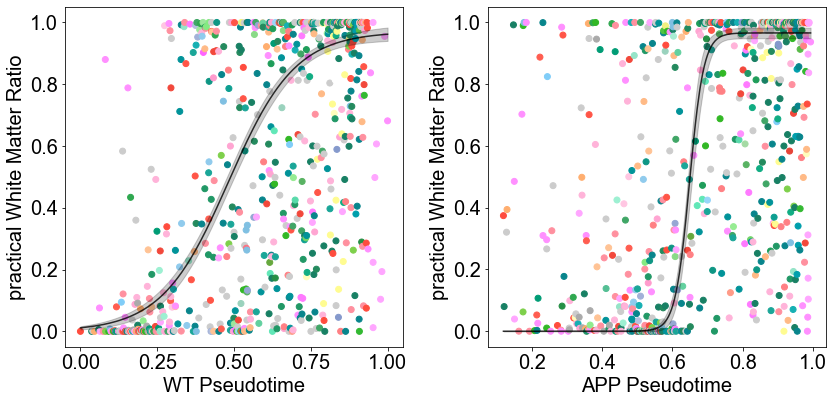

In [977]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from lmfit import Model
import matplotlib
matplotlib.rcParams['pdf.use14corefonts'] = True
plt.rcParams['font.size'] = 20
# Microglia_id_ratio_sum_by_id.csv を読み込む
ratio_data = pd.read_csv('/export2/Imaging/ds4_Data4/Cellome/Microglia_id_ratio_sum_by_id.csv')

# 'id' を 'atlasID' にリネーム（もしまだしていない場合）
ratio_data.rename(columns={'id': 'atlasID'}, inplace=True)
data_GO.rename(columns={'id': 'atlasID'}, inplace=True)  

# WTとAPPの識別を保持するための列を追加
combined_data['group'] = combined_data.index.get_level_values(0)

# WTとAPPのデータをpseudotime付きのcombined_dataと結合するために、atlasIDを用いて結合
combined_data_with_ratio = combined_data.merge(ratio_data, on='atlasID', how='inner')
combined_data_with_ratio = combined_data_with_ratio.merge(data_GO[['atlasID', 'R', 'G', 'B']], on='atlasID', how='inner')

# WTとAPPに分割 (group列で区別)
wt_data = combined_data_with_ratio[combined_data_with_ratio['group'] == 'WT']
app_data = combined_data_with_ratio[combined_data_with_ratio['group'] == 'APP']

# カラー情報の設定
wt_colors = wt_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)
app_colors = app_data.apply(lambda row: (row['R']/255, row['G']/255, row['B']/255), axis=1)


# WTのpseudotimeとratioのSpearman相関を計算
wt_pseudotime = wt_data['WT_pseudotime']
wt_ratio = wt_data['ratio']
if len(wt_pseudotime.dropna()) > 0 and len(wt_ratio.dropna()) > 0:
    spearman_corr_wt, p_val_wt = spearmanr(wt_pseudotime.dropna(), wt_ratio.dropna())
else:
    spearman_corr_wt, p_val_wt = np.nan, np.nan

# APPのpseudotimeとratioのSpearman相関を計算
app_pseudotime = app_data['APP_pseudotime']
app_ratio = app_data['ratio']
if len(app_pseudotime.dropna()) > 0 and len(app_ratio.dropna()) > 0:
    spearman_corr_app, p_val_app = spearmanr(app_pseudotime.dropna(), app_ratio.dropna())
else:
    spearman_corr_app, p_val_app = np.nan, np.nan


print(f"WT Spearman correlation: {spearman_corr_wt}, p-value: {p_val_wt}")
print(f"APP Spearman correlation: {spearman_corr_app}, p-value: {p_val_app}")

import numpy as np

# 重みを計算する関数
def compute_weights(y):
    # 0または1からの距離に基づいて重みを増加
    return 1 / (0.005 + np.minimum(np.abs(y), np.abs(y - 1)))


# WTデータ用の重み
wt_weights = compute_weights(wt_ratio_sorted)

# APPデータ用の重み
app_weights = compute_weights(app_ratio_sorted)

# フィット実行 (WT) 重み付き
wt_result = wt_model.fit(wt_ratio_sorted, params=wt_params, x=wt_pseudotime_sorted, weights=wt_weights)

# フィット実行 (APP) 重み付き
app_result = app_model.fit(app_ratio_sorted, params=app_params, x=app_pseudotime_sorted, weights=app_weights)
# パラメータの制限を設定


# WTとAPPのフィット結果をプロットし、不確実性の帯を追加する
plt.figure(figsize=(12, 6))

# WTのプロット
plt.subplot(1, 2, 1)
plt.scatter(wt_pseudotime_sorted, wt_ratio_sorted, c=wt_colors, alpha=1.0, label='Data')
plt.plot(wt_pseudotime_sorted, wt_result.best_fit, color='black', alpha =0.8, label='Sigmoid Fit')
# 不確実性の帯を計算してプロット
wt_uncertainty = wt_result.eval_uncertainty(x=wt_pseudotime_sorted)
plt.fill_between(wt_pseudotime_sorted, wt_result.best_fit - wt_uncertainty, wt_result.best_fit + wt_uncertainty, color='black', alpha=0.2)
#plt.title('WT')
plt.xlabel('WT Pseudotime')
plt.ylabel('practical White Matter Ratio')
#plt.legend()

# APPのプロット
plt.subplot(1, 2, 2)
plt.scatter(app_pseudotime_sorted, app_ratio_sorted, c=app_colors, alpha=1, label='Data')
plt.plot(app_pseudotime_sorted, app_result.best_fit, color='black', alpha =0.8, label='Sigmoid Fit')
# 不確実性の帯を計算してプロット
app_uncertainty = app_result.eval_uncertainty(x=app_pseudotime_sorted)
plt.fill_between(app_pseudotime_sorted, app_result.best_fit - app_uncertainty, app_result.best_fit + app_uncertainty, color='black', alpha=0.2)
#plt.title('APP: Pseudotime vs Microglia Ratio')
plt.xlabel('APP Pseudotime')
plt.ylabel('practical White Matter Ratio')
#plt.legend()

plt.tight_layout()
plt.show()

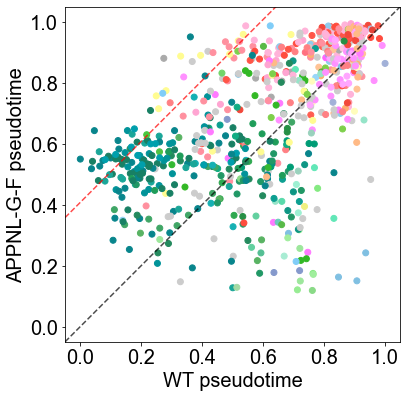

In [979]:
import pandas as pd
import matplotlib.pyplot as plt

# WTとAPPデータの結合
# 仮定: combined_dataは既にWTとAPPデータを含んでいるが、WTとAPPは別々に格納されている
wt_data = combined_data[combined_data['group'] == 'WT']
app_data = combined_data[combined_data['group'] == 'APP']

# WTとAPPデータをatlasIDを基にして結合
wt_app_combined = pd.merge(wt_data, app_data, on='atlasID', suffixes=('_wt', '_app'))

# data_GOから色情報を結合
wt_app_combined = wt_app_combined.merge(data_GO[['atlasID', 'R', 'G', 'B']], on='atlasID', how='left')

# カラー情報を設定
wt_app_combined['color'] = wt_app_combined.apply(lambda x: (x['R'] / 255, x['G'] / 255, x['B'] / 255), axis=1)

# pseudotime差分の列を追加
wt_app_combined['pseudotime_diff'] = wt_app_combined['APP_pseudotime_app'] - wt_app_combined['WT_pseudotime_wt']

# 差分が大きい上位100のregionを抽出
top_100 = wt_app_combined.nlargest(100, 'pseudotime_diff')

# top 100の平均差分を計算
c = top_100['pseudotime_diff'].mean()

# 散布図の描画
plt.figure(figsize=(6, 6))

# 散布図のプロット
plt.scatter(wt_app_combined['WT_pseudotime_wt'], wt_app_combined['APP_pseudotime_app'], c=wt_app_combined['color'], alpha=1.0)
plt.xlim(-0.05, 1.05)
plt.ylim(-0.05, 1.05)

# 等方的に表示
plt.gca().set_aspect('equal', adjustable='box')

# y=xの対角線を引く
plt.plot([-0.05, 1.05], [-0.05, 1.05], color='black', linestyle='--', label='y=x', alpha = 0.7)

# y=x+cの対角線を引く（cはtop 100の平均差分）
plt.plot([-0.05, 1.05], [-0.05 + c, 1.05 + c], color='red', linestyle='--', label=f'y=x+{c:.3f}', alpha = 0.7)

# 軸ラベルとタイトルの設定
plt.xlabel('WT pseudotime')
plt.ylabel('APPNL-G-F pseudotime')

# x軸とy軸の目盛りを設定
plt.xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
plt.yticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
# 凡例を追加
#plt.legend()

# グラフの調整
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# PDFとして保存（透過背景）
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_vs_APP_Microglia_Pseudotime_scatter_plot.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# グラフの表示
plt.show()


In [871]:
top_100 

,atlasID,1m_wt,3m_wt,5m_wt,7m_wt,9m_wt,pseudotime_wt,WT_pseudotime_wt,APP_pseudotime_wt,group_wt,...,9m_app,pseudotime_app,WT_pseudotime_app,APP_pseudotime_app,group_app,R,G,B,color,pseudotime_diff
52,108,3.043357,3.011163,3.200817,2.869238,2.929097,0.273971,0.273971,NaN,WT,...,3.816012,0.880137,NaN,0.880137,APP,170,170,170,"(0.6666666666666666, 0.6666666666666666, 0.666...",0.606166
201,401,0.151810,0.153045,0.156197,0.133207,0.136063,0.046143,0.046143,NaN,WT,...,0.131647,0.642877,NaN,0.642877,APP,8,133,140,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.596734
199,393,0.015889,0.014240,0.015342,0.013208,0.014104,0.361125,0.361125,NaN,WT,...,0.018053,0.950460,NaN,0.950460,APP,8,133,140,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.589335
549,1064,5.330058,7.486828,7.005266,5.636331,5.414803,0.329297,0.329297,NaN,WT,...,6.069947,0.887333,NaN,0.887333,APP,255,252,145,"(1.0, 0.9882352941176471, 0.5686274509803921)",0.558036
240,501,0.222283,0.228920,0.227866,0.194510,0.201027,0.000000,0.000000,NaN,WT,...,0.177232,0.549513,NaN,0.549513,APP,8,133,140,"(0.03137254901960784, 0.5215686274509804, 0.54...",0.549513
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320,654,1.141687,1.195094,1.173673,1.051743,1.033810,0.181145,0.181145,NaN,WT,...,0.794290,0.504859,NaN,0.504859,APP,24,128,100,"(0.09411764705882353, 0.5019607843137255, 0.39...",0.323714
288,599,0.467256,0.481042,0.462054,0.433592,0.488108,0.483262,0.483262,NaN,WT,...,0.586173,0.806061,NaN,0.806061,APP,255,144,159,"(1.0, 0.5647058823529412, 0.6235294117647059)",0.322800
558,1084,1.703461,1.513581,1.472692,1.660250,1.512928,0.600877,0.600877,NaN,WT,...,2.014087,0.919452,NaN,0.919452,APP,89,185,71,"(0.34901960784313724, 0.7254901960784313, 0.27...",0.318575
275,580,0.115416,0.111843,0.114358,0.103415,0.115357,0.442692,0.442692,NaN,WT,...,0.163371,0.761118,NaN,0.761118,APP,255,122,255,"(1.0, 0.47843137254901963, 1.0)",0.318426


In [826]:
# WTとAPPの領域ごとのpseudotimeを比較する
# NaNを除外して比較
wt_pseudotime_clean = combined_data['WT_pseudotime'].dropna()
app_pseudotime_clean = combined_data['APP_pseudotime'].dropna()

# Wilcoxon signed-rank test to compare pseudotime progression
stat, p_val = ttest_rel(wt_pseudotime_clean, app_pseudotime_clean)
print(f'T-test p-value for pseudotime comparison: {p_val}')

# APPとWTのpseudotimeの平均値を計算
wt_mean = wt_pseudotime_clean.mean()
app_mean = app_pseudotime_clean.mean()
print(f'WT mean pseudotime: {wt_mean}')
print(f'APP mean pseudotime: {app_mean}')

T-test p-value for pseudotime comparison: 2.0822041469534772e-22
WT mean pseudotime: 0.5973152651072614
APP mean pseudotime: 0.6838850601508258


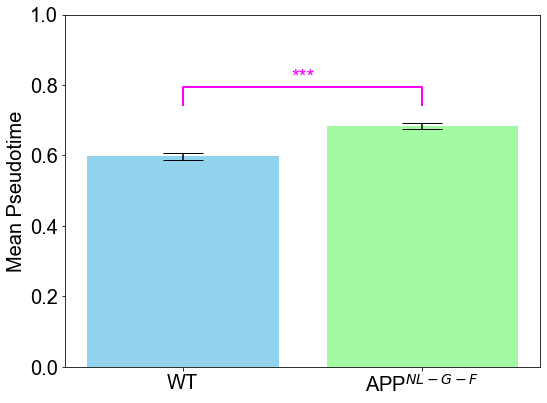

In [849]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import ttest_rel

# WTとAPPのpseudotimeデータ
wt_pseudotime_clean = combined_data['WT_pseudotime'].dropna()
app_pseudotime_clean = combined_data['APP_pseudotime'].dropna()

# 平均値と標準誤差の計算
wt_mean = wt_pseudotime_clean.mean()
app_mean = app_pseudotime_clean.mean()
wt_sem = wt_pseudotime_clean.sem()  # 標準誤差
app_sem = app_pseudotime_clean.sem()  # 標準誤差

# T-testの実行
stat, p_val = ttest_rel(wt_pseudotime_clean, app_pseudotime_clean)

# 有意差レベルの設定
if p_val < 0.001:
    significance = '***'
elif p_val < 0.01:
    significance = '**'
elif p_val < 0.05:
    significance = '*'
else:
    significance = 'N.S.'

# データ準備
labels = ['WT', r'APP$^{NL-G-F}$']  # 上付き文字にするためにr"$...$"の形式を使用
means = [wt_mean, app_mean]
errors = [wt_sem, app_sem]

# 棒グラフの描画
plt.figure(figsize=(8, 6))
bars = plt.bar(labels, means, yerr=errors, color=['skyblue', 'palegreen'], alpha=0.9, capsize=20)
plt.ylim(0.0,1.0)
# グラフの設定
plt.ylabel('Mean Pseudotime')
#plt.title('Mean Pseudotime Comparison between WT and APP')

# 平均値を棒の上に表示
#for i, mean in enumerate(means):
    #plt.text(i, mean + 0.01, f'{mean:.3f}', ha='center', fontsize=12)

# 有意差のアノテーションの追加
x1, x2 = 0, 1  # WTとAPPの棒の位置
y, h, col = max(means) + max(errors) + 0.05, 0.05, 'magenta'  # アノテーションのY位置、スペース、色の設定
plt.plot([x1, x1, x2, x2], [y, y + h, y + h, y], lw=2, color=col)
plt.text((x1 + x2) * 0.5, y + h, significance, ha='center', va='bottom', color=col)

# グラフの表示
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# Save the figure as a PDF with transparent background
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_vs_APP_Mean_Pseudotime_bar_plot.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

plt.show()


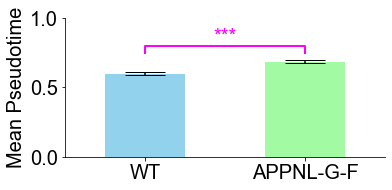

In [858]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import ttest_rel

# WTとAPPのpseudotimeデータ
wt_pseudotime_clean = combined_data['WT_pseudotime'].dropna()
app_pseudotime_clean = combined_data['APP_pseudotime'].dropna()

# 平均値と標準誤差の計算
wt_mean = wt_pseudotime_clean.mean()
app_mean = app_pseudotime_clean.mean()
wt_sem = wt_pseudotime_clean.sem()  # 標準誤差
app_sem = app_pseudotime_clean.sem()  # 標準誤差

# T-testの実行
stat, p_val = ttest_rel(wt_pseudotime_clean, app_pseudotime_clean)

# 有意差レベルの設定
if p_val < 0.001:
    significance = '***'
elif p_val < 0.01:
    significance = '**'
elif p_val < 0.05:
    significance = '*'
else:
    significance = 'N.S.'

# データ準備
labels = ['WT', "APPNL-G-F"]  
means = [wt_mean, app_mean]
errors = [wt_sem, app_sem]

# 棒グラフの描画、widthパラメータを追加してバーを細くする
plt.figure(figsize=(6, 3))
bars = plt.bar(labels, means, yerr=errors, color=['skyblue', 'palegreen'], alpha=0.9, capsize=20, width=0.5)  # width=0.5に設定
plt.ylim(0.0, 1.0)
plt.xlim(-0.5, 1.5)
# グラフの設定
plt.ylabel('Mean Pseudotime')

# 上と右の枠線を消し、下と左の枠線を残す
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(True)

# 有意差のアノテーションの追加
x1, x2 = 0, 1  # WTとAPPの棒の位置
y, h, col = max(means) + max(errors) + 0.05, 0.05, 'magenta'  # アノテーションのY位置、スペース、色の設定
plt.plot([x1, x1, x2, x2], [y, y + h, y + h, y], lw=2, color=col)
plt.text((x1 + x2) * 0.5, y + h, significance, ha='center', va='bottom', color=col)

# グラフの表示を調整
plt.tight_layout()
plt.subplots_adjust(hspace=0.3)

# PDFとして保存（透過背景）
plt.savefig('/export3/Imaging/ds4_Data5/mitani/Neurology/Fig.6/WT_vs_APP_Mean_Pseudotime_bar_plot.pdf',
            transparent=True, dpi=300, bbox_inches='tight', pad_inches=0.1)

# グラフの表示
plt.show()
